# Final Analysis
This chapter takes into account the finalized interviews, especially the extracted responses for further result analysis. This chapter will also conclude and be the final step in this research project. The decision on which response extraction is chosen for further analysis is based on the extraction validation process in 5. Here, the sophisticated regular expression extraction led to the most successful and reliable results in the randomized evaluation.


In [1]:
import pandas as pd 
import matplotlib as plt
import seaborn as sns
import numpy as np
import scipy as sci
from matplotlib.colors import LinearSegmentedColormap

# load dataframe containing final interviews and most successfully extracted responses
final_interviews_processed = pd.read_csv("../assets/final_interviews/ALL_regex_complete-processed_selected_interviews.csv", sep=";")
final_interviews_processed["model_name"] = final_interviews_processed["model_name"].str.replace("Meta-Llama-3.1-8B-Instruct", "Llama-3.1-8B-Instruct")
final_interviews_processed["model_name"] = final_interviews_processed["model_name"].str.replace("gemini-1.5-pro", "Gemini-1.5-Pro")
final_interviews_processed["model_name"] = final_interviews_processed["model_name"].str.replace("Qwen2.5-7B-Instruct", "Qwen-2.5-7B-Instruct")
# cut out personality priming because it is not part of paper
final_interviews_processed = final_interviews_processed[final_interviews_processed["type"] != "original_personality_prime"]

df_freq = pd.DataFrame(final_interviews_processed["model_name"].value_counts()).reset_index()
df_freq.columns = ["Model", "Number of interviews"]
df_freq = df_freq.sort_values("Model")
df_freq.loc[len(df_freq)] = ["Total", sum(final_interviews_processed["model_name"].value_counts())]
df_freq

,Model,Number of interviews
0,Gemini-1.5-Pro,18600
1,Llama-3.1-8B-Instruct,18600
2,Llama-3.2-1B-Instruct,18600
3,Llama-3.2-3B-Instruct,18600
4,Llama-3.3-70B-Instruct,18600
8,Mistral-7B-Instruct-v0.3,18600
5,Phi-3.5-mini,18600
6,Qwen-2.5-7B-Instruct,18600
7,Yi-1.5-6B-Chat,18600
9,Total,167400


In [2]:
import plotly.graph_objects as go
import kaleido

# Create a Plotly Table
fig = go.Figure(data=[go.Table(
    header=dict(values=list(df_freq.columns),
                fill_color='paleturquoise',
                align='center'),
    cells=dict(values=[df_freq[col] for col in df_freq.columns],
               fill_color='lavender',
               align='center'))
])

fig.show()



In [3]:
final_interviews_processed[(final_interviews_processed["model_name"] == "Gemini-1.5-Pro") & (final_interviews_processed["extracted_response"].isnull())]
final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.1-8B-Instruct") & (final_interviews_processed["extracted_response"].isnull())]
final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.3-70B-Instruct") & (final_interviews_processed["extracted_response"].isnull())]
final_interviews_processed[(final_interviews_processed["model_name"] == "Phi-3.5-mini") & (final_interviews_processed["extracted_response"].isnull())]
final_interviews_processed[(final_interviews_processed["model_name"] == "Phi-3.5-mini")]["extracted_response"].value_counts(dropna=False)
final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.3-70B-Instruct")]["extracted_response"].value_counts(dropna=False)

extracted_response
2.0     8049
1.0     4353
0.0     1930
3.0     1100
10.0    1021
4.0      991
6.0      344
5.0      310
8.0      220
NaN      182
11.0     100
Name: count, dtype: int64

In [4]:
model_success_rate = final_interviews_processed.groupby("model_name")["extracted_response"]
obs_interviews = len(final_interviews_processed[final_interviews_processed["model_name"] == "Gemini-1.5-Pro"])
gemini_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Gemini-1.5-Pro") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
llama3_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.1-8B-Instruct") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
mistral7B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Mistral-7B-Instruct-v0.3") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
phimini_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Phi-3.5-mini") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
Yi6B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Yi-1.5-6B-Chat") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
gwen7B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Qwen-2.5-7B-Instruct") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
llama1B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.2-1B-Instruct") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
llama3B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.2-3B-Instruct") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews
llama70B_success_rate = 1 - len(final_interviews_processed[(final_interviews_processed["model_name"] == "Llama-3.3-70B-Instruct") & (final_interviews_processed["extracted_response"].isnull())])/obs_interviews


numbers = [mistral7B_success_rate, gemini_success_rate, llama70B_success_rate, llama3_success_rate,
           llama1B_success_rate, llama3B_success_rate, 
           phimini_success_rate, Yi6B_success_rate, gwen7B_success_rate]
models = ["Mistral-7B-Instruct-v0.3","Gemini-1.5-Pro","Llama-3.3-70B-Instruct", "Llama-3.1-8B-Instruct", 
          "Llama-3.2-1B-Instruct", "Llama-3.2-3B-Instruct",
          "Phi-3.5-mini", "Yi-1.5-6B-Chat", "Qwen-2.5-7B-Instruct"]

success_rates = pd.DataFrame({
    "success_rate" : numbers,
    "model": models
}).sort_values(by="success_rate", ascending=False)

# Calculate the mean
mean_value = round((1-sum(final_interviews_processed["extracted_response"].isnull())/len(final_interviews_processed)), 2)

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\689106069.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




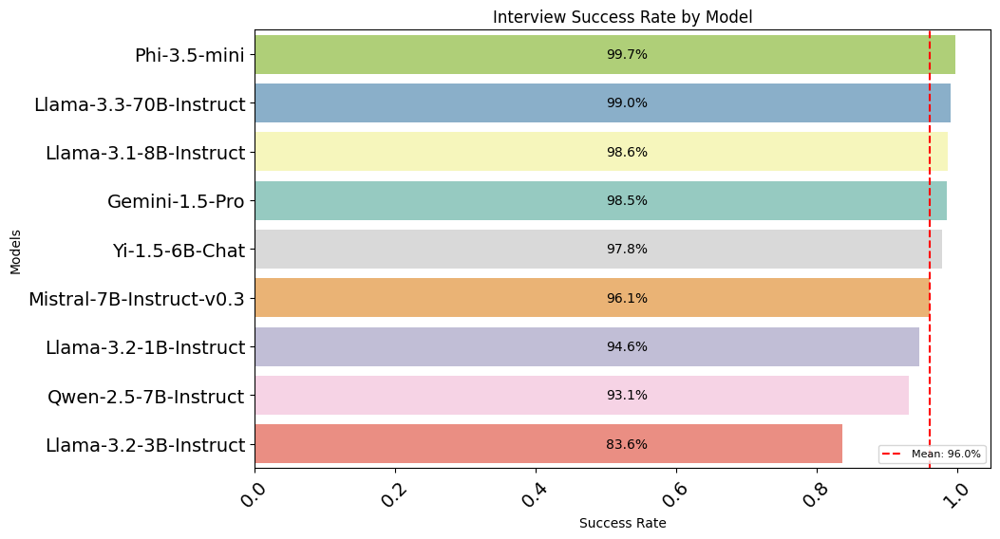

In [ ]:
# Define a fixed order for all possible models (global model list)
all_models = sorted(final_interviews_processed["model_name"].unique())

# Define a consistent color palette for all models
palette = sns.color_palette("Set3", len(all_models))
global_color_mapping = {model: palette[i] for i, model in enumerate(all_models)}

plt.figure(figsize=(10, 6))
sns.barplot(y=success_rates["model"], 
            x=success_rates["success_rate"],
            palette=global_color_mapping)


# Adding a vertical line for the mean
plt.axvline(mean_value, color="red", linestyle="--", label=f"Mean: {mean_value*100:.1f}%")

# Adding annotations
for index, value in enumerate(success_rates["success_rate"]):
    plt.text(
        0.5,  # Offset text slightly to the right
        index,
        f"{value*100:.1f}%",  # Format as percentage
        va="center"
    )
# Rotate x labels
plt.xticks(rotation=45, fontsize=14)
plt.yticks( fontsize=14)
# Customize the plot (optional)
plt.ylabel("Models")
plt.xlabel("Success Rate")
plt.title("Interview Success Rate by Model")
plt.legend(loc="lower right", fontsize=8)
# Show the plot
plt.savefig("../thesis/figures/success_rates_interviews.pdf", 
            transparent=True,
            bbox_inches='tight')
plt.show()

In [6]:
file_path = "../assets/final_interviews/241126_question_classification.csv"
question_class = pd.read_csv(file_path, sep=";")
question_class["Category"].unique()

# define relevant scales
type_dict = {'Importance of Life Aspects': "4-pt Likert Scale",
            'Social and Cultural Norms': "5-pt Likert Scale",
            'Trust in People and Groups': "4-pt Likert Scale", 
            'Confidence in Institutions': "4-pt Likert Scale",
            'Active or Inactive Membership': "3-pt Likert Scale", 
            'Immigration and its Effects': "3-pt Likert Scale",
            'Moral and Ethical Justifiability': "10-pt Likert Scale",
            'Political and Social Activism': "3-pt Likert Scale",
            'Perception of Elections': "4-pt Likert Scale",
            'Perception of Democracy': "10-pt Likert Scale"
    
}
# define order of models 
all_sorted_models = ['Llama-3.3-70B-Instruct', 'Llama-3.1-8B-Instruct', 
                    'Llama-3.2-3B-Instruct', 'Llama-3.2-1B-Instruct', 
                    'Gemini-1.5-Pro', 'Phi-3.5-mini', 'Mistral-7B-Instruct-v0.3', 
                    'Qwen-2.5-7B-Instruct', 'Yi-1.5-6B-Chat']

# sorted categories by underlying scale types
sorted_categories = [
    'Active or Inactive Membership', 
    'Political and Social Activism',
    'Immigration and its Effects',
    'Importance of Life Aspects',
    'Trust in People and Groups',
    'Confidence in Institutions',
    'Perception of Elections',
    'Social and Cultural Norms',
    'Perception of Democracy',
    'Moral and Ethical Justifiability'
]

categories_separator = [3,7,8]

question_class["Scale Type"] = question_class["Category"].map(type_dict).fillna("Unknown")
question_class.head(7)

,Question ID,Question Description,Category,Scale Type
0,Q1,Important in life: Family,Importance of Life Aspects,4-pt Likert Scale
1,Q2,Important in life: Friends,Importance of Life Aspects,4-pt Likert Scale
2,Q3,Important in life: Leisure time,Importance of Life Aspects,4-pt Likert Scale
3,Q4,Important in life: Politics,Importance of Life Aspects,4-pt Likert Scale
4,Q5,Important in life: Work,Importance of Life Aspects,4-pt Likert Scale
5,Q6,Important in life: Religion,Importance of Life Aspects,4-pt Likert Scale
6,Q33,Jobs scarce: Men should have more right to a j...,Social and Cultural Norms,5-pt Likert Scale


In [7]:
final_interviews_categorized = final_interviews_processed.merge(question_class, left_on="question_ID", right_on="Question ID",indicator=True)
print("Merge successful (no duplicates introduced): ", final_interviews_categorized.shape[0] == final_interviews_processed.shape[0])

Merge successful (no duplicates introduced):  True


In [8]:
final_interviews_categorized.to_csv("../assets/final_interviews/FINAL_categorized_processed_interviews.csv", sep = ";")

In [9]:
# Define a fixed order for all possible models (global model list)
all_models = sorted(final_interviews_categorized["model_name"].unique())

# Define a consistent color palette for all models
palette = sns.color_palette("tab10", len(all_models))
global_color_mapping = {model: palette[i] for i, model in enumerate(all_models)}

# ensure that all responses are strings and nans are accounted for
final_interviews_categorized["extracted_response"] = final_interviews_categorized["extracted_response"].astype(str)
final_interviews_categorized["extracted_response"] = final_interviews_categorized["extracted_response"].fillna("NaN")


## Pooling Thematic Categories
This section is dealing with the different categories identified, like "Importance of Life Aspects", and identifying overall answer patterns of the different models.

In [10]:
# check if all groups just have one answer options variation to be able to pool these questions for analysis
for i in range(0,9):
    print(len(final_interviews_categorized[
        final_interviews_categorized["type"] == "list_answer_options"
        ].groupby("Category")["answer_options"].unique()[i]) == 1)                                                                                  

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getit

True
True
True
True
True
True
True
True
True


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1555867387.py:3: FutureWarning:

Series.__getit

In [11]:
# inspect length of answer categories
new = pd.DataFrame()
new["list"] = (final_interviews_categorized["answer_options"].apply(lambda x: x.split(',') if isinstance(x, str) else x))
new["len_list"] = new["list"].apply(len)
new["len_list"].value_counts().sort_values()

len_list
10     2925
12     2925
6      6975
3      8100
7     13500
11    29250
4     46125
5     57600
Name: count, dtype: int64

Inspect the distribution on the original Q&A phrasing over all models.

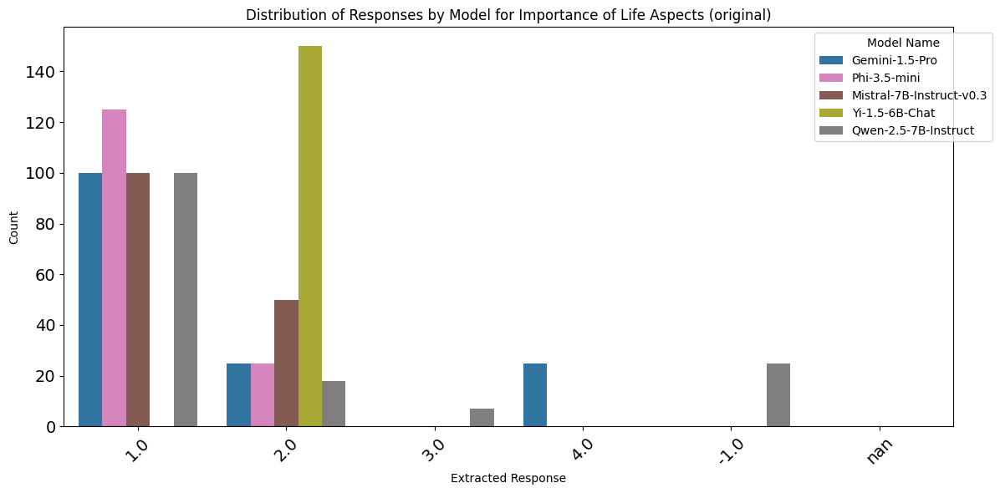

In [ ]:
llama_models = ["Llama-3.3-70B-Instruct",
                "Llama-3.1-8B-Instruct", 
                "Llama-3.2-3B-Instruct",
                "Llama-3.2-1B-Instruct"]
other_models = ["Gemini-1.5-Pro", "Phi-3.5-mini", "Mistral-7B-Instruct-v0.3",
                "Yi-1.5-6B-Chat", "Qwen-2.5-7B-Instruct"]
# Subset the data for the desired category
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Importance of Life Aspects") & 
    (final_interviews_categorized["model_name"].isin(other_models)) &
    (final_interviews_categorized["type"] == "list_answer_options")
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")


# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=other_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Importance of Life Aspects (original)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/other_orig_dist_importance.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


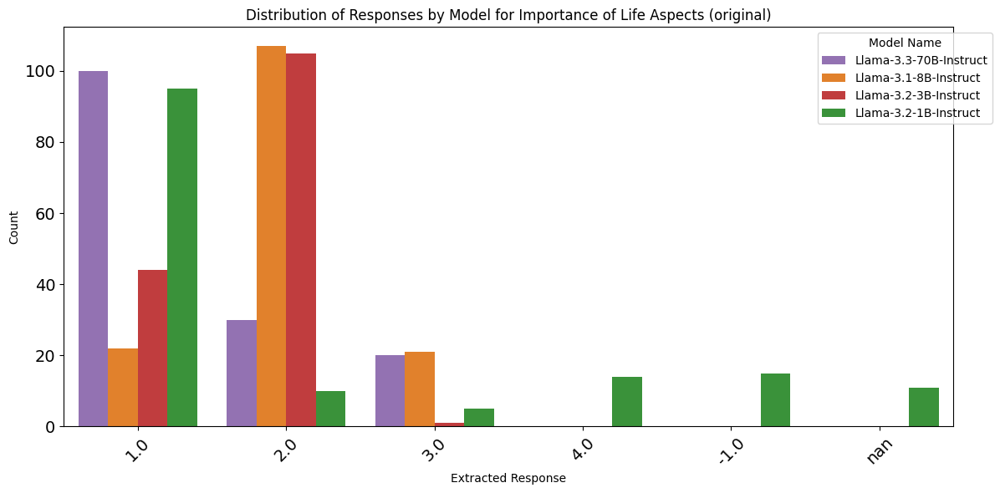

In [13]:
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Importance of Life Aspects") & 
    (final_interviews_categorized["model_name"].isin(llama_models)) &
    (final_interviews_categorized["type"] == "list_answer_options")
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")

# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=llama_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Importance of Life Aspects (original)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/other_orig_dist_importance.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


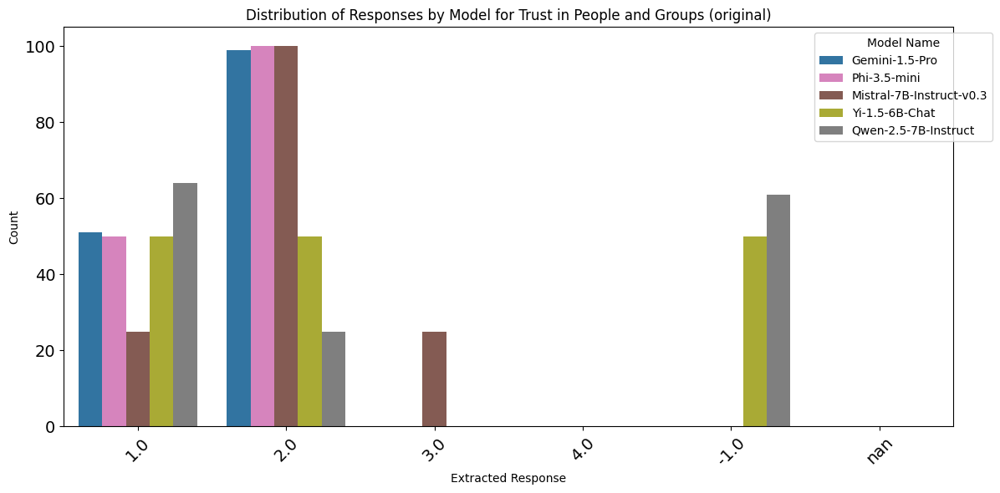

In [14]:
# Subset the data for the desired category
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Trust in People and Groups") & 
    (final_interviews_categorized["model_name"].isin(other_models)) &
    (final_interviews_categorized["type"] == "list_answer_options")
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")


# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=other_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Trust in People and Groups (original)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/other_orig_dist_trust.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


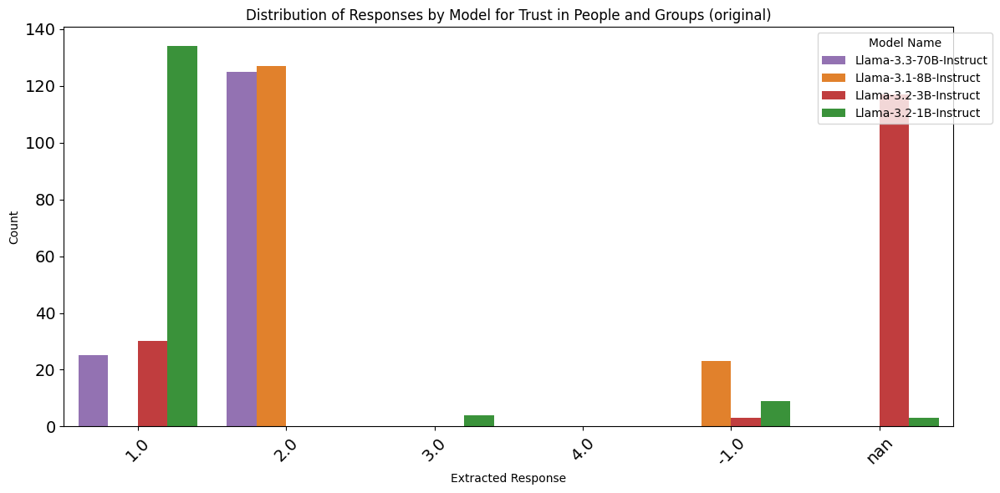

In [15]:
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Trust in People and Groups") & 
    (final_interviews_categorized["model_name"].isin(llama_models)) &
    (final_interviews_categorized["type"] == "list_answer_options")
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")

# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=llama_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Trust in People and Groups (original)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/llama_orig_dist_trust.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


Calculate entropy over all models in original q&a and all categories.

In [16]:
for i in final_interviews_categorized["Category"].unique():
    subset = final_interviews_categorized[
        (final_interviews_categorized["Category"] == i) &
        (final_interviews_categorized["type"] == "list_answer_options")
    ]

    # Group the data by model_name and extracted_response to count occurrences
    grouped_data = (
        subset.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )

    from scipy.stats import entropy

    # Calculate probabilities for each category within each model
    distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
    probabilities = distribution.groupby(level=0).apply(lambda x: x / x.sum())

    # Calculate entropy
    raw_entropy = probabilities.groupby(level=0).apply(entropy).reset_index()
    raw_entropy.columns = ["Model", "Entropy"]

    # Normalize entropy
    num_outcomes = grouped_data["extracted_response"].nunique()
    raw_entropy["Normalized_Entropy"] = raw_entropy["Entropy"] / np.log(num_outcomes)

    # Sort and display
    raw_entropy["Model"] = pd.Categorical(raw_entropy["Model"], categories=all_sorted_models, ordered=True)
    sorted_entropy_table = raw_entropy.sort_values("Model")
    print(i, sorted_entropy_table)
    
    # Convert the DataFrame to a LaTeX table
    latex_table = sorted_entropy_table.to_latex(
        index=False,      # Exclude the index column
        caption=f"Entropy of Responses to Original Q&A Pair by Model in Category '{i}'",  # Add a caption
        label=f"tab:original_entropy_table_{i[0:20]}",        # Add a label for referencing
        float_format="%.3f",              # Format floats to 2 decimal places
        column_format="|l|c|",            # Specify column alignment ('l'=left, 'c'=center, 'r'=right)
        escape=False                      # Disable escaping of special characters
    )

    # Save to a .tex file (optional)
    with open(f'../thesis/tables/entropy/original_entropy_{i[0:20]}.tex', 'w') as f:
        f.write(latex_table)




Importance of Life Aspects                       Model   Entropy  Normalized_Entropy
4    Llama-3.3-70B-Instruct  0.860851            0.480450
1     Llama-3.1-8B-Instruct  0.797765            0.445241
3     Llama-3.2-3B-Instruct  0.642834            0.358773
2     Llama-3.2-1B-Instruct  1.226397            0.684465
0            Gemini-1.5-Pro  0.867563            0.484196
6              Phi-3.5-mini  0.450561            0.251463
5  Mistral-7B-Instruct-v0.3  0.636514            0.355245
7      Qwen-2.5-7B-Instruct  0.966389            0.539352
8            Yi-1.5-6B-Chat  0.000000            0.000000
Social and Cultural Norms                       Model   Entropy  Normalized_Entropy
4    Llama-3.3-70B-Instruct  0.944689            0.681449
1     Llama-3.1-8B-Instruct  1.043757            0.752912
3     Llama-3.2-3B-Instruct  1.014392            0.731729
2     Llama-3.2-1B-Instruct  0.000000            0.000000
0            Gemini-1.5-Pro  1.011404            0.729574
6              Phi-

Inspect the distribution on the original Q&A phrasing over all models and perturbations.

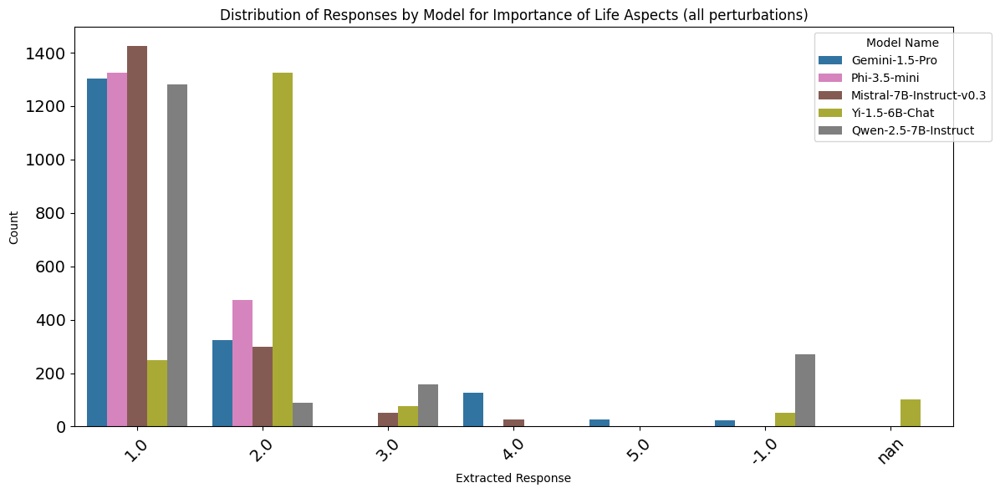

In [17]:
# Subset the data for the desired category
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Importance of Life Aspects") & 
    final_interviews_categorized["model_name"].isin(other_models)
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "5.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")


# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=other_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Importance of Life Aspects (all perturbations)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/other_overall_dist_importance.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


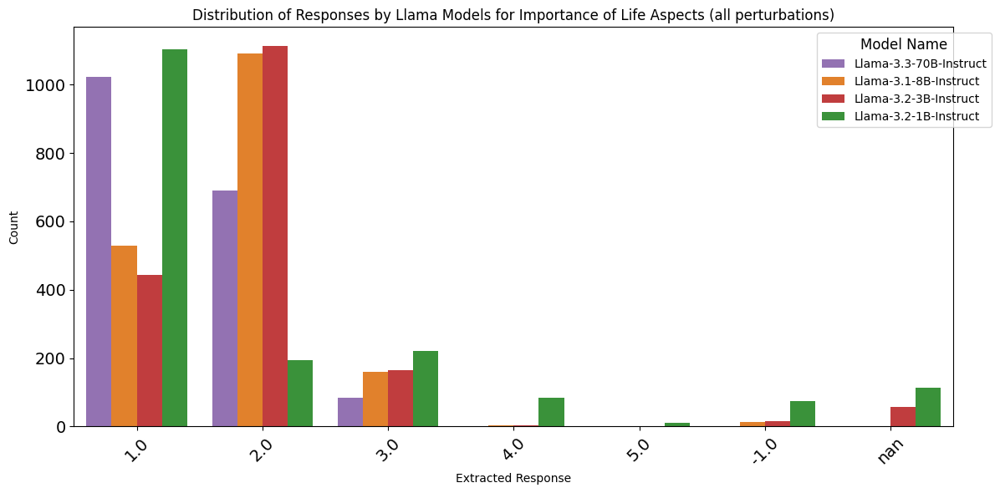

In [18]:
# Inspect Llama Models separately
# Filter the data to include only models starting with "Llama"
llama_subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Importance of Life Aspects") &
    (final_interviews_categorized["model_name"].isin(llama_models))
]

# Group the data by model_name and extracted_response, and count occurrences
llama_grouped_data = (
    llama_subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "5.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
llama_grouped_data["extracted_response"] = llama_grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
llama_grouped_data = llama_grouped_data.sort_values("extracted_response")

# Plotting
plt.figure(figsize=(12, 6))
sns.barplot(
    data=llama_grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=llama_models
)

# Customize the legend
plt.legend(title="Model Name", fontsize=10, title_fontsize=12, bbox_to_anchor=(1.05, 1), loc="upper right")

# Customize the plot
plt.title("Distribution of Responses by Llama Models for Importance of Life Aspects (all perturbations)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
# Ensure layout is clean
file_name = "../thesis/figures/llama_overall_dist_importance.png"
plt.savefig(file_name, bbox_inches="tight", transparent=True, dpi=300)
plt.tight_layout()
plt.show()


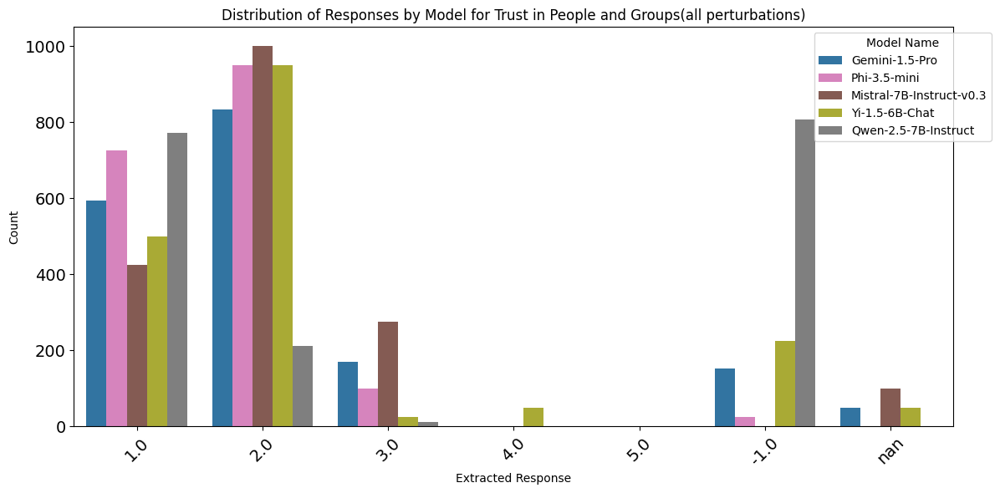

In [19]:
# Subset the data for the desired category
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Trust in People and Groups") & 
    final_interviews_categorized["model_name"].isin(other_models)
]

# Group the data by model_name and extracted_response to count occurrences
grouped_data = (
    subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "5.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
grouped_data["extracted_response"] = grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
grouped_data = grouped_data.sort_values("extracted_response")


# Create a grouped bar plot
plt.figure(figsize=(12, 6))
sns.barplot(
    data=grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=other_models
)

# Customize the plot
plt.title("Distribution of Responses by Model for Trust in People and Groups(all perturbations)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title="Model Name", bbox_to_anchor=(1.05, 1), loc="upper right")
plt.savefig("../thesis/figures/other_overall_dist_trust.png", 
            transparent=True,
            bbox_inches='tight')
# Show the plot
plt.tight_layout()
plt.show()


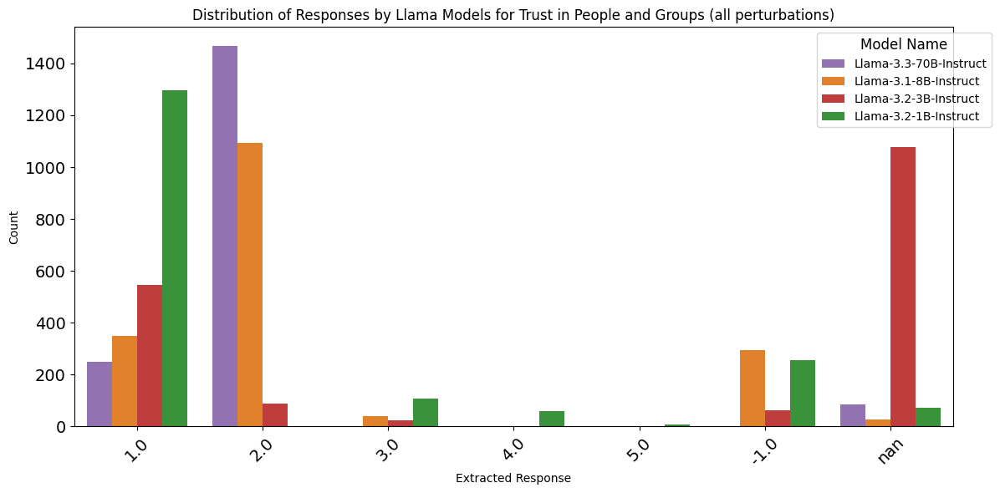

In [20]:
# Inspect Llama Models separately
# Filter the data to include only models starting with "Llama"
llama_subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == "Trust in People and Groups") &
    (final_interviews_categorized["model_name"].isin(llama_models))
]

# Group the data by model_name and extracted_response, and count occurrences
llama_grouped_data = (
    llama_subset.groupby(["model_name", "extracted_response"])
    .size()
    .reset_index(name="count")
)

# Define the desired order for "extracted_response"
desired_order = ["1.0", "2.0", "3.0", "4.0", "5.0", "-1.0", "nan"]  # Adjust this list to match your specific responses
llama_grouped_data["extracted_response"] = llama_grouped_data["extracted_response"].astype(
    pd.CategoricalDtype(categories=desired_order, ordered=True)
)

# Sort the data to match the specified order
llama_grouped_data = llama_grouped_data.sort_values("extracted_response")

# Plotting
plt.figure(figsize=(12, 6))
sns.barplot(
    data=llama_grouped_data,
    x="extracted_response",
    y="count",
    hue="model_name",
    palette=global_color_mapping,
    hue_order=llama_models
)

# Customize the legend
plt.legend(title="Model Name", fontsize=10, title_fontsize=12, bbox_to_anchor=(1.05, 1), loc="upper right")

# Customize the plot
plt.title("Distribution of Responses by Llama Models for Trust in People and Groups (all perturbations)")
plt.xlabel("Extracted Response")
plt.ylabel("Count")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
# Ensure layout is clean
file_name = "../midterm/figures/llama_overall_dist_trust.png"
plt.savefig(file_name, bbox_inches="tight", transparent=True, dpi=300)
plt.tight_layout()
plt.show()


Calculate entropy over all models in all (original and perturbed) q&a and all categories.

In [21]:
for i in final_interviews_categorized["Category"].unique():
    subset = final_interviews_categorized[
        (final_interviews_categorized["Category"] == i) 
    ]

    # Group the data by model_name and extracted_response to count occurrences
    grouped_data = (
        subset.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )

    from scipy.stats import entropy

    # Calculate probabilities for each category within each model
    distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
    probabilities = distribution.groupby(level=0).apply(lambda x: x / x.sum())

    entropy_table = probabilities.groupby(level=0).apply(entropy).reset_index()
    entropy_table.columns = ["Model", "Entropy"]

    # Calculate entropy
    raw_entropy = probabilities.groupby(level=0).apply(entropy).reset_index()
    raw_entropy.columns = ["Model", "Entropy"]

    # Normalize entropy
    num_outcomes = grouped_data["extracted_response"].nunique()
    raw_entropy["Normalized_Entropy"] = raw_entropy["Entropy"] / np.log(num_outcomes)

    # Sort and display
    raw_entropy["Model"] = pd.Categorical(raw_entropy["Model"], categories=all_sorted_models, ordered=True)
    sorted_entropy_table = raw_entropy.sort_values("Model")
    print(i, sorted_entropy_table)
    
    # Convert the DataFrame to a LaTeX table
    latex_table = sorted_entropy_table.to_latex(
        index=False,      # Exclude the index column
        caption=f"Entropy of Responses to all Perturbations by Model in Category '{i}'",  # here I add a caption
        label=f"tab:perturbed_entropy_table_{i[0:20]}",        # here I add a label for referencing
        float_format="%.3f",              # here I format floats to 2 decimal places
        column_format="|l|c|",            # here I specify column alignment 
        escape=False                      # here I disable escaping of special characters
    )

    # Save to a .tex file (optional)
    with open(f'../thesis/tables/entropy/perturbed_entropy_{i[0:20]}.tex', 'w') as f:
        f.write(latex_table)



Importance of Life Aspects                       Model   Entropy  Normalized_Entropy
4    Llama-3.3-70B-Instruct  0.840417            0.431889
1     Llama-3.1-8B-Instruct  0.930762            0.478317
3     Llama-3.2-3B-Instruct  1.027217            0.527885
2     Llama-3.2-1B-Instruct  1.274655            0.655043
0            Gemini-1.5-Pro  0.841416            0.432402
6              Phi-3.5-mini  0.577085            0.296563
5  Mistral-7B-Instruct-v0.3  0.642512            0.330186
7      Qwen-2.5-7B-Instruct  0.889316            0.457018
8            Yi-1.5-6B-Chat  0.892241            0.458521
Social and Cultural Norms                       Model   Entropy  Normalized_Entropy
4    Llama-3.3-70B-Instruct  1.294745            0.665367
1     Llama-3.1-8B-Instruct  1.368007            0.703016
3     Llama-3.2-3B-Instruct  1.295187            0.665594
2     Llama-3.2-1B-Instruct  0.957981            0.492305
0            Gemini-1.5-Pro  1.425452            0.732537
6              Phi-

Create above seen plots for all remaining thematical categories.

In [ ]:
# Get the unique categories
categories = final_interviews_categorized["Category"].unique()

# Sort categories for consistent order (optional)
categories = sorted(categories)

# Loop through each category and create individual plots
for category in categories:
    # Filter data for the current category
    subset = final_interviews_categorized[
        final_interviews_categorized["Category"] == category
    ]
    
    # Group the data by model_name and extracted_response, and count occurrences
    grouped_data = (
        subset.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # Dynamically get unique x-axis values for this category
    unique_responses = sorted(grouped_data["extracted_response"].unique())

    # Create a figure for this category
    plt.figure(figsize=(10, 6))
    
    # Plot the data
    sns.barplot(
        data=grouped_data,
        x="extracted_response",
        y="count",
        hue="model_name",
        palette="Set2"
    )
    
    # Customize the plot
    plt.title(f"Category: {category}", fontsize=16)
    plt.xlabel("Extracted Response", fontsize=12)
    plt.ylabel("Count", fontsize=12)
    plt.xticks(rotation=45, fontsize=10)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")

    # Save the plot as a PNG file
    file_name = f"../midterm/figures/barplot_category_{category.replace(' ', '_')}.png"
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.close()  # Close the figure to avoid display overlap

    print(f"Saved plot for category '{category}' as '{file_name}'")


Saved plot for category 'Active or Inactive Membership' as '../midterm/figures/barplot_category_Active_or_Inactive_Membership.png'
Saved plot for category 'Confidence in Institutions' as '../midterm/figures/barplot_category_Confidence_in_Institutions.png'
Saved plot for category 'Immigration and its Effects' as '../midterm/figures/barplot_category_Immigration_and_its_Effects.png'
Saved plot for category 'Importance of Life Aspects' as '../midterm/figures/barplot_category_Importance_of_Life_Aspects.png'
Saved plot for category 'Moral and Ethical Justifiability' as '../midterm/figures/barplot_category_Moral_and_Ethical_Justifiability.png'
Saved plot for category 'Perception of Democracy' as '../midterm/figures/barplot_category_Perception_of_Democracy.png'
Saved plot for category 'Perception of Elections' as '../midterm/figures/barplot_category_Perception_of_Elections.png'
Saved plot for category 'Political and Social Activism' as '../midterm/figures/barplot_category_Political_and_Social_

## Hypothesis 1: Primacy Bias
Null-Hypothesis: "There is no significant difference in models answer patterns when given either the original or the reversed answer option types"

Assumed Human Bias: "Large Language Models tend to respond with the first answer category like it has been found in human survey respondents"

### Test: Compare the Original to the Reversed Answer Option
1. Delete NaN values
2. Define categories with answer option range ends -1 and 1 (see categories_range)
3. Display the frequencies of -1 and 1 between original and Option Reversal perturbation


In [23]:
# these categories begin with 1 and end with -1, this makes primacy comparison easier
categories_range = ["Importance of Life Aspects", "Social and Cultural Norms", "Trust in People and Groups", 
              "Confidence in Institutions", "Moral and Ethical Justifiability", "Political and Social Activism",
            "Perception of Elections", "Perception of Democracy"]

Importance of Life Aspects Llama-3.3-70B-Instruct
100 0 100 0
  Value  Count Distribution
0   1.0    100     Original
1  -1.0      0     Original
2   1.0    100     Reversed
3  -1.0      0     Reversed


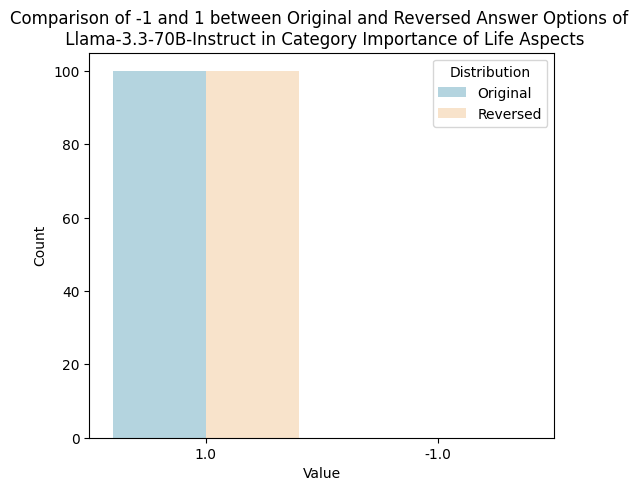

Social and Cultural Norms Llama-3.3-70B-Instruct
0 0 31 0
  Value  Count Distribution
0   1.0      0     Original
1  -1.0      0     Original
2   1.0     31     Reversed
3  -1.0      0     Reversed


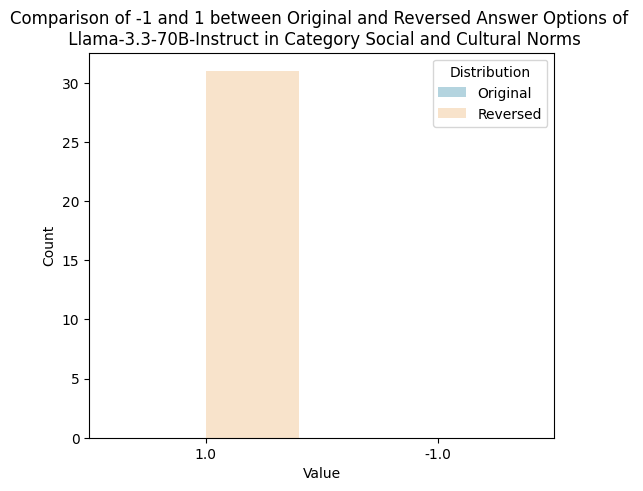

Trust in People and Groups Llama-3.3-70B-Instruct
25 0 29 0
  Value  Count Distribution
0   1.0     25     Original
1  -1.0      0     Original
2   1.0     29     Reversed
3  -1.0      0     Reversed


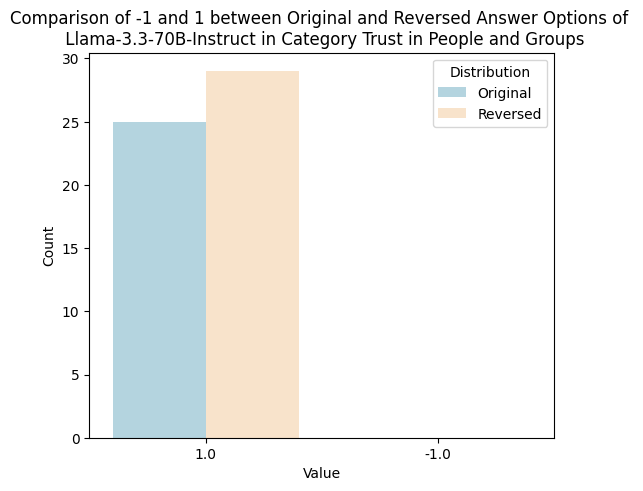

Confidence in Institutions Llama-3.3-70B-Instruct
25 0 162 0
  Value  Count Distribution
0   1.0     25     Original
1  -1.0      0     Original
2   1.0    162     Reversed
3  -1.0      0     Reversed


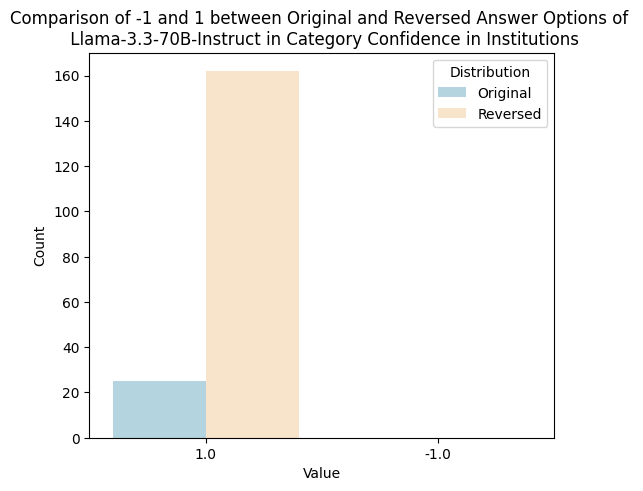

Moral and Ethical Justifiability Llama-3.3-70B-Instruct
75 0 103 0
  Value  Count Distribution
0   1.0     75     Original
1  -1.0      0     Original
2   1.0    103     Reversed
3  -1.0      0     Reversed


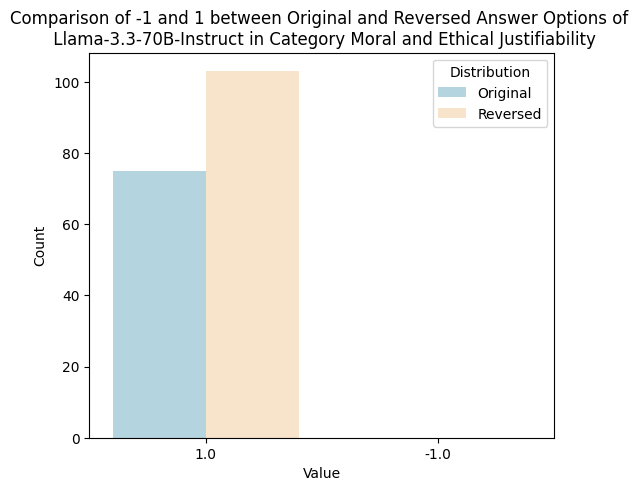

Political and Social Activism Llama-3.3-70B-Instruct
0 0 125 0
  Value  Count Distribution
0   1.0      0     Original
1  -1.0      0     Original
2   1.0    125     Reversed
3  -1.0      0     Reversed


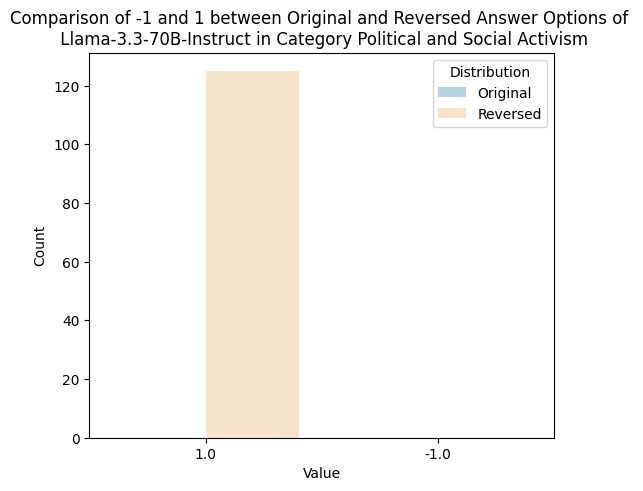

Perception of Elections Llama-3.3-70B-Instruct
0 0 0 0
  Value  Count Distribution
0   1.0      0     Original
1  -1.0      0     Original
2   1.0      0     Reversed
3  -1.0      0     Reversed


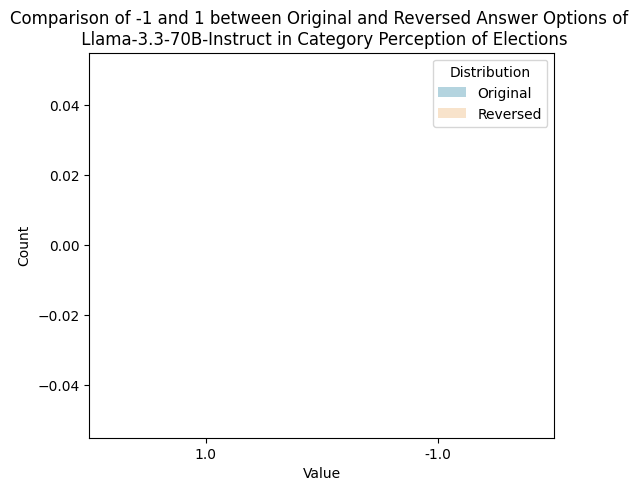

Perception of Democracy Llama-3.3-70B-Instruct
50 0 50 0
  Value  Count Distribution
0   1.0     50     Original
1  -1.0      0     Original
2   1.0     50     Reversed
3  -1.0      0     Reversed


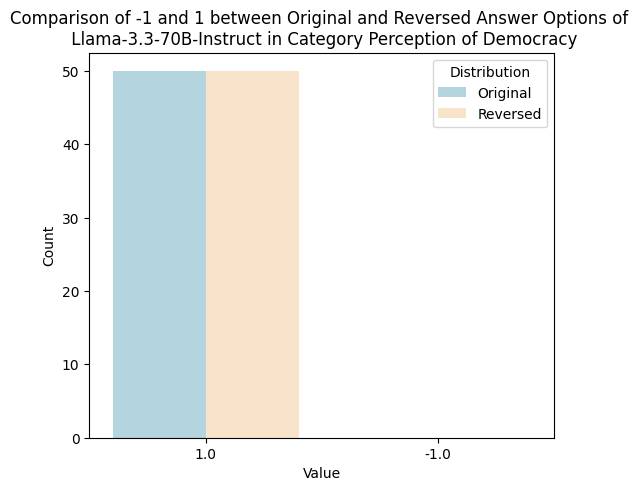

In [24]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_options"
alt_distribution = "list_answer_options_reversed"

for category in categories_range:
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ]
        base_fq = pd.DataFrame(subset_baseline["extracted_response"].value_counts())   
        
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ]
        alternative_fq = pd.DataFrame(subset_alternative["extracted_response"].value_counts())
        try: 
            base_pos1 = base_fq.loc["1.0", "count"]
        except:
            base_pos1 = 0        
        try: 
            base_neg1 = base_fq.loc["-1.0", "count"]
        except:
            base_neg1 = 0
        try: 
            alt_pos1 = alternative_fq.loc["1.0", "count"]
        except:
            alt_pos1 = 0        
        try: 
            alt_neg1 = alternative_fq.loc["-1.0", "count"]
        except:
            alt_neg1 = 0
        print(category, model)
        print(base_pos1,base_neg1, alt_pos1, alt_neg1)

        # Create DataFrame for plotting
        df = pd.DataFrame({
            'Value':  ["1.0", "-1.0"] * 2,
            'Count': [base_pos1, base_neg1, alt_pos1, alt_neg1],
            'Distribution': ['Original'] * 2 + ['Reversed'] * 2
        })
        print(df)
        # Plot
        plt.figure(figsize=(6,5))
        sns.barplot(x='Value', y='Count', hue='Distribution', data=df, palette=['lightblue', 'bisque'])
        plt.title(f"Comparison of -1 and 1 between Original and Reversed Answer Options of \n {model} in Category {category}")
        plt.show()
        break
        

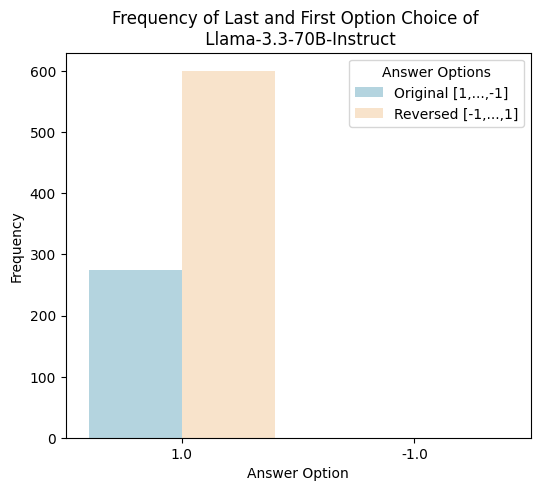

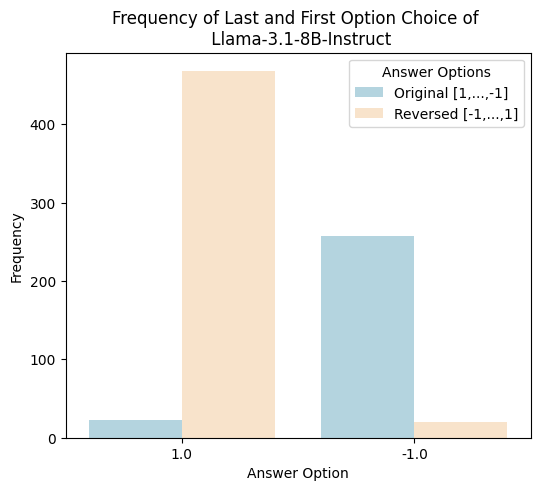

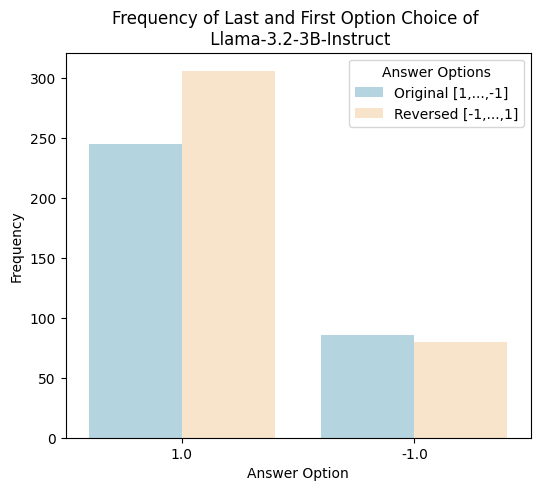

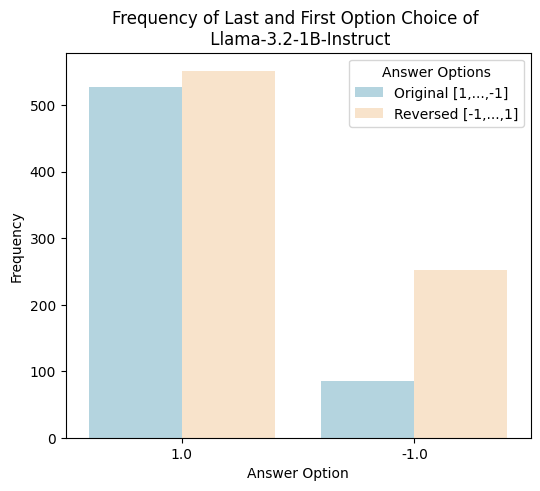

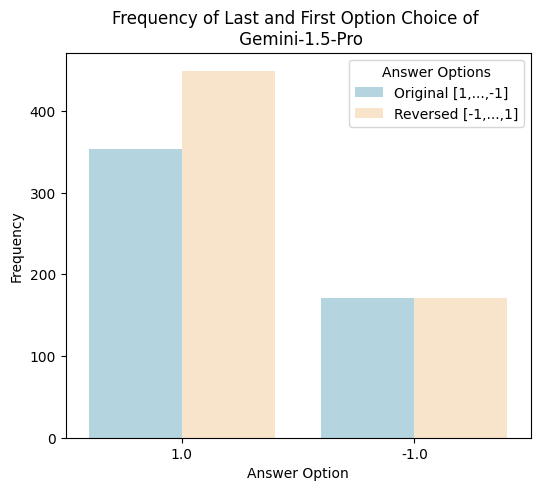

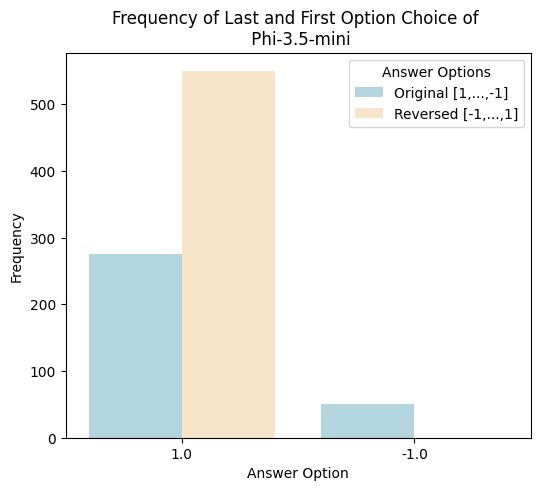

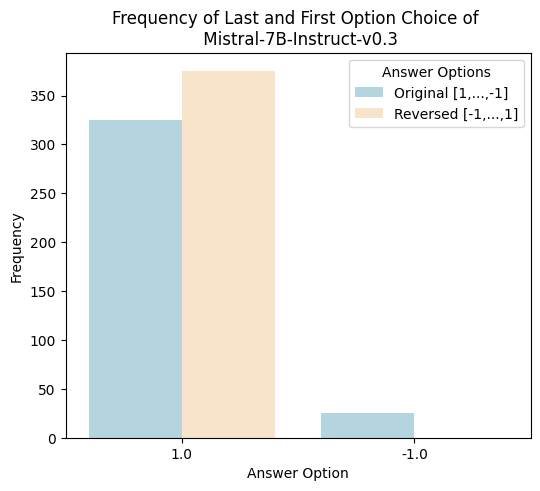

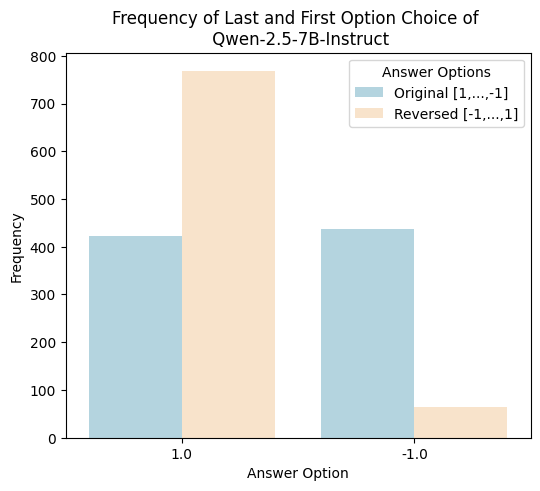

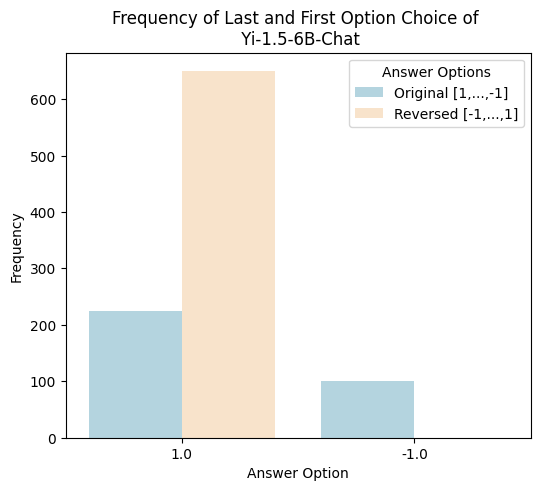

In [25]:
# inspect distribution over all selected categories
for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"].isin(categories_range)) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ]
        base_fq = pd.DataFrame(subset_baseline["extracted_response"].value_counts())   
        
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"].isin(categories_range)) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ]
        alternative_fq = pd.DataFrame(subset_alternative["extracted_response"].value_counts())
        try: 
            base_pos1 = base_fq.loc["1.0", "count"]
        except:
            base_pos1 = 0        
        try: 
            base_neg1 = base_fq.loc["-1.0", "count"]
        except:
            base_neg1 = 0
        try: 
            alt_pos1 = alternative_fq.loc["1.0", "count"]
        except:
            alt_pos1 = 0        
        try: 
            alt_neg1 = alternative_fq.loc["-1.0", "count"]
        except:
            alt_neg1 = 0

        # Create DataFrame for plotting
        df = pd.DataFrame({
            'Value':  ["1.0", "-1.0"] * 2,
            'Count': [base_pos1, base_neg1, alt_pos1, alt_neg1],
            'Answer Options': ['Original [1,...,-1]'] * 2 + ['Reversed [-1,...,1]'] * 2
        })
        # Plot
        plt.figure(figsize=(6,5))
        sns.barplot(x='Value', y='Count', hue='Answer Options', data=df, palette=['lightblue', 'bisque'])
        #sns.pointplot(x='Value', y='Count', hue='Distribution', data=df, dodge=True, markers=["o", "s"])
        plt.title(f"Frequency of Last and First Option Choice of \n {model}")
        plt.ylabel("Frequency")
        plt.xlabel("Answer Option")
        plt.savefig(f"../thesis/figures/h1_comparison_{model}.pdf")
        plt.show()

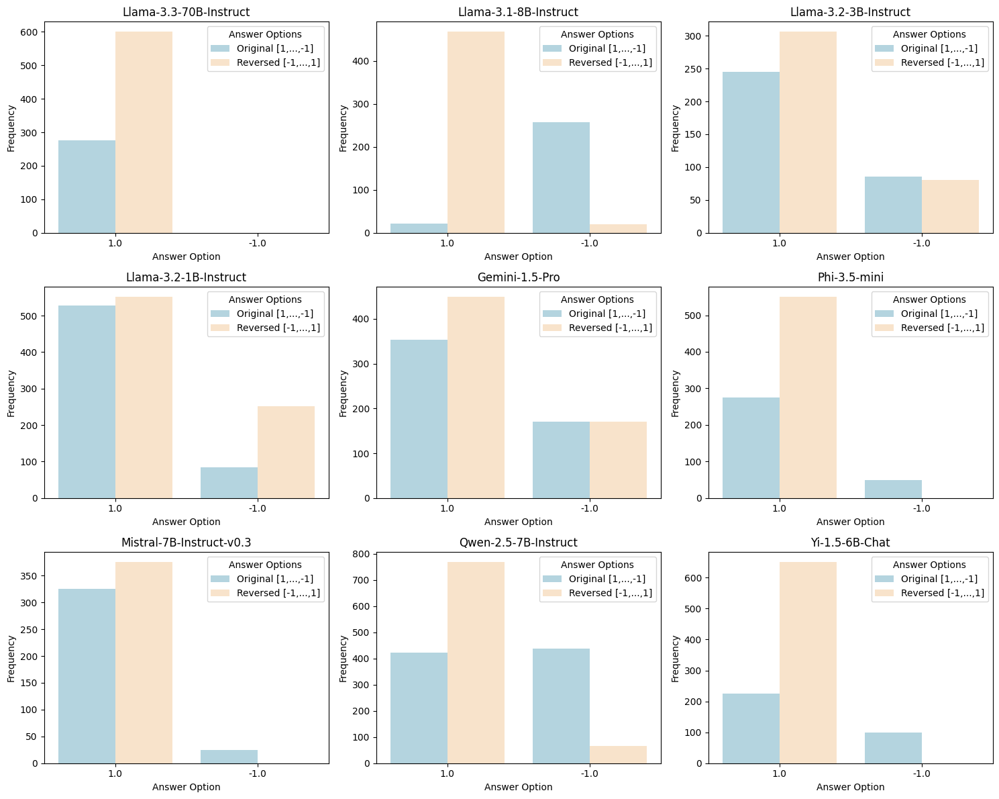

In [26]:
# Create a 3x3 subplot grid
fig, axes = plt.subplots(3, 3, figsize=(15, 12))  
axes = axes.flatten()  # Flatten to 1D array for easy iteration

# Iterate over models and plot on respective subplot
for idx, model in enumerate(all_sorted_models):
    # define original distribution (starts with 1.0)
    subset_baseline = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == base_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    base_fq = subset_baseline["extracted_response"].value_counts()

    # define reversed distribution (starts with -1.0)
    subset_alternative = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == alt_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    alternative_fq = subset_alternative["extracted_response"].value_counts()

    # Extract frequencies
    base_pos1 = base_fq.get("1.0", 0)
    base_neg1 = base_fq.get("-1.0", 0)
    alt_pos1 = alternative_fq.get("1.0", 0)
    alt_neg1 = alternative_fq.get("-1.0", 0)

    # Create DataFrame for plotting
    df = pd.DataFrame({
        'Value':  ["1.0", "-1.0"] * 2,
        'Count': [base_pos1, base_neg1, alt_pos1, alt_neg1],
        'Answer Options': ['Original [1,...,-1]'] * 2 + ['Reversed [-1,...,1]'] * 2
    })

    # Plot in the respective subplot
    sns.barplot(x='Value', y='Count', hue='Answer Options', data=df, 
                palette=['lightblue', 'bisque'], ax=axes[idx])

    axes[idx].set_title(f"{model}")
    axes[idx].set_ylabel("Frequency")
    axes[idx].set_xlabel("Answer Option")

# Adjust layout and show the figure
plt.tight_layout()
plt.savefig("../thesis/figures/h1_comparison_all_models.pdf", bbox_inches="tight")
plt.show()


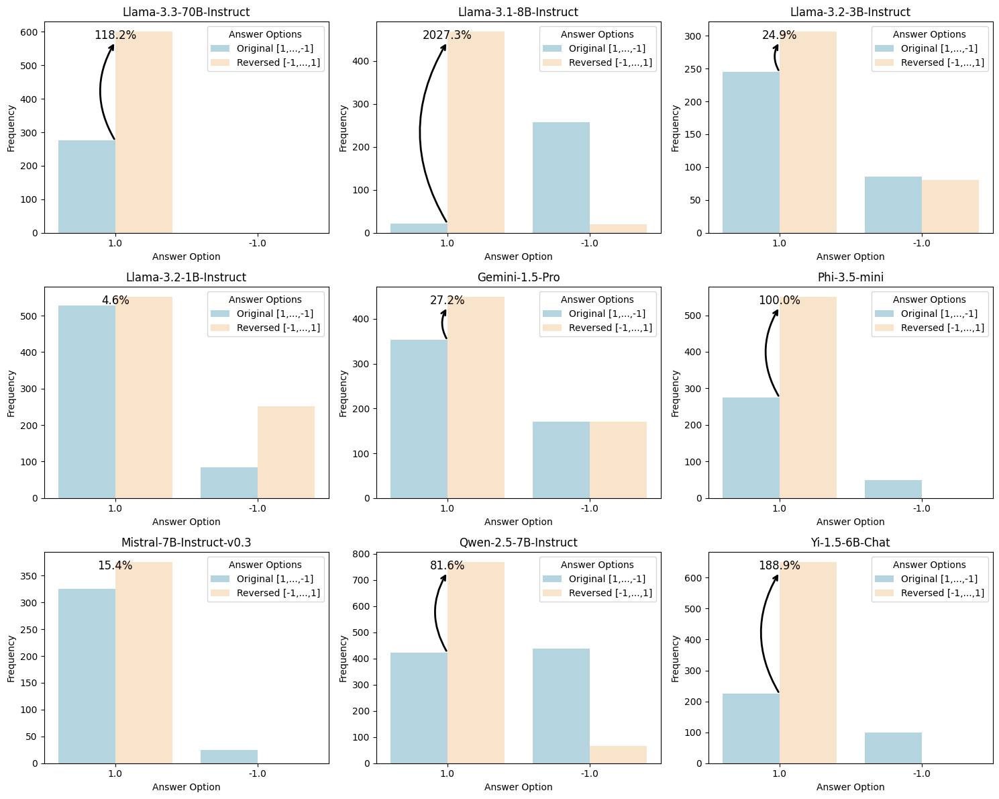

In [27]:
# Create a 3x3 subplot grid
fig, axes = plt.subplots(3, 3, figsize=(15, 12))  
axes = axes.flatten()  # Flatten to 1D array for easy iteration

# Now I iterate over models and plot on respective subplot
for idx, model in enumerate(all_sorted_models):
    # Define original distribution (starts with 1.0)
    subset_baseline = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == base_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    base_fq = subset_baseline["extracted_response"].value_counts()

    # here I reversed distribution (starts with -1.0)
    subset_alternative = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == alt_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    alternative_fq = subset_alternative["extracted_response"].value_counts()

    # then I extract the frequencies
    base_pos1 = base_fq.get("1.0", 0)
    alt_pos1 = alternative_fq.get("1.0", 0)

    # Calculate percentage increase for "1.0" option
    if base_pos1 > 0:  
        percentage_increase = ((alt_pos1 - base_pos1) / base_pos1) * 100
    else:
        percentage_increase = np.nan  # Avoid division by zero

    # Create DataFrame for plotting
    df = pd.DataFrame({
        'Value':  ["1.0", "-1.0"] * 2,
        'Count': [base_pos1, base_fq.get("-1.0", 0), alt_pos1, alternative_fq.get("-1.0", 0)],
        'Answer Options': ['Original [1,...,-1]'] * 2 + ['Reversed [-1,...,1]'] * 2
    })

    # Plot in the respective subplot
    sns.barplot(x='Value', y='Count', hue='Answer Options', data=df, 
                palette=['lightblue', 'bisque'], ax=axes[idx])

    axes[idx].set_title(f"{model}")
    axes[idx].set_ylabel("Frequency")
    axes[idx].set_xlabel("Answer Option")
    
    # Display percentage increase as text on the plot (always shown)
    if not np.isnan(percentage_increase):
        axes[idx].text(0, alt_pos1 - max(df["Count"]) * 0.05,  # Slightly above the "Reversed" bar
                       f"{percentage_increase:.1f}%", ha='center', va='bottom', fontsize=12, color='black')

    # Annotate with steep orange arrow and percentage increase
    if not np.isnan(percentage_increase) and percentage_increase > 20:
        x_pos = 0  # "1.0" is at index 0
        y_base = base_pos1
        y_alt = alt_pos1
        
        # Create a steep arrow from the top of the baseline bar to the top of the alternative bar
        axes[idx].annotate("", 
                        xy=(x_pos, y_base), xycoords="data",
                        xytext=(x_pos, y_alt-(y_alt*0.05)), textcoords="data",
                        arrowprops=dict(arrowstyle="<-", color="black", lw=2, 
                                connectionstyle="arc3,rad=.3"),  # Steep curve
                                fontsize=12, color="black", ha="center", va="bottom")

# Adjust layout and show the figure
plt.tight_layout()
plt.savefig("../thesis/figures/h1_comparison_all_models_annotated.pdf", bbox_inches="tight")
plt.show()


Make the plot more understandable based on feedback:

- antewortoption -1 rauslassen: 
- blau und beigen balken einzeln plotten und beschriften "original last answer option", "original firstr answer option", 
- y-axis anpassen/standardisieren, 
- shared y-axis
- eventuell kippen auf x-axis 
- 2 spalten

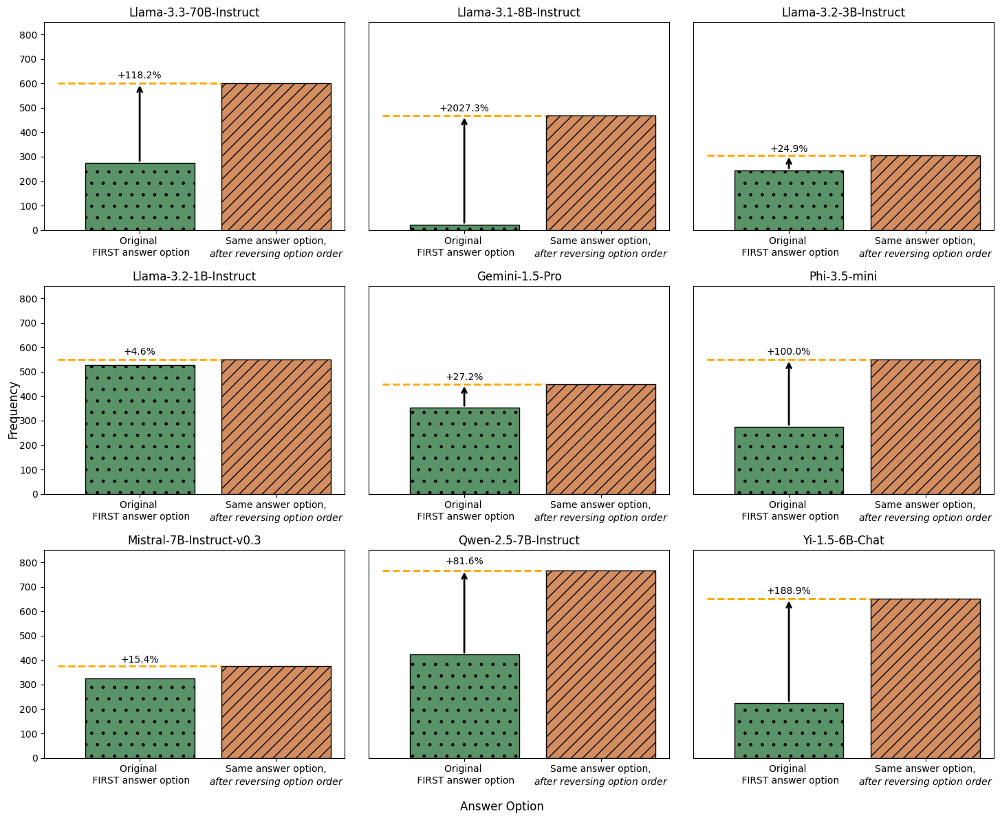

In [28]:
# Create a 3x3 subplot grid
fig, axes = plt.subplots(3, 3, figsize=(15, 12))  
axes = axes.flatten()  # Flatten to 1D array for easy iteration
count = 0
# Now I iterate over models and plot on respective subplot
for idx, model in enumerate(all_sorted_models):
    # Define original distribution (starts with 1.0)
    subset_baseline = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == base_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    base_fq = subset_baseline["extracted_response"].value_counts()

    # here I reversed distribution (starts with -1.0)
    subset_alternative = final_interviews_categorized[
        (final_interviews_categorized["Category"].isin(categories_range)) &
        (final_interviews_categorized["model_name"] == model) &
        (final_interviews_categorized["type"] == alt_distribution) &
        (~final_interviews_categorized["extracted_response"].isin(["nan"]))
    ]
    alternative_fq = subset_alternative["extracted_response"].value_counts()

    # then I extract the frequencies
    base_pos1 = base_fq.get("1.0", 0)
    alt_pos1 = alternative_fq.get("1.0", 0)

    # Calculate percentage increase for "1.0" option
    if base_pos1 > 0:  
        percentage_increase = ((alt_pos1 - base_pos1) / base_pos1) * 100
    else:
        percentage_increase = np.nan  # Avoid division by zero

    # Create DataFrame for plotting
    df = pd.DataFrame({
        'Value':  ["Original \n FIRST answer option", "Same answer option,\n" + r"$\mathit{after}$ $\mathit{reversing}$ $\mathit{option}$ $\mathit{order}$"],
        'Count': [base_pos1, alt_pos1]
        #'Answer Options': ['Original [1,...,-1]'] * 2 + ['Reversed [-1,...,1]'] * 2
    })

    # Plot in the respective subplot
    ax = sns.barplot(x='Value', y='Count', 
                #hue='Answer Options', 
                data=df, 
                #palette=['lightblue', 'bisque'], 
                ax=axes[idx])

    axes[idx].set_title(f"{model}")
    axes[idx].set_ylabel("")
    axes[idx].set_xlabel("")
    axes[idx].set_ylim(0,850)
    axes[idx].hlines(alt_pos1, xmin=-0.6, xmax=0.6, color="orange", linestyle="--", linewidth=2)
    # Create one dashed bar (only edges)
    ax.bar(0, base_pos1,color="#5A9367", edgecolor="black", hatch=".")

    # Create one hatched bar
    ax.bar(1, alt_pos1, color="#D38D5F", edgecolor="black", hatch="//")
    
    cols = [0,3,6]        
    if count not in cols:
        axes[idx].yaxis.set_visible(False)  # Hides entire y-axis
    # rows = [6,7,8]   
    # if count not in rows:
    #     axes[idx].xaxis.set_visible(False)  # Hides entire x-axis               
    # Display percentage increase as text on the plot (always shown)
    if not np.isnan(percentage_increase):
        axes[idx].text(0, alt_pos1 + max(df["Count"]) * 0.02,  # Slightly above the "Reversed" bar
                       f"+{percentage_increase:.1f}%", ha='center', va='bottom', fontsize=10, color='black')

    # Annotate with steep orange arrow and percentage increase
    if not np.isnan(percentage_increase) and percentage_increase > 20:
        x_base = 0  # "1.0" is at index 0
        y_base = base_pos1
        y_alt = alt_pos1
        #x_alt = 1 - 0.4
        
        # Create a steep arrow from the top of the baseline bar to the top of the alternative bar
        axes[idx].annotate("", 
                        xy=(x_base, y_base), xycoords="data",
                        xytext=(x_base, y_alt), textcoords="data",
                        arrowprops=dict(arrowstyle="<-", color="black", lw=2, 
                                connectionstyle="arc3,rad=0"),  # Steep curve
                                fontsize=12, color="black", ha="center", va="bottom")
    count += 1
# Adjust layout and show the figure
fig.supylabel("Frequency")
fig.supxlabel("Answer Option")
plt.tight_layout()
plt.savefig("../thesis/figures/h1_comparison_all_models_final.pdf", bbox_inches="tight")
plt.savefig("../thesis/figures/h1_comparison_all_models_final.png", bbox_inches="tight", transparent=True)
plt.show()


## Hypothesis 2: Opinion Floating - Item Nonresponse
Null-Hypothesis: "There is no significant difference in models answer patterns when given either the original or the options without refusal category"

Assumed Human Bias: "Large Language Models tend to respond with the refusal answer category when it is given like it has been found in human survey respondents"

### Test: Compare Mean and Variance for Original and Answer Options without Refusal Category
Here I compare the original answer options which include a refusal category and the one without a refusal category. Thereby I check whether the middle categories are chosen more often than in the setting with refusal category. Therefore I compare the frequency and variance in both settings.

1. Refer to all categories and models and subset the baseline and perturbed dataframe accordingly
2. Remove NaN and Refusal option to be able to calculate valid means and variances
3. Calculate "ideal center point" on the scale
4. Calculate Means and Variances for both distributions for each model and category (because they have different scales)
5. Calculate distances of original and perturbed distribution mean to the "ideal center point".
6. Calculate difference of distances to see whether perturbed distribution is closer to "ideal center point" than original
5. (Optionally create histograms to compare distribution)

In [29]:
import re
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_options"
alt_distribution = "list_answer_no_refusal"

results = []

for category in final_interviews_categorized["Category"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        mean_base = subset_baseline["extracted_response"].mean()
        var_base = subset_baseline["extracted_response"].var()
        std_base = subset_baseline["extracted_response"].std()
        
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        mean_alt = subset_alternative["extracted_response"].mean()
        var_alt = subset_alternative["extracted_response"].var()
        std_alt = subset_alternative["extracted_response"].std()
        
        # here I calculate the distance between the "ideal mean of the scale" and the mean in original/perturbed distribution
        distance_base = abs(orig_mean - mean_base)
        distance_alt = abs(orig_mean - mean_alt)
        # calculate if distance to the "ideal scale mean" gets shorter with perturbation
        # if distance_abs is positive, perturbation distribution (w/o refusal) is farer away from mean
        # if distance_abs is negative, perturbation distribution (w/o refusal) is closer to ideal mean
        distance_abs =  distance_alt - distance_base
        
        results.append([category, model, orig_mean, mean_base, var_base, std_base, mean_alt, var_alt, std_base, 
                        distance_base, distance_alt, distance_abs])

    column_names = ["Category", "Model", "Scale Mean", "With Refusal Mean", "With Refusal Variance",
                            "With Refusal Standard Deviation", "No Refusal Mean", "No Refusal Variance",
                            "No Refusal Standard Deviation", "Distance With Refusal", "Distance No Refusal",
                            "Absolute Change in Distance"]
    df_results = pd.DataFrame(results, columns=column_names)

In [30]:
# Define the categories and their corresponding column ranges
summarizing_categories = {
    "3-Point\nScale": (1, 3),
    "4-Point\nScale": (4, 7),  
    "5-Point\nScale": (8, 8),
    "10-Point\nScale": (9,10)
}

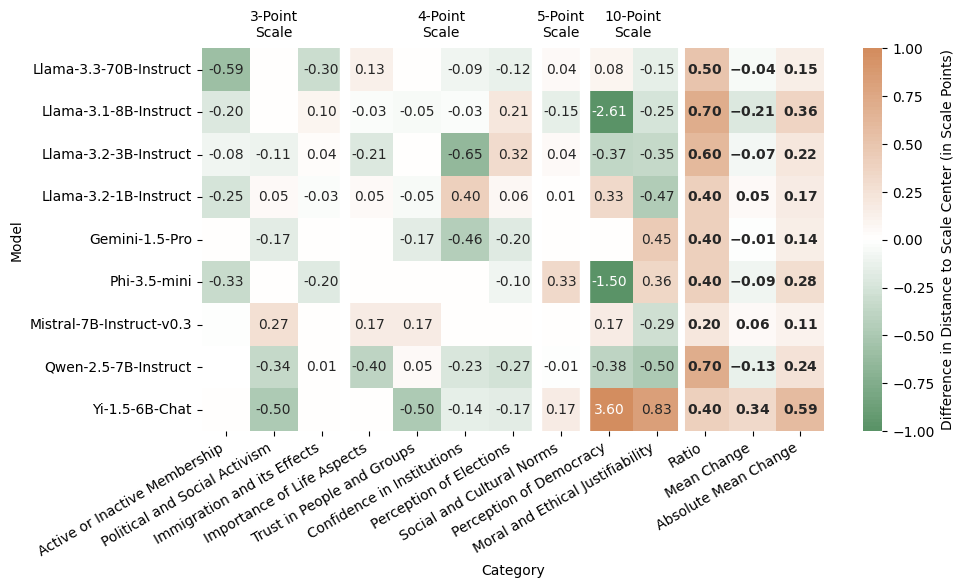

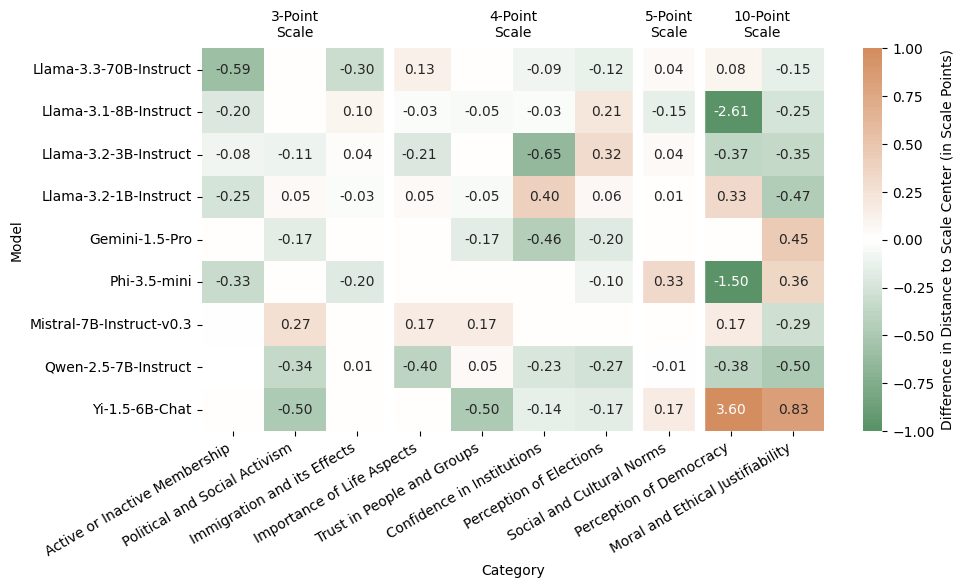

In [31]:
for i in ["mean", "blank"]:
    heatmap_data = df_results.pivot(index='Model', columns='Category', values='Absolute Change in Distance')
    heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)
    # Create a diverging colormap
    #cmap = sns.diverging_palette(130, 10, l=40, s=80, as_cmap=True)
    colors = ["#5A9367", "#ffffff", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    # Create annotation matrix: Replace 0.0 with empty strings
    if i == "mean":
        # Mittelwert pro Modell (Zeile) berechnen und als neue Spalte hinzufügen
        new_heatmap = abs(heatmap_data)
        
        neg_count = (heatmap_data < 0).sum(axis=1,skipna=True)
        # Compute the ratio
        heatmap_data["Ratio"] =  neg_count / 10
        heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)
        heatmap_data["Absolute Mean Change"] = new_heatmap.mean(axis=1)
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")
        annot_matrix["Mean Change"] = annot_matrix["Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        annot_matrix["Ratio"] = annot_matrix["Ratio"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        annot_matrix["Absolute Mean Change"] = annot_matrix["Absolute Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
    else:
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")

    # Plot heatmap
    plt.figure(figsize=(10, 6))
    ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0, cbar=True,
                     cbar_kws={'label': "Difference in Distance to Scale Center (in Scale Points)"},
                    vmax = 1,
                    vmin=-1
                     )
    if i == "mean":
        # Get the position where the vertical line should be drawn
        n_categories = len(heatmap_data.columns) - 3  # Excluding "Row Mean"
        ax.axvline(n_categories, color="white", linewidth=5)  # Draw before last column
        
    for p in categories_separator:
        ax.axvline(p, color="white", linewidth=7.5)
    # Set x-ticks for individual columns
    plt.xticks(rotation=30, ha = "right")       
    # Add summarizing ticks above the existing ticks
    for category, (start, end) in summarizing_categories.items():
        # Calculate the middle position of the category for the label
        middle_position = (start + end - 1) / 2  # Middle of the range
        ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
    plt.xlabel("Category")
    plt.ylabel("Model")
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/h2_{i}_heatmap.pdf")
    plt.savefig(f"../thesis/figures/h2_{i}_heatmap.png", transparent=True)
    plt.show()

Here I do the same by scale size.

In [32]:
sorted_scales = ["3-pt Likert Scale", '4-pt Likert Scale', '5-pt Likert Scale', '10-pt Likert Scale']

In [ ]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_options"
alt_distribution = "list_answer_no_refusal"

results = []

for category in final_interviews_categorized["Scale Type"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Scale Type"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        mean_base = subset_baseline["extracted_response"].mean()
        var_base = subset_baseline["extracted_response"].var()
        std_base = subset_baseline["extracted_response"].std()
        
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Scale Type"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        mean_alt = subset_alternative["extracted_response"].mean()
        var_alt = subset_alternative["extracted_response"].var()
        std_alt = subset_alternative["extracted_response"].std()
        
        # here I calculate the distance between the "ideal mean of the scale" and the mean in original/perturbed distribution
        distance_base = abs(orig_mean - mean_base)
        distance_alt = abs(orig_mean - mean_alt)
        # calculate if distance to the "ideal scale mean" gets shorter with perturbation
        # if distance_abs is positive, perturbation distribution (w/o refusal) is farer away from mean
        # if distance_abs is negative, perturbation distribution (w/o refusal) is closer to ideal mean
        distance_abs =  distance_alt - distance_base
        
        results.append([category, model, orig_mean, mean_base, var_base, std_base, mean_alt, var_alt, std_base, 
                        distance_base, distance_alt, distance_abs])

    column_names = ["Scale Type", "Model", "Scale Mean", "With Refusal Mean", "With Refusal Variance",
                            "With Refusal Standard Deviation", "No Refusal Mean", "No Refusal Variance",
                            "No Refusal Standard Deviation", "Distance With Refusal", "Distance No Refusal",
                            "Absolute Change in Distance"]
    df_results = pd.DataFrame(results, columns=column_names)

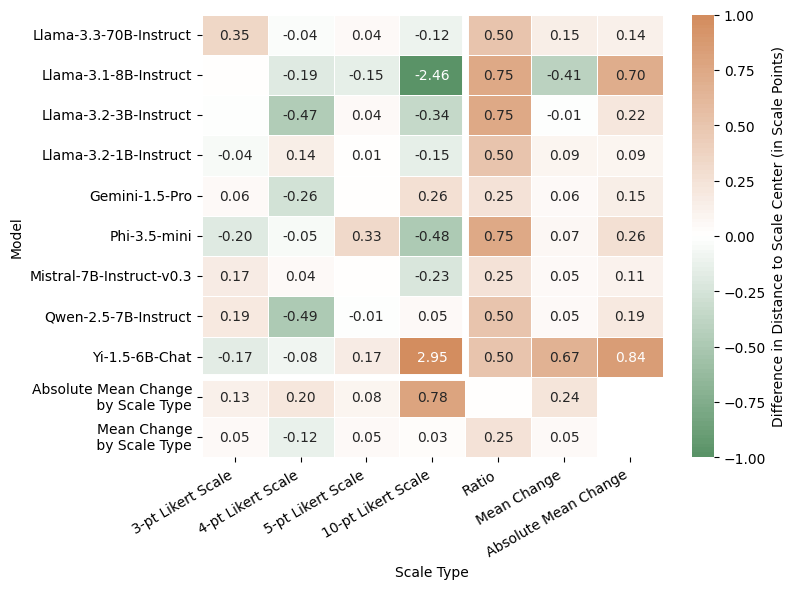

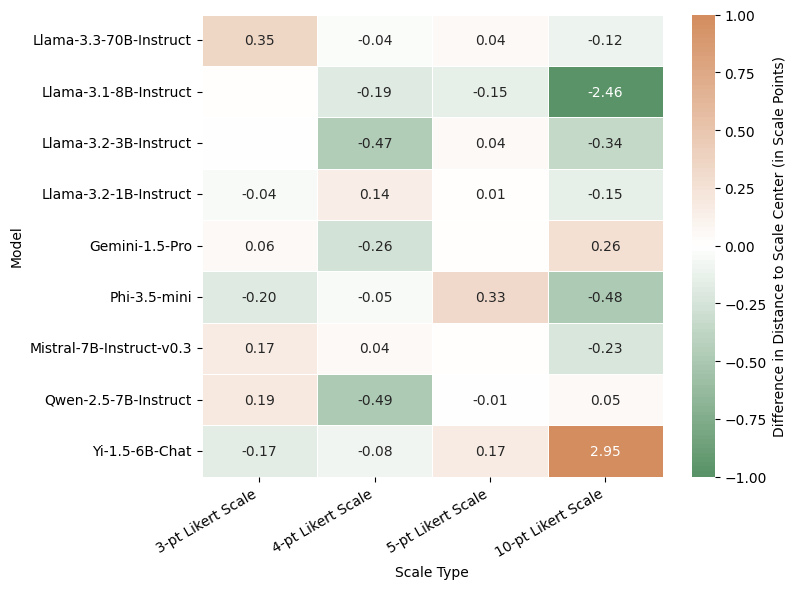

In [34]:
for i in ["mean", "blank"]:
    heatmap_data = df_results.pivot(index='Model', columns='Scale Type', values='Absolute Change in Distance')
    heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales)

    # Create a diverging colormap
    #cmap = sns.diverging_palette(150, 10, l=50, s=100, as_cmap=True)
    colors = ["#5A9367", "#ffffff", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    if i == "mean":
        # Mittelwert pro Modell (Zeile) berechnen und als neue Spalte hinzufügen
        new_heatmap = abs(heatmap_data)
        heatmap_data.loc["Absolute Mean Change\n by Scale Type"] = new_heatmap.mean(axis=0)
        heatmap_data.loc["Mean Change\n by Scale Type"] = heatmap_data.mean(axis=0)
        neg_count = (heatmap_data < 0).sum(axis=1,skipna=True)
        # Compute the ratio
        heatmap_data["Ratio"] =  neg_count / 4
        heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)
        heatmap_data["Absolute Mean Change"] = new_heatmap.mean(axis=1)
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")
        #annot_matrix["Mean Change"] = annot_matrix["Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        #annot_matrix["Ratio"] = annot_matrix["Ratio"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        #annot_matrix["Absolute Mean Change"] = annot_matrix["Absolute Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
    else:
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")

    # Plot heatmap
    plt.figure(figsize=(8, 6))
    ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, cbar=True,
                     cbar_kws={'label': "Difference in Distance to Scale Center (in Scale Points)"},
                     vmin=-1,
                     vmax=1
                     )
    #plt.title("Mean Change in Distance towards the Scale Middle")

    if i == "mean":
        # Get the position where the vertical line should be drawn
        n_categories = len(heatmap_data.columns) - 3  # Excluding "Row Mean"
        ax.axvline(n_categories, ymax=1,ymin= 0.185, color="white", linewidth=5)  # Draw before last column
        ax.axhline(9, xmin=0.0, xmax=0.57, color="white", linewidth=5)
    plt.xlabel("Scale Type")
    plt.ylabel("Model")
    plt.xticks(rotation=30, ha = "right")
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/h2_scaletype_{i}_heatmap.pdf")
    plt.savefig(f"../thesis/figures/h2_scaletype_{i}_heatmap.png", transparent = True)
    plt.show()

## Hypothesis 3: Odd/Even-Scales - Central Tendency Bias
Null-Hypothesis: "There is no significant difference in models answer patterns when presented with either the answer options with or without a middle category"

Assumed Human Bias: "Large Language Models tend to respond with the middle category in the answer options like it has been found in human survey respondents as a way of satisficing."

### Test: Compare Mean and Variance for Answer Options with and without Middle Category
Here I compare the answer options with and without a middle category. Thereby I check whether the middle categories are chosen more often than in the setting with refusal category. Therefore I compare the frequency and variance in both settings.

1. Use all categories because all categories contain middle and no middle answer scales (with refusal options) and models
2. Remove NaN and Refusal option to be able to calculate valid means and variances
3. Calculate "ideal center point" on the scale
4. Calculate Means and Variances for both distributions for each model and category (because they have different scales)
5. Calculate distances of original and perturbed distribution mean to the "ideal center point".
6. Calculate difference of distances to see whether perturbed distribution is closer to "ideal center point" than original
5. (Optionally create histograms to compare distribution)

In [35]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"

results = []

for category in final_interviews_categorized["Category"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        mean_base = subset_baseline["extracted_response"].mean()
        var_base = subset_baseline["extracted_response"].var()
        std_base = subset_baseline["extracted_response"].std()
        
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        mean_alt = subset_alternative["extracted_response"].mean()
        var_alt = subset_alternative["extracted_response"].var()
        std_alt = subset_alternative["extracted_response"].std()
        
        # here I calculate the distance between the "ideal mean of the scale" and the mean in original/perturbed distribution
        distance_base = abs(orig_mean - mean_base)
        distance_alt = abs(orig_mean - mean_alt)
        # calculate if distance to the "ideal scale mean" gets shorter with perturbation
        # if distance_abs is positive, distribution with middle category is farer away from center
        # if distance_abs is negative, distribution with middle category is closer to center
        distance_abs =  distance_base - distance_alt 
        
        results.append([category, model, orig_mean, mean_base, var_base, std_base, mean_alt, var_alt, std_base, 
                        distance_base, distance_alt, distance_abs])

    column_names = ["Category", "Model", "Scale Mean", "Odd Scale Mean", "Odd Scale Variance",
                            "Odd Scale Standard Deviation", "Even Scale Mean", "Even Scale Variance",
                            "Even Scale Standard Deviation", "Distance Odd Scale", "Distance Even Scale",
                            "Absolute Change in Distance"]
    df_results = pd.DataFrame(results, columns=column_names)

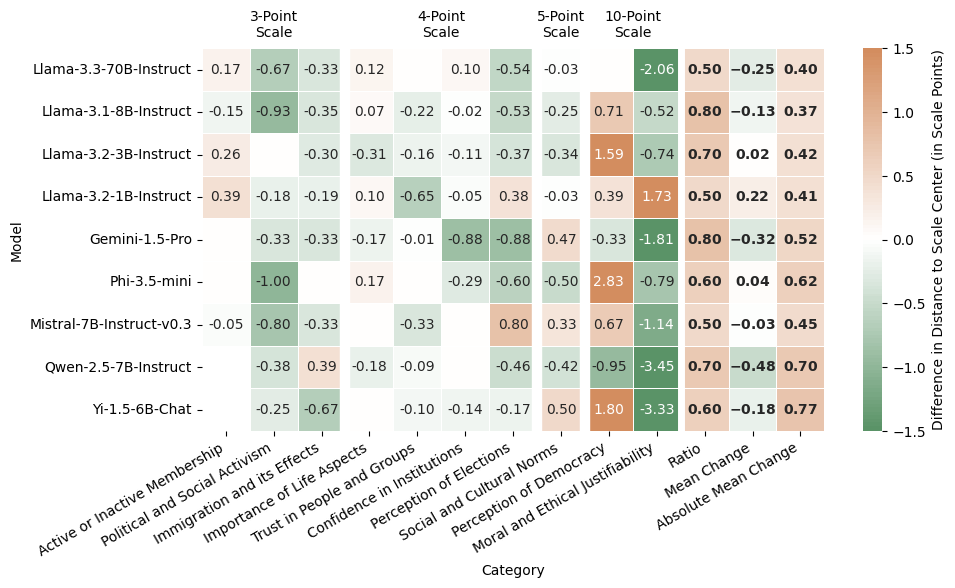

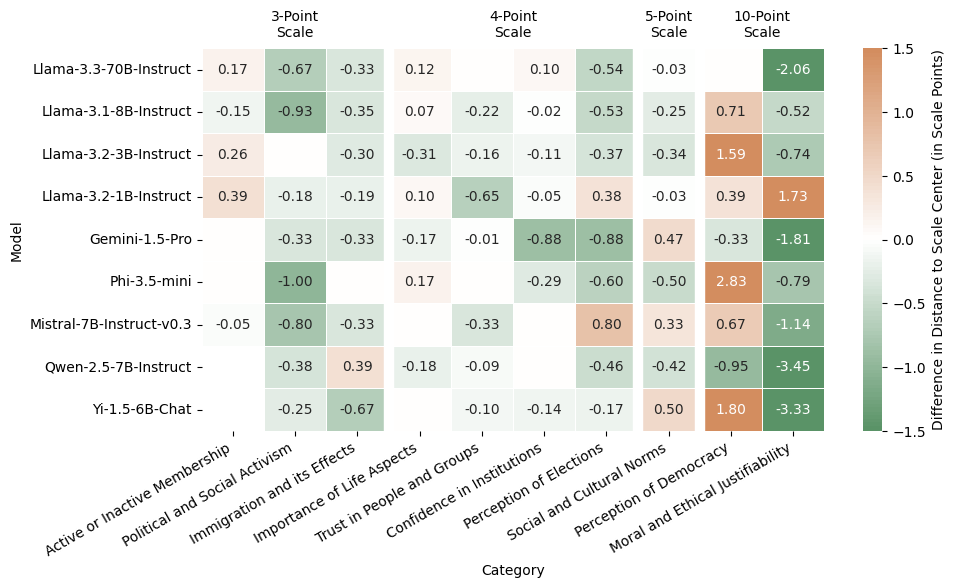

In [36]:
for i in ["mean", "blank"]:
    heatmap_data = df_results.pivot(index='Model', columns='Category', values='Absolute Change in Distance')
    heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

    # Mittelwert pro Modell (Zeile) berechnen und als neue Spalte hinzufügen
    #heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)

    colors = ["#5A9367", "#ffffff", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    # Create annotation matrix: Replace 0.0 with empty strings
    if i == "mean":
        # Mittelwert pro Modell (Zeile) berechnen und als neue Spalte hinzufügen
        new_heatmap = abs(heatmap_data)
        
        neg_count = (heatmap_data < 0).sum(axis=1,skipna=True)
        # Compute the ratio
        heatmap_data["Ratio"] =  neg_count / 10
        heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)
        heatmap_data["Absolute Mean Change"] = new_heatmap.mean(axis=1)
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")
        annot_matrix["Mean Change"] = annot_matrix["Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        annot_matrix["Ratio"] = annot_matrix["Ratio"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        annot_matrix["Absolute Mean Change"] = annot_matrix["Absolute Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
    else:
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")

    # Plot heatmap
    plt.figure(figsize=(10, 6))
    ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "Difference in Distance to Scale Center (in Scale Points)"},
                    vmax=1.5,
                    vmin=-1.5)
    if i == "mean":
        # Get the position where the vertical line should be drawn
        n_categories = len(heatmap_data.columns) - 3  # Excluding "Row Mean"
        ax.axvline(n_categories, color="white", linewidth=5)  # Draw before last column
    for p in categories_separator:
        ax.axvline(p, color="white", linewidth = 7.5)
    # Set x-ticks for individual columns
    plt.xticks(rotation=30, ha = "right")       
    # Add summarizing ticks above the existing ticks
    for category, (start, end) in summarizing_categories.items():
        # Calculate the middle position of the category for the label
        middle_position = (start + end - 1) / 2  # Middle of the range
        ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
    plt.xlabel("Category")
    plt.ylabel("Model")
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/h3_{i}_heatmap.pdf")
    plt.savefig(f"../thesis/figures/h3_{i}_heatmap.png", transparent = True)
    plt.show()

Include statistical test for the central tendency.

In [ ]:
import scipy.stats as stats

def test_middle_category_proportion(odd_responses, center = int, scale_range = list):
    """
    Perform a binomial test to check if the middle category is selected more often than expected.
    """
    middle_category = center  # Assuming 5-point scale is [1, 2, 3, 4, 5]
    total_responses = len(odd_responses)
    middle_count = np.sum(np.array(odd_responses) == middle_category)
    expected_proportion = 1 / len(scale_range)  # Assuming uniform distribution
    
    # Binomial test
    binom_p = stats.binomtest(middle_count, total_responses, expected_proportion, alternative='greater')
    #print(f"Middle category proportion test p-value: {binom_p:.4f}")
    #print(middle_category, total_responses, middle_count, expected_proportion)
    return binom_p

def test_variance_difference(odd_responses, even_responses):
    """
    Compare the variance between the two response distributions using Levene’s test.
    """
    levene_p = stats.levene(odd_responses, even_responses).pvalue
    #print(f"Levene’s test for variance p-value: {levene_p:.4f}")
    return levene_p

In [38]:
base_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"

results = []

for category in final_interviews_categorized["Category"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        # Test for central tendency bias
        #print(f"Binomial Test for {category}, {model}: ", test_middle_category_proportion(odd_responses=subset_baseline["extracted_response"], center=orig_mean, scale_range = positive_integers))
        #print(f"Levene’s Variance Test for {category}, {model}: ", test_variance_difference(odd_responses=subset_baseline["extracted_response"], even_responses=subset_alternative["extracted_response"]))
        
        test_midcat_prop = test_middle_category_proportion(odd_responses=subset_baseline["extracted_response"], center=orig_mean, scale_range = positive_integers)
        test_levenes_variance_difference = test_variance_difference(odd_responses=subset_baseline["extracted_response"], even_responses=subset_alternative["extracted_response"])
        results.append([category, model, test_midcat_prop.pvalue, test_levenes_variance_difference])

    column_names = ["Category", "Model", "Binomial Test ('middle category more often selected')", "Levene’s test for variance"]
    df_results = pd.DataFrame(results, columns=column_names)

c:\Users\ruppr\OneDrive - Universität Mannheim\Master thesis\HuBiLa\hubila\Lib\site-packages\scipy\stats\_morestats.py:3361: RuntimeWarning:

invalid value encountered in scalar divide

c:\Users\ruppr\OneDrive - Universität Mannheim\Master thesis\HuBiLa\hubila\Lib\site-packages\scipy\stats\_morestats.py:3361: RuntimeWarning:

invalid value encountered in scalar divide

c:\Users\ruppr\OneDrive - Universität Mannheim\Master thesis\HuBiLa\hubila\Lib\site-packages\scipy\stats\_morestats.py:3361: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\581393450.py:23: SmallSampleWarning:

One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.

c:\Users\ruppr\OneDrive - Universität Mannheim\Master thesis\HuBiLa\hubila\Lib\site-packages\scipy\stats\_morestats.py:3361: RuntimeWarning:

divide by zero encountered in scalar divide

c:\Users\ruppr\OneDrive - Universität Mann

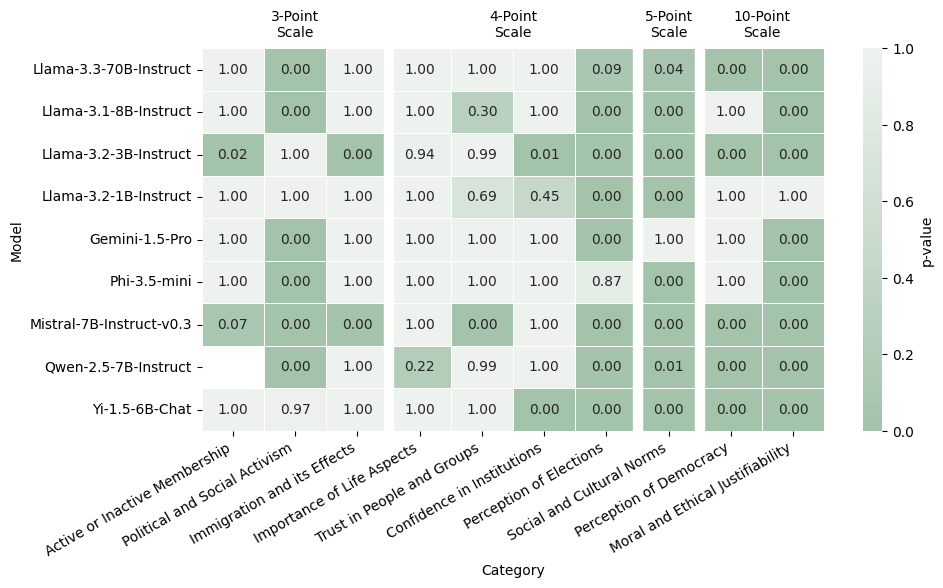

In [39]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Binomial Test ('middle category more often selected')")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

# Create a diverging colormap
cmap = sns.light_palette("#5A9367", reverse=True, n_colors= 100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")

    # Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "p-value"},
                    #vmax=2.95,
                    #vmin=-2.95
                    )
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5) 
# Set x-ticks for individual columns
plt.xticks(rotation=30, ha = "right")       
# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
plt.xlabel("Category")
plt.ylabel("Model")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_bintest_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_bintest_heatmap.png", transparent = True)
plt.show()

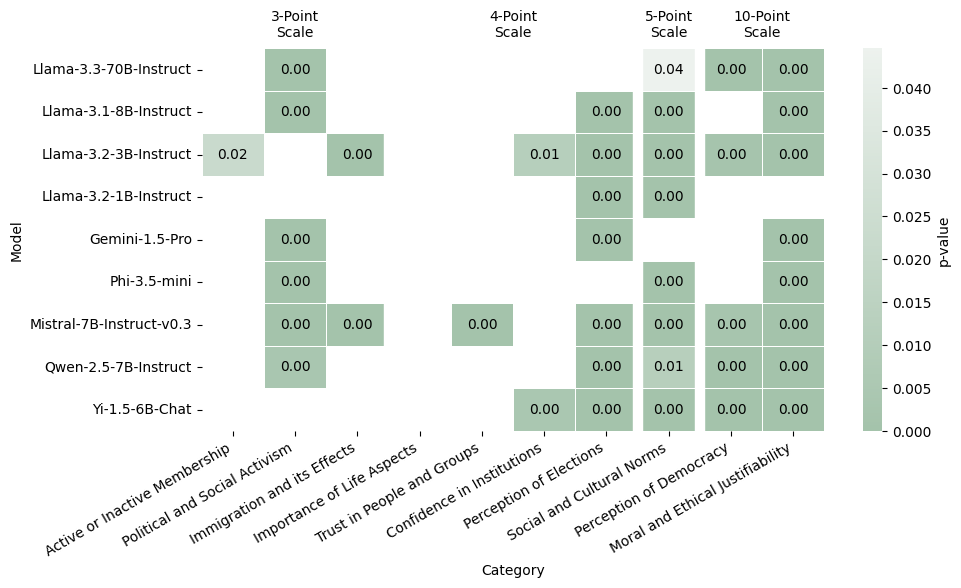

In [40]:
# Pivot and reindex the data
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Binomial Test ('middle category more often selected')")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

# Create a custom colormap
cmap = sns.light_palette("#5A9367", n_colors=1, as_cmap=True, reverse=True)

# Create a mask for values >= 0.05
mask = heatmap_data >= 0.05

# Create the annotation matrix
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")

# Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                 linewidths=0.5, 
                 cbar=True,
                 cbar_kws={'label': "p-value"},
                 mask=mask,
                 annot_kws={"color": "black"})  # Set annotation text color to black

# Add white color to the masked cells
ax.set_facecolor("white")

# Add vertical lines for category separators
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5) 

# Set x-ticks for individual columns
plt.xticks(rotation=30, ha="right")       

# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed

plt.xlabel("Category")
plt.ylabel("Model")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_bintest_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_bintest_heatmap.png", transparent = True)
plt.show()

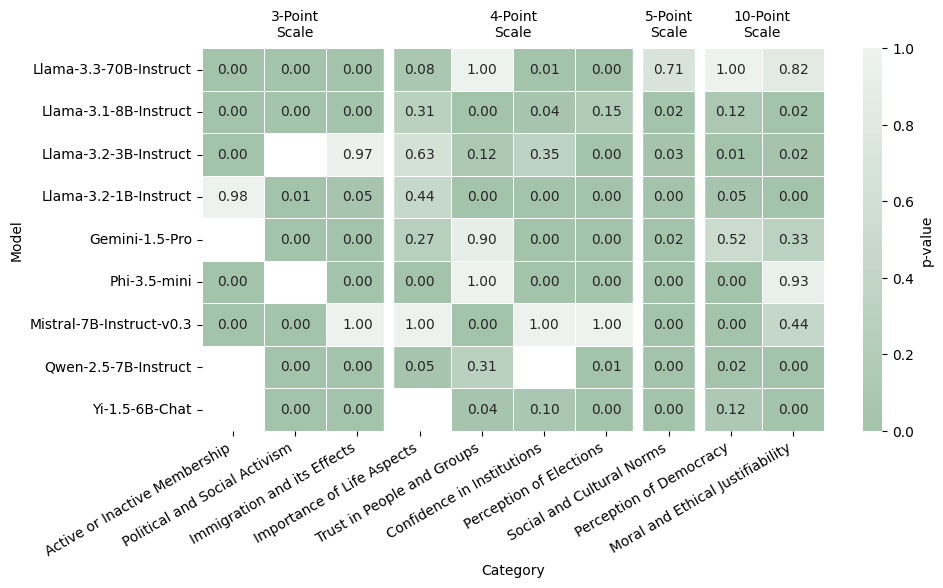

In [41]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Levene’s test for variance")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

# Create a diverging colormap
cmap = sns.light_palette("#5A9367", reverse=True, n_colors=100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")

    # Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "p-value"},
                    #vmax=2.95,
                    #vmin=-2.95
                    )
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5) 
plt.xlabel("Category")
plt.ylabel("Model")
# Set x-ticks for individual columns
plt.xticks(rotation=30, ha = "right")       
# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_levenestest_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_levenestest_heatmap.png", transparent = True)
plt.show()

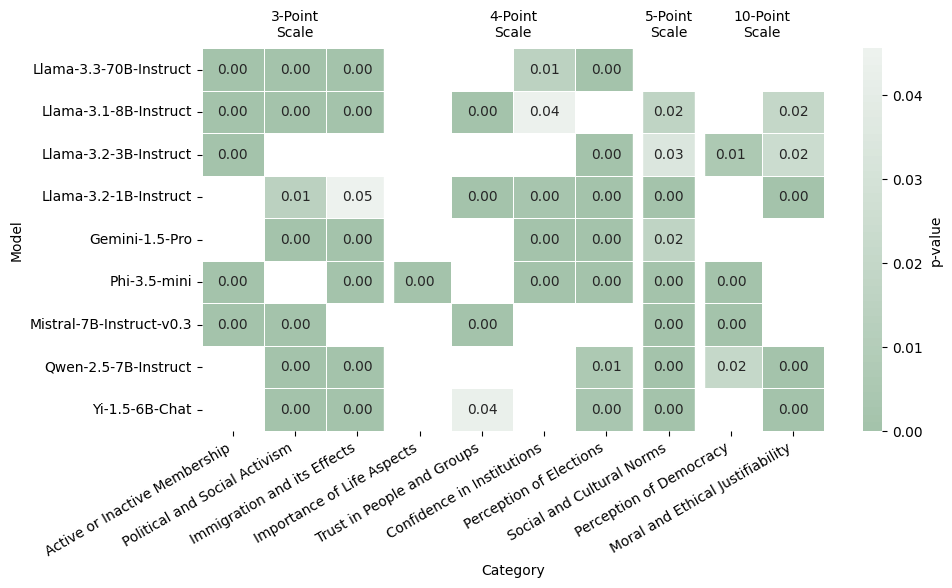

In [42]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Levene’s test for variance")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

# Create a diverging colormap
cmap = sns.light_palette("#5A9367", reverse=True, n_colors=100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")

mask =  heatmap_data >= 0.05
    # Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "p-value"},
                    mask=mask
                    )
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5) 
plt.xlabel("Category")
plt.ylabel("Model")
# Set x-ticks for individual columns
plt.xticks(rotation=30, ha = "right")       
# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_levenestest_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_levenestest_heatmap.png", transparent = True)
plt.show()

Here I differentiate by scale type, not by thematic category.

First we adapt the scale types, because 4-likert and 5-likert scale in the original WVS leads to the same setup because for the prior one middle category is added whereas for the latter the middle category is removed. Therefore these are combined named "4-pt Likert Scale"

In [43]:
type_dict_new = {'Importance of Life Aspects': "4-pt Likert Scale",
            'Social and Cultural Norms': "4-pt Likert Scale",
            'Trust in People and Groups': "4-pt Likert Scale", 
            'Confidence in Institutions': "4-pt Likert Scale",
            'Active or Inactive Membership': "3-pt Likert Scale", 
            'Immigration and its Effects': "3-pt Likert Scale",
            'Moral and Ethical Justifiability': "10-pt Likert Scale",
            'Political and Social Activism': "3-pt Likert Scale",
            'Perception of Elections': "4-pt Likert Scale",
            'Perception of Democracy': "10-pt Likert Scale"
    
}
sorted_scales_new = ["3-pt Likert Scale", '4-pt Likert Scale', '10-pt Likert Scale']
final_interviews_categorized["Scale Type Middle"] = final_interviews_categorized["Category"].map(type_dict_new).fillna("Unknown")

In [44]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"

results = []

for category in final_interviews_categorized["Scale Type Middle"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Scale Type Middle"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        mean_base = subset_baseline["extracted_response"].mean()
        var_base = subset_baseline["extracted_response"].var()
        std_base = subset_baseline["extracted_response"].std()
        
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Scale Type Middle"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        mean_alt = subset_alternative["extracted_response"].mean()
        var_alt = subset_alternative["extracted_response"].var()
        std_alt = subset_alternative["extracted_response"].std()
        
        # here I calculate the distance between the "ideal mean of the scale" and the mean in original/perturbed distribution
        distance_base = abs(orig_mean - mean_base)
        distance_alt = abs(orig_mean - mean_alt)
        # calculate if distance to the "ideal scale mean" gets shorter with perturbation
        # if distance_abs is positive, distribution with middle category is farer away from center
        # if distance_abs is negative, distribution with middle category is closer to center
        distance_abs =  distance_base - distance_alt 
        
        results.append([category, model, orig_mean, mean_base, var_base, std_base, mean_alt, var_alt, std_base, 
                        distance_base, distance_alt, distance_abs])

    column_names = ["Scale Type Middle", "Model", "Scale Mean", "Odd Scale Mean", "Odd Scale Variance",
                            "Odd Scale Standard Deviation", "Even Scale Mean", "Even Scale Variance",
                            "Even Scale Standard Deviation", "Distance Odd Scale", "Distance Even Scale",
                            "Absolute Change in Distance"]
    df_results = pd.DataFrame(results, columns=column_names)

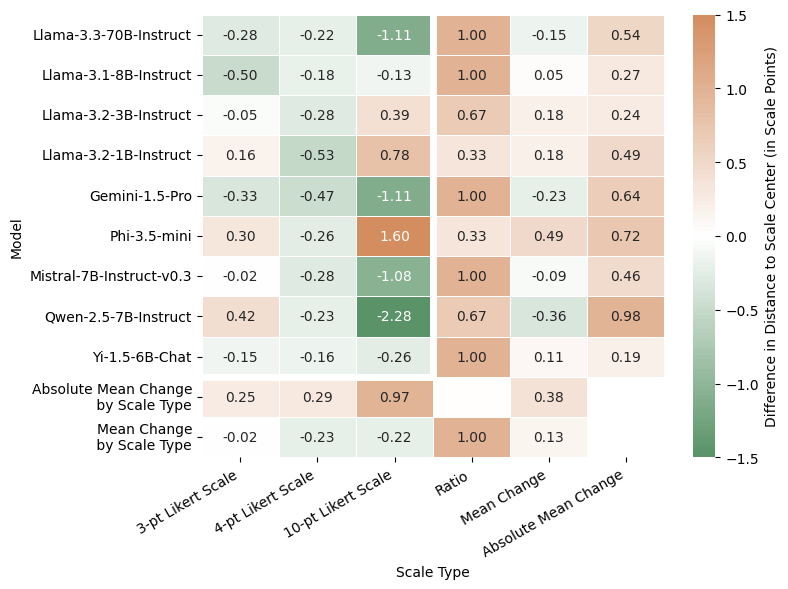

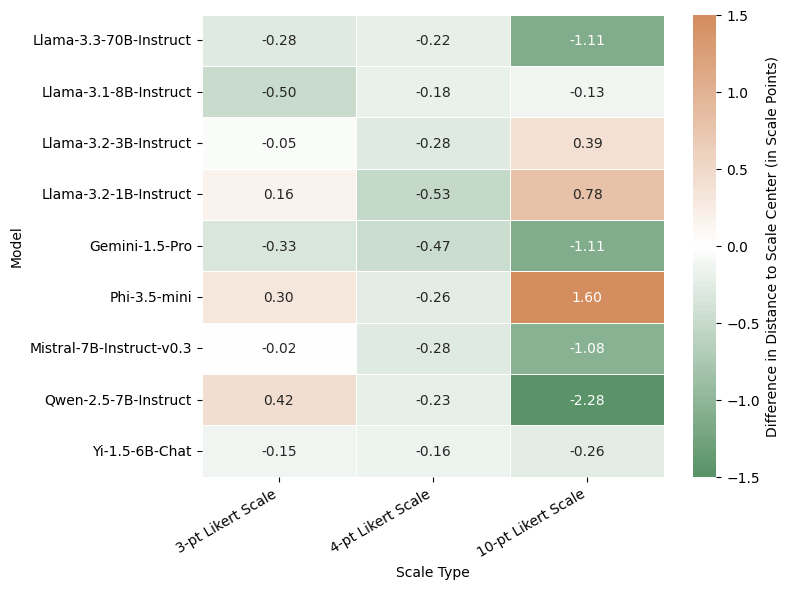

In [45]:
for i in ["mean", "blank"]:
    heatmap_data = df_results.pivot(index='Model', columns='Scale Type Middle', values='Absolute Change in Distance')
    heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales_new)

    #heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)
    # Create a diverging colormap
    colors = ["#5A9367", "#ffffff", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    if i == "mean":
        # Mittelwert pro Modell (Zeile) berechnen und als neue Spalte hinzufügen
        new_heatmap = abs(heatmap_data)
        heatmap_data.loc["Absolute Mean Change\n by Scale Type"] = new_heatmap.mean(axis=0)
        heatmap_data.loc["Mean Change\n by Scale Type"] = heatmap_data.mean(axis=0)
        neg_count = (heatmap_data < 0).sum(axis=1,skipna=True)
        # Compute the ratio
        heatmap_data["Ratio"] =  neg_count / 3
        heatmap_data["Mean Change"] = heatmap_data.mean(axis=1)
        heatmap_data["Absolute Mean Change"] = new_heatmap.mean(axis=1)
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")
        #annot_matrix["Mean Change"] = annot_matrix["Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        #annot_matrix["Ratio"] = annot_matrix["Ratio"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
        #annot_matrix["Absolute Mean Change"] = annot_matrix["Absolute Mean Change"].apply(lambda x: f"$\\mathbf{{{x}}}$" if x else "")
    else:
        annot_matrix = heatmap_data.copy()
        annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0 else f"{x:.2f}")#.map(lambda x: f"$\\mathbf{{{x}}}$" if x else "")


    # Plot heatmap
    plt.figure(figsize=(8, 6))
    ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "Difference in Distance to Scale Center (in Scale Points)"},
                    vmax=1.5,
                    vmin=-1.5)

    if i == "mean":
        # Get the position where the vertical line should be drawn
        n_categories = len(heatmap_data.columns) - 3  # Excluding "Row Mean"
        ax.axvline(n_categories, ymax=1,ymin= 0.185, color="white", linewidth=5)  # Draw before last column
        ax.axhline(9, xmin=0.0, xmax=0.5, color="white", linewidth=5)
    #plt.title("Mean Change in Distance towards the Scale Middle")
    plt.xlabel("Scale Type")
    plt.ylabel("Model")
    plt.xticks(rotation=30, ha="right")
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/h3_{i}_scaletype_heatmap.pdf")
    plt.savefig(f"../thesis/figures/h3_{i}_scaletype_heatmap.png", transparent = True)
    plt.show()

In [46]:
type_dict_middle = {'Importance of Life Aspects': "5-pt Likert Scale",
            'Social and Cultural Norms': "5-pt Likert Scale",
            'Trust in People and Groups': "5-pt Likert Scale", 
            'Confidence in Institutions': "5-pt Likert Scale",
            'Active or Inactive Membership': "3-pt Likert Scale", 
            'Immigration and its Effects': "3-pt Likert Scale",
            'Moral and Ethical Justifiability': "11-pt Likert Scale",
            'Political and Social Activism': "3-pt Likert Scale",
            'Perception of Elections': "5-pt Likert Scale",
            'Perception of Democracy': "11-pt Likert Scale"
    
}
sorted_scales_middle = ["3-pt Likert Scale", '5-pt Likert Scale', '11-pt Likert Scale']
final_interviews_categorized["Scale with Middle"] = final_interviews_categorized["Category"].map(type_dict_middle).fillna("Unknown")

In [47]:
base_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"

results = []

for category in final_interviews_categorized["Scale with Middle"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Scale with Middle"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan","-1.0"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        # get "real middle point"
        try:
            example = subset_baseline["answer_options"][0]
        except: 
            continue
        all_integers = [int(num) for num in re.findall(r'-?\d+', example)]
        # I filter out any non-positive integers
        positive_integers = pd.Series([num for num in all_integers if num >= 0])
        orig_mean = positive_integers.mean()
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Scale with Middle"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) &
            (~final_interviews_categorized["extracted_response"].isin(["nan", "-1.0"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        # Test for central tendency bias
        #print(f"Binomial Test for {category}, {model}: ", test_middle_category_proportion(odd_responses=subset_baseline["extracted_response"], center=orig_mean, scale_range = positive_integers))
        #print(f"Levene’s Variance Test for {category}, {model}: ", test_variance_difference(odd_responses=subset_baseline["extracted_response"], even_responses=subset_alternative["extracted_response"]))
        var_odd = np.var(subset_baseline["extracted_response"], ddof=1)  # Sample variance
        var_even = np.var(subset_alternative["extracted_response"], ddof=1)
        test_midcat_prop = test_middle_category_proportion(odd_responses=subset_baseline["extracted_response"], center=orig_mean, scale_range = positive_integers)
        test_levenes_variance_difference = test_variance_difference(odd_responses=subset_baseline["extracted_response"], even_responses=subset_alternative["extracted_response"])
        results.append([category, model, test_midcat_prop.pvalue, test_levenes_variance_difference, var_odd, var_even])

    column_names = ["Category", "Model", "Binomial Test ('middle category more often selected')", "Levene’s test for variance", "Variance Odd Scale", "Variance Even Scale"]
    df_results = pd.DataFrame(results, columns=column_names)
    df_results["Variance: Odd < Even"] = df_results["Variance Odd Scale"]  <  df_results["Variance Even Scale"]
    df_results["Variance Difference"] = df_results["Variance Odd Scale"] -  df_results["Variance Even Scale"]

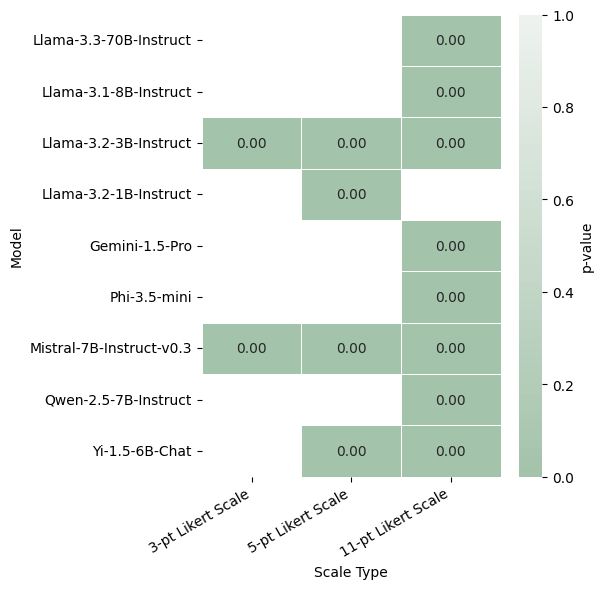

In [48]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Binomial Test ('middle category more often selected')")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales_middle)
# Create a diverging colormap
cmap = sns.light_palette("#5A9367", reverse=True, n_colors=100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")
mask = heatmap_data >= 0.05
    # Plot heatmap
plt.figure(figsize=(6, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "p-value"},
                    vmax=1,
                    vmin=0,
                    mask=mask
                    )

plt.xlabel("Scale Type")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_bintest_scaletype_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_bintest_scaletype_heatmap.png", transparent = True)
plt.show()

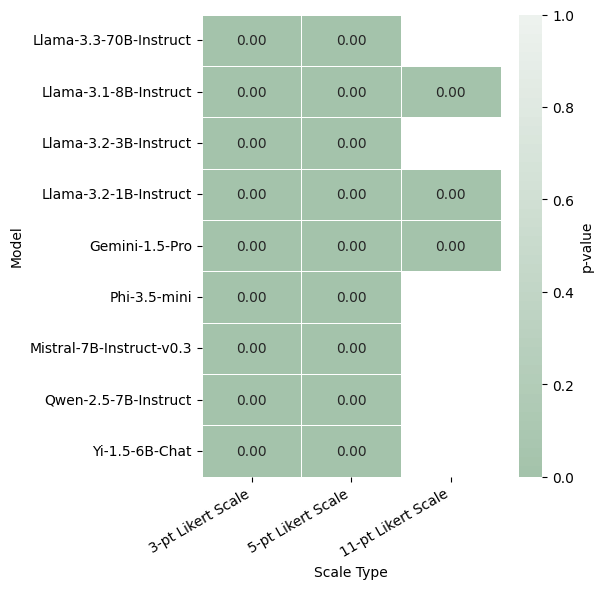

In [49]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Levene’s test for variance")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales_middle)

# Create a diverging colormap
cmap = sns.light_palette("#5A9367", reverse=True, n_colors=100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")
mask = heatmap_data >=0.05
    # Plot heatmap
plt.figure(figsize=(6, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "p-value"},
                    vmax=1,
                    vmin=0,
                    mask=mask
                    )
plt.xlabel("Scale Type")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_levenestest_scaletype_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_levenestest_scaletype_heatmap.png", transparent = True)
plt.show()

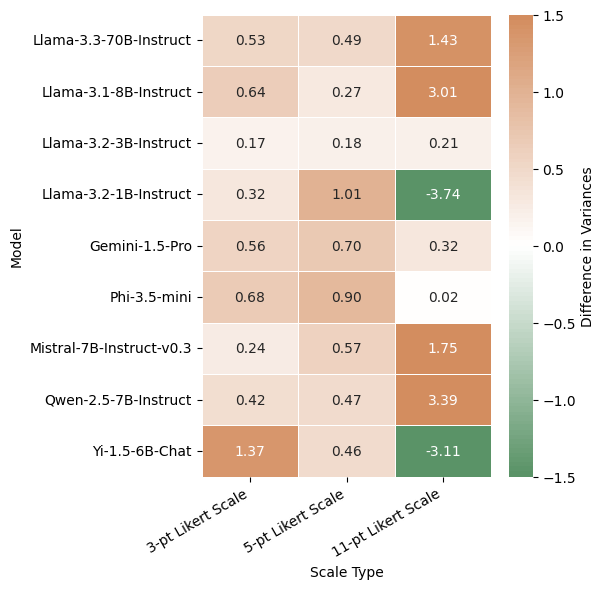

In [50]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values="Variance Difference")
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales_middle)

colors = ["#5A9367", "#ffffff", "#D38D5F"]
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: f"{x:.2f}")

    # Plot heatmap
plt.figure(figsize=(6, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, 
                    center=0, annot=annot_matrix, fmt="", 
                    linewidths=0.5, 
                    cbar=True,
                    cbar_kws={'label': "Difference in Variances"},
                    vmax=1.5,
                    vmin=-1.5,
                    #mask=mask
                    )
plt.xlabel("Scale Type")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h3_vardiff_scaletype_heatmap.pdf")
plt.savefig(f"../thesis/figures/h3_vardiff_scaletype_heatmap.png", transparent=True)
plt.show()

## Hypothesis 4: Emotional Priming - Item Nonresponse


### Test: Compare Frequency of Refusals between Original and Primed Perturbation
Here I compare the answer options with and without priming added to the prompt. Thereby I check whether the refusal category is used less often than in the setting without priming. Therefore I compare the frequency in both settings.

1. Use all categories because all categories contain original and primed answer scales and models
2. Remove NaN option
3. Calculate frequencies for refusals for both distributions
4. Calculate difference of frequencies to see whether perturbed distribution renders less refusals than original
5. (Optionally create histograms to compare distribution)

In [51]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_options"
alt_distribution = "original_emotional_prime"

results = []

for category in final_interviews_categorized["Category"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution)# &
            #(~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        refusal_base = len(subset_baseline[subset_baseline["extracted_response"] == -1.0])/len(subset_baseline)
        nan_base = len(subset_baseline[subset_baseline["extracted_response"].isna()])/len(subset_baseline)
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Category"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) #&
            #(~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        refusal_alt = len(subset_alternative[subset_alternative["extracted_response"] == -1.0])/len(subset_alternative)
        nan_alt = len(subset_alternative[subset_alternative["extracted_response"].isna()])/len(subset_alternative)
        
        # positive number indicates that refusal/nan share is higher in perturbation
        # negative numbers indicates that refusal/nan share is lower in perturbation
        change_refusal = refusal_alt - refusal_base 
        change_nan = nan_alt - nan_base
        
        results.append([category, model, refusal_base, nan_base, refusal_alt, nan_alt, change_refusal, change_nan])


column_names = ["Category", "Model", "Original Share of Refusals", "Original NaN", "Primed Share of Refusals", 
                "Primed NaN", "Change in Refusal", "Change in NaN"]
df_results = pd.DataFrame(results, columns=column_names)


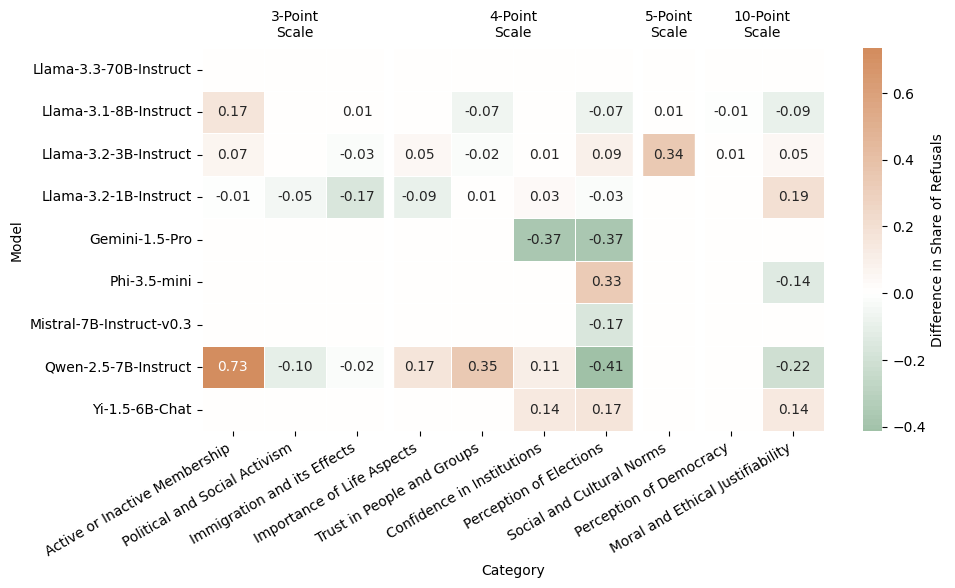

In [52]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values='Change in Refusal')
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_categories)

colors = ["#5A9367", "#ffffff", "#D38D5F"]
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
# Create annotation matrix: Replace 0.0 with empty strings
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0.0 else f"{x:.2f}")
# Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, cbar=True, cbar_kws={'label': "Difference in Share of Refusals"},)
#plt.title("Difference in Refusals between Original and Priming Perturbation")
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5)
    # Set x-ticks for individual columns
plt.xticks(rotation=30, ha = "right")       
# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
plt.xlabel("Category")
plt.ylabel("Model")
#plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h4_refusal_heatmap.pdf")
plt.savefig(f"../thesis/figures/h4_refusal_heatmap.png", transparent = True)
plt.show()

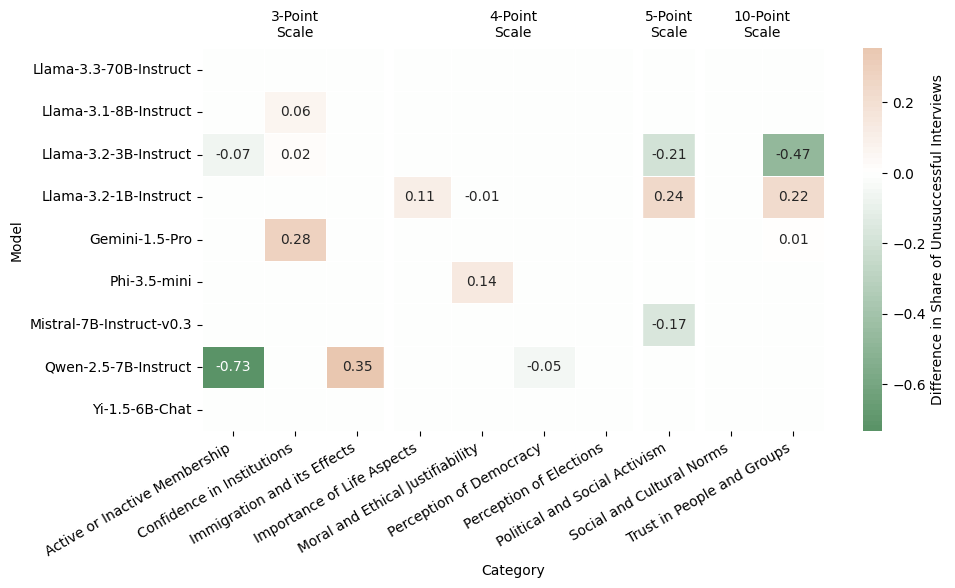

In [53]:
heatmap_data = df_results.pivot(index='Model', columns='Category', values='Change in NaN')
heatmap_data = heatmap_data.reindex(all_sorted_models)

colors = ["#5A9367", "#ffffff", "#D38D5F"]
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
# Create annotation matrix: Replace 0.0 with empty strings
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0.0 else f"{x:.2f}")

# Plot heatmap
plt.figure(figsize=(10, 6))
ax = sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, cbar=True, cbar_kws={'label': "Difference in Share of Unusuccessful Interviews"})
#plt.title("Difference in Refusals between Original and Priming Perturbation")
for i in categories_separator:
    ax.axvline(i, color="white", linewidth=7.5)
# Set x-ticks for individual columns
plt.xticks(rotation=30, ha = "right")       
# Add summarizing ticks above the existing ticks
for category, (start, end) in summarizing_categories.items():
    # Calculate the middle position of the category for the label
    middle_position = (start + end - 1) / 2  # Middle of the range
    ax.text(middle_position, -0.2, category, ha="center", va="bottom", fontsize=10, color="black")  # Adjust y-position as needed
plt.xlabel("Category")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h4_nan_heatmap.pdf")
plt.savefig(f"../thesis/figures/h4_nan_heatmap.png", transparent=True)
plt.show()

Here I separate by Scale Type not by Category!

In [54]:
# for each category calculate difference in -1 and 1 frequency
base_distribution = "list_answer_options"
alt_distribution = "original_emotional_prime"

results = []

for category in final_interviews_categorized["Scale Type"].unique():
    for model in all_sorted_models: 
        # define original distribution (starts with 1.0)
        subset_baseline = final_interviews_categorized[
            (final_interviews_categorized["Scale Type"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == base_distribution)# &
            #(~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ].reset_index()
        subset_baseline["extracted_response"] = subset_baseline["extracted_response"].astype(float)
        refusal_base = len(subset_baseline[subset_baseline["extracted_response"] == -1.0])/len(subset_baseline)
        nan_base = len(subset_baseline[subset_baseline["extracted_response"].isna()])/len(subset_baseline)
        
        # define reversed distribution (starts with -1.0)
        subset_alternative = final_interviews_categorized[
            (final_interviews_categorized["Scale Type"] == category) &
            (final_interviews_categorized["model_name"] == model) &
            (final_interviews_categorized["type"] == alt_distribution) #&
            #(~final_interviews_categorized["extracted_response"].isin(["nan"]))
        ].reset_index()
        subset_alternative["extracted_response"] = subset_alternative["extracted_response"].astype(float)
        refusal_alt = len(subset_alternative[subset_alternative["extracted_response"] == -1.0])/len(subset_alternative)
        nan_alt = len(subset_alternative[subset_alternative["extracted_response"].isna()])/len(subset_alternative)
        
        # positive number indicates that refusal/nan share is higher in perturbation
        # negative numbers indicates that refusal/nan share is lower in perturbation
        change_refusal = refusal_alt - refusal_base 
        change_nan = nan_alt - nan_base
        
        results.append([category, model, refusal_base, nan_base, refusal_alt, nan_alt, change_refusal, change_nan])


column_names = ["Scale Type", "Model", "Original Share of Refusals", "Original NaN", "Primed Share of Refusals", 
                "Primed NaN", "Change in Refusal", "Change in NaN"]
df_results = pd.DataFrame(results, columns=column_names)

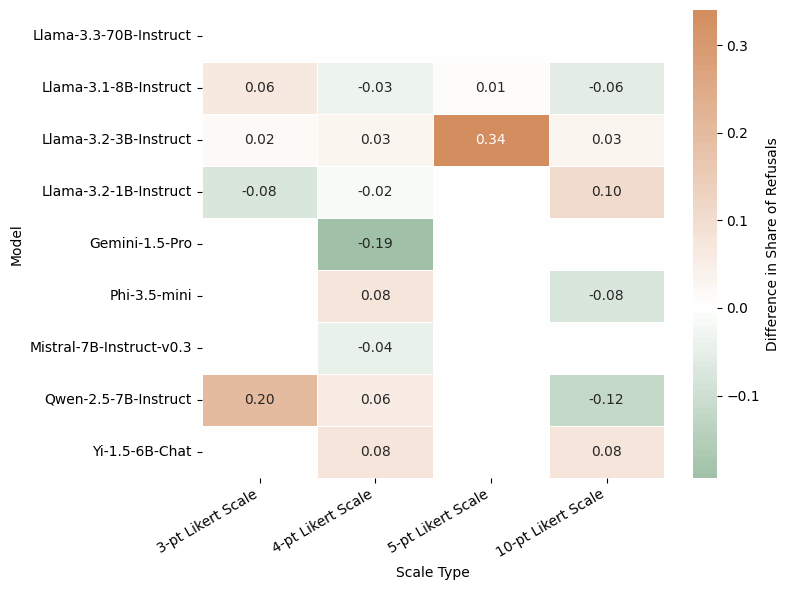

In [55]:
heatmap_data = df_results.pivot(index='Model', columns='Scale Type', values='Change in Refusal')
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales)
colors = ["#5A9367", "#ffffff", "#D38D5F"]
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
# Create annotation matrix: Replace 0.0 with empty strings
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0.0 else f"{x:.2f}")
# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, cbar=True, cbar_kws={'label': "Difference in Share of Refusals"})
#plt.title("Difference in Refusals between Original and Priming Perturbation")
plt.xlabel("Scale Type")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h4_refusal_scaletype_heatmap.pdf")
plt.savefig(f"../thesis/figures/h4_refusal_scaletype_heatmap.png", transparent = True)
plt.show()

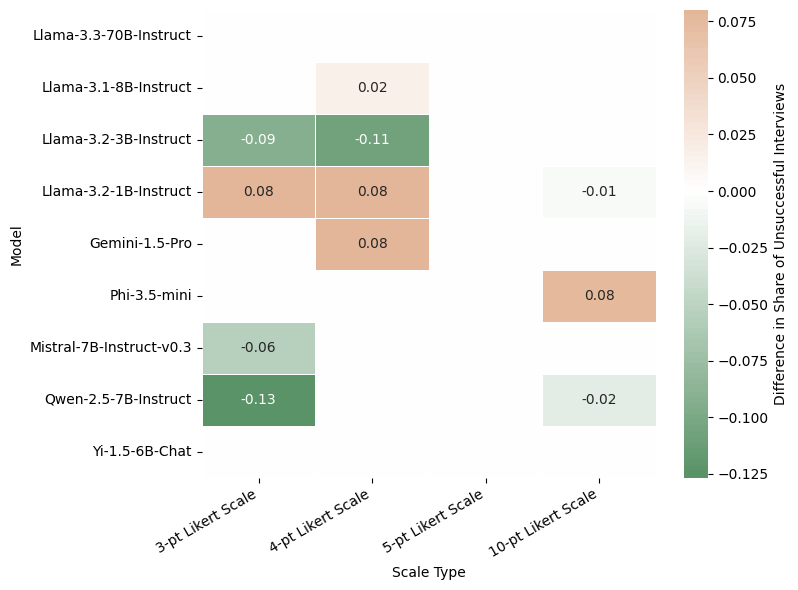

In [56]:
heatmap_data = df_results.pivot(index='Model', columns='Scale Type', values='Change in NaN')
heatmap_data = heatmap_data.reindex(all_sorted_models, columns=sorted_scales)

# Create annotation matrix: Replace 0.0 with empty strings
annot_matrix = heatmap_data.copy()
annot_matrix = annot_matrix.map(lambda x: "" if round(x,2) == 0.0 else f"{x:.2f}")

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(heatmap_data, cmap=cmap, center=0, annot=annot_matrix, fmt="", linewidths=0.5, cbar=True, cbar_kws={'label': "Difference in Share of Unsuccessful Interviews"})
#plt.title("Difference in Refusals between Original and Priming Perturbation")
plt.xlabel("Scale Type")
plt.ylabel("Model")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(f"../thesis/figures/h4_nan_scaletype_heatmap.pdf")
plt.savefig(f"../thesis/figures/h4_nan_scaletype_heatmap.png", transparent = True)
plt.show()

# Visualizing with Heatmap

In [57]:
# define combinations because list_answer_middle type mus be compared to list_answer_no_middle
combinations = pd.DataFrame({
        
        "baseline": ['list_answer_options', 'list_answer_middle', 
        'list_answer_options', 'list_answer_options',
        'list_answer_options','list_answer_options','list_answer_options',
        'list_answer_options','list_answer_options','list_answer_options'],
        
        "alternative": [
        'list_answer_no_refusal', 'list_answer_no_middle',
        'list_answer_options_reversed',
        'original_emotional_prime',
        'question_typo', 'question_letter_swap', 'question_synonym',
        'question_paraphrased', 'question_keyboardtypo',
        'interaction_paraphrase_reversed']
        })

In [60]:
from scipy.stats import chi2_contingency

def generate_combined_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = data["Category"].unique()
    desired_order = [
                "Reversed Answer Options",
                "Missing Refusal",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
    ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [4, 9]  # After "Original", "Letter Swap", and "Paraphrase"
    # Loop through each model and type to compute metrics
    for category in categories:
        # Initialize results lists
        results = []
        for model in models:
            for i,perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:  # Skip the baseline itself
                    continue
                epsilon=1e-6
                    # Extract the baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                    (data[column_model] == model) &
                                    (data["Category"] == category)
                                    ]
                if baseline_data.empty:
                    raise ValueError(f"No data found for baseline type '{combinations['baseline'].iloc[i]}'")
                
                # Compute the baseline frequency distribution
                baseline_distribution = (
                    baseline_data[column_response]
                    .value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                subset = data[(data[column_model] == model) & 
                            (data[column_type] == perturbation) &
                            (data["Category"] == category)
                            ]
                
                if len(subset) > 0:
                    # Compute the frequency distribution
                    freq_distribution = (
                        subset[column_response]
                        .value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    # test if correct distributions are used for calculation
                    #print(freq_distribution, baseline_distribution)
                    #print(f"KL-Divergence calculated for model {model} and ", perturbation, "&", combinations["baseline"].iloc[i])
                    
                    # KL Divergence
                    kl_div = sci.stats.entropy(baseline_distribution, freq_distribution)
                    #print(kl_div)
                    observed = freq_distribution * len(subset)
                    expected = baseline_distribution * len(subset)
                    
                    # Remove zero-expected categories
                    valid_idx = expected > 0
                    observed = observed[valid_idx]
                    expected = expected[valid_idx]
                    
                    if len(observed) > 0:  # Ensure there are valid data points
                        chi2, p = chi2_contingency([observed, expected])[:2]
                    else:
                        chi2, p = np.nan, np.nan
                else:
                    kl_div, p = np.nan, np.nan  # Mark as missing
                
                # Append results
                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': kl_div, 'p-value': p})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap structure
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        p_values_data = results_df.pivot(index='Type', columns='Model', values='p-value')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        p_values_data = p_values_data.reindex(columns=all_sorted_models, index=desired_order)
        
        # Generate annotations manually
        annotations = heatmap_data.copy()
        for row in annotations.index:
            for col in annotations.columns:
                kl = heatmap_data.at[row, col]
                p = p_values_data.at[row, col]
                if pd.isna(kl) or pd.isna(p):
                    annotations.at[row, col] = ""
                else:
                    annotations.at[row, col] = f"{kl:.2f}\n{p:.2f}"
        vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
        # Plot heatmap
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'KL Divergence'},
            vmin=0,  # Start colors from 0
            vmax=vmax,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
        )

        # Add horizontal lines for group separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
        plt.title(f'{category}: KL Divergence (color and annotation) & Chi-squared p-value (annotation)', fontsize=14)
        plt.ylabel("Perturbation")
        plt.xlabel("Model")
        plt.xticks(rotation = 45, ha='right')
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/{category[0:10]}_kldiv_heatmap.pdf")
        plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.14
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.55
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.32
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

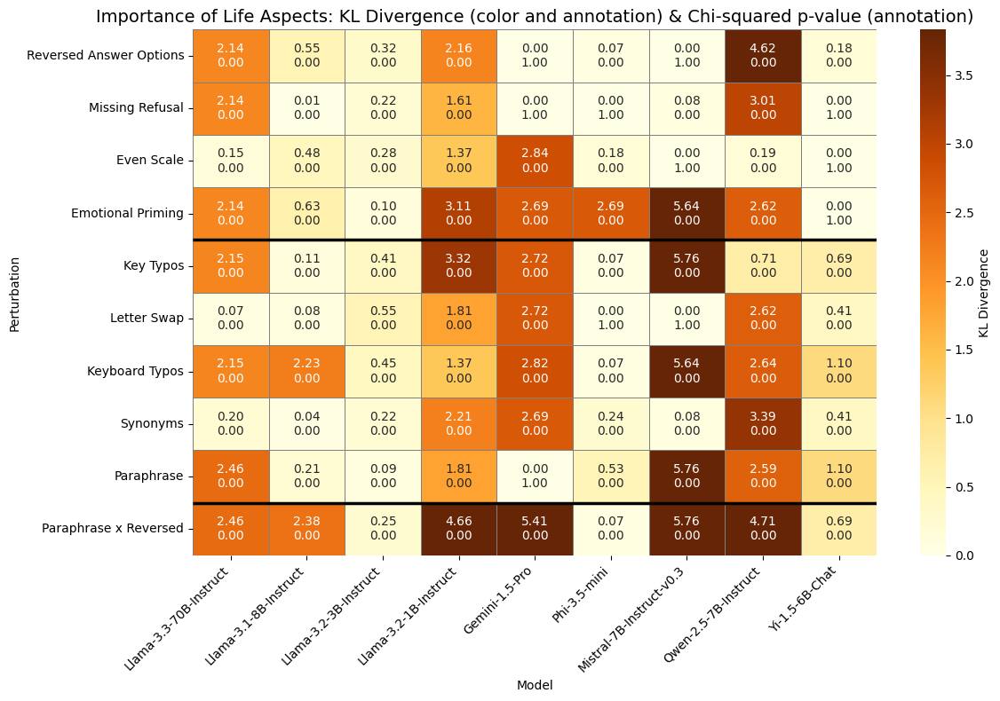

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.35
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.18
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.28
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

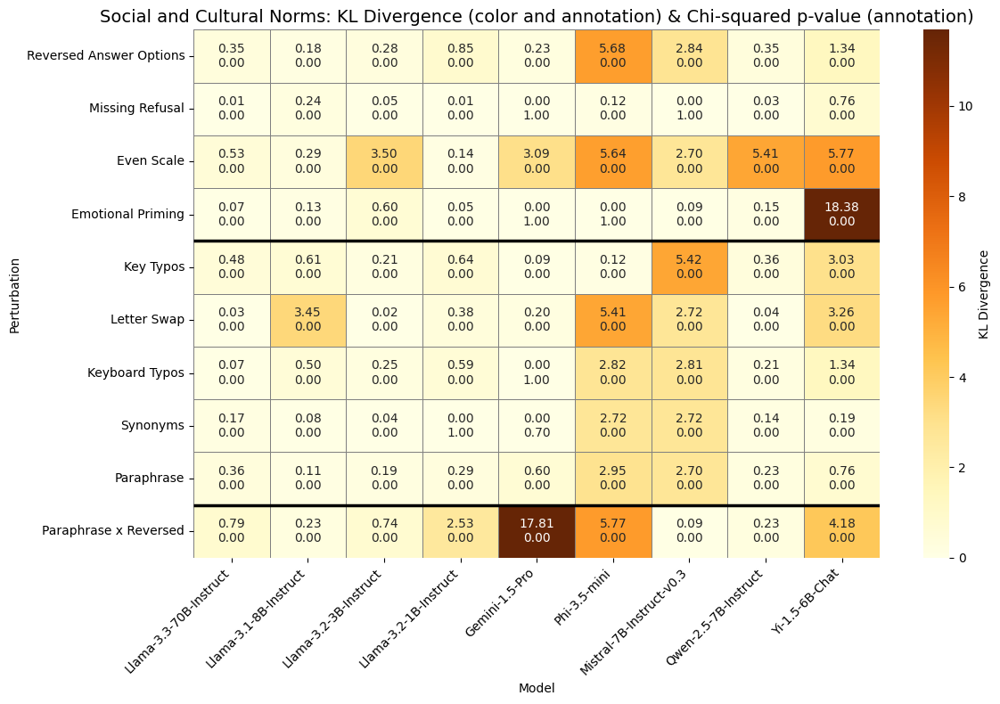

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.00
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '3.29
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.34
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

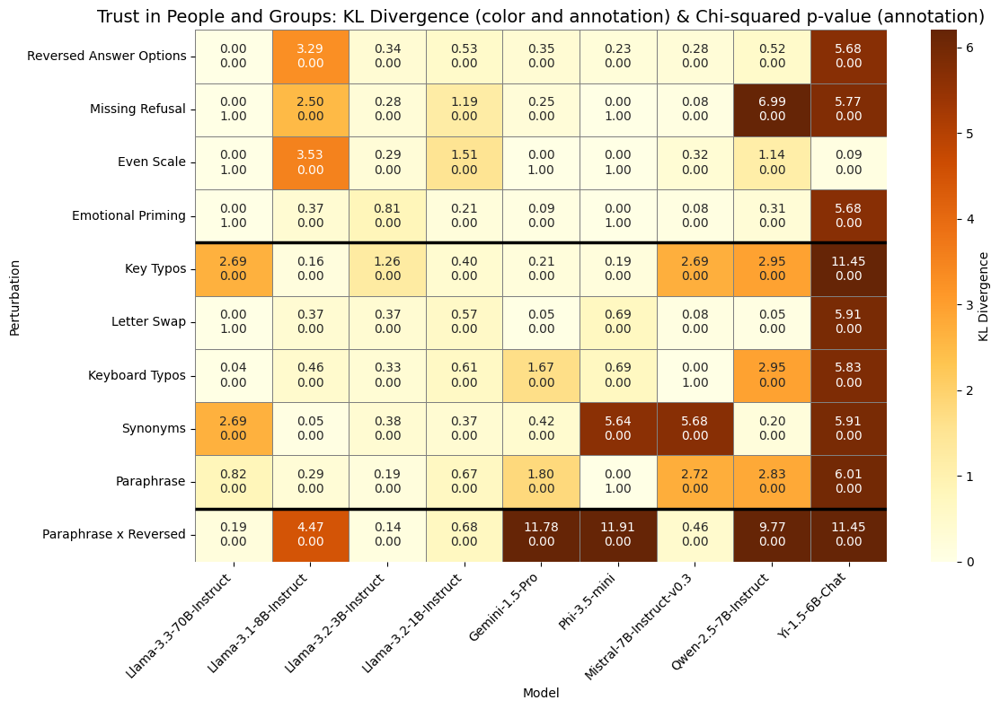

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.83
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.93
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.66
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

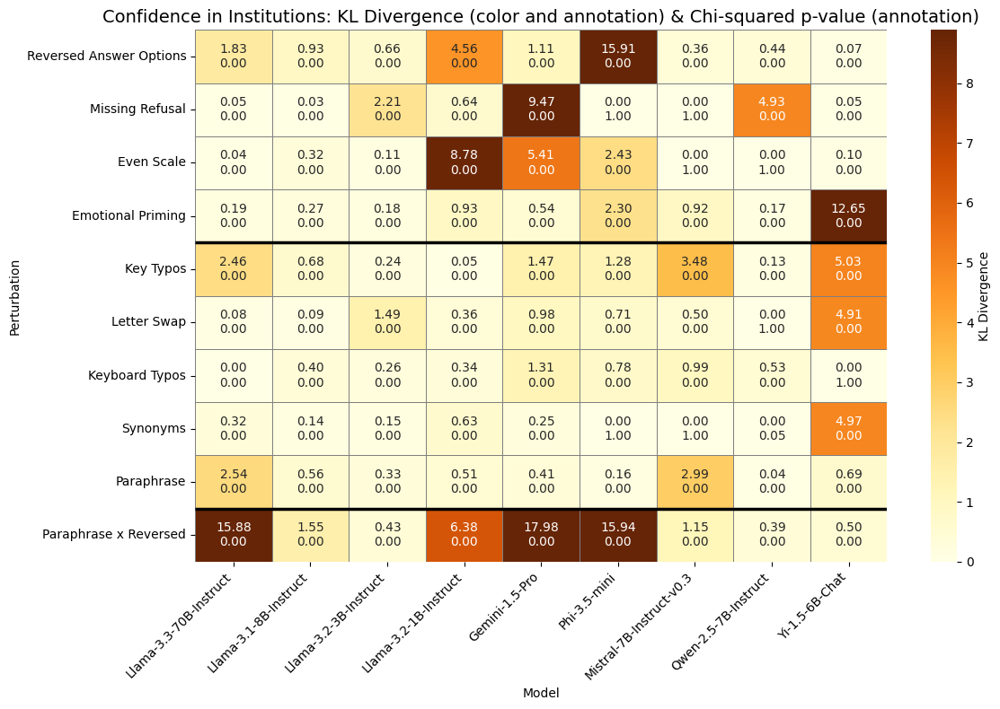

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '18.83
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.56
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.81
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an ite

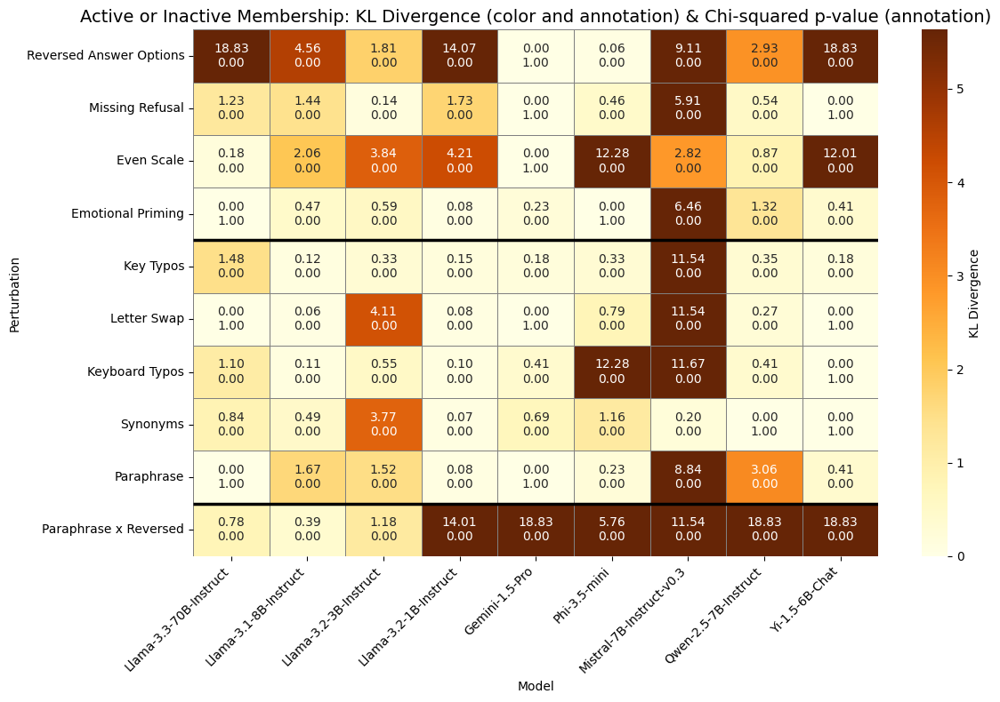

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.06
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.56
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.94
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

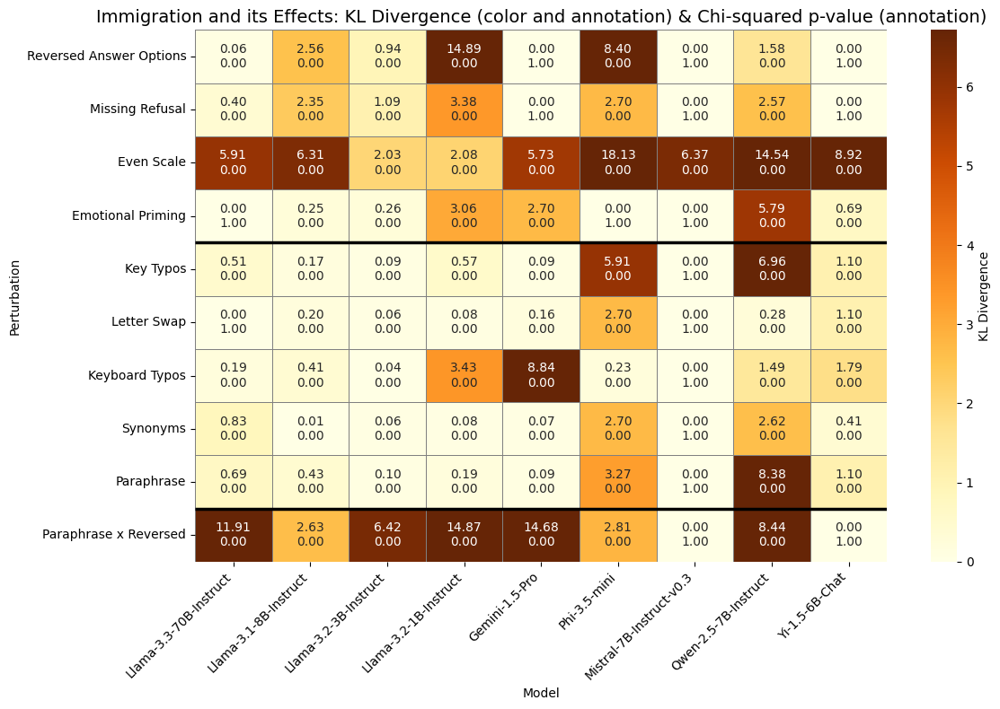

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.09
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '13.69
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '3.99
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an ite

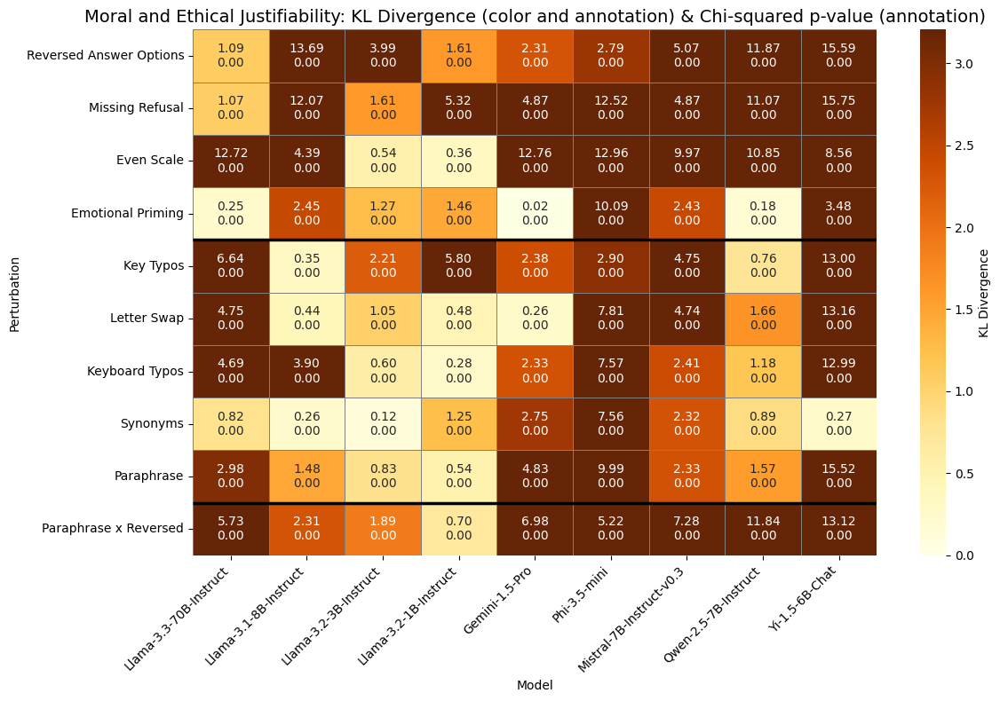

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.79
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.08
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

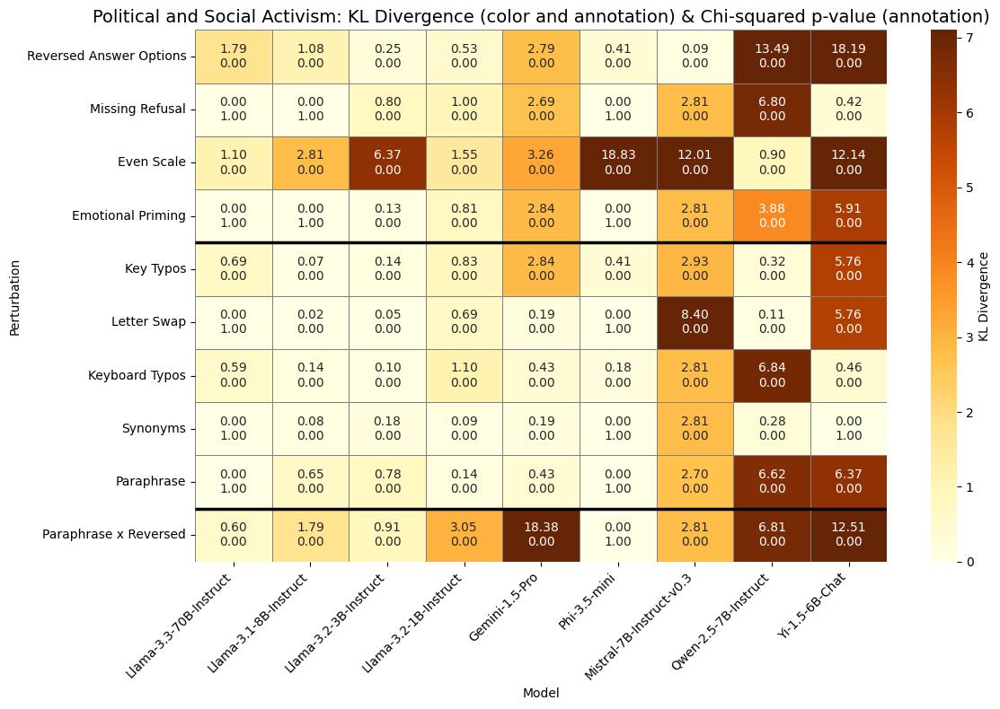

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.58
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '9.01
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.76
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

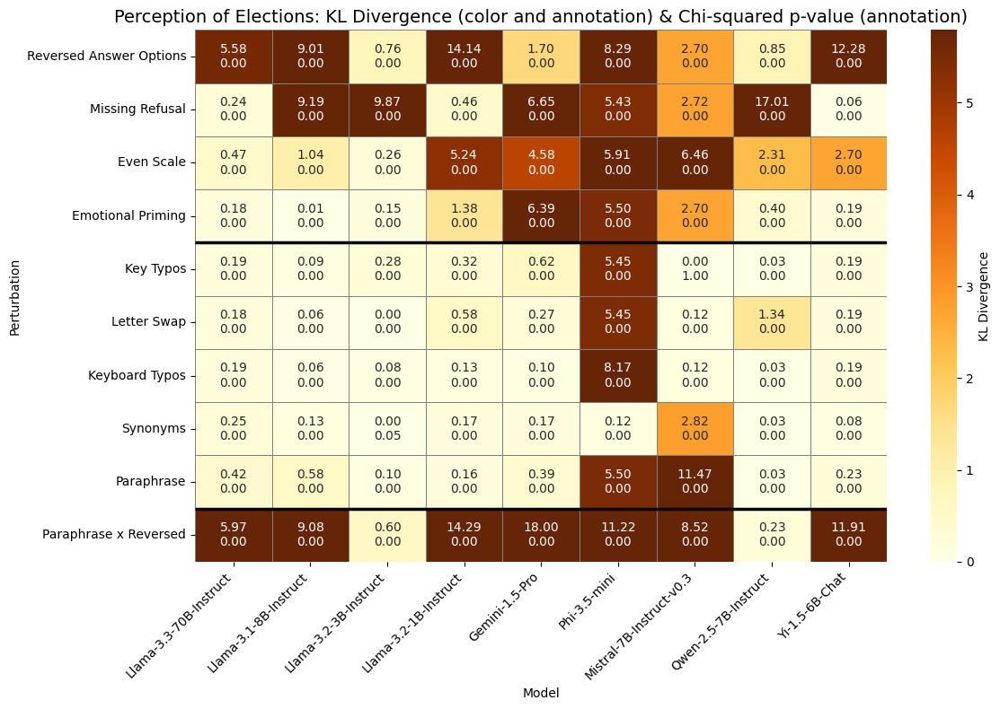

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.72
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.86
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.66
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3919133075.py:124: FutureWarning:

Setting an item

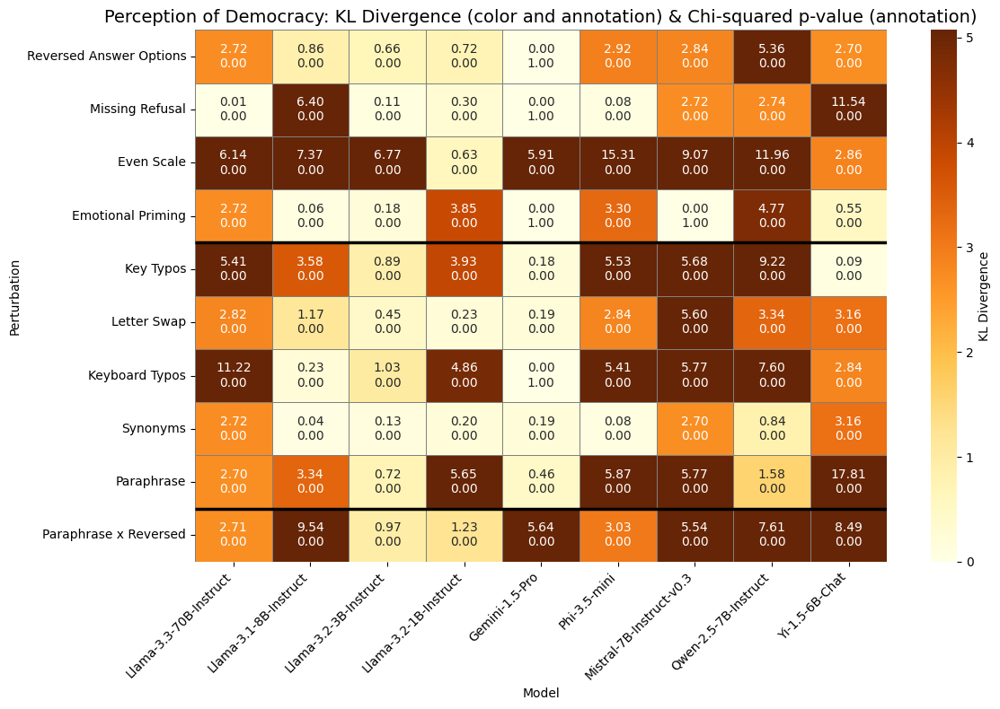

In [61]:
generate_combined_heatmap(final_interviews_categorized, combinations=combinations)

Calculate the average KL-Divergence across questions contained in each model, perturbation, category combination.

In [62]:
# Define combinations because list_answer_middle type must be compared to list_answer_no_middle
combinations = pd.DataFrame({
    "baseline": [
        'list_answer_options', 'list_answer_middle', 'list_answer_options',
        'list_answer_options', 'list_answer_options', 'list_answer_options',
        'list_answer_options', 'list_answer_options', 'list_answer_options', 'list_answer_options'
    ],
    "alternative": [
        'list_answer_no_refusal', 'list_answer_no_middle', 'list_answer_options_reversed',
        'original_emotional_prime', 'question_typo', 'question_letter_swap',
        'question_synonym', 'question_paraphrased', 'question_keyboardtypo', 'interaction_paraphrase_reversed'
    ]
})

# Function to generate heatmap with averaged KL Divergence
def generate_avg_combined_heatmap(data, combinations, column_model='model_name', column_type='type', 
                              column_response='extracted_response'):
    categories = data["Category"].unique()
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options", "Missing Refusal", "Even Scale", "Emotional Priming",
        "Key Typos", "Letter Swap", "Keyboard Typos", "Synonyms", "Paraphrase", "Paraphrase x Reversed"
    ]
    group_boundaries = [4, 9]  # Group separators

    for category in categories:
        results = []
        for model in models:
            for i, perturbation in enumerate(combinations["alternative"]):
                epsilon = 1e-6
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                     (data[column_model] == model) &
                                     (data["Category"] == category)]
                if baseline_data.empty:
                    continue

                # Baseline distribution grouped by Question ID
                baseline_grouped = baseline_data.groupby('Question ID')[column_response].value_counts(normalize=True).unstack(fill_value=0) + epsilon

                subset = data[(data[column_model] == model) &
                              (data[column_type] == perturbation) &
                              (data["Category"] == category)]
                if subset.empty:
                    continue

                # Compute KL Divergence per question and average it
                kl_divergences = []
                for question_id, baseline_dist in baseline_grouped.iterrows():
                    perturbed_dist = (
                        subset[subset['Question ID'] == question_id][column_response]
                        .value_counts(normalize=True)
                        .reindex(baseline_dist.index, fill_value=0) + epsilon
                    )
                    kl_div = sci.stats.entropy(baseline_dist, perturbed_dist)
                    kl_divergences.append(kl_div)

                # Average KL divergence across questions
                avg_kl_div = np.mean(kl_divergences) if kl_divergences else np.nan

                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace({
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"
        })
        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        
        # Annotations for heatmap
        annotations = heatmap_data.copy().applymap(lambda x: f"{x:.2f}" if pd.notnull(x) else "")
        vmax = np.nanmax(heatmap_data.values) / np.nanmean(heatmap_data.values)

        # Plot heatmap
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Display values
            fmt="",
            cmap=sns.color_palette("YlOrBr", as_cmap=True),
            cbar_kws={'label': 'Average KL Divergence'},
            vmin=0,
            vmax=vmax,
            linewidths=0.5,
            linecolor='gray'
        )

        # Add horizontal lines for visual separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

        plt.title(f'{category}: Averaged KL Divergence Across Questions', fontsize=14)
        plt.ylabel("Perturbation")
        plt.xlabel("Model")
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        #plt.savefig(f"../thesis/figures/{category[:10]}_avg_kl_heatmap.pdf")
        plt.show()


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



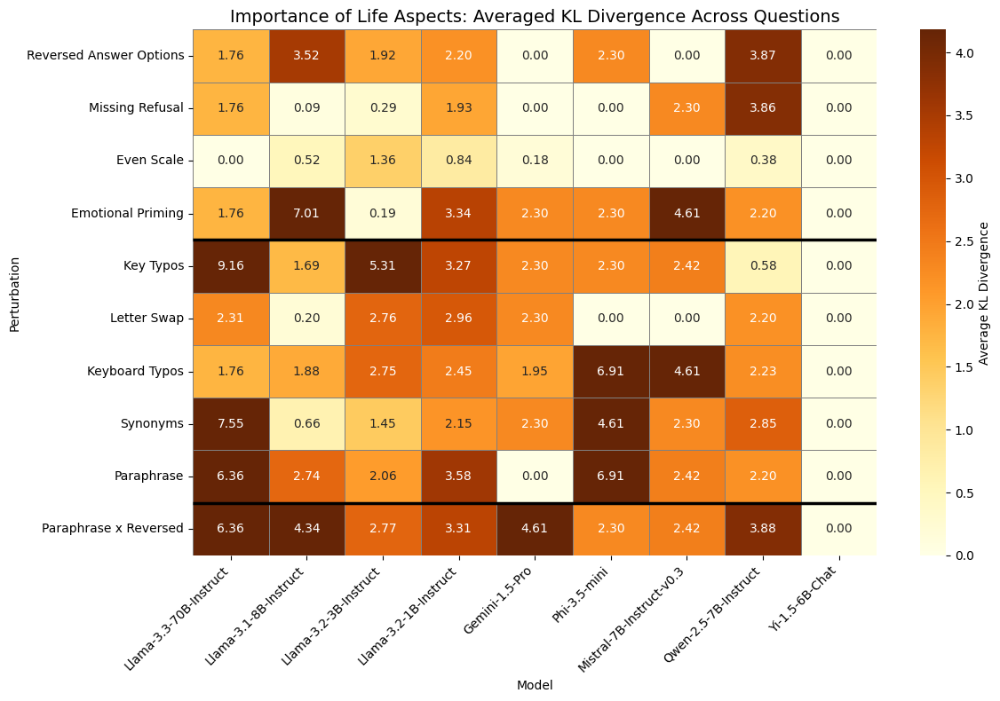

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



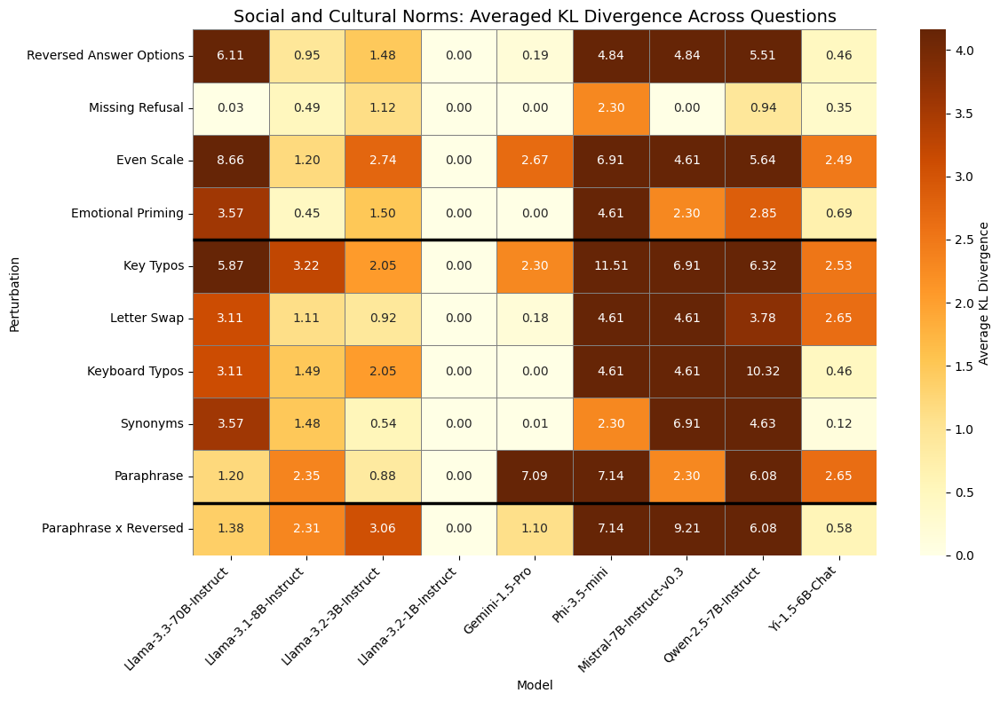

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



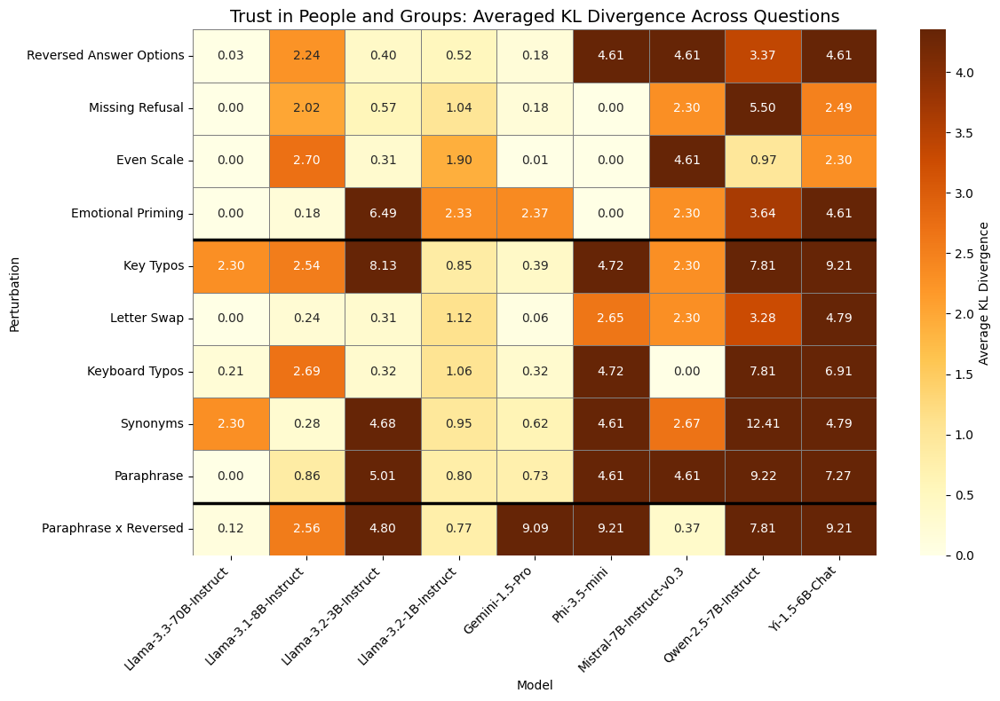

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



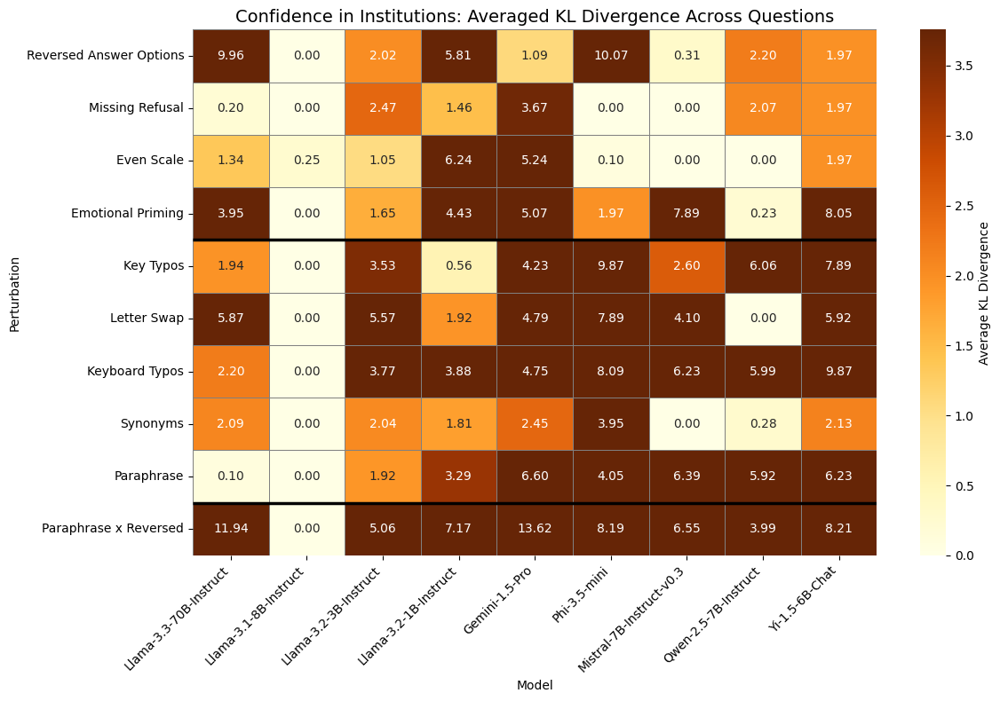

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



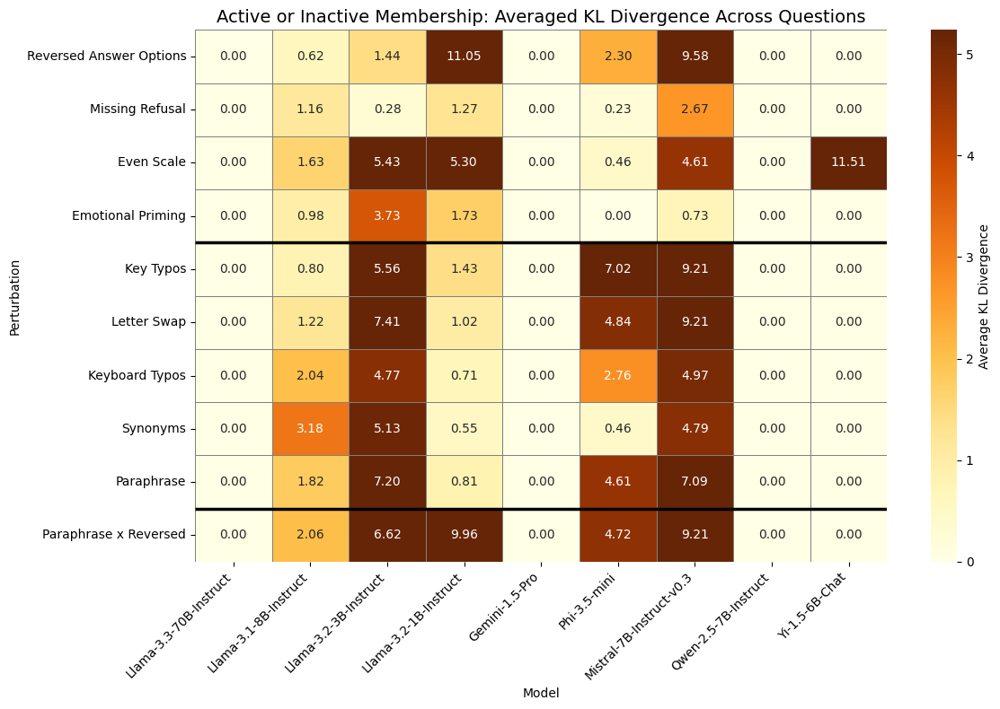

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



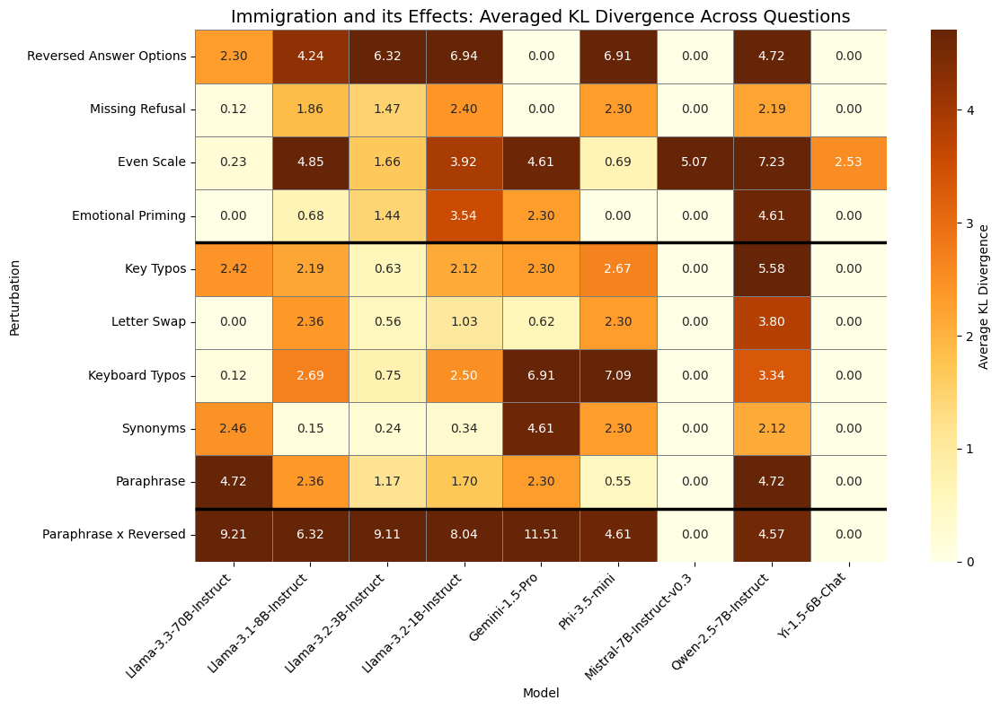

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



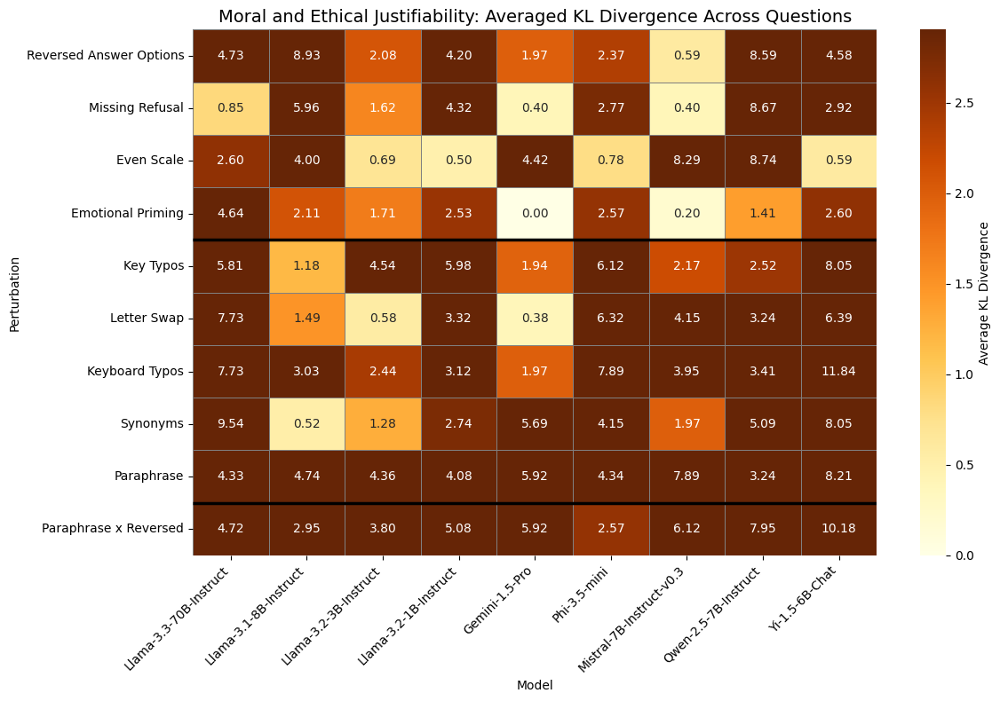

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



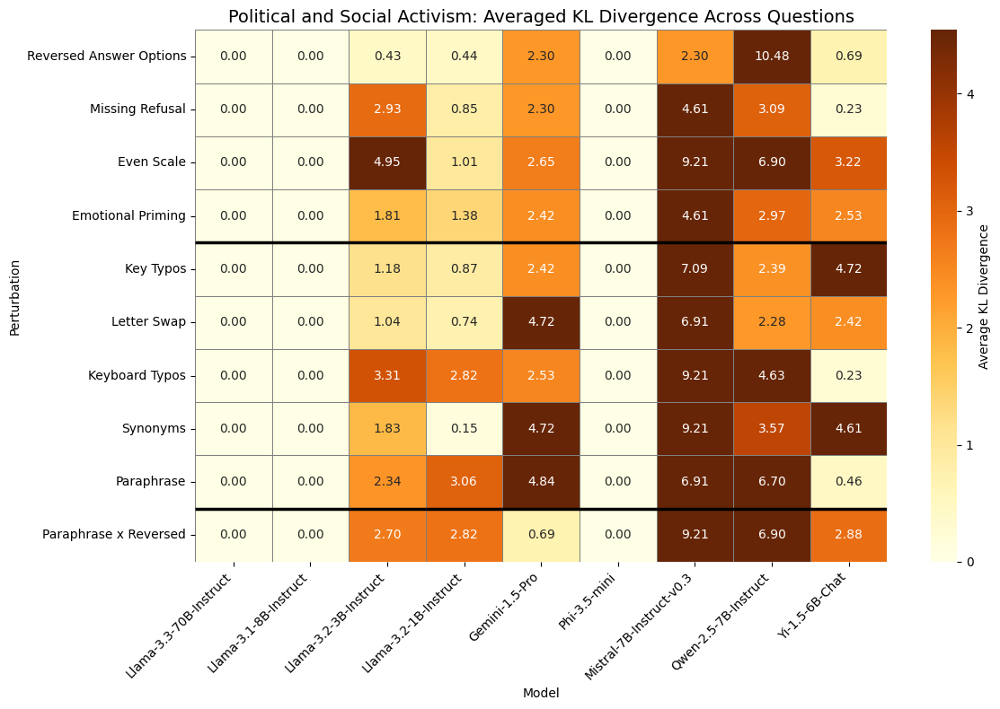

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



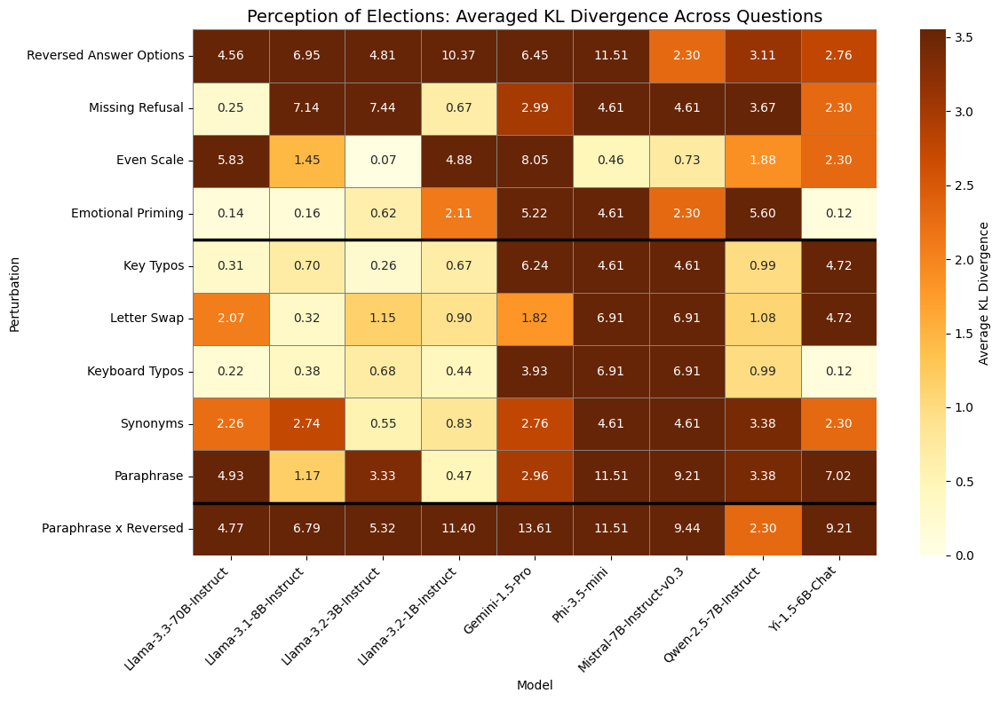

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2500208323.py:85: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



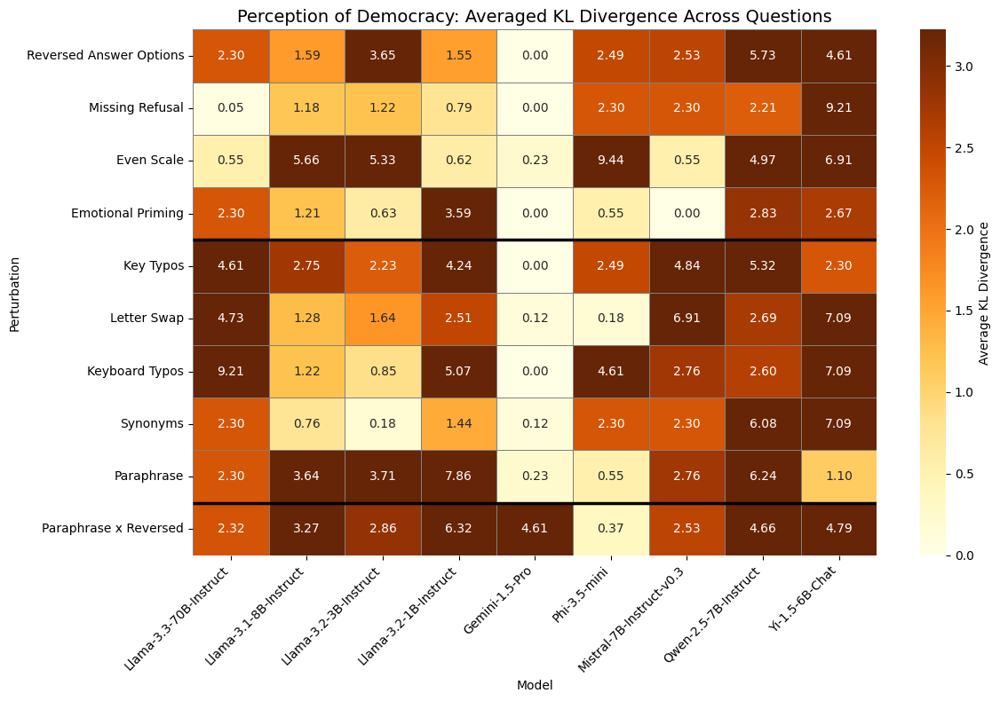

In [63]:
generate_avg_combined_heatmap(final_interviews_categorized, combinations=combinations)

Here I generate a matrix plot with all categorical heatmaps. The KL-divergence is calculated for every question and then averaged.

In [64]:
desired_order = [
        "Reversed Answer Options", "Missing Refusal", "Even Scale", "Emotional Priming",
        "Key Typos", "Letter Swap", "Keyboard Typos", "Synonyms", "Paraphrase", "Paraphrase x Reversed"
]

def compute_kl_divergence(data, combinations, column_model='model_name', column_type='type', column_response='extracted_response'):
    """
    Computes the KL divergence for each category, model, and perturbation type.
    Stores the results in a DataFrame for later visualization.
    """
    results = []
    categories = data["Category"].unique()
    models = all_sorted_models
    for category in categories:
        for model in models:
            for i, perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:
                    continue
                
                epsilon = 1e-6
                
                # Extract baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                     (data[column_model] == model) &
                                     (data["Category"] == category)]
                if baseline_data.empty:
                    continue
                
                kl_values = []
                for question_id in baseline_data['Question ID'].unique():
                    baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                    baseline_distribution = (
                        baseline_question_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    perturbation_data = data[(data[column_model] == model) &
                                             (data[column_type] == perturbation) &
                                             (data["Category"] == category) &
                                             (data['Question ID'] == question_id)]
                    if perturbation_data.empty:
                        continue
                    
                    perturbation_distribution = (
                        perturbation_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    # Compute KL divergence
                    kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                    kl_values.append(kl_div)
                    
                avg_kl_div = np.mean(kl_values) if kl_values else np.nan
                
                results.append({'Category': category, 'Question': question_id, 'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})
    
    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    
    # Replace type names
    type_mapping = {
        'list_answer_no_refusal': "Missing Refusal",
        'list_answer_options_reversed': "Reversed Answer Options",
        'original_emotional_prime': "Emotional Priming",
        'list_answer_middle': "Odd Scale",
        'list_answer_no_middle': "Even Scale",
        'question_typo': "Key Typos",
        'question_letter_swap': "Letter Swap",
        'question_synonym': "Synonyms",
        'question_paraphrased': "Paraphrase",
        'question_keyboardtypo': "Keyboard Typos",
        'interaction_paraphrase_reversed': "Paraphrase x Reversed"
    }
    
    results_df["Type"] = results_df["Type"].replace(type_mapping)
    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)
    
    return results_df

def plot_kl_heatmaps(results_df):
    """
    Plots a 5x2 matrix of heatmaps using precomputed KL divergence values.
    """
    categories = results_df["Category"].unique()
    group_boundaries = [4, 9]
    colors = ["#5A9367", "#E8D6A7", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100) 
    fig, axes = plt.subplots(3, 2, figsize=(18, 20))
    axes = axes.flatten()
    
    for idx, category in enumerate(categories[:6]):  # Ensure we only plot 10 heatmaps
        heatmap_data = results_df[results_df["Category"] == category].pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(index=desired_order, columns=all_sorted_models)
        
        ax = axes[idx]
        sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            cmap=cmap,
            cbar_kws={'label': 'Avg. KL Divergence'},
            vmin=0,
            linewidths=0.5,
            linecolor='gray',
            ax=ax
        )
        
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        ax.set_title(f'Thematic Category: {category}', fontsize=14,  weight = "bold")
        ax.set_ylabel("Perturbation", weight = "bold")
        ax.set_xlabel("Model", weight = "bold")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    
    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_avg_divergence_categories_1to6__heatmap.pdf")
    plt.savefig("../thesis/figures/kl_avg_divergence_categories_1to6__heatmap.png", transparent = True)
    plt.show()
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()
    
    for idx, category in enumerate(categories[6:10]):  # Ensure we only plot 10 heatmaps
        heatmap_data = results_df[results_df["Category"] == category].pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(index=desired_order, columns=all_sorted_models)
        
        ax = axes[idx]
        sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            cmap=cmap,
            cbar_kws={'label': 'Avg. KL Divergence'},
            vmin=0,
            linewidths=0.5,
            linecolor='gray',
            ax=ax
        )
        
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        ax.set_title(f'Thematic Category: {category}', fontsize=14,  weight = "bold")
        ax.set_ylabel("Perturbation", weight = "bold")
        ax.set_xlabel("Model", weight = "bold")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    
    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_avg_divergence_categories_7to10_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_avg_divergence_categories_7to10_heatmap.png", transparent =True)
    plt.show()


In [65]:
kl_results_df = compute_kl_divergence(final_interviews_categorized, combinations=combinations)

In [66]:
kl_results_df["KL Divergence"] = kl_results_df["KL Divergence"].round(2)
kl_results_df.to_csv("../assets/KL_Divergence_Results_by_Category.csv")

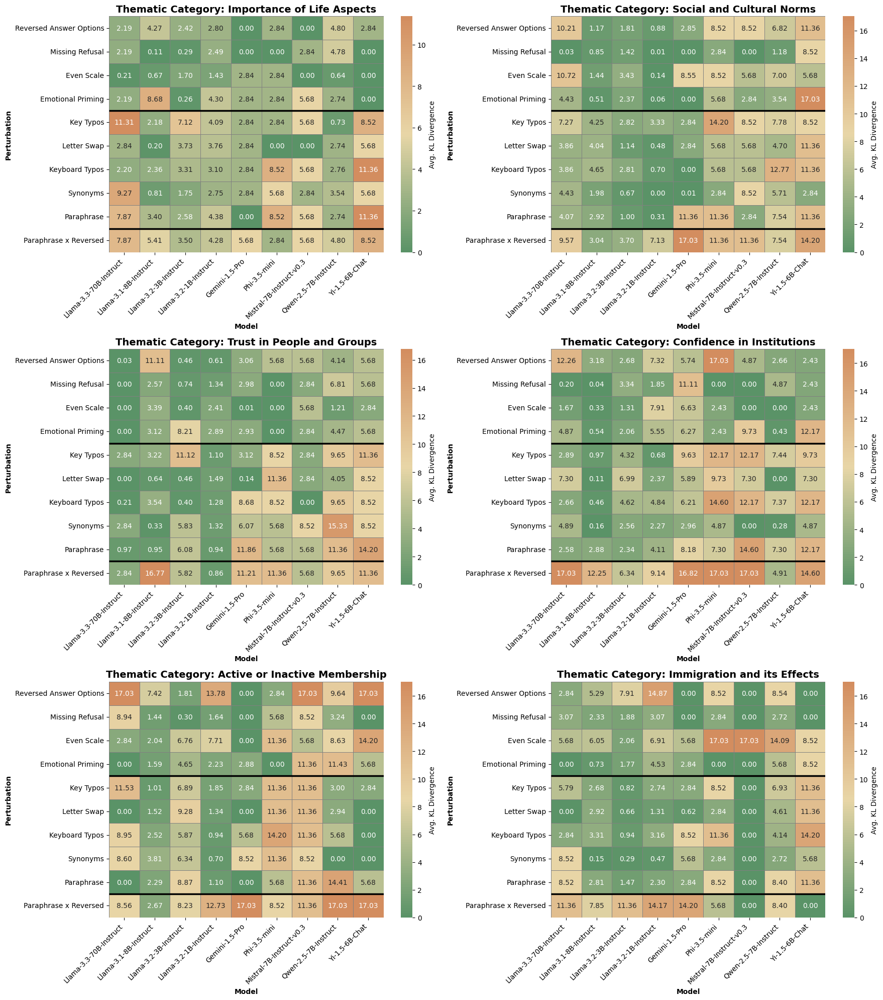

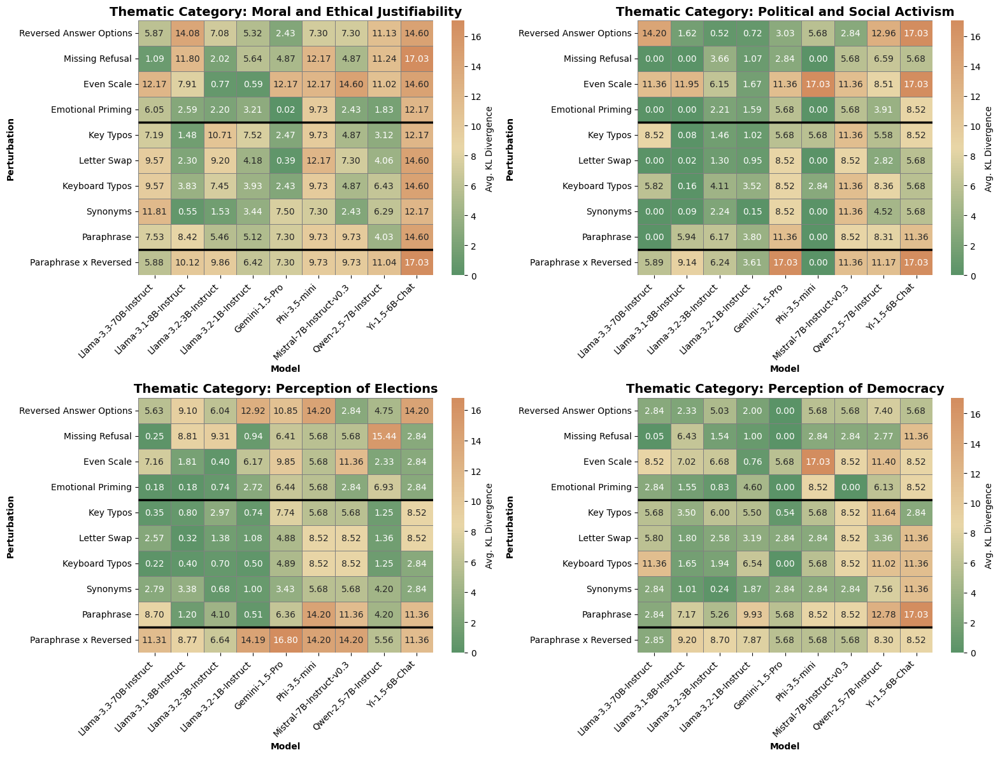

In [67]:
plot_kl_heatmaps(kl_results_df)

In [68]:
def plot_allcategories_kl_heatmaps(results_df):
    """
    Plots a 5x2 matrix of heatmaps using precomputed KL divergence values.
    """
    categories = results_df["Category"].unique()
    group_boundaries = [4, 9]
    colors = ["#5A9367", "#E8D6A7", "#D38D5F"]
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100) 
    
    for idx, category in enumerate(categories):  # Ensure we only plot 10 heatmaps
        heatmap_data = results_df[results_df["Category"] == category].pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(index=desired_order, columns=all_sorted_models)
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            cmap=cmap,
            cbar_kws={'label': 'Avg. KL Divergence'},
            vmin=0,
            linewidths=0.5,
            linecolor='gray',
            #ax=ax
        )
        
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        ax.set_title(f'Thematic Category: {category}', fontsize=14,  weight = "bold")
        ax.set_ylabel("Perturbation", weight = "bold")
        ax.set_xlabel("Model", weight = "bold")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/kl_avg_divergence_categories_{category}__heatmap.pdf")
        plt.savefig(f"../thesis/figures/kl_avg_divergence_categories_{category}__heatmap.png", transparent = True)
        plt.show()

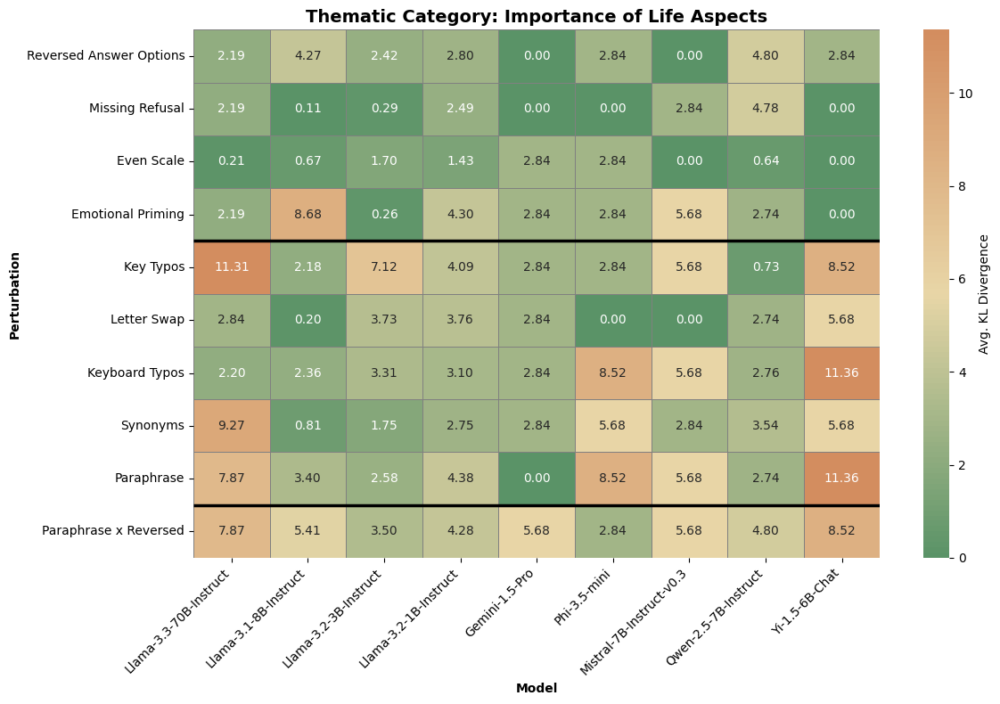

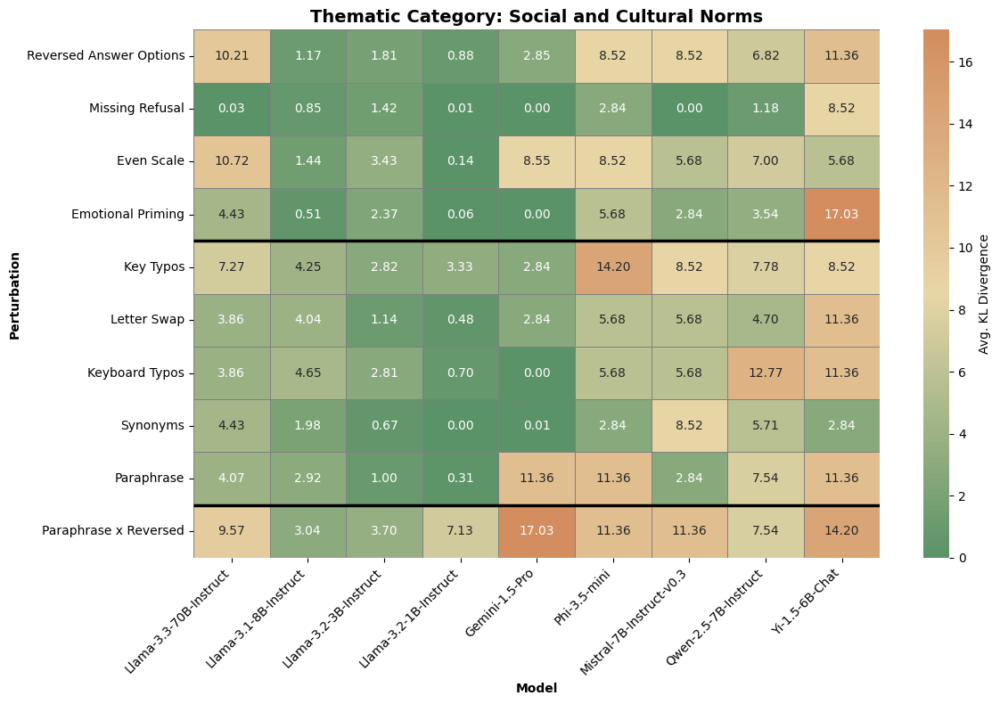

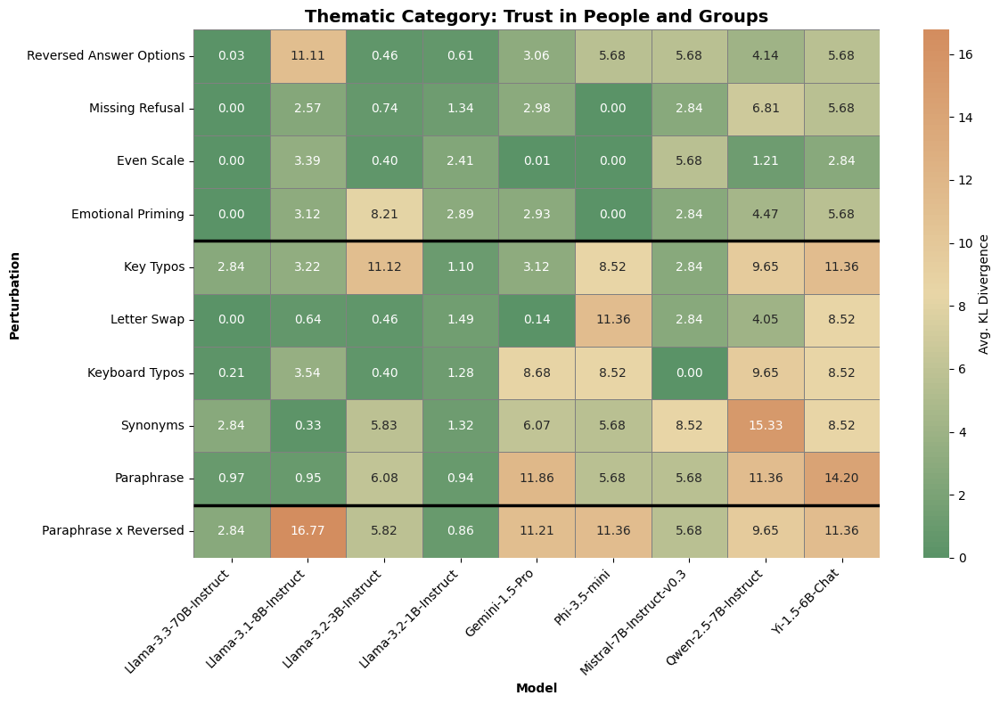

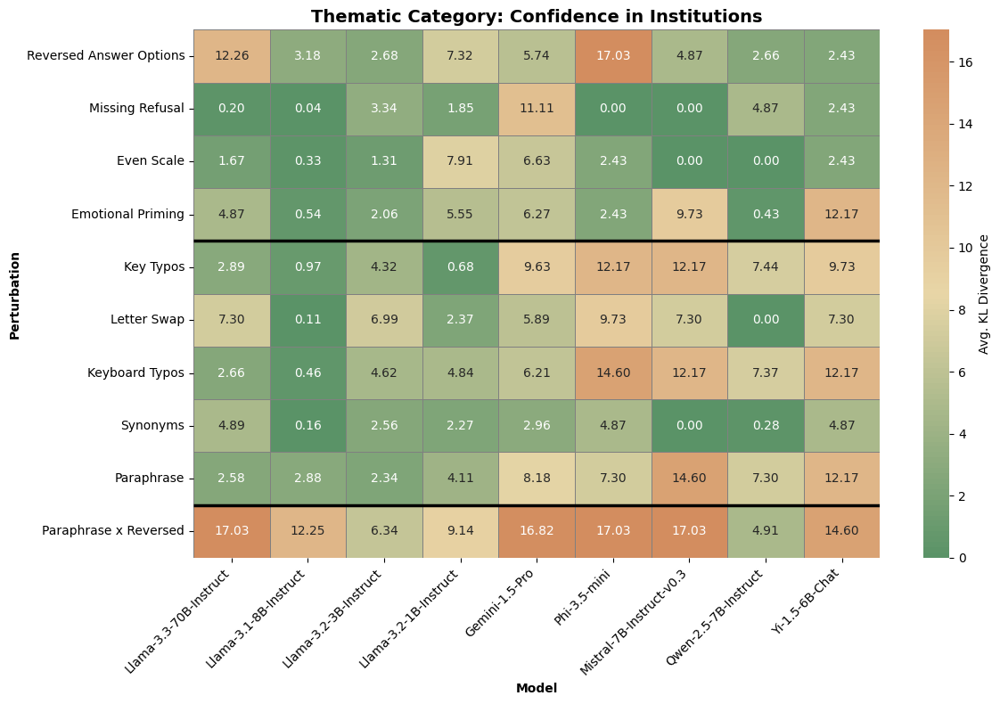

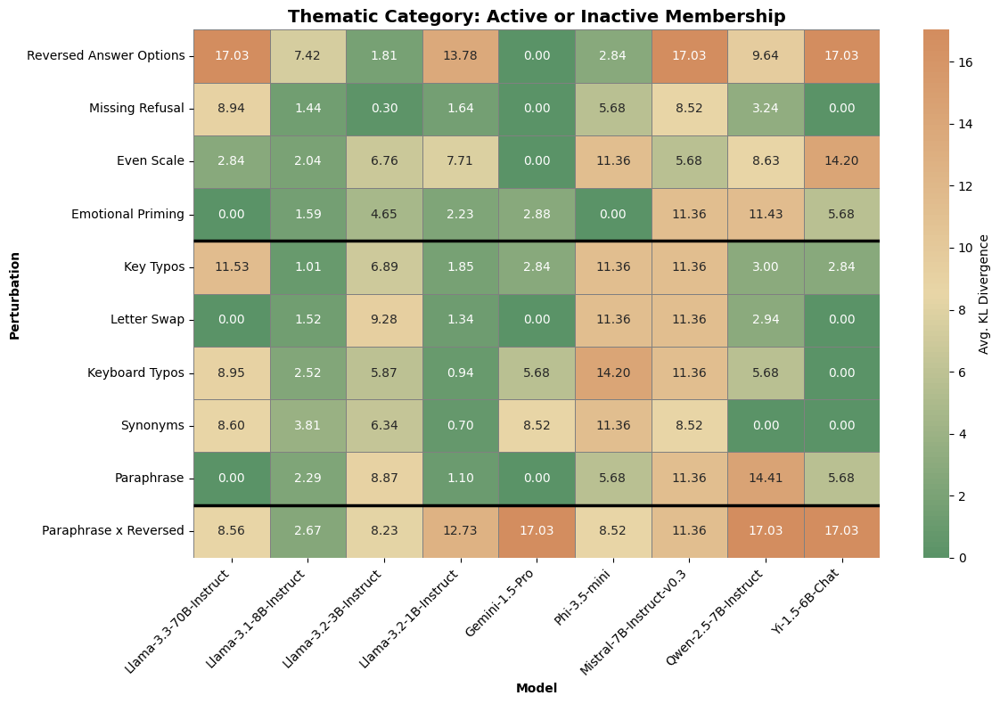

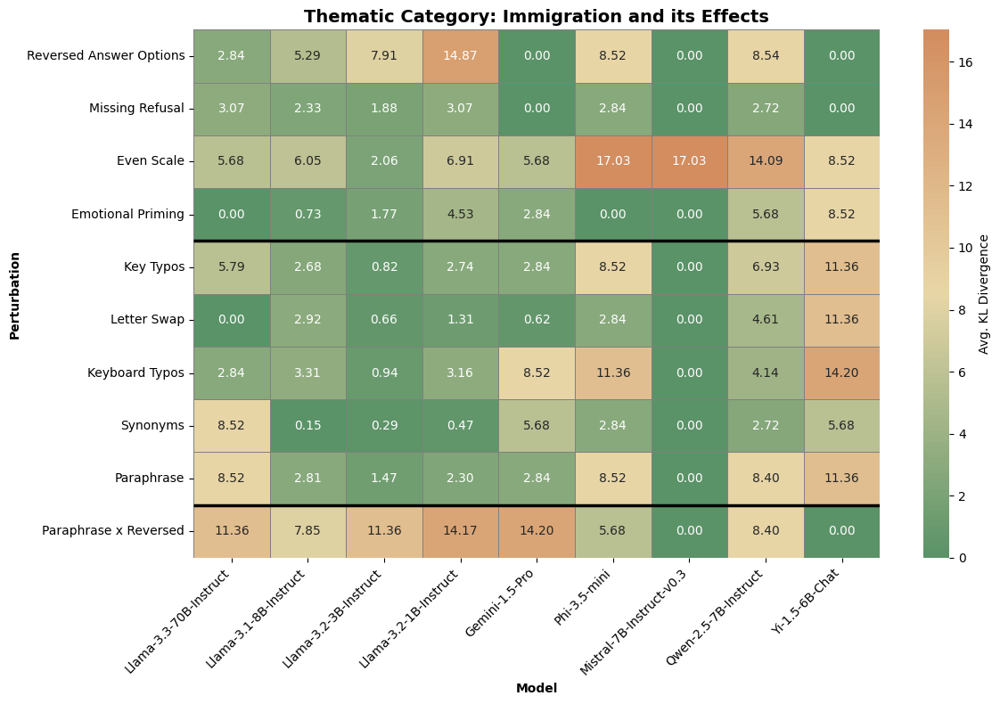

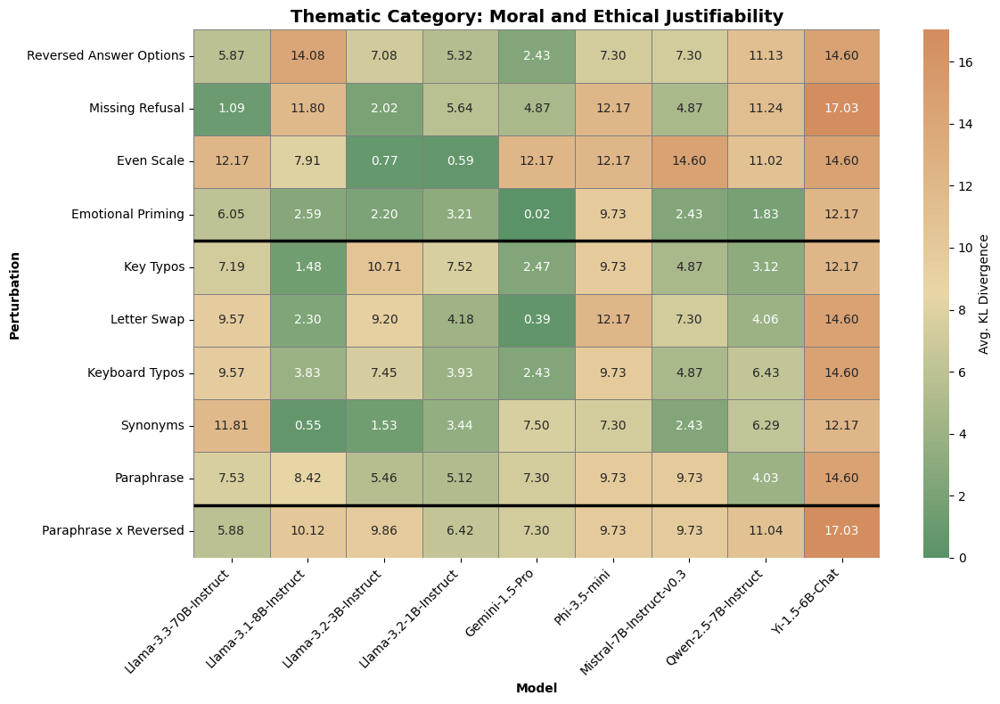

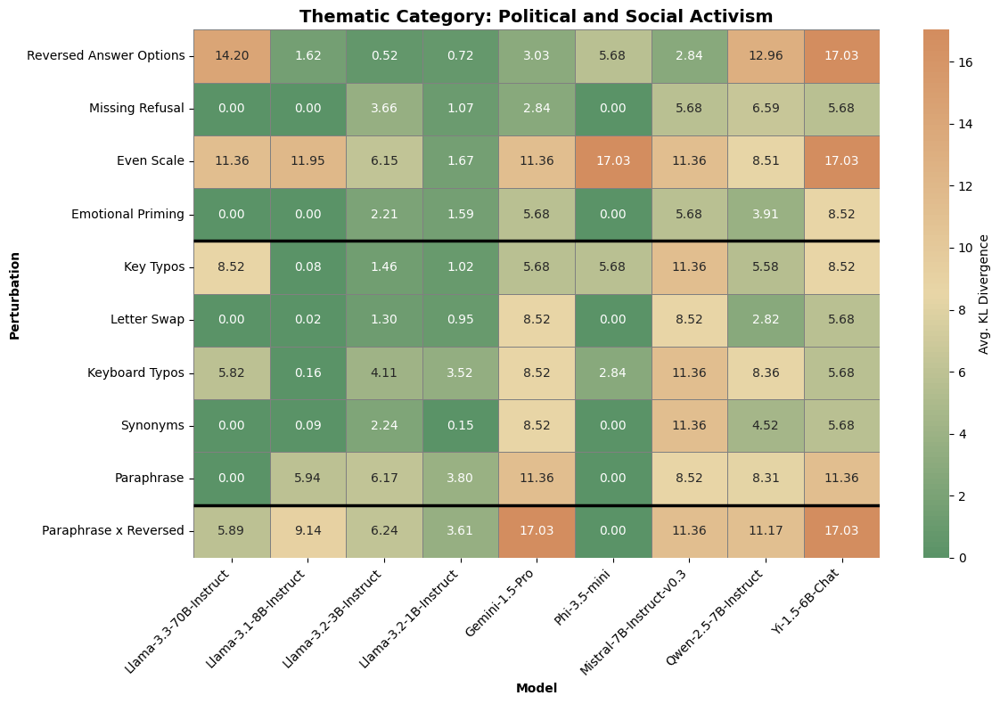

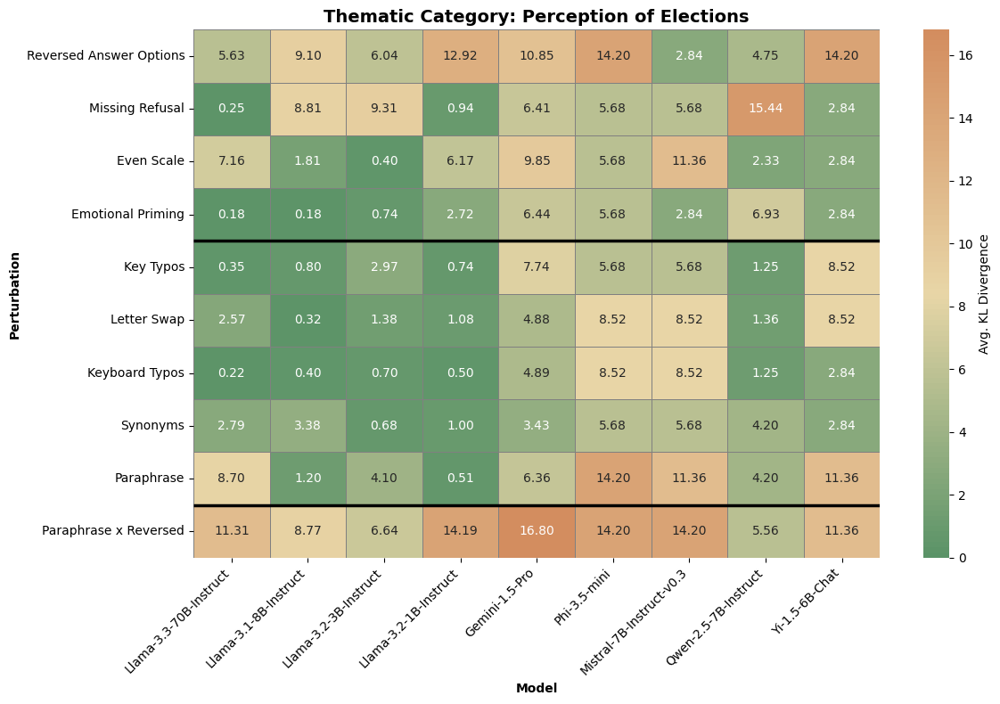

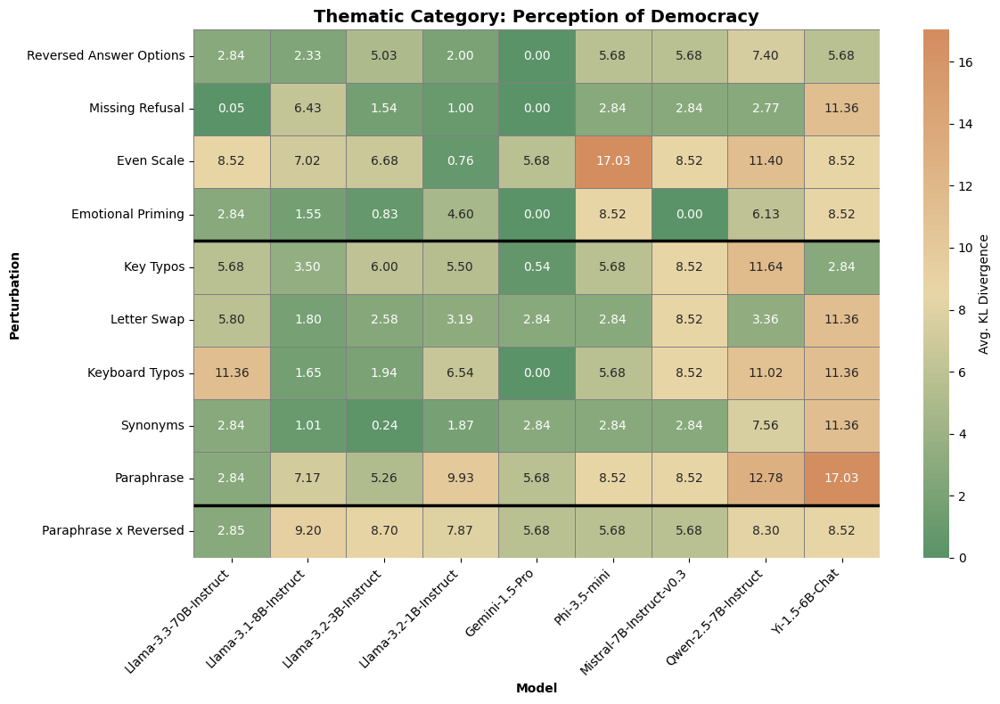

In [69]:
plot_allcategories_kl_heatmaps(kl_results_df)

Here I generate the same heatmaps but for scale type instead of category type!

In [101]:
def generate_combined_scaletype_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = data["Scale Type"].unique()
    desired_order = [
                "Reversed Answer Options",
                "Missing Refusal",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
    ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [4, 9]  # After "Letter Swap", and "Paraphrase"
    # Loop through each model and type to compute metrics
    for i, category in enumerate(categories):
        # Initialize results lists
        results = []
        for model in models:
            for i,perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:  # Skip the baseline itself
                    continue
                epsilon=1e-6
                    # Extract the baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                    (data[column_model] == model) &
                                    (data["Scale Type"] == category)
                                    ]
                print(combinations["baseline"].iloc[i], model, category)
                if baseline_data.empty:
                    raise ValueError(f"No data found for baseline type '{combinations['baseline'].iloc[i]}'")
                
                # Compute the baseline frequency distribution
                baseline_distribution = (
                    baseline_data[column_response]
                    .value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                subset = data[(data[column_model] == model) & 
                            (data[column_type] == perturbation) &
                            (data["Scale Type"] == category)
                            ]
                
                if len(subset) > 0:
                    # Compute the frequency distribution
                    freq_distribution = (
                        subset[column_response]
                        .value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    # test if correct distributions are used for calculation
                    #print(freq_distribution, baseline_distribution)
                    #print(f"KL-Divergence calculated for model {model} and ", perturbation, "&", combinations["baseline"].iloc[i])
                    
                    # KL Divergence
                    kl_div = sci.stats.entropy(baseline_distribution, freq_distribution)
                    #print(kl_div)
                    observed = freq_distribution * len(subset)
                    expected = baseline_distribution * len(subset)
                    
                    # Remove zero-expected categories
                    valid_idx = expected > 0
                    observed = observed[valid_idx]
                    expected = expected[valid_idx]
                    
                    if len(observed) > 0:  # Ensure there are valid data points
                        chi2, p = chi2_contingency([observed, expected])[:2]
                    else:
                        chi2, p = np.nan, np.nan
                else:
                    kl_div, p = np.nan, np.nan  # Mark as missing
                
                # Append results
                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': kl_div, 'p-value': p})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap structure
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        p_values_data = results_df.pivot(index='Type', columns='Model', values='p-value')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        p_values_data = p_values_data.reindex(columns=all_sorted_models, index=desired_order)
        
        # Generate annotations manually
        annotations = heatmap_data.copy()
        for row in annotations.index:
            for col in annotations.columns:
                kl = heatmap_data.at[row, col]
                p = p_values_data.at[row, col]
                if pd.isna(kl) or pd.isna(p):
                    annotations.at[row, col] = ""
                else:
                    annotations.at[row, col] = f"{kl:.2f}\n{p:.2f}"
        vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
        # Plot heatmap
        plt.figure(figsize=(12, 8))
        sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True), 
            cbar_kws={'label': 'KL Divergence'},
            vmin=0,  # Start colors from 0
            vmax=vmax,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
        )

        # Add horizontal lines for group separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
        plt.title(f'{category}: KL Divergence (color and annotation) & Chi-squared p-value (annotation)', fontsize=14)
        plt.ylabel("Perturbation")
        plt.xlabel("Model")
        plt.xticks(rotation = 45, ha='right')
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/{category}_kldiv_heatmap.pdf")
        plt.show()

list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_middle Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_middle Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 4-pt Likert Scale
list_answer_options Llama-3.1-8B

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.97
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '3.29
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.36
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item

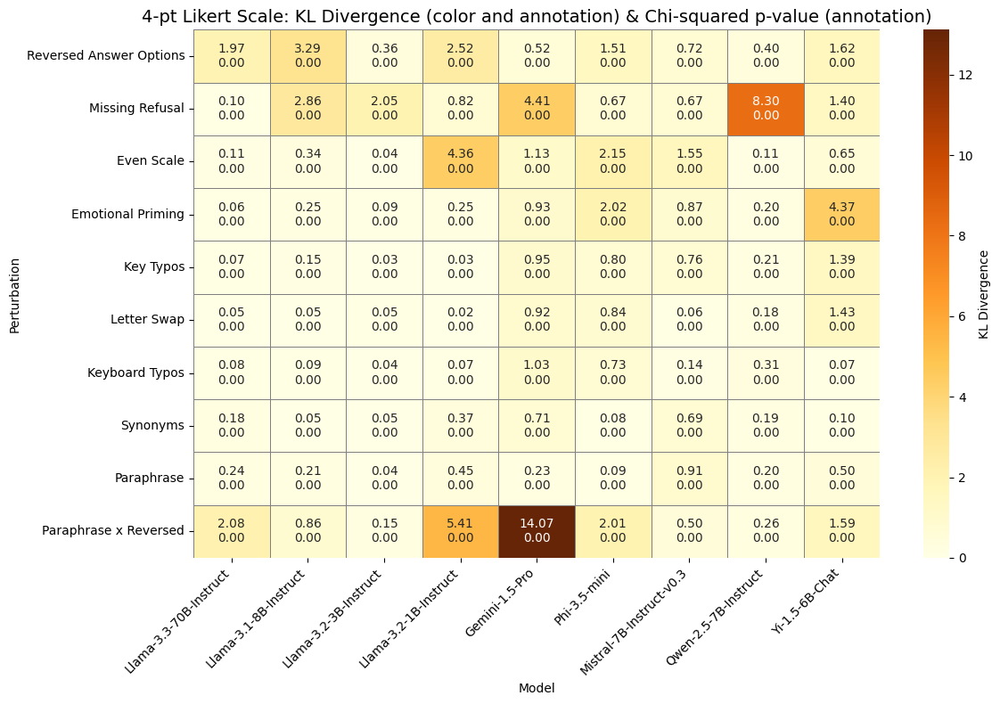

list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_middle Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_middle Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 5-pt Likert Scale
list_answer_options Llama-3.1-8B

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.35
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.18
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.28
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item

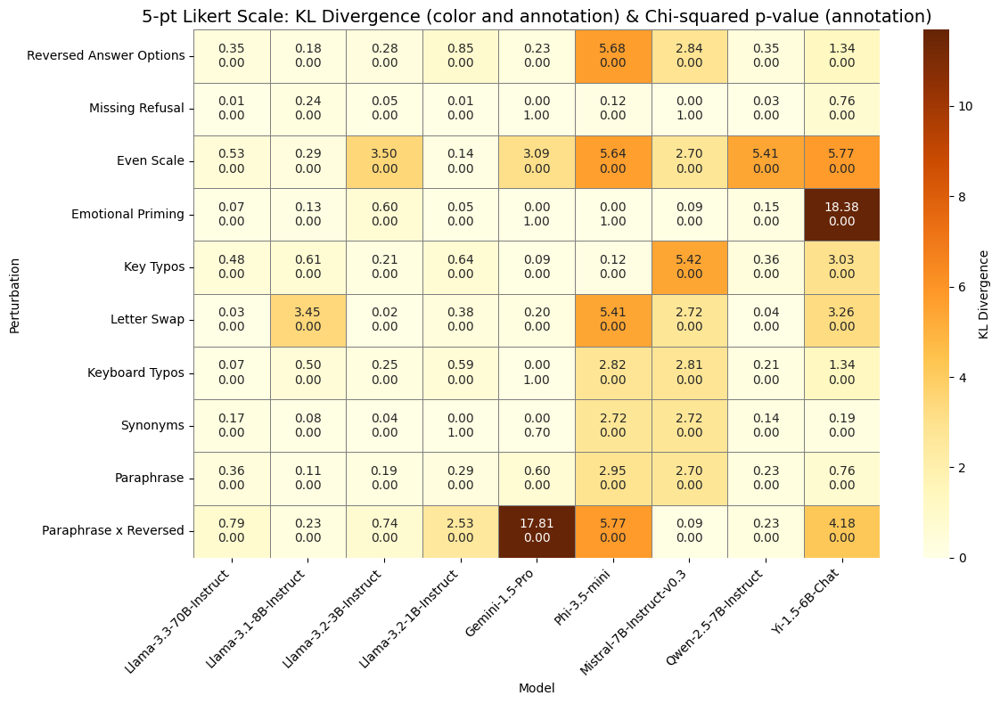

list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_middle Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_middle Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 3-pt Likert Scale
list_answer_options Llama-3.1-8B

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.57
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.50
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.28
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item

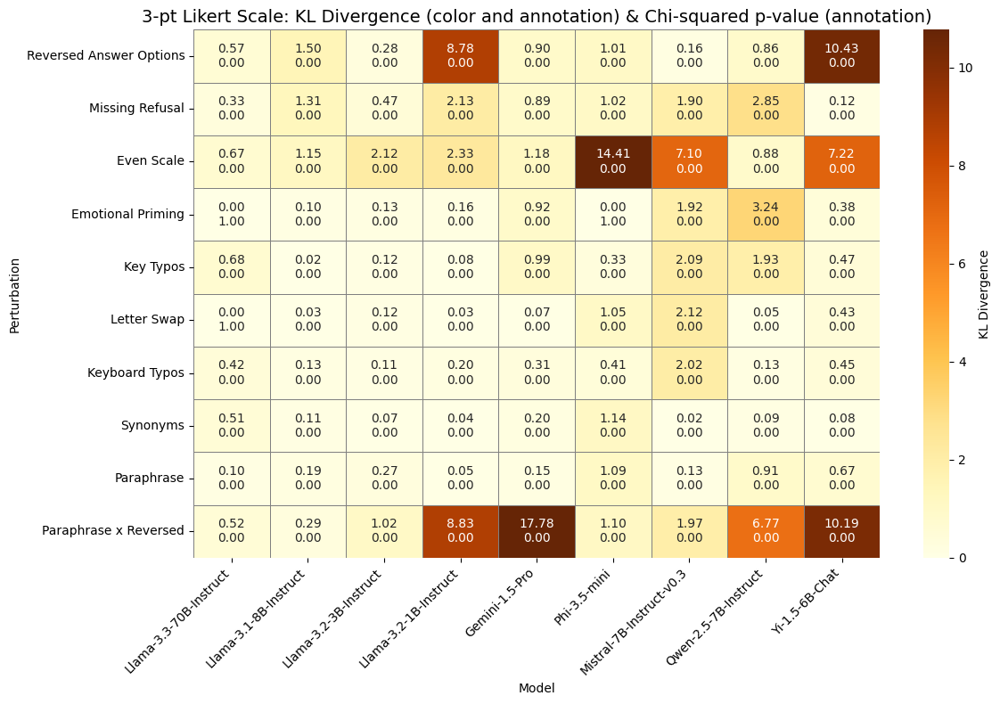

list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_middle Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.3-70B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_middle Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_options Llama-3.1-8B-Instruct 10-pt Likert Scale
list_answer_opti

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.84
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.07
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.40
0.00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1978475572.py:123: FutureWarning:

Setting an item

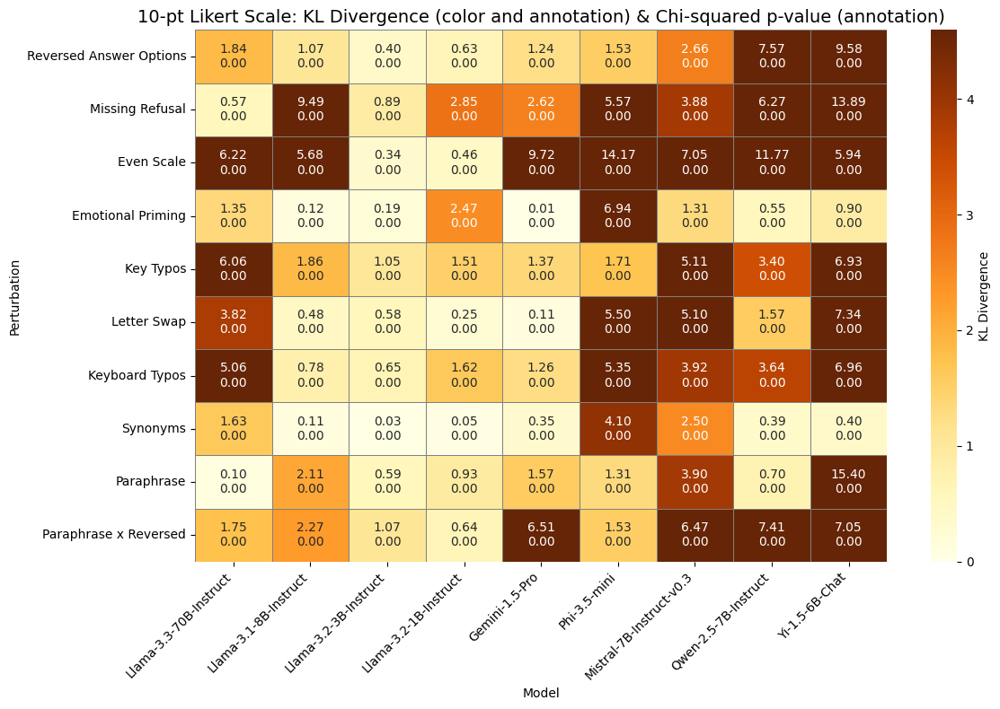

In [102]:
generate_combined_scaletype_heatmap(final_interviews_categorized, combinations=combinations)

In [103]:
def plot_combined_heatmaps(data, combinations, all_sorted_models):
    categories = ["3-pt Likert Scale", "4-pt Likert Scale", "5-pt Likert Scale", "10-pt Likert Scale"]
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()
    desired_order = [
                "Reversed Answer Options",
                "Missing Refusal",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
        ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [4, 9]  # After "Letter Swap", and "Paraphrase"
    
    for idx, category in enumerate(categories):
        ax = axes[idx]
        # Extract relevant data and pivot
        results = []
        for model in all_sorted_models:
            for i, perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:
                    continue
                
                epsilon = 1e-6
                baseline_data = data[(data["type"] == combinations["baseline"].iloc[i]) &
                                     (data["model_name"] == model) &
                                     (data["Scale Type"] == category)]
                if baseline_data.empty:
                    continue
                
                baseline_distribution = (baseline_data["extracted_response"].value_counts()
                                         .reindex(data["extracted_response"].unique(), fill_value=0)) + epsilon
                
                subset = data[(data["model_name"] == model) & 
                              (data["type"] == perturbation) &
                              (data["Scale Type"] == category)]
                
                if not subset.empty:
                    freq_distribution = (subset["extracted_response"].value_counts()
                                         .reindex(data["extracted_response"].unique(), fill_value=0)) + epsilon
                    kl_div = sci.stats.entropy(baseline_distribution, freq_distribution)
                    observed = freq_distribution * len(subset)
                    expected = baseline_distribution * len(subset)
                    valid_idx = expected > 0
                    observed = observed[valid_idx]
                    expected = expected[valid_idx]
                    #chi2, p = chi2_contingency([observed, expected])[:2] if len(observed) > 0 else (np.nan, np.nan)
                else:
                    kl_div = np.nan
                
                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': kl_div})
        
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )
        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap structure
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        
        annotations = heatmap_data.copy()
        for row in annotations.index:
            for col in annotations.columns:
                kl = heatmap_data.at[row, col]
                annotations.at[row, col] = f"{kl:.2f}" if not (pd.isna(kl)) else ""
        
        vmax = np.nanmax(heatmap_data.values) / np.nanmean(heatmap_data.values)
        sns.heatmap(heatmap_data, annot=annotations, fmt="", cmap="YlOrBr", cbar_kws={'label': 'KL Divergence'},
                    vmin=0, vmax=vmax, linewidths=0.5, linecolor='gray', ax=ax)
                # Add horizontal lines for group separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        ax.set_title(f'{category}', fontsize=14)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    
    #plt.xlabel("Model")
    #plt.ylabel("Perturbation")
    plt.tight_layout()
    plt.savefig("../thesis/figures/combined_scale_kldiv_heatmaps.pdf")
    plt.show()


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3727760770.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.57' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3727760770.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.50' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3727760770.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.28' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3727760770.py:84: FutureWarning:

Setting an item of incompatible dt

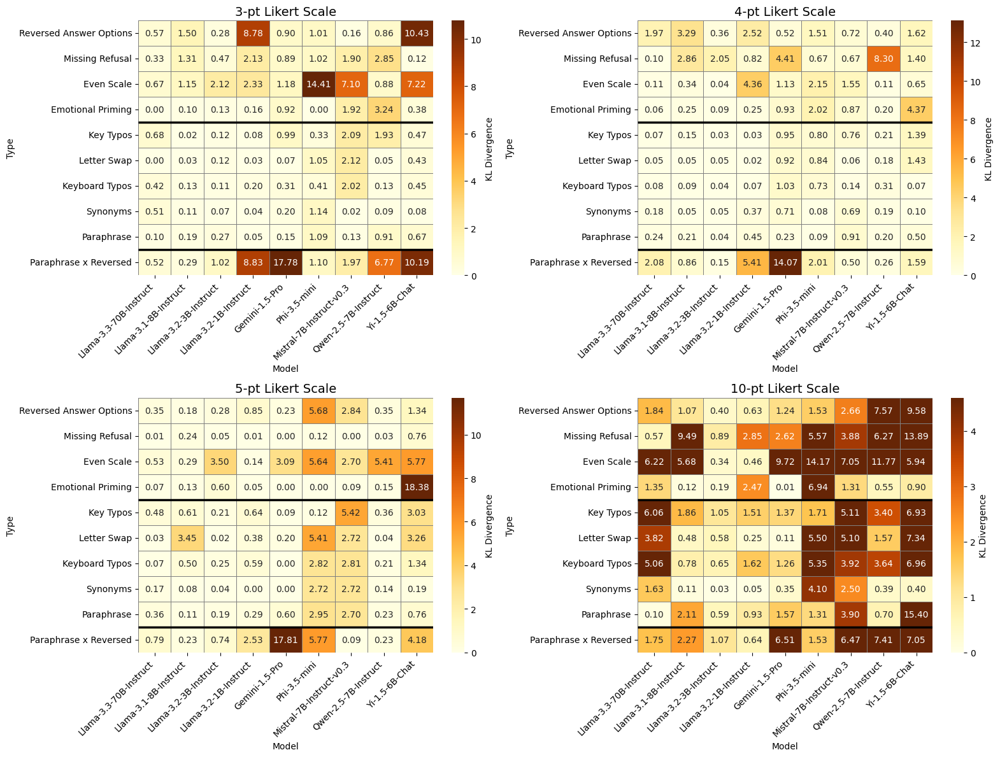

In [104]:
plot_combined_heatmaps(final_interviews_categorized, combinations=combinations,all_sorted_models=all_sorted_models)

Calculate the average KL-Divergence across questions contained in each model, perturbation, scale type combination.

In [105]:
def generate_avg_combined_scaletype_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a 2x2 matrix of heatmaps combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, grouped by scale type.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = ["3-pt Likert Scale", "4-pt Likert Scale", "5-pt Likert Scale", "10-pt Likert Scale"]
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [4, 9]  # Boundaries for horizontal lines

    # Create a 2x2 subplot matrix
    # fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    # axes = axes.flatten()

    for idx, category in enumerate(categories):
        results = []
        for model in models:
            for i, perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:
                    continue
                epsilon = 1e-6

                # Extract baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                     (data[column_model] == model) &
                                     (data["Scale Type"] == category)]
                if baseline_data.empty:
                    continue

                # Group by question ID for per-question KL divergence
                kl_values = []
                for question_id in baseline_data['Question ID'].unique():
                    baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                    baseline_distribution = (
                        baseline_question_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    #print(category, model, perturbation, question_id, baseline_distribution)
                    
                    perturbation_data = data[(data[column_model] == model) &
                                             (data[column_type] == perturbation) &
                                             (data["Scale Type"] == category) &
                                             (data['Question ID'] == question_id)]
                    if len(perturbation_data) == 0:
                        continue
                    perturbation_distribution = (
                        perturbation_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    #print(category, model, perturbation, question_id, perturbation_distribution)

                    # Compute KL divergence for this question
                    kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                    kl_values.append(kl_div)

                if kl_values:
                    #print(kl_values)
                    avg_kl_div = np.mean(kl_values)
                    print(category, model, perturbation, question_id,avg_kl_div)
                else:
                    avg_kl_div = np.nan

                # Append results
                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",
             'list_answer_options_reversed': "Reversed Answer Options",
             'original_emotional_prime': "Emotional Priming",
             'list_answer_middle': "Odd Scale",
             'list_answer_no_middle': "Even Scale",
             'question_typo': "Key Typos",
             'question_letter_swap': "Letter Swap",
             'question_synonym': "Synonyms",
             'question_paraphrased': "Paraphrase",
             'question_keyboardtypo': "Keyboard Typos",
             'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
        )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
        cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
        # Plot heatmap
        #vmax = np.nanmax(heatmap_data.values) / np.nanmean(heatmap_data.values)
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            #cmap=sns.color_palette("YlOrBr", as_cmap=True),
            #cmap="viridis",
            #cmap="YlOrBr",
            cmap = cmap,
            cbar_kws={'label': 'Avg. KL Divergence'},
            vmin=0,
            #vmax=vmax,
            linewidths=0.5,
            linecolor='gray',
            #ax=ax
        )

        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

        ax.set_title(f'Scale Type: {category}', fontsize=14)
        ax.set_ylabel("Perturbation")
        ax.set_xlabel("Model")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

        plt.tight_layout()
        plt.savefig(f"../thesis/figures/kl_avg_divergence_{category}_heatmap.pdf")
        plt.savefig(f"../thesis/figures/kl_avg_divergence_{category}_heatmap.png", transparent = True)
        plt.show()


3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_refusal Q220 4.003355579471121
3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_middle Q220 6.6244798991705505
3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_options_reversed Q220 11.356251255720943
3-pt Likert Scale Llama-3.3-70B-Instruct original_emotional_prime Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_typo Q220 8.610275897050512
3-pt Likert Scale Llama-3.3-70B-Instruct question_letter_swap Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_synonym Q220 5.706504676257033
3-pt Likert Scale Llama-3.3-70B-Instruct question_paraphrased Q220 2.839062813930236
3-pt Likert Scale Llama-3.3-70B-Instruct question_keyboardtypo Q220 5.869295350518449
3-pt Likert Scale Llama-3.3-70B-Instruct interaction_paraphrase_reversed Q220 8.603155125615805
3-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_refusal Q220 1.258301182577134
3-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_middle Q220 6.68013

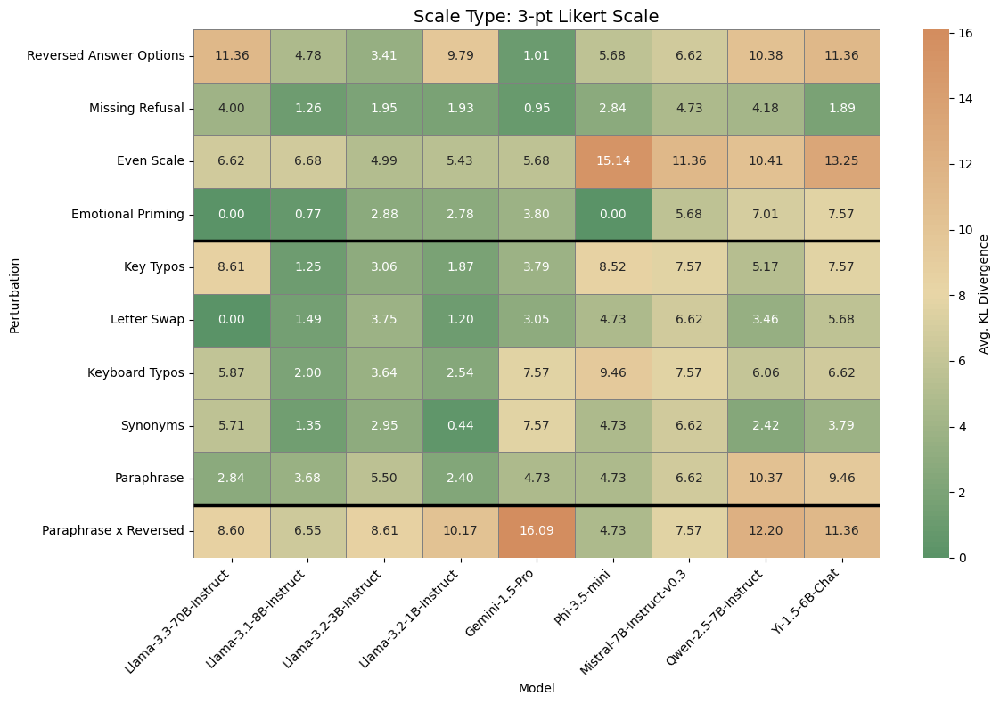

4-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_refusal Q230 0.6418291461821615
4-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_middle Q230 2.236991473804855
4-pt Likert Scale Llama-3.3-70B-Instruct list_answer_options_reversed Q230 5.316689908690506
4-pt Likert Scale Llama-3.3-70B-Instruct original_emotional_prime Q230 1.9311934132330486
4-pt Likert Scale Llama-3.3-70B-Instruct question_typo Q230 4.290325072834076
4-pt Likert Scale Llama-3.3-70B-Instruct question_letter_swap Q230 3.3422512803275506
4-pt Likert Scale Llama-3.3-70B-Instruct question_synonym Q230 4.944224496559719
4-pt Likert Scale Llama-3.3-70B-Instruct question_paraphrased Q230 4.930678884695942
4-pt Likert Scale Llama-3.3-70B-Instruct question_keyboardtypo Q230 1.3772623501274222
4-pt Likert Scale Llama-3.3-70B-Instruct interaction_paraphrase_reversed Q230 10.05318428635305
4-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_refusal Q230 2.768555873893616
4-pt Likert Scale Llama-3.1-8B-Instruct list

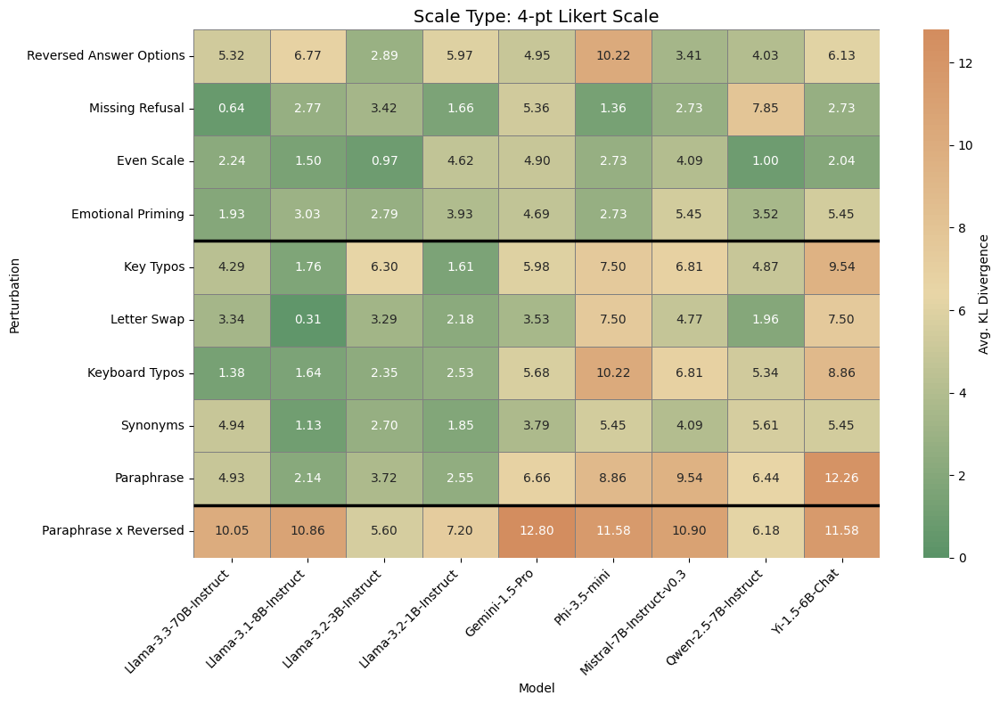

5-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.027438805533977245
5-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_middle Q41 10.716554498728987
5-pt Likert Scale Llama-3.3-70B-Instruct list_answer_options_reversed Q41 10.208928935392478
5-pt Likert Scale Llama-3.3-70B-Instruct original_emotional_prime Q41 4.430332064649627
5-pt Likert Scale Llama-3.3-70B-Instruct question_typo Q41 7.269394777234552
5-pt Likert Scale Llama-3.3-70B-Instruct question_letter_swap Q41 3.8625195018635794
5-pt Likert Scale Llama-3.3-70B-Instruct question_synonym Q41 4.430332064649627
5-pt Likert Scale Llama-3.3-70B-Instruct question_paraphrased Q41 4.07468020899343
5-pt Likert Scale Llama-3.3-70B-Instruct question_keyboardtypo Q41 3.8625195018635794
5-pt Likert Scale Llama-3.3-70B-Instruct interaction_paraphrase_reversed Q41 9.573495319102241
5-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_refusal Q41 0.854038776183856
5-pt Likert Scale Llama-3.1-8B-Instruct list_answer_n

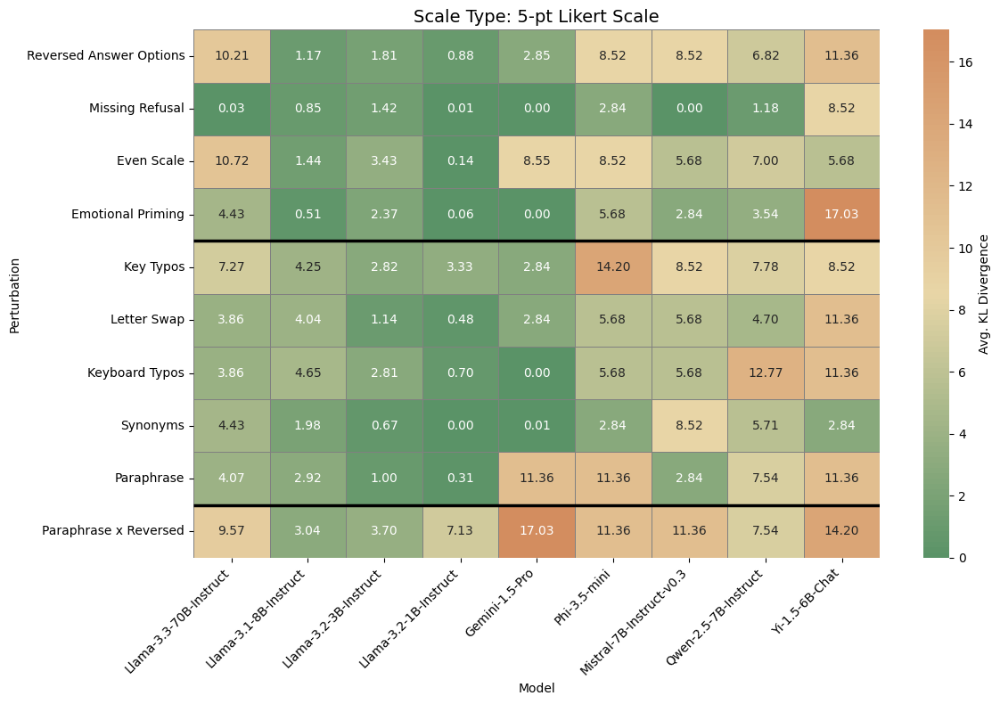

10-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_refusal Q248 0.6102026608688704
10-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_middle Q248 10.482693371076126
10-pt Likert Scale Llama-3.3-70B-Instruct list_answer_options_reversed Q248 4.472893542908216
10-pt Likert Scale Llama-3.3-70B-Instruct original_emotional_prime Q248 4.56540445838657
10-pt Likert Scale Llama-3.3-70B-Instruct question_typo Q248 6.494271625996013
10-pt Likert Scale Llama-3.3-70B-Instruct question_letter_swap Q248 7.8314010204123194
10-pt Likert Scale Llama-3.3-70B-Instruct question_synonym Q248 7.668959744672867
10-pt Likert Scale Llama-3.3-70B-Instruct question_paraphrased Q248 5.363922390806064
10-pt Likert Scale Llama-3.3-70B-Instruct question_keyboardtypo Q248 10.395615397157389
10-pt Likert Scale Llama-3.3-70B-Instruct interaction_paraphrase_reversed Q248 4.48264268565964
10-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_refusal Q248 9.324431725089307
10-pt Likert Scale Llama-3.1-8B-Ins

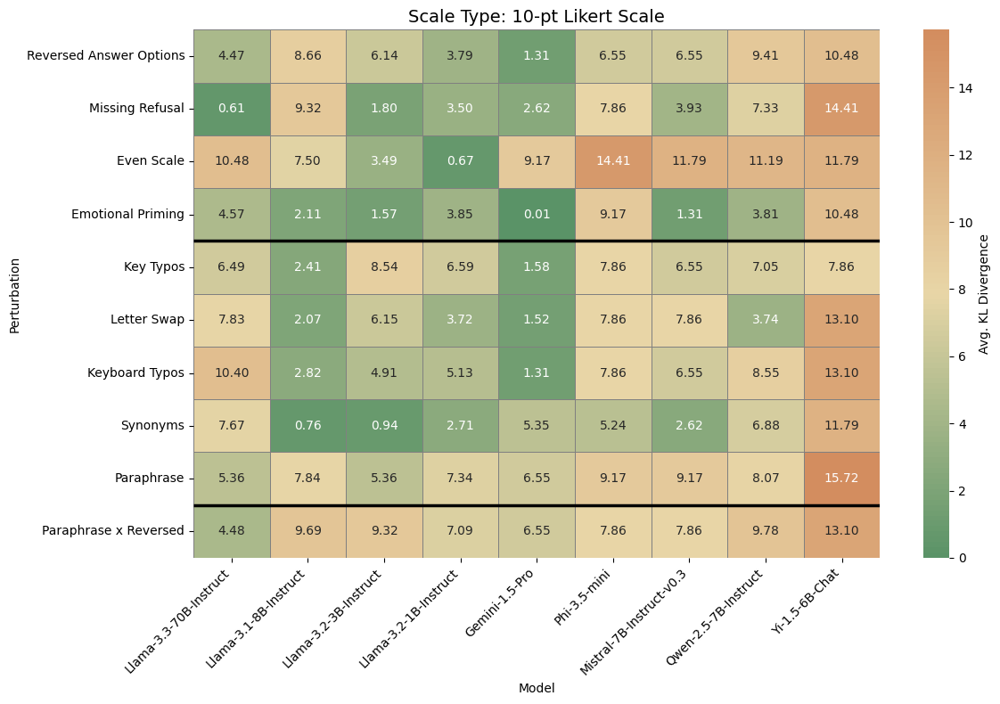

In [106]:
generate_avg_combined_scaletype_heatmap(final_interviews_categorized, combinations=combinations)

In [107]:
def generate_median_combined_scaletype_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a 2x2 matrix of heatmaps combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, grouped by scale type.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = ["3-pt Likert Scale", "4-pt Likert Scale", "5-pt Likert Scale", "10-pt Likert Scale"]
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [4, 9]  # Boundaries for horizontal lines

    # Create a 2x2 subplot matrix
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()

    for idx, category in enumerate(categories):
        results = []
        for model in models:
            for i, perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:
                    continue
                epsilon = 1e-6

                # Extract baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                     (data[column_model] == model) &
                                     (data["Scale Type"] == category)]
                if baseline_data.empty:
                    continue

                # Group by question ID for per-question KL divergence
                kl_values = []
                for question_id in baseline_data['Question ID'].unique():
                    baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                    baseline_distribution = (
                        baseline_question_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    #print(category, model, perturbation, question_id, baseline_distribution)
                    
                    perturbation_data = data[(data[column_model] == model) &
                                             (data[column_type] == perturbation) &
                                             (data["Scale Type"] == category) &
                                             (data['Question ID'] == question_id)]
                    if len(perturbation_data) == 0:
                        continue
                    perturbation_distribution = (
                        perturbation_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    #print(category, model, perturbation, question_id, perturbation_distribution)

                    # Compute KL divergence for this question
                    kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                    kl_values.append(kl_div)

                if kl_values:
                    #print(kl_values)
                    avg_kl_div = np.median(kl_values)
                    print(category, model, perturbation, question_id,avg_kl_div)
                else:
                    avg_kl_div = np.nan

                # Append results
                results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",
             'list_answer_options_reversed': "Reversed Answer Options",
             'original_emotional_prime': "Emotional Priming",
             'list_answer_middle': "Odd Scale",
             'list_answer_no_middle': "Even Scale",
             'question_typo': "Key Typos",
             'question_letter_swap': "Letter Swap",
             'question_synonym': "Synonyms",
             'question_paraphrased': "Paraphrase",
             'question_keyboardtypo': "Keyboard Typos",
             'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
        )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

        # Plot heatmap
        #vmax = np.nanmax(heatmap_data.values) / np.nanmean(heatmap_data.values)
        ax = axes[idx]
        sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            #cmap=sns.color_palette("YlOrBr", as_cmap=True),
            #cmap="viridis",
            cmap="YlOrBr",
            cbar_kws={'label': 'Median KL Divergence'},
            vmin=0,
            #vmax=vmax,
            linewidths=0.5,
            linecolor='gray',
            ax=ax
        )

        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

        ax.set_title(f'Scale Type: {category}', fontsize=14)
        ax.set_ylabel("Perturbation")
        ax.set_xlabel("Model")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_median_divergence_scaletype_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_median_divergence_scaletype_heatmap.png", transparent = True)
    plt.show()


3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_refusal Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_no_middle Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct list_answer_options_reversed Q220 17.034376883581416
3-pt Likert Scale Llama-3.3-70B-Instruct original_emotional_prime Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_typo Q220 9.028013120464959
3-pt Likert Scale Llama-3.3-70B-Instruct question_letter_swap Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_synonym Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_paraphrased Q220 0.0
3-pt Likert Scale Llama-3.3-70B-Instruct question_keyboardtypo Q220 0.23452130370136515
3-pt Likert Scale Llama-3.3-70B-Instruct interaction_paraphrase_reversed Q220 9.153670563180262
3-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_refusal Q220 0.055325541487792264
3-pt Likert Scale Llama-3.1-8B-Instruct list_answer_no_middle Q220 2.906473881475133
3-pt Likert Scale Llama-3.1-8B-Instruct l

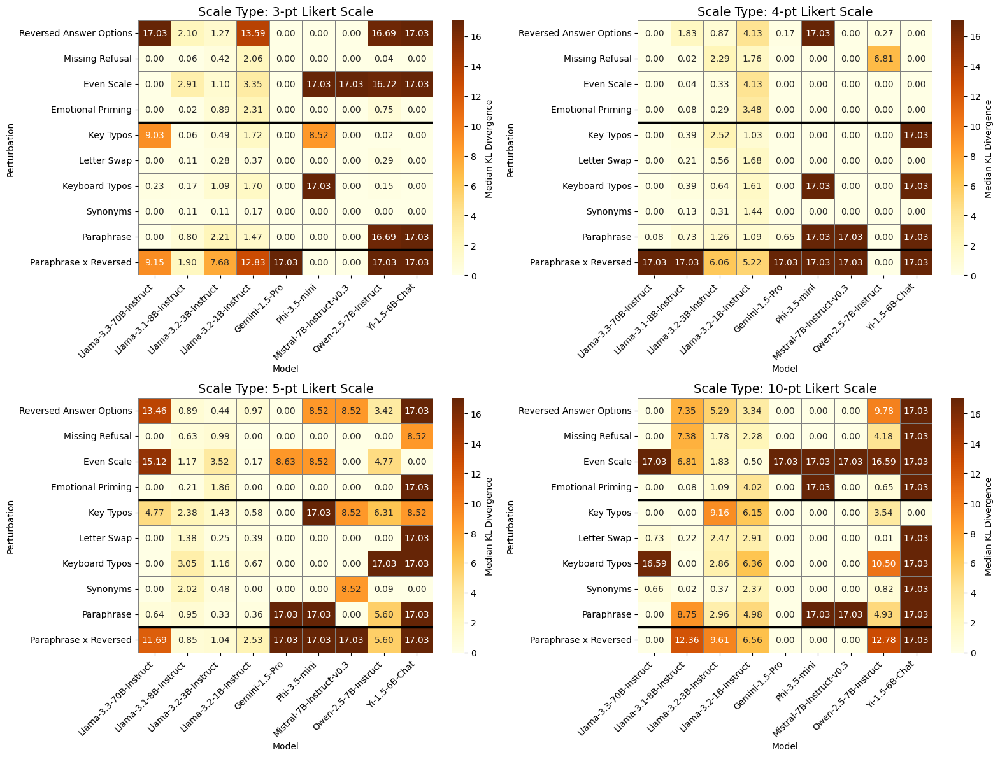

In [108]:
generate_median_combined_scaletype_heatmap(final_interviews_categorized, combinations=combinations)

Calculate average kl-divergence across all question, not separated by scale type.

In [109]:
def generate_avg_kldiv_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [4, 9]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div = np.mean(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    # Plot heatmap
    fig, ax = plt.subplots(figsize=(16, 12))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        #cmap="YlOrBr",
        cmap = cmap,
        cbar_kws={'label': 'Avg. KL Divergence'},
        vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    ax.set_title('Average KL Divergence Across All Scale Types', fontsize=14)
    ax.set_ylabel("Perturbation")
    ax.set_xlabel("Model")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_avg_divergence_allQs_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_avg_divergence_allQs_heatmap.png", transparent = True)
    plt.show()

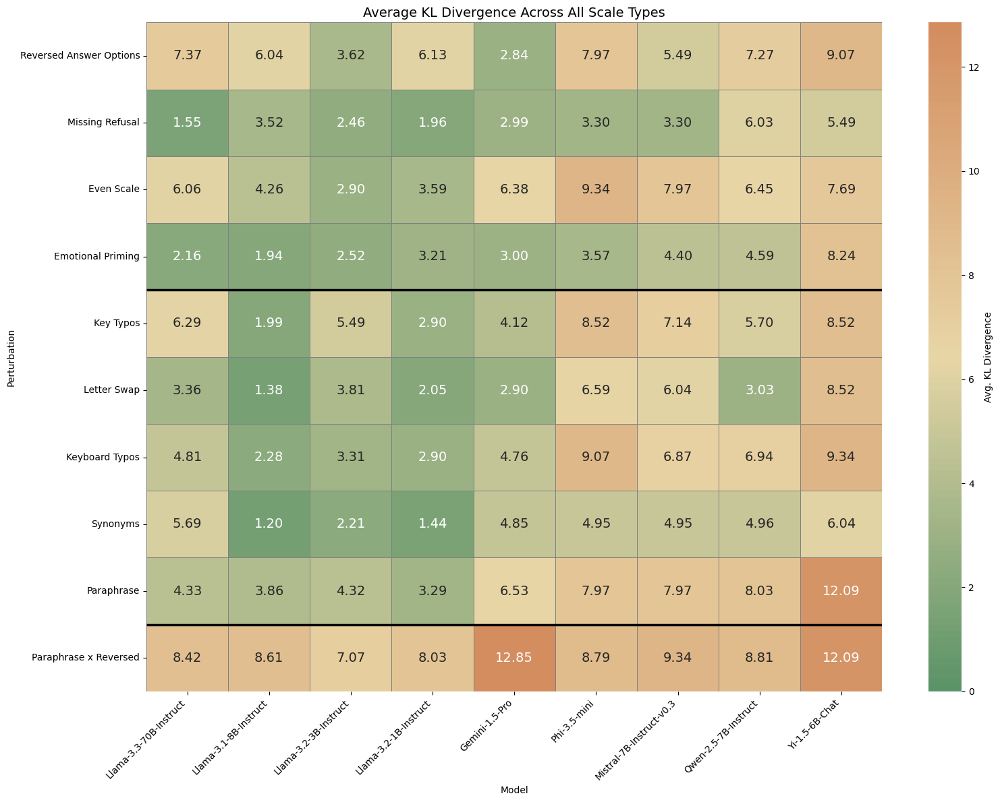

In [110]:
generate_avg_kldiv_heatmap(final_interviews_categorized, combinations=combinations)

In [111]:
non_bias_combination = pd.DataFrame({
        
        "baseline": [
        'list_answer_options','list_answer_options','list_answer_options',
        'list_answer_options','list_answer_options','list_answer_options'],
        
        "alternative": [
        'question_typo', 'question_letter_swap', 'question_synonym',
        'question_paraphrased', 'question_keyboardtypo',
        'interaction_paraphrase_reversed']
        })

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

def generate_avg_kldiv_nonbias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        #"Reversed Answer Options",
        #"Missing Refusal",
        #"Even Scale",
        #"Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution,perturbation_distribution)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div = np.mean(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {#'list_answer_no_refusal': "Missing Refusal",
         #'list_answer_options_reversed': "Reversed Answer Options",
         #'original_emotional_prime': "Emotional Priming",
         #'list_answer_middle': "Odd Scale",
         #'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    # Plot heatmap
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap=cmap,
        #cmap="YlOrBr",
        cbar_kws={'label': 'Avg. KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Average KL Divergence for Non-Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_avg_divergence_nonbias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_avg_divergence_nonbias_heatmap.png", transparent=True)
    plt.show()

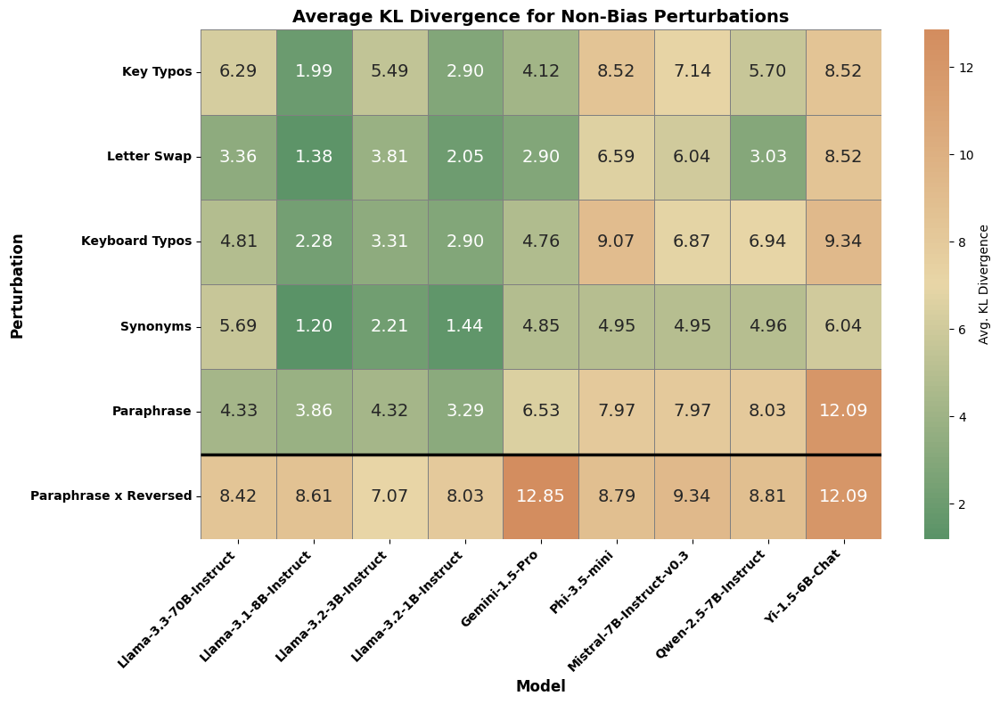

In [113]:
generate_avg_kldiv_nonbias_heatmap(final_interviews_categorized, combinations=non_bias_combination)

In [114]:
def generate_median_kldiv_nonbias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        #"Reversed Answer Options",
        #"Missing Refusal",
        #"Even Scale",
        #"Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution,perturbation_distribution)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div = np.median(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {#'list_answer_no_refusal': "Missing Refusal",
         #'list_answer_options_reversed': "Reversed Answer Options",
         #'original_emotional_prime': "Emotional Priming",
         #'list_answer_middle': "Odd Scale",
         #'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'Median KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Median KL Divergence for Non-Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_median_divergence_nonbias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_median_divergence_nonbias_heatmap.png", transparent = True)
    plt.show()

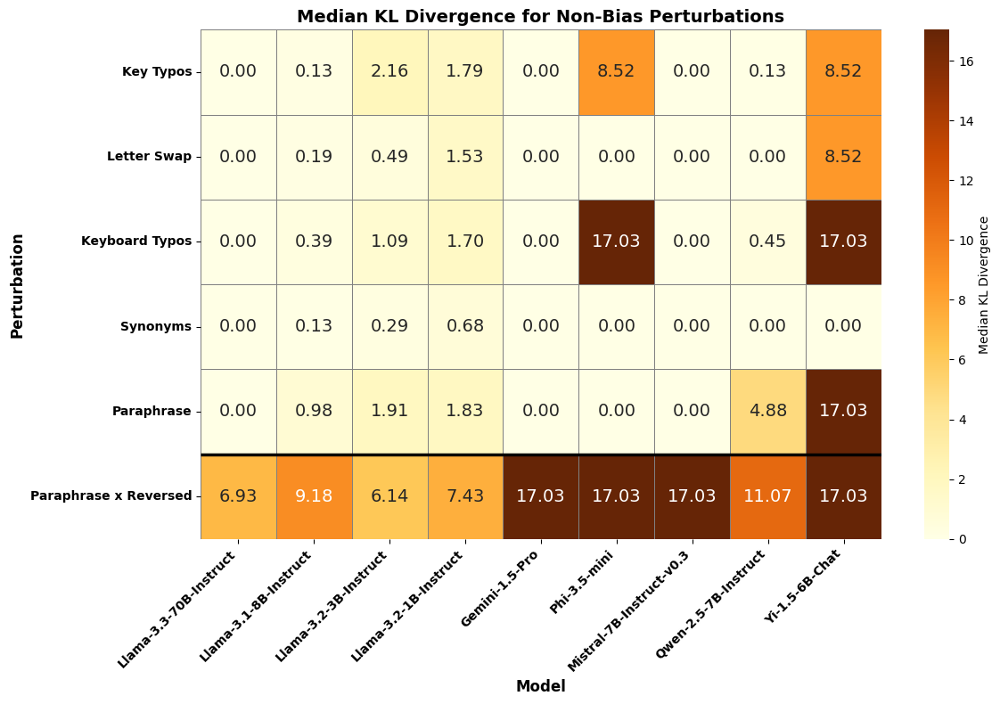

In [115]:
generate_median_kldiv_nonbias_heatmap(final_interviews_categorized, combinations=non_bias_combination)

Now for only bias-perturbations!

In [116]:
# define combinations because list_answer_middle type mus be compared to list_answer_no_middle
bias_combinations = pd.DataFrame({
        
        "baseline": ['list_answer_options', 'list_answer_middle', 
        'list_answer_options', 'list_answer_options'],
        
        "alternative": [
        'list_answer_no_refusal', 'list_answer_no_middle',
        'list_answer_options_reversed',
        'original_emotional_prime']
        })

In [117]:
def generate_avg_kldiv_bias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        #"Key Typos",
        #"Letter Swap",
        #"Keyboard Typos",
        #"Synonyms",
        #"Paraphrase",
        #"Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)
                print(model, perturbation, question_id, kl_div, sum(kl_values))
            if kl_values:
                avg_kl_div = np.mean(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         #'question_typo': "Key Typos",
         #'question_letter_swap': "Letter Swap",
         #'question_synonym': "Synonyms",
         #'question_paraphrased': "Paraphrase",
         #'question_keyboardtypo': "Keyboard Typos",
         #'interaction_paraphrase_reversed': "Paraphrase x Reversed"
         }
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    # Plot heatmap
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        #cmap="YlOrBr",
        cmap = cmap,
        cbar_kws={'label': 'Avg. KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Average KL Divergence for Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_avg_divergence_bias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_avg_divergence_bias_heatmap.png", transparent = True)
    plt.show()

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 13.29173284482784

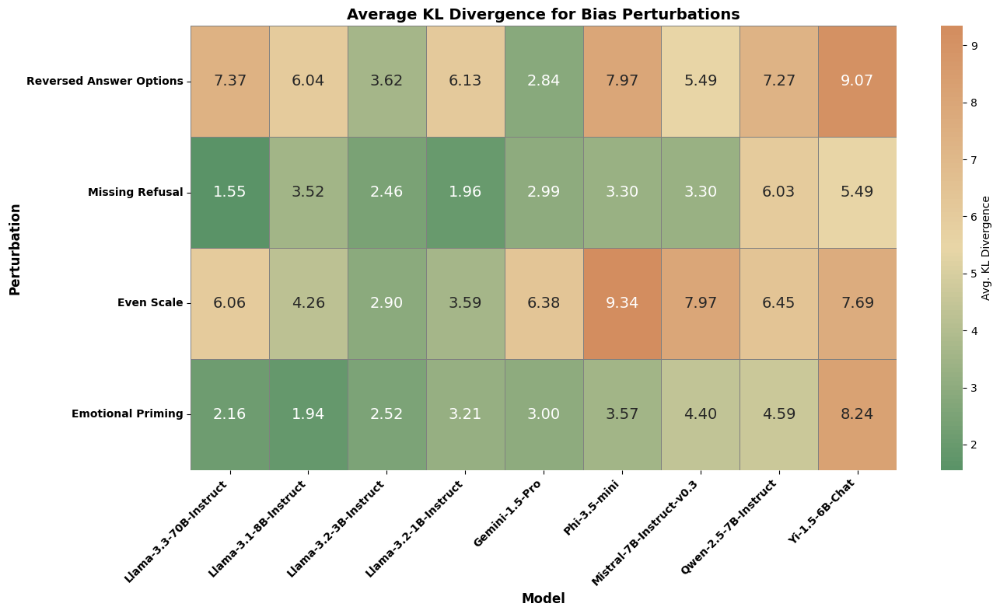

In [118]:
generate_avg_kldiv_bias_heatmap(final_interviews_categorized, combinations=bias_combinations)

In [119]:
def generate_median_kldiv_bias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        #"Key Typos",
        #"Letter Swap",
        #"Keyboard Typos",
        #"Synonyms",
        #"Paraphrase",
        #"Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)
                print(model, perturbation, question_id, kl_div, sum(kl_values))
            if kl_values:
                avg_kl_div = np.median(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         #'question_typo': "Key Typos",
         #'question_letter_swap': "Letter Swap",
         #'question_synonym': "Synonyms",
         #'question_paraphrased': "Paraphrase",
         #'question_keyboardtypo': "Keyboard Typos",
         #'interaction_paraphrase_reversed': "Paraphrase x Reversed"
         }
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'Median KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Median KL Divergence for Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_median_divergence_bias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_median_divergence_bias_heatmap.png", transparent = True)
    plt.show()

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 13.29173284482784

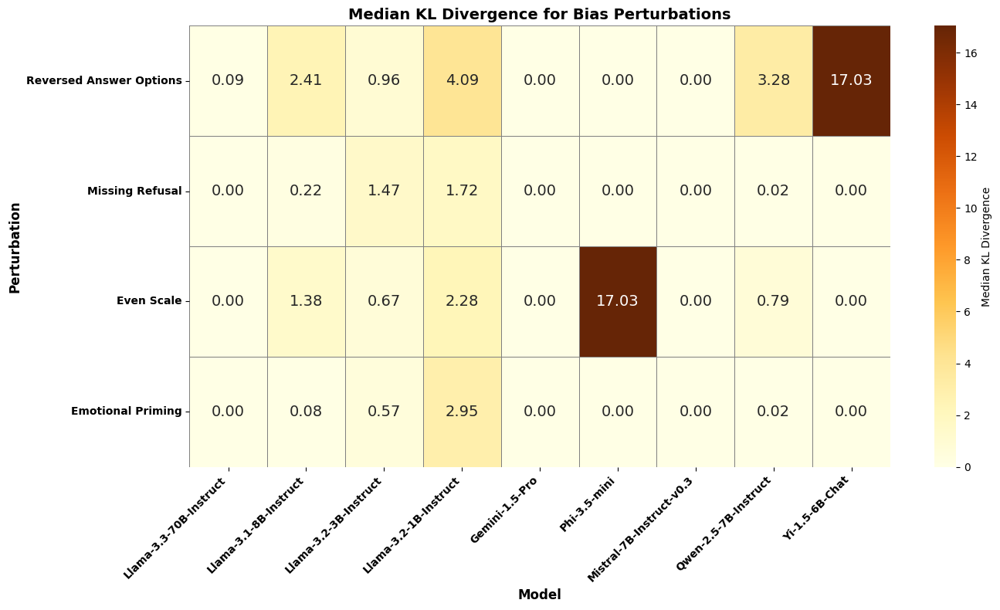

In [120]:
generate_median_kldiv_bias_heatmap(final_interviews_categorized, combinations=bias_combinations)

Weighted Mean due to single outliers!

In [121]:
def generate_weighted_kldiv_nonbias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        #"Reversed Answer Options",
        #"Missing Refusal",
        #"Even Scale",
        #"Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution,perturbation_distribution)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div = np.average(kl_values, weights=1/(1 + (kl_values - np.median(kl_values))**2))
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {#'list_answer_no_refusal': "Missing Refusal",
         #'list_answer_options_reversed': "Reversed Answer Options",
         #'original_emotional_prime': "Emotional Priming",
         #'list_answer_middle': "Odd Scale",
         #'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'Weighted KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Weighted KL Divergence for Non-Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_weighted_divergence_nonbias_heatmap.pdf")
    plt.show()

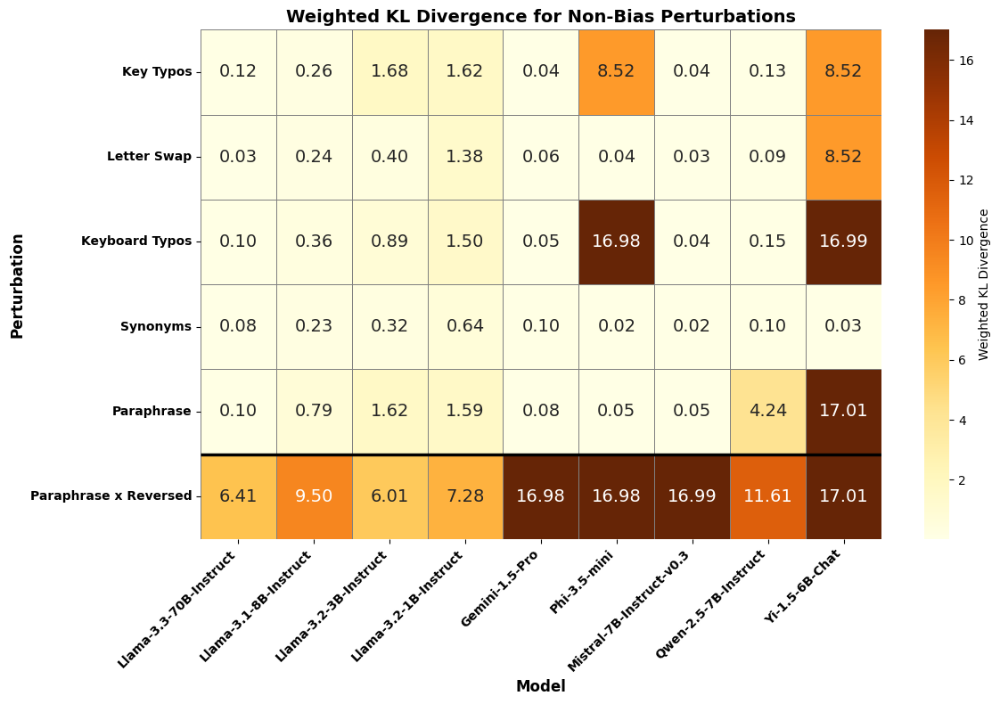

In [122]:
generate_weighted_kldiv_nonbias_heatmap(final_interviews_categorized, combinations=non_bias_combination)

In [123]:
def generate_weighted_kldiv_bias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        #"Key Typos",
        #"Letter Swap",
        #"Keyboard Typos",
        #"Synonyms",
        #"Paraphrase",
        #"Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)
                print(model, perturbation, question_id, kl_div, sum(kl_values))
            if kl_values:
                avg_kl_div = np.average(kl_values, weights=1/(1 + (kl_values - np.median(kl_values))**2))
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         #'question_typo': "Key Typos",
         #'question_letter_swap': "Letter Swap",
         #'question_synonym': "Synonyms",
         #'question_paraphrased': "Paraphrase",
         #'question_keyboardtypo': "Keyboard Typos",
         #'interaction_paraphrase_reversed': "Paraphrase x Reversed"
         }
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'Median KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Weighted KL Divergence for Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_weighted_divergence_bias_heatmap.pdf")
    plt.show()

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 13.29173284482784

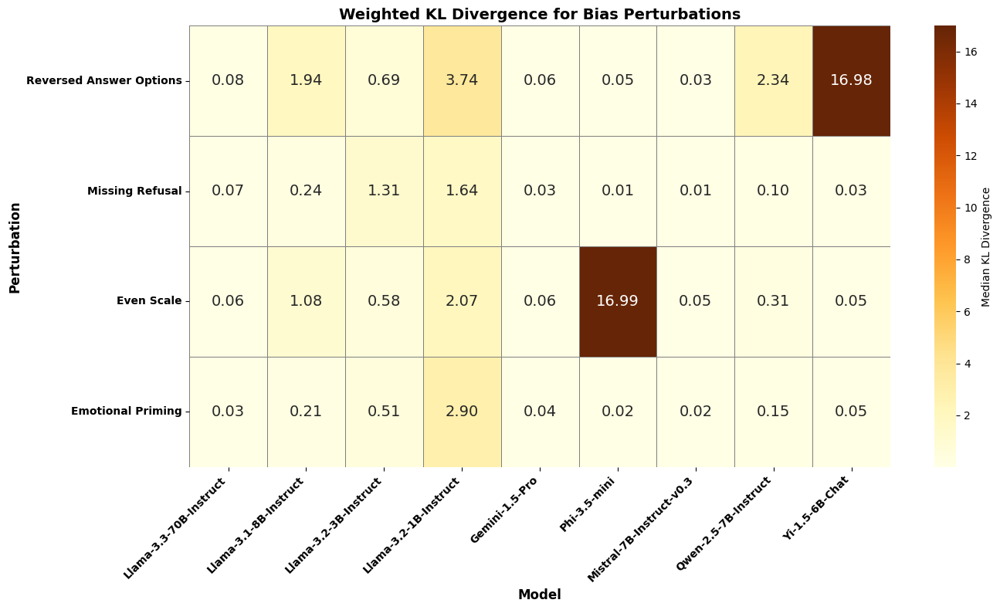

In [124]:
generate_weighted_kldiv_bias_heatmap(final_interviews_categorized, combinations=bias_combinations)

Calculate 80th Percentile

In [125]:
def generate_75pct_kldiv_nonbias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        #"Reversed Answer Options",
        #"Missing Refusal",
        #"Even Scale",
        #"Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution,perturbation_distribution)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div =  np.percentile(kl_values, 75) 
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {#'list_answer_no_refusal': "Missing Refusal",
         #'list_answer_options_reversed': "Reversed Answer Options",
         #'original_emotional_prime': "Emotional Priming",
         #'list_answer_middle': "Odd Scale",
         #'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('75th Percentile KL Divergence for Non-Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_75pct_divergence_nonbias_heatmap.pdf")
    plt.show()

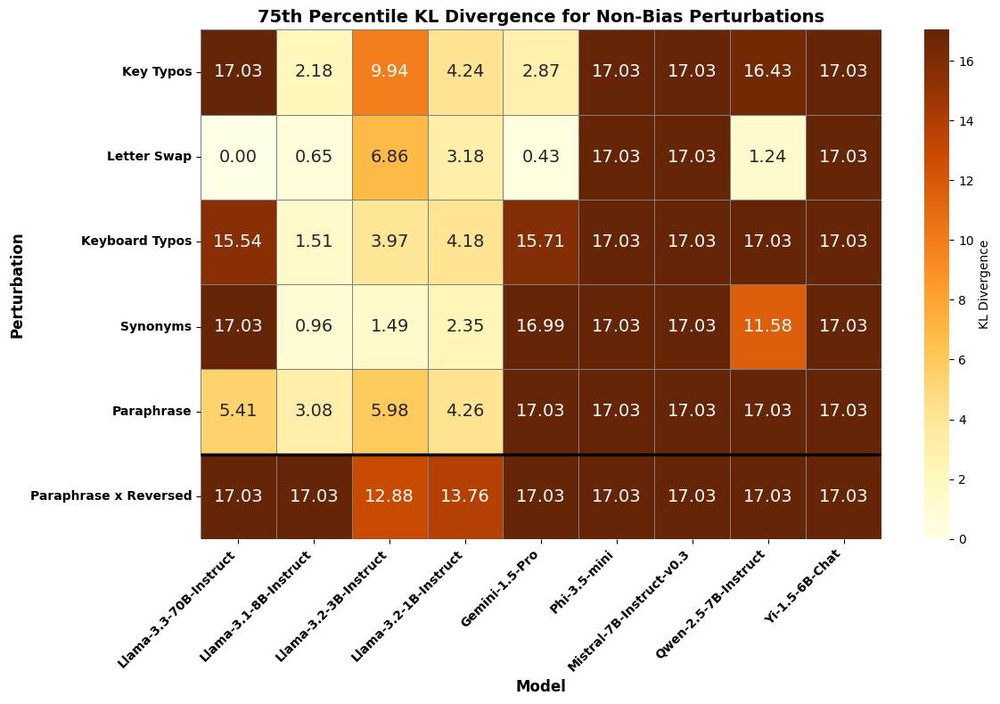

In [126]:
generate_75pct_kldiv_nonbias_heatmap(final_interviews_categorized, combinations=non_bias_combination)

In [127]:
def generate_75pct_kldiv_bias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        #"Key Typos",
        #"Letter Swap",
        #"Keyboard Typos",
        #"Synonyms",
        #"Paraphrase",
        #"Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)
                print(model, perturbation, question_id, kl_div, sum(kl_values))
            if kl_values:
                avg_kl_div = np.percentile(kl_values, 75)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'KL Divergence': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         #'question_typo': "Key Typos",
         #'question_letter_swap': "Letter Swap",
         #'question_synonym': "Synonyms",
         #'question_paraphrased': "Paraphrase",
         #'question_keyboardtypo': "Keyboard Typos",
         #'interaction_paraphrase_reversed': "Paraphrase x Reversed"
         }
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='KL Divergence')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap="YlOrBr",
        cbar_kws={'label': 'KL Divergence'},
        #vmin=0,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('75th Percentile KL Divergence for Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_75pct_divergence_bias_heatmap.pdf")
    plt.show()

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 13.29173284482784

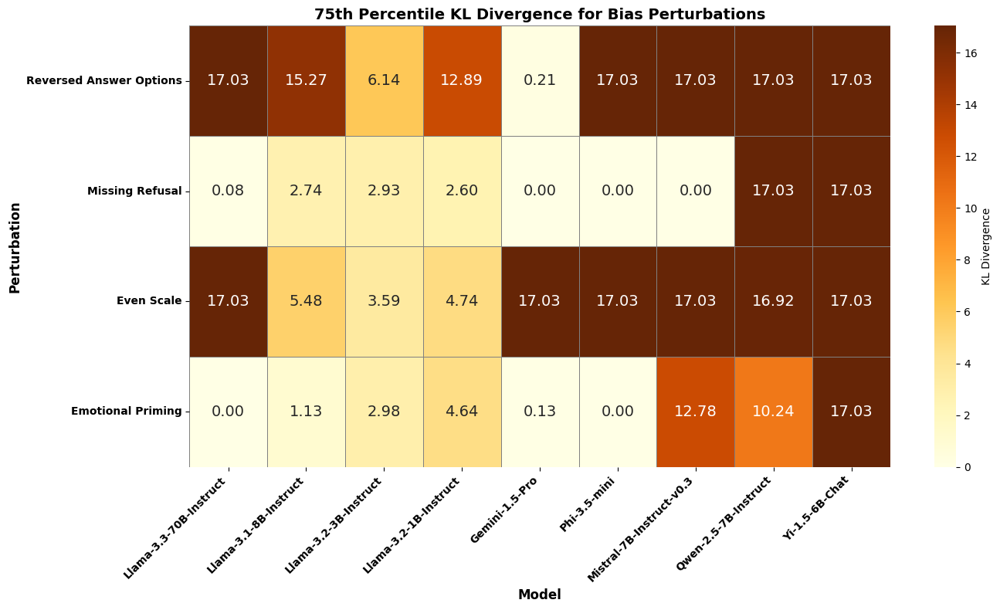

In [128]:
generate_75pct_kldiv_bias_heatmap(final_interviews_categorized, combinations=bias_combinations)

Calculate the share of totally robust responses!

In [129]:
def generate_share_kldiv_nonbias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        #"Reversed Answer Options",
        #"Missing Refusal",
        #"Even Scale",
        #"Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = round(sci.stats.entropy(baseline_distribution,perturbation_distribution),2)
                #print(kl_div)
                kl_values.append(kl_div)

            if kl_values:
                avg_kl_div = kl_values.count(0)/len(kl_values) 
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'Robust Share': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {#'list_answer_no_refusal': "Missing Refusal",
         #'list_answer_options_reversed': "Reversed Answer Options",
         #'original_emotional_prime': "Emotional Priming",
         #'list_answer_middle': "Odd Scale",
         #'list_answer_no_middle': "Even Scale",
         'question_typo': "Key Typos",
         'question_letter_swap': "Letter Swap",
         'question_synonym': "Synonyms",
         'question_paraphrased': "Paraphrase",
         'question_keyboardtypo': "Keyboard Typos",
         'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='Robust Share')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)

    colors = ["#D38D5F", "#E8D6A7", "#5A9367"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=20)
    
    # Plot heatmap
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap=cmap,
        cbar_kws={'label': 'Share of Fully Robust Responses'},
        vmin=0,
        vmax=1,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Robustness for Non-Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_share_divergence_nonbias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_share_divergence_nonbias_heatmap.png", transparent = True)
    plt.show()

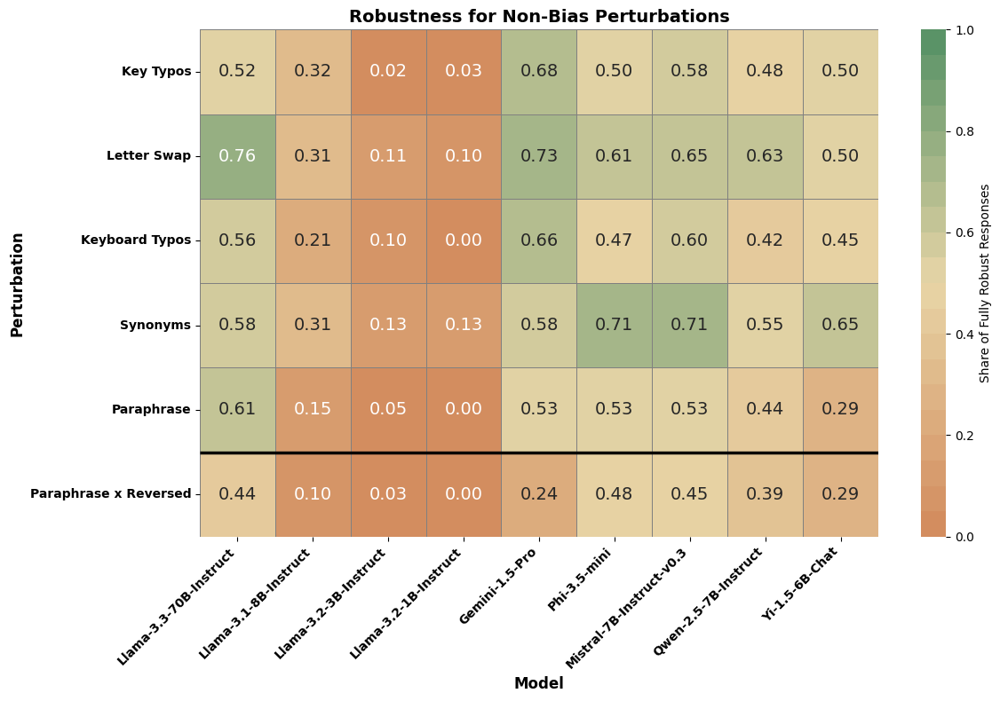

In [130]:
generate_share_kldiv_nonbias_heatmap(final_interviews_categorized,combinations=non_bias_combination)

In [131]:
def generate_share_kldiv_bias_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a single heatmap combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, ignoring scale type categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        #"Key Typos",
        #"Letter Swap",
        #"Keyboard Typos",
        #"Synonyms",
        #"Paraphrase",
        #"Paraphrase x Reversed"
    ]
    group_boundaries = [5]  # Boundaries for horizontal lines

    # Initialize results list
    results = []

    for model in models:
        for i, perturbation in enumerate(combinations["alternative"]):
            if perturbation == combinations["baseline"].iloc[i]:
                continue
            epsilon = 1e-6

            # Extract baseline distribution
            baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                 (data[column_model] == model)]
            if baseline_data.empty:
                continue

            # Group by question ID for per-question KL divergence
            kl_values = []
            for question_id in baseline_data['Question ID'].unique():
                baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                baseline_distribution = (
                    baseline_question_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon
                
                perturbation_data = data[(data[column_model] == model) &
                                         (data[column_type] == perturbation) &
                                         (data['Question ID'] == question_id)]
                if len(perturbation_data) == 0:
                    continue
                perturbation_distribution = (
                    perturbation_data[column_response].value_counts()
                    .reindex(data[column_response].unique(), fill_value=0)
                ) + epsilon

                # Compute KL divergence for this question
                kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                kl_values.append(kl_div)
                print(model, perturbation, question_id, kl_div, sum(kl_values))
            if kl_values:
                avg_kl_div = kl_values.count(0)/len(kl_values)
            else:
                avg_kl_div = np.nan

            # Append results
            results.append({'Model': model, 'Type': perturbation, 'Robust Share': avg_kl_div})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
        {'list_answer_no_refusal': "Missing Refusal",
         'list_answer_options_reversed': "Reversed Answer Options",
         'original_emotional_prime': "Emotional Priming",
         'list_answer_middle': "Odd Scale",
         'list_answer_no_middle': "Even Scale",
         #'question_typo': "Key Typos",
         #'question_letter_swap': "Letter Swap",
         #'question_synonym': "Synonyms",
         #'question_paraphrased': "Paraphrase",
         #'question_keyboardtypo': "Keyboard Typos",
         #'interaction_paraphrase_reversed': "Paraphrase x Reversed"
         }
    )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='Robust Share')
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    
    colors = ["#D38D5F", "#E8D6A7", "#5A9367"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=20)
    
    # Plot heatmap
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap=cmap,
        cbar_kws={'label': 'Share of Fully Robust Responses'},
        vmin=0,
        vmax=1,
        linewidths=0.5,
        linecolor='gray',
        ax=ax,
        annot_kws={"size": 14} 
    )

    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Set title and axis labels
    ax.set_title('Robustness for Bias Perturbations', fontsize=14, weight='bold')
    ax.set_ylabel("Perturbation", fontsize=12, weight='bold')
    ax.set_xlabel("Model", fontsize=12, weight='bold')

    # Make x and y axis tick labels bold
    for tick in ax.get_xticklabels():
        tick.set_weight('bold')
    for tick in ax.get_yticklabels():
        tick.set_weight('bold')
    ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig("../thesis/figures/kl_share_divergence_bias_heatmap.pdf")
    plt.savefig("../thesis/figures/kl_share_divergence_bias_heatmap.png", transparent = True)
    plt.show()

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 13.127100011623984
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 13.291732844827848
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 13.29173284482784

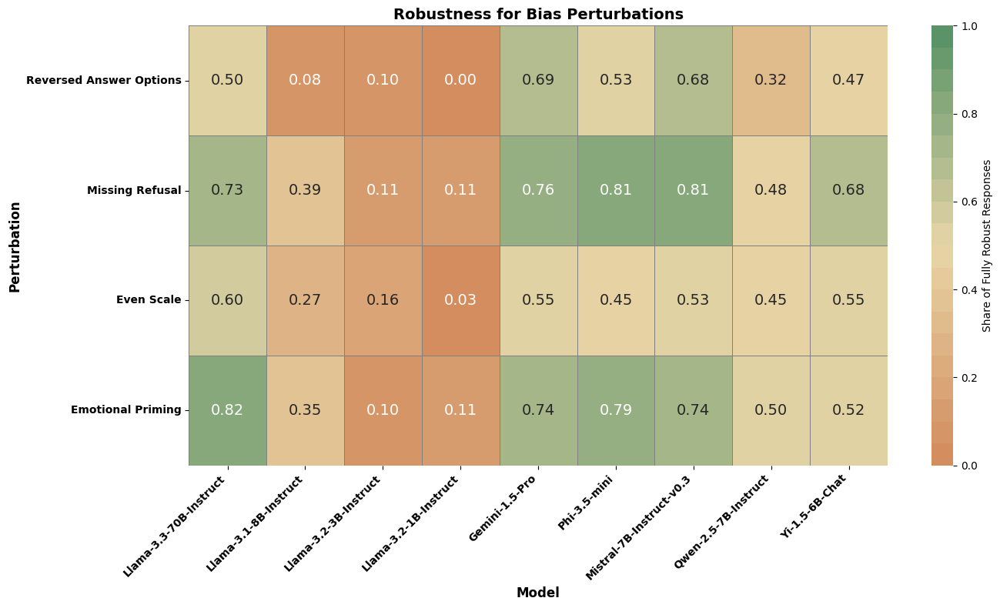

In [132]:
generate_share_kldiv_bias_heatmap(final_interviews_categorized, combinations=bias_combinations)

Share of Robust Answers by Scaletype!

In [133]:
def generate_share_robust_scaletype_heatmap(data, combinations, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a 2x2 matrix of heatmaps combining KL divergence (color and annotation) and Chi-squared p-values (annotation)
    for categorical 'extracted_response' distributions relative to a baseline distribution, grouped by scale type.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = ["3-pt Likert Scale", "4-pt Likert Scale", "5-pt Likert Scale", "10-pt Likert Scale"]
    desired_order = [
        "Reversed Answer Options",
        "Missing Refusal",
        "Even Scale",
        "Emotional Priming",
        "Key Typos",
        "Letter Swap",
        "Keyboard Typos",
        "Synonyms",
        "Paraphrase",
        "Paraphrase x Reversed"
    ]
    group_boundaries = [4, 9]  # Boundaries for horizontal lines

    # Create a 2x2 subplot matrix
    # fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    # axes = axes.flatten()

    for idx, category in enumerate(categories):
        results = []
        for model in models:
            for i, perturbation in enumerate(combinations["alternative"]):
                if perturbation == combinations["baseline"].iloc[i]:
                    continue
                epsilon = 1e-6

                # Extract baseline distribution
                baseline_data = data[(data[column_type] == combinations["baseline"].iloc[i]) &
                                     (data[column_model] == model) &
                                     (data["Scale Type"] == category)]
                if baseline_data.empty:
                    continue

                # Group by question ID for per-question KL divergence
                kl_values = []
                for question_id in baseline_data['Question ID'].unique():
                    baseline_question_data = baseline_data[baseline_data['Question ID'] == question_id]
                    baseline_distribution = (
                        baseline_question_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    
                    #print(category, model, perturbation, question_id, baseline_distribution)
                    
                    perturbation_data = data[(data[column_model] == model) &
                                             (data[column_type] == perturbation) &
                                             (data["Scale Type"] == category) &
                                             (data['Question ID'] == question_id)]
                    if len(perturbation_data) == 0:
                        continue
                    perturbation_distribution = (
                        perturbation_data[column_response].value_counts()
                        .reindex(data[column_response].unique(), fill_value=0)
                    ) + epsilon
                    #print(category, model, perturbation, question_id, perturbation_distribution)

                    # Compute KL divergence for this question
                    kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                    kl_values.append(kl_div)
                
                    # Compute KL divergence for this question
                    kl_div = sci.stats.entropy(baseline_distribution, perturbation_distribution)
                    kl_values.append(kl_div)
                    print(model, perturbation, question_id, kl_div, sum(kl_values))
                
                if kl_values:
                    avg_kl_div = kl_values.count(0)/len(kl_values)
                else:
                    avg_kl_div = np.nan

                # Append results
                results.append({'Model': model, 'Type': perturbation, 'Robust Share': avg_kl_div})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_no_refusal': "Missing Refusal",
             'list_answer_options_reversed': "Reversed Answer Options",
             'original_emotional_prime': "Emotional Priming",
             'list_answer_middle': "Odd Scale",
             'list_answer_no_middle': "Even Scale",
             'question_typo': "Key Typos",
             'question_letter_swap': "Letter Swap",
             'question_synonym': "Synonyms",
             'question_paraphrased': "Paraphrase",
             'question_keyboardtypo': "Keyboard Typos",
             'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
        )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='Robust Share')
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
        colors = [ "#D38D5F","#E8D6A7","#5A9367"]  
        cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
        # Plot heatmap
        #vmax = np.nanmax(heatmap_data.values) / np.nanmean(heatmap_data.values)
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=True,
            fmt=".2f",
            #cmap=sns.color_palette("YlOrBr", as_cmap=True),
            #cmap="viridis",
            #cmap="YlOrBr",
            cmap = cmap,
            cbar_kws={'label': 'Share of Fully Robust Responses'},
            vmin=0,
            vmax=1,
            linewidths=0.5,
            linecolor='gray',
            #ax=ax
        )

        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

        ax.set_title(f'Robustness by Scale Type: {category}', fontsize=14)
        ax.set_ylabel("Perturbation")
        ax.set_xlabel("Model")
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

        plt.tight_layout()
        plt.savefig(f"../thesis/figures/kl_share_robust_{category}_heatmap.pdf")
        plt.savefig(f"../thesis/figures/kl_share_robust_{category}_heatmap.png", transparent = True)
        plt.show()


Llama-3.3-70B-Instruct list_answer_no_refusal Q94 2.1202614640687996 4.240522928137599
Llama-3.3-70B-Instruct list_answer_no_refusal Q95 0.4462862075502176 5.133095343238034
Llama-3.3-70B-Instruct list_answer_no_refusal Q96 17.034376883581416 39.201849110400865
Llama-3.3-70B-Instruct list_answer_no_refusal Q97 17.034376883581416 73.2706028775637
Llama-3.3-70B-Instruct list_answer_no_refusal Q98 17.034376883581416 107.33935664472654
Llama-3.3-70B-Instruct list_answer_no_refusal Q99 0.0 107.33935664472654
Llama-3.3-70B-Instruct list_answer_no_refusal Q122 0.0 107.33935664472654
Llama-3.3-70B-Instruct list_answer_no_refusal Q123 0.0 107.33935664472654
Llama-3.3-70B-Instruct list_answer_no_refusal Q124 1.2729642427791055 109.88528513028476
Llama-3.3-70B-Instruct list_answer_no_refusal Q126 0.0 109.88528513028476
Llama-3.3-70B-Instruct list_answer_no_refusal Q128 0.08338098175637514 110.05204709379751
Llama-3.3-70B-Instruct list_answer_no_refusal Q129 17.034376883581416 144.12080086096034
L

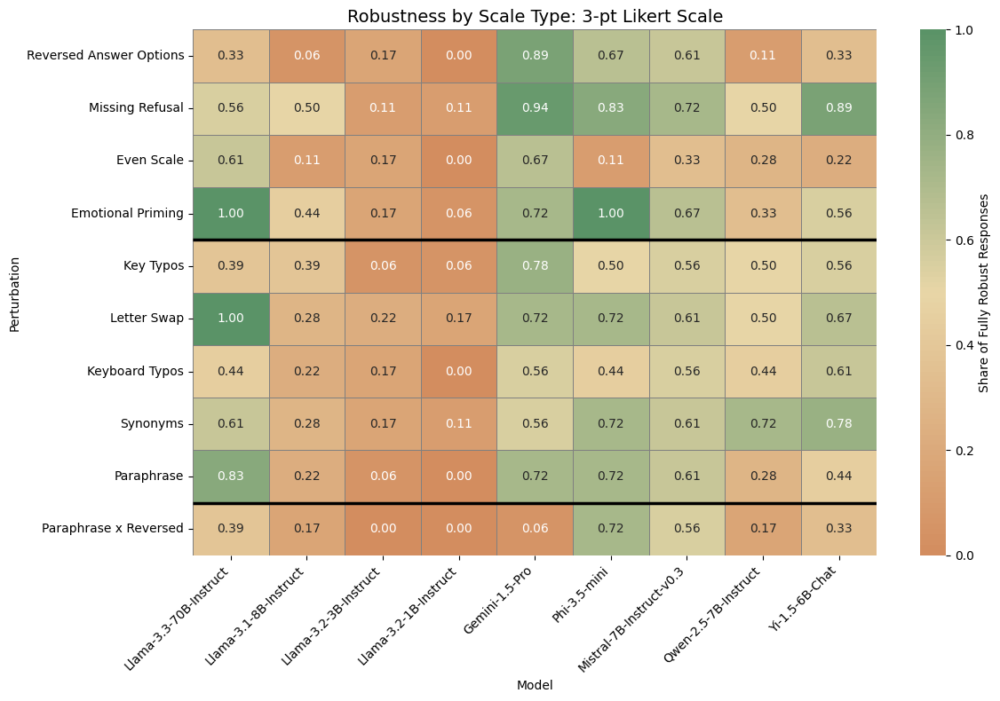

Llama-3.3-70B-Instruct list_answer_no_refusal Q1 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q2 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q3 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q4 13.127100011623984 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q5 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q6 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q58 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q59 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q60 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q61 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q62 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q63 0.0 26.254200023247968
Llama-3.3-70B-Instruct list_answer_no_refusal Q64 0.12783270301743338 26.509865429282833
Llama-3.3-70B-Instruct list_answer_no_refusal Q65 0.0 26.50986542928283

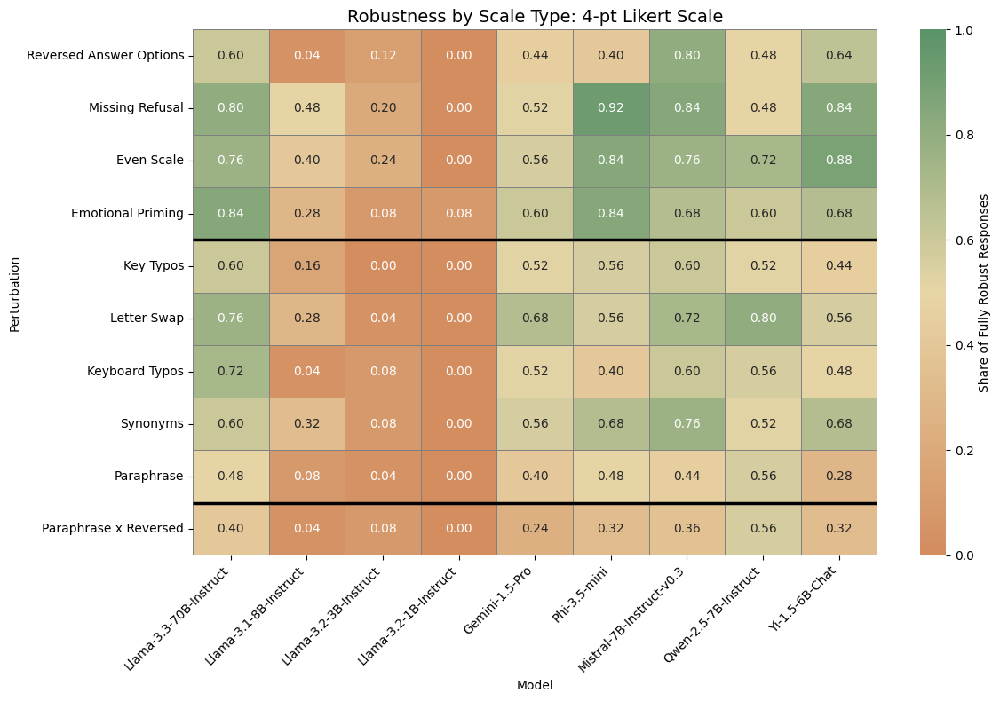

Llama-3.3-70B-Instruct list_answer_no_refusal Q33 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q34 0.16463283320386346 0.3292656664077269
Llama-3.3-70B-Instruct list_answer_no_refusal Q37 0.0 0.3292656664077269
Llama-3.3-70B-Instruct list_answer_no_refusal Q38 0.0 0.3292656664077269
Llama-3.3-70B-Instruct list_answer_no_refusal Q40 0.0 0.3292656664077269
Llama-3.3-70B-Instruct list_answer_no_refusal Q41 0.0 0.3292656664077269
Llama-3.3-70B-Instruct list_answer_no_middle Q33 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_middle Q34 16.361366257748912 32.722732515497825
Llama-3.3-70B-Instruct list_answer_no_middle Q37 13.869207590119748 60.461147695737324
Llama-3.3-70B-Instruct list_answer_no_middle Q38 17.034376883581416 94.52990146290016
Llama-3.3-70B-Instruct list_answer_no_middle Q40 0.0 94.52990146290016
Llama-3.3-70B-Instruct list_answer_no_middle Q41 17.03437626092384 128.59865398474784
Llama-3.3-70B-Instruct list_answer_options_reversed Q33 0.0 0.0
Llama-3.3-70B-Instruct 

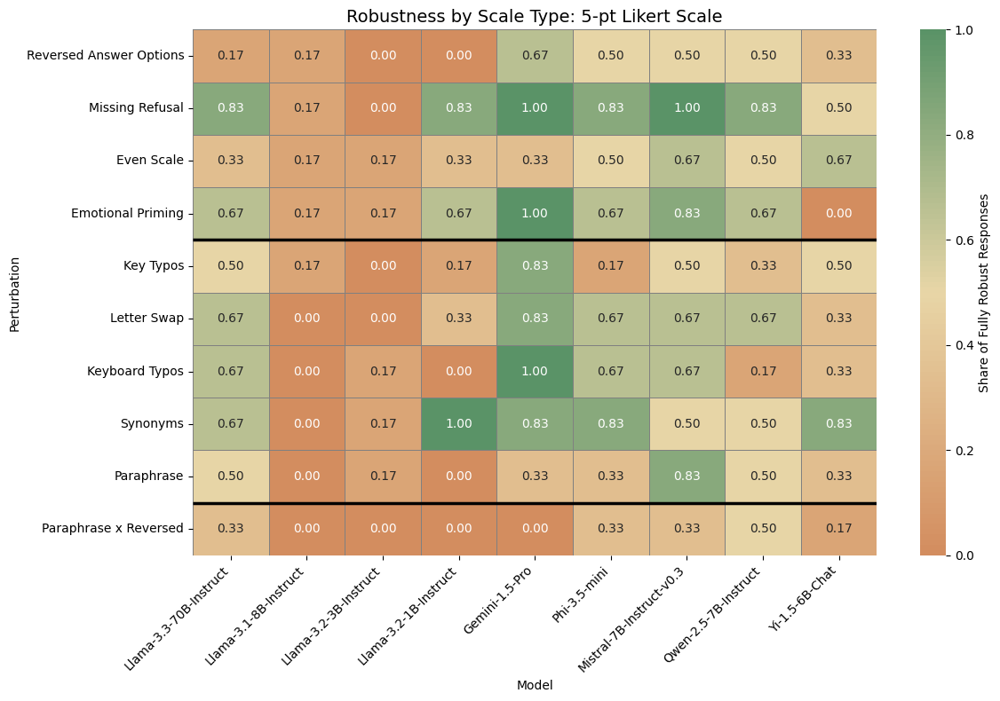

Llama-3.3-70B-Instruct list_answer_no_refusal Q179 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q180 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q181 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q182 0.0 0.0
Llama-3.3-70B-Instruct list_answer_no_refusal Q184 7.574817543466289 15.149635086932578
Llama-3.3-70B-Instruct list_answer_no_refusal Q188 0.0 15.149635086932578
Llama-3.3-70B-Instruct list_answer_no_refusal Q195 0.08338098175637534 15.31639705044533
Llama-3.3-70B-Instruct list_answer_no_refusal Q241 0.27443606607265036 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_refusal Q242 0.0 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_refusal Q243 0.0 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_refusal Q244 0.0 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_refusal Q246 0.0 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_refusal Q248 0.0 15.865269182590632
Llama-3.3-70B-Instruct list_answer_no_middle Q179 0.0

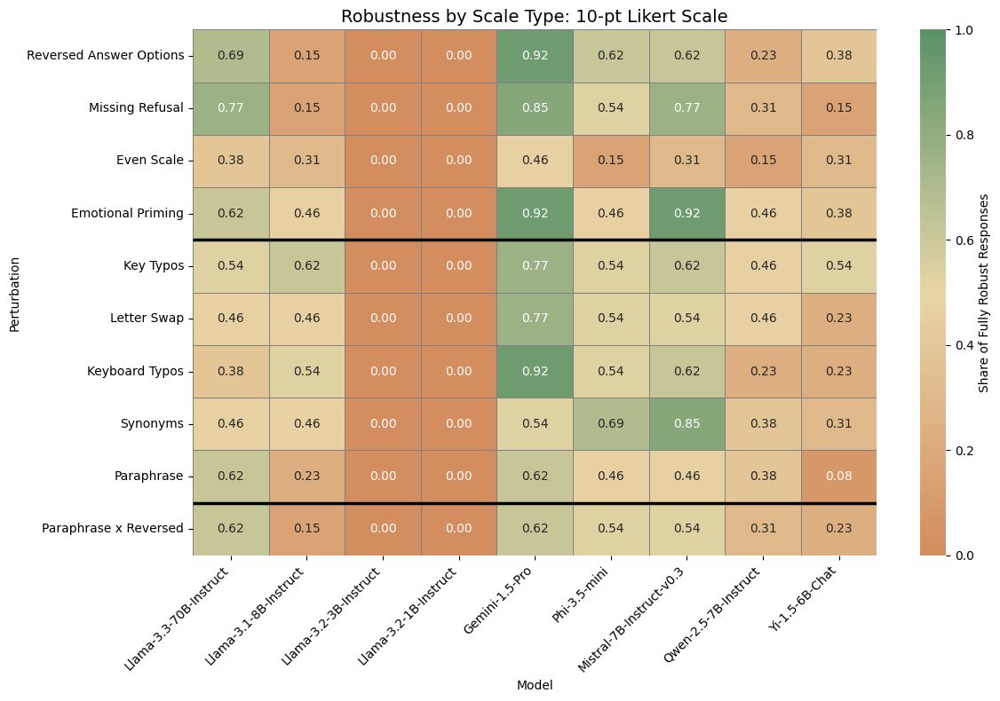

In [134]:
generate_share_robust_scaletype_heatmap(final_interviews_categorized, combinations=combinations)

## Variance Comparison 
This section aim at comparing the variances of answers in categories between different models.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



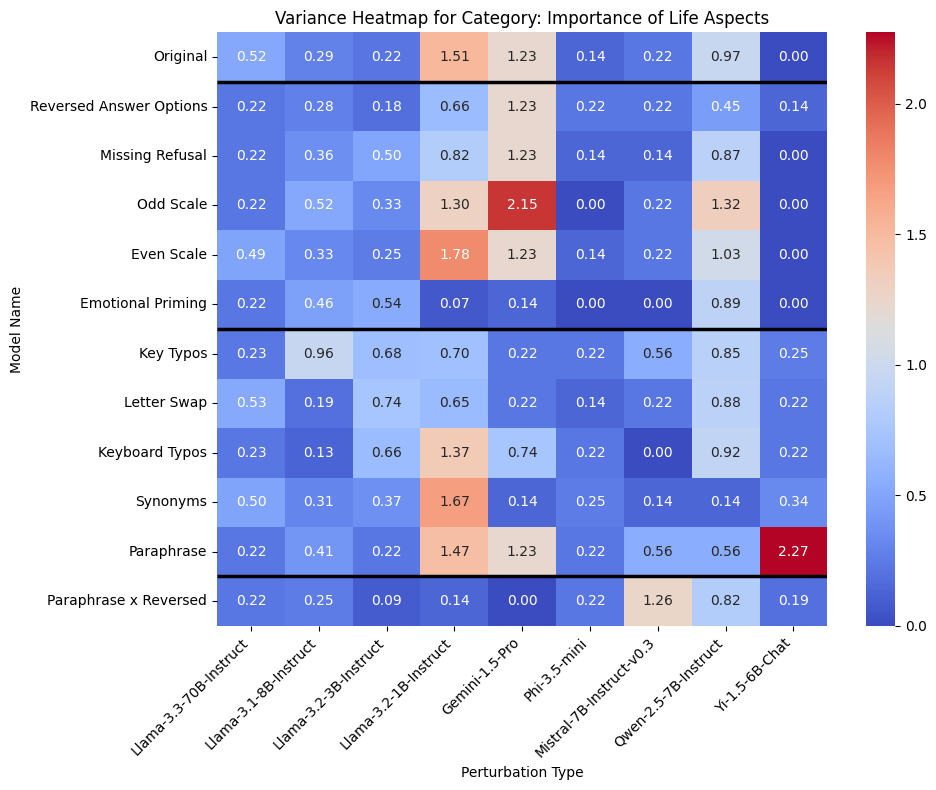

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



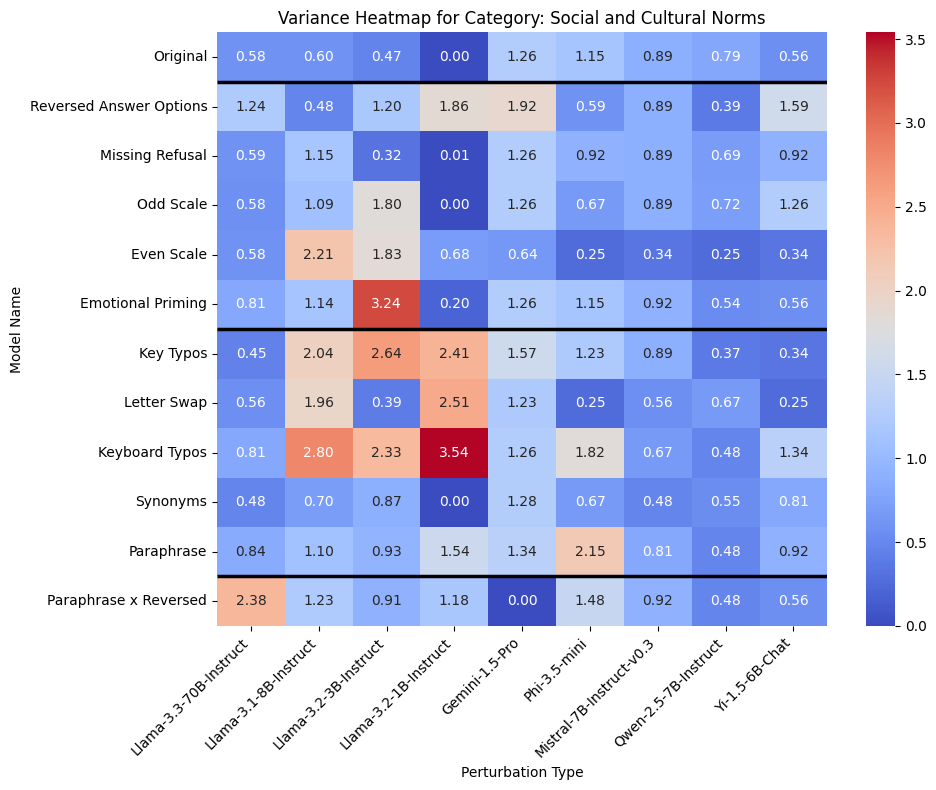

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



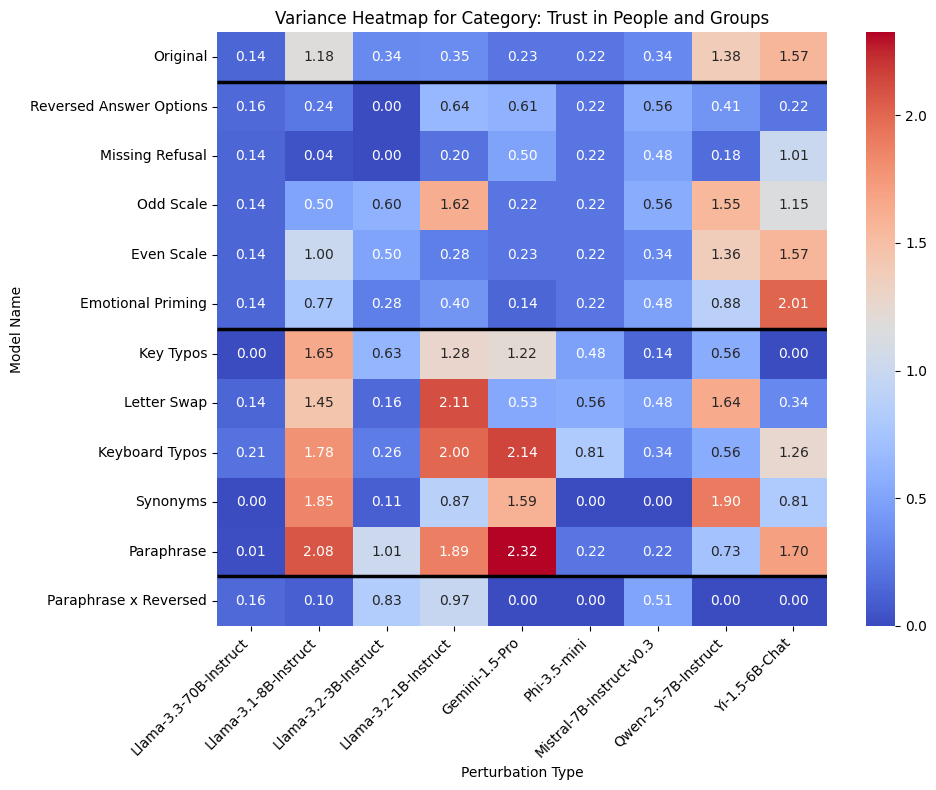

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



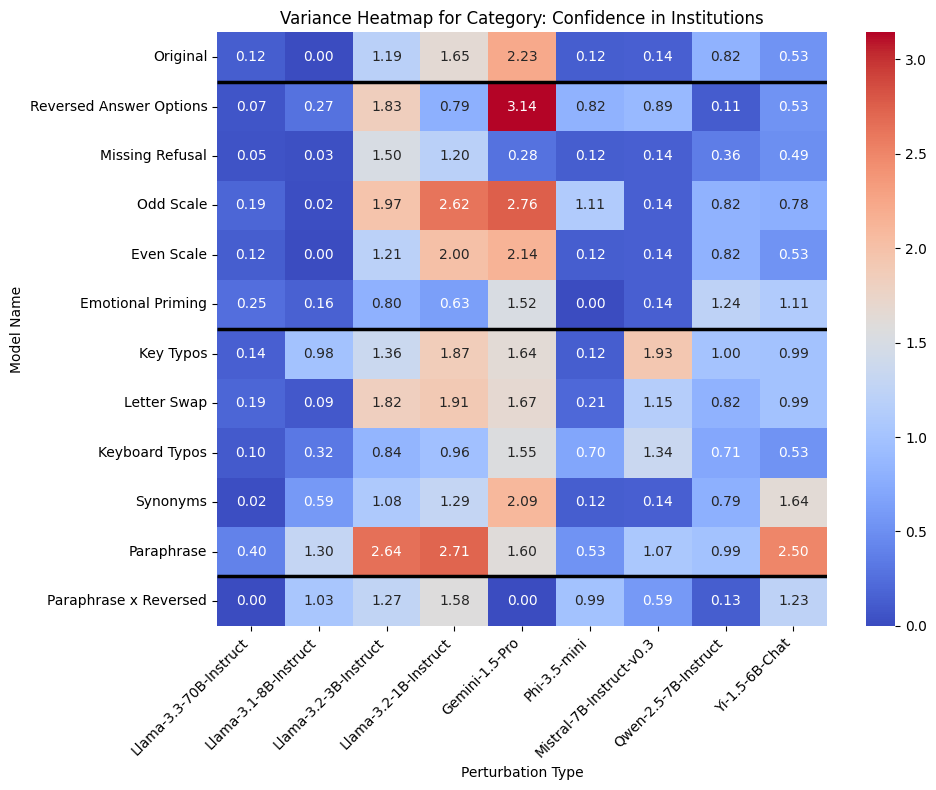

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



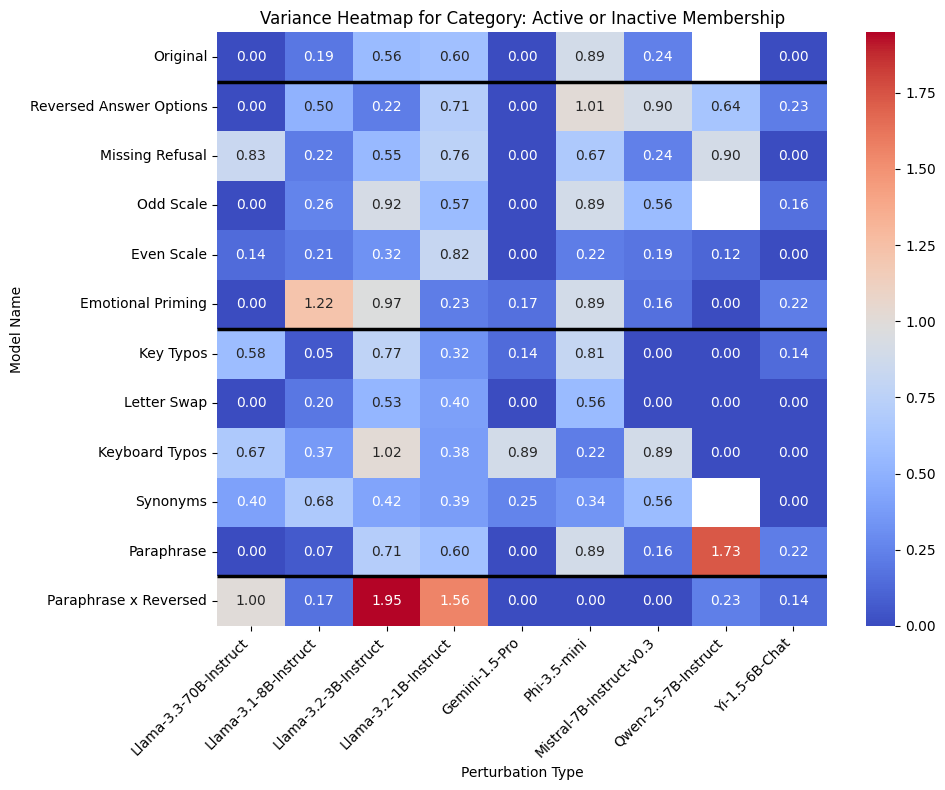

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



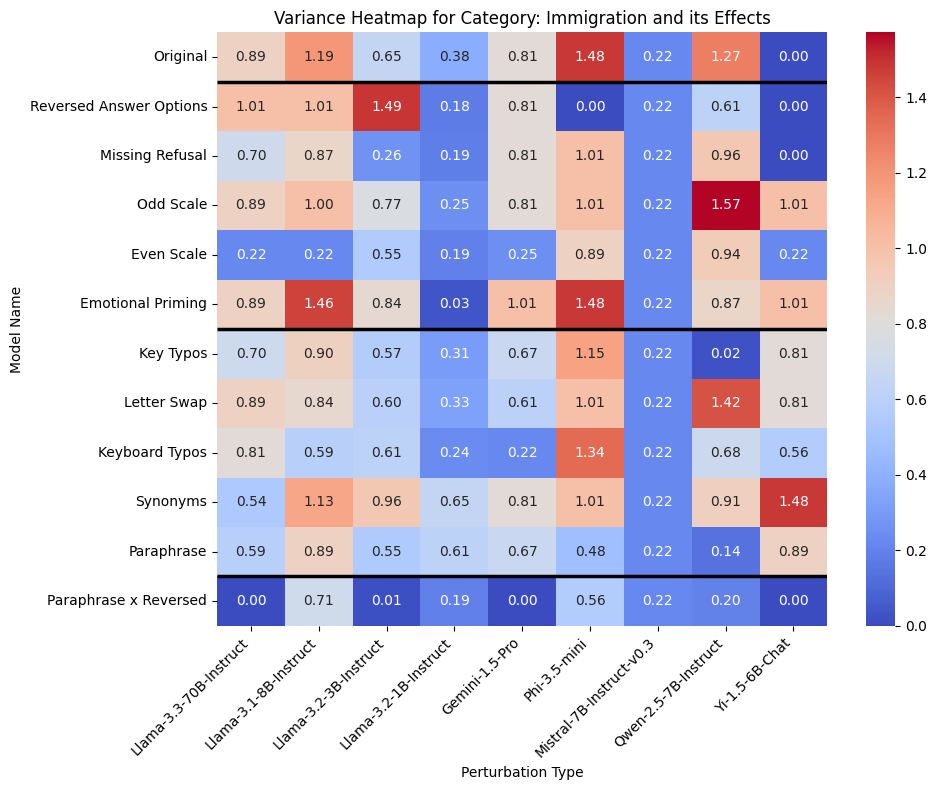

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



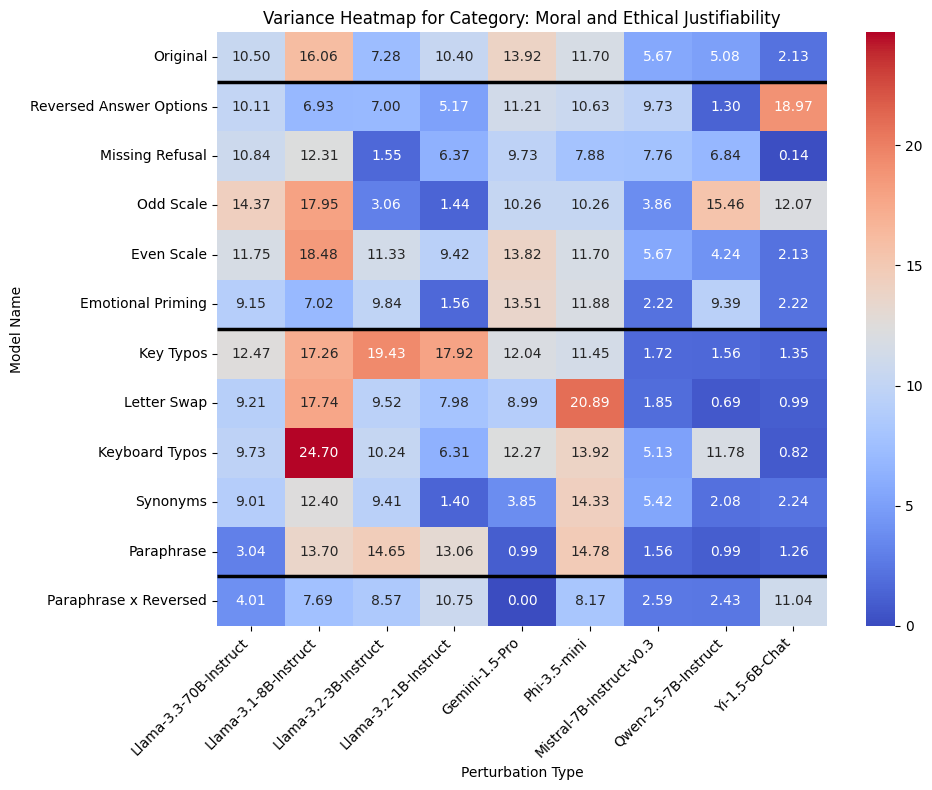

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



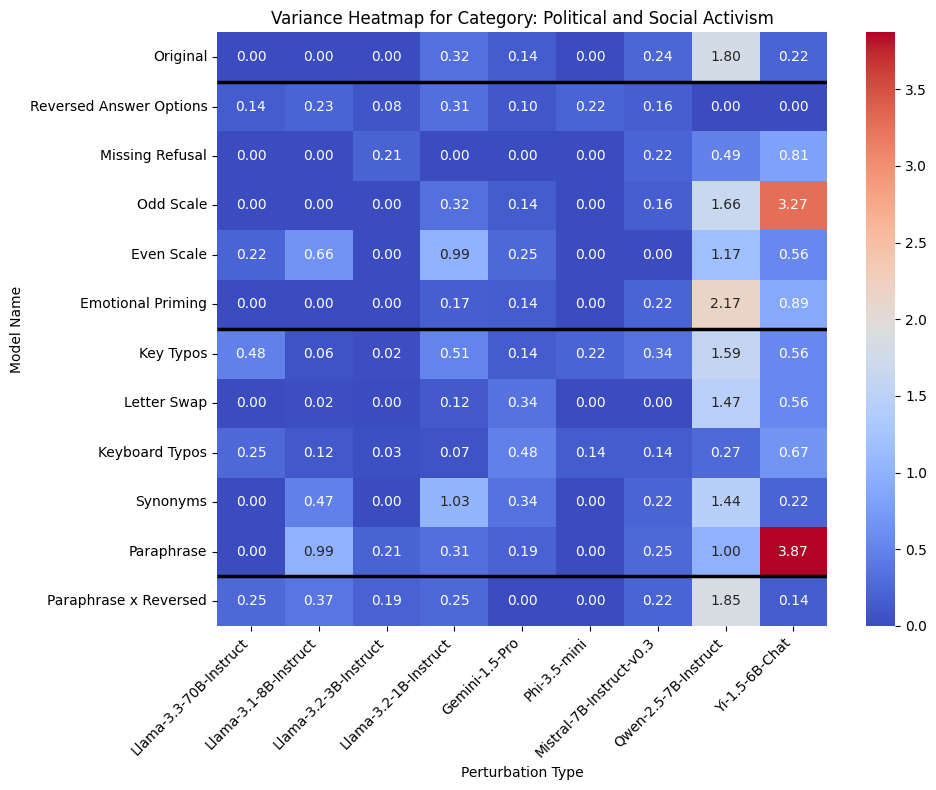

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



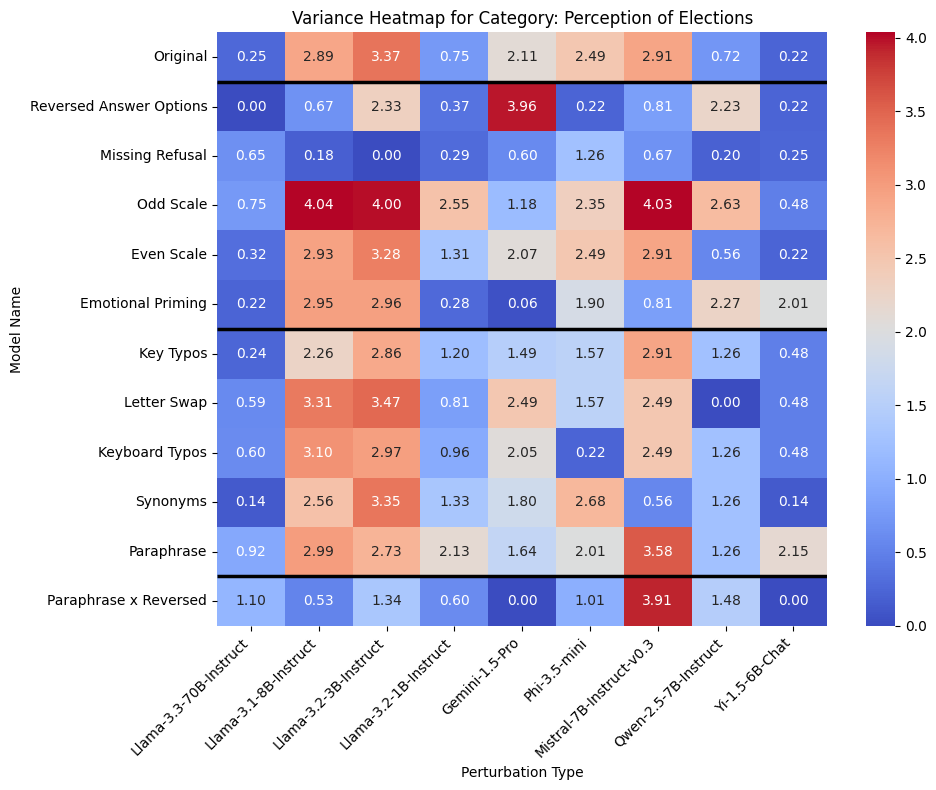

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\322610792.py:68: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



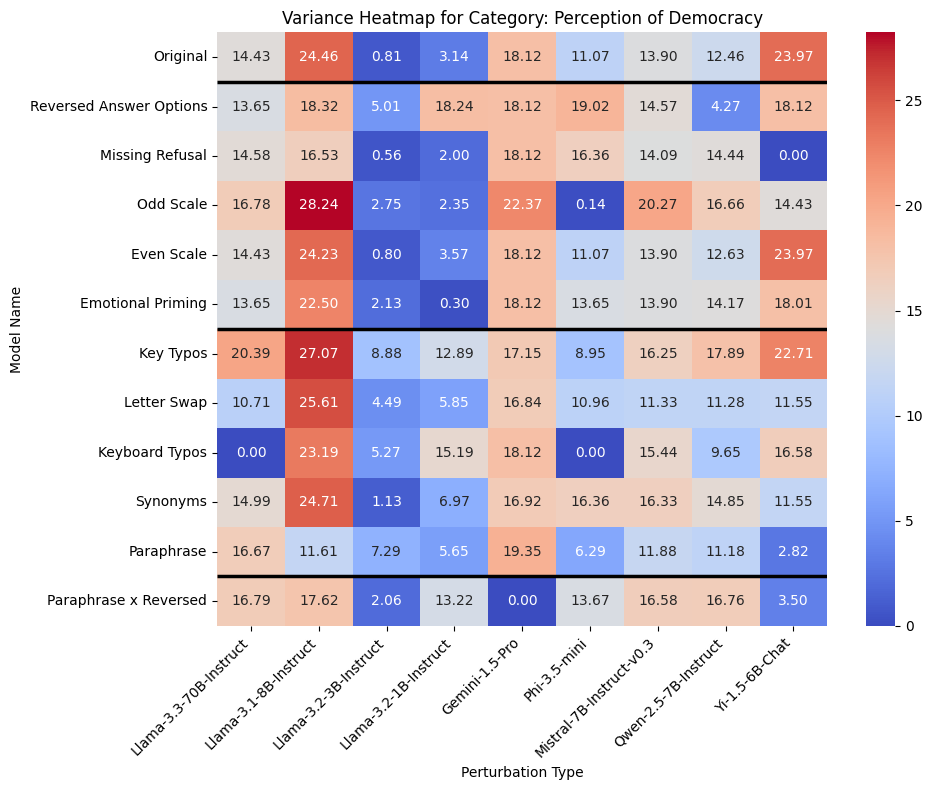

In [135]:
# delete all refusals and invalid interviews to calculate variance
df = final_interviews_categorized[(final_interviews_categorized["extracted_response"] != -1.0) &
                                  (final_interviews_categorized["extracted_response"] != "nan")]
desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
# We have to ensure `extracted_response` is numeric for variance calculation.
# Normalize extracted_response within each Category
if not pd.api.types.is_numeric_dtype(df['extracted_response']):
    df['extracted_response'] = pd.to_numeric(df['extracted_response'], errors='coerce')

# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])
df["type"] = df["type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )
# df['normalized_response'] = df.groupby('Category')['extracted_response'].transform(
#     lambda x: (x - x.mean()) / x.std()
# )

# # Recalculate variances using the normalized responses
# normalized_variance_by_model = df.groupby(['Category', 'model_name'])['normalized_response'].var().reset_index()
# normalized_variance_by_model.rename(columns={'normalized_response': 'variance'}, inplace=True)

# normalized_variance_by_type = df.groupby(['Category', 'type'])['normalized_response'].var().reset_index()
# normalized_variance_by_type.rename(columns={'normalized_response': 'variance'}, inplace=True)

# normalized_variance_by_model_type = df.groupby(['Category', 'model_name', 'type'])['normalized_response'].var().reset_index()
# normalized_variance_by_model_type.rename(columns={'normalized_response': 'variance'}, inplace=True)

# # Cross Table for normalized variances
# normalized_cross_table_variance = df.pivot_table(
#     index=['Category'],
#     columns=['model_name', 'type'],
#     values='normalized_response',
#     aggfunc='var'
# )

df["type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)
# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"
# Heatmaps for each Category
categories = df['Category'].unique()
for category in categories:
    category_data = df[df['Category'] == category]
    heatmap_data = category_data.pivot_table(
        index='type',
        columns='model_name',
        values='extracted_response',
        aggfunc='var'
    )
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
    plt.figure(figsize=(10, 8))
    ax = sns.heatmap(heatmap_data, 
                annot=True, 
                fmt=".2f", 
                cmap="coolwarm", 
                cbar=True,
                #vmax=1.5
                )
    plt.title(f"Variance Heatmap for Category: {category}")
    plt.ylabel("Model Name")
    plt.xlabel("Perturbation Type")
    plt.xticks(rotation=45, ha='right')
    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/heatmap_variance_{category}.pdf")
    plt.show()


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2954817127.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2954817127.py:47: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



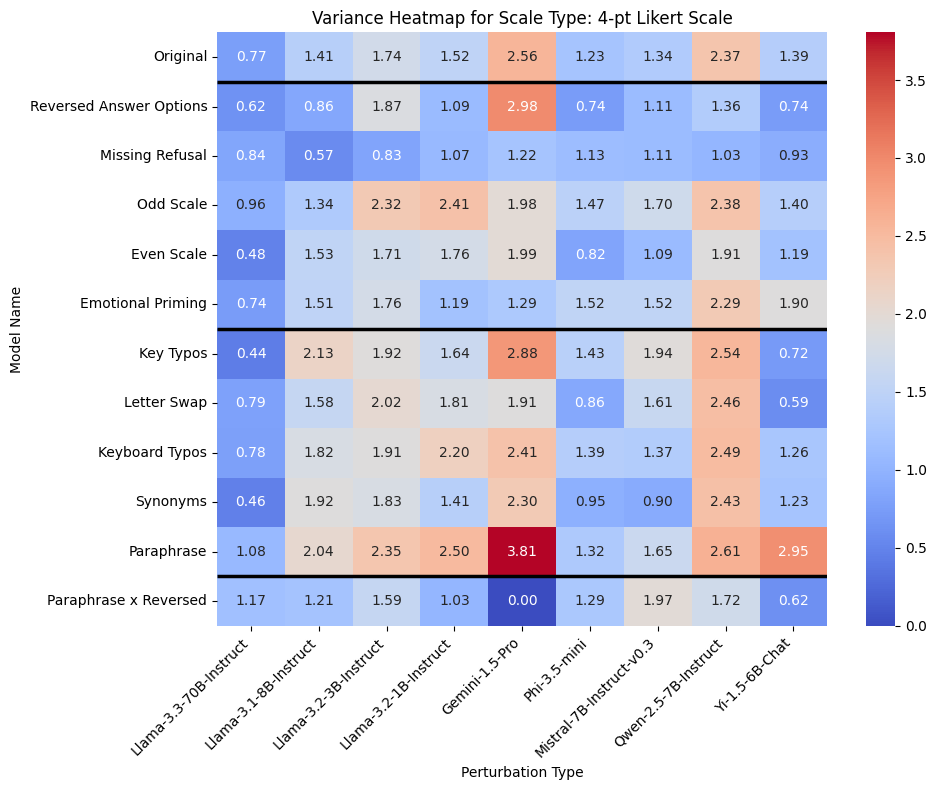

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2954817127.py:47: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



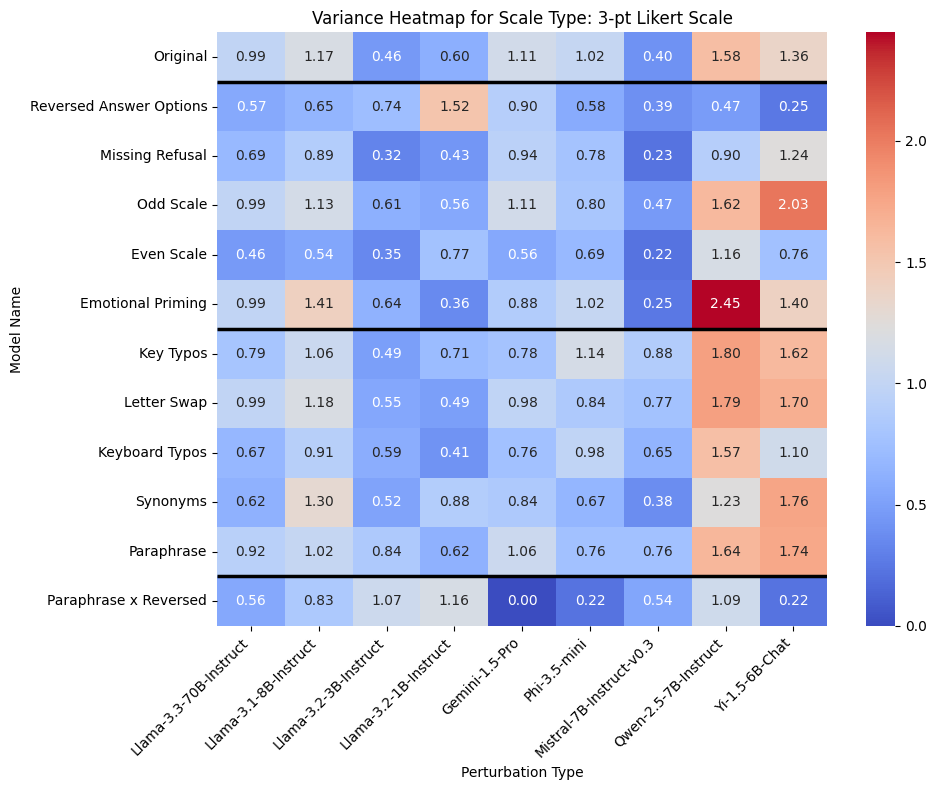

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2954817127.py:47: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



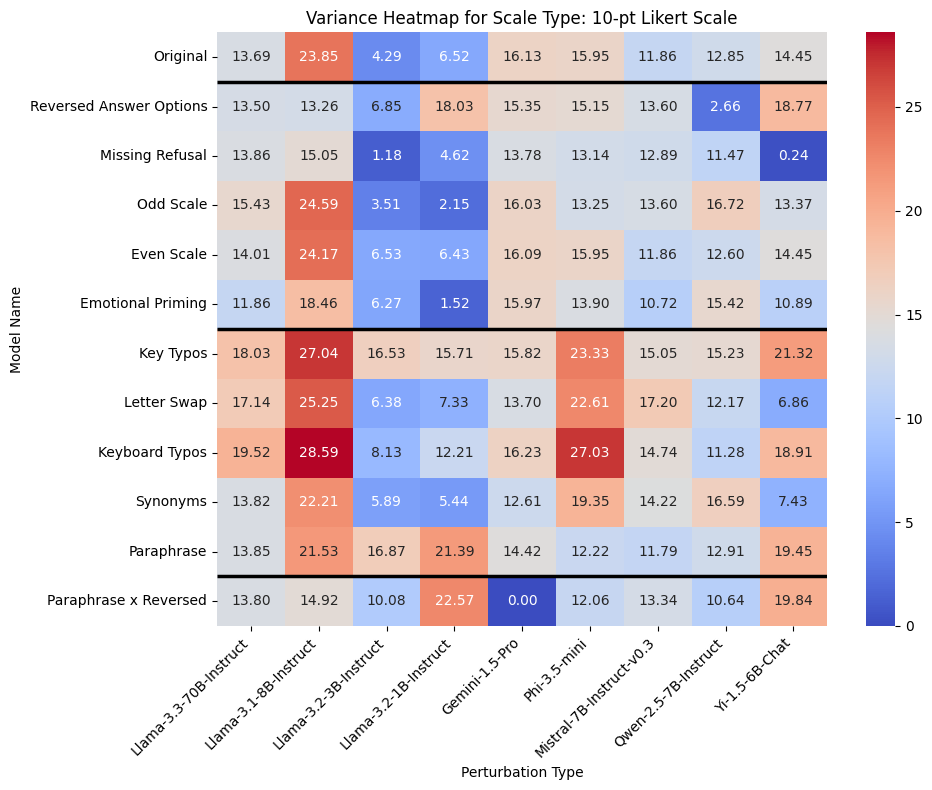

In [136]:
# delete all refusals and invalid interviews to calculate variance
df = final_interviews_categorized[(final_interviews_categorized["extracted_response"] != -1.0) &
                                  (final_interviews_categorized["extracted_response"] != "nan")]
desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
# We have to ensure `extracted_response` is numeric for variance calculation.
# Normalize extracted_response within each Category
if not pd.api.types.is_numeric_dtype(df['extracted_response']):
    df['extracted_response'] = pd.to_numeric(df['extracted_response'], errors='coerce')

# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])
df["type"] = df["type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

df["type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)
# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"
# Heatmaps for each Category
categories = df['Scale Type Middle'].unique()
for category in categories:
    category_data = df[df['Scale Type Middle'] == category]
    heatmap_data = category_data.pivot_table(
        index='type',
        columns='model_name',
        values='extracted_response',
        aggfunc='var'
    )
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
    plt.figure(figsize=(10, 8))
    ax = sns.heatmap(heatmap_data, 
                annot=True, 
                fmt=".2f", 
                cmap="coolwarm", 
                cbar=True,
                #vmax=1.5
                )
    plt.title(f"Variance Heatmap for Scale Type: {category}")
    plt.ylabel("Model Name")
    plt.xlabel("Perturbation Type")
    plt.xticks(rotation=45, ha='right')
    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/heatmap_variance_{category}.pdf")
    plt.show()


Variance across Scale Types

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\2799985312.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



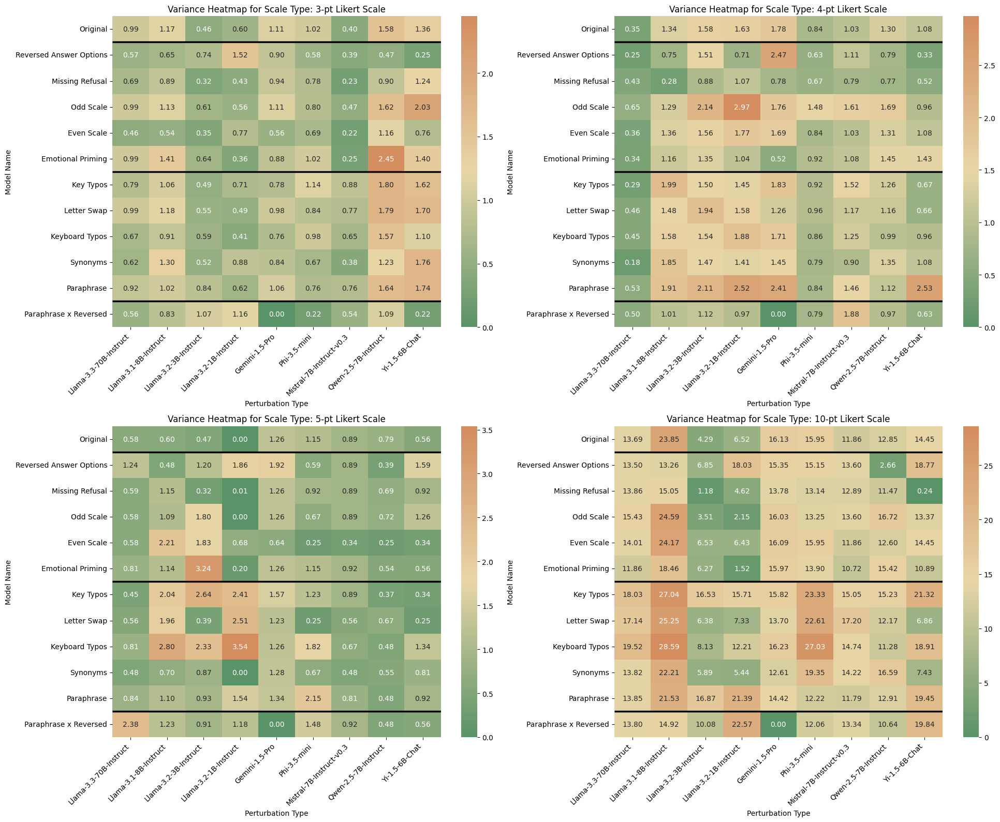

In [137]:
# Filter the dataframe
df = final_interviews_categorized[(final_interviews_categorized["extracted_response"] != -1.0) &
                                  (final_interviews_categorized["extracted_response"] != "nan")]

# Define the desired order for the 'type' column
desired_order = [
    "Original",
    "Reversed Answer Options",
    "Missing Refusal",
    "Odd Scale",
    "Even Scale",
    "Emotional Priming",
    "Key Typos",
    "Letter Swap",
    "Keyboard Typos",
    "Synonyms",
    "Paraphrase",
    "Paraphrase x Reversed"
]

# Ensure `extracted_response` is numeric for variance calculation
if not pd.api.types.is_numeric_dtype(df['extracted_response']):
    df['extracted_response'] = pd.to_numeric(df['extracted_response'], errors='coerce')

# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])

# Replace 'type' values with more readable names
df.loc[:,"type"] = df["type"].replace({
    'list_answer_options': "Original",
    'list_answer_no_refusal': "Missing Refusal",  
    'list_answer_options_reversed': "Reversed Answer Options", 
    'original_emotional_prime': "Emotional Priming",
    'list_answer_middle': "Odd Scale",
    'list_answer_no_middle': "Even Scale",
    'question_typo': "Key Typos",
    'question_letter_swap': "Letter Swap",
    'question_synonym': "Synonyms",
    'question_paraphrased': "Paraphrase",
    'question_keyboardtypo': "Keyboard Typos",
    'interaction_paraphrase_reversed': "Paraphrase x Reversed"
})

# Convert 'type' to a categorical variable with the desired order
df.loc[:,"type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)

# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

# Get unique categories
categories = sorted_scales

# Create a 2x2 plot matrix
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()  # Flatten the 2x2 array to easily iterate over it
colors = ["#5A9367", "#E8D6A7","#D38D5F"]  
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
# Plot heatmaps for each category
for i, category in enumerate(categories[:4]):
    category_data = df[df['Scale Type'] == category]
    heatmap_data = category_data.pivot_table(
        index='type',
        columns='model_name',
        values='extracted_response',
        aggfunc='var'
    )
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    
    ax = sns.heatmap(heatmap_data, 
                     annot=True, 
                     fmt=".2f", 
                     cmap=cmap, 
                     cbar=True,
                     #vmin=0,
                     #vmax= 5,
                     ax=axes[i]
                     )
    axes[i].set_title(f"Variance Heatmap for Scale Type: {category}")
    axes[i].set_ylabel("Model Name")
    axes[i].set_xlabel("Perturbation Type")
    plt.setp(axes[i].get_xticklabels(), rotation=45, ha='right')
    
    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

# Adjust layout and save the figure as a PDF
plt.tight_layout()
plt.savefig("../thesis/figures/heatmap_variance_matrix.pdf")
plt.savefig("../thesis/figures/heatmap_variance_matrix.png", transparent = True)
plt.show()

Variance across Scale Types: Aggregating and averaging the variance per question for all questions in a scale type.

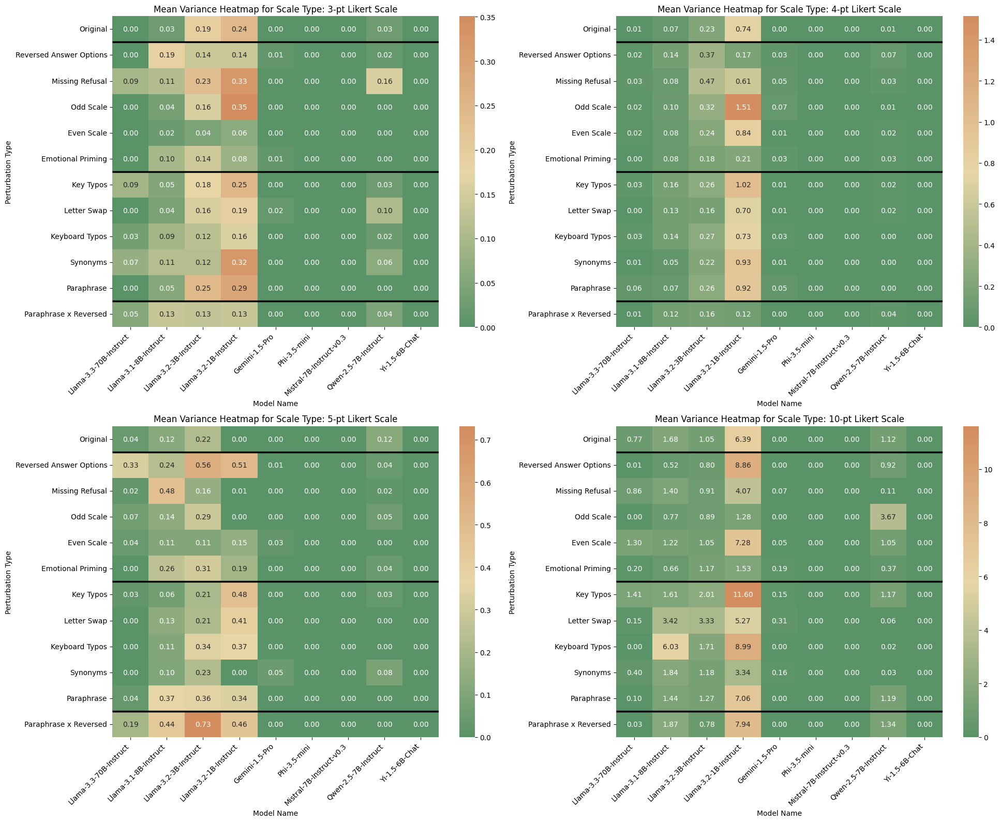

In [138]:
# Filter the dataframe
df = final_interviews_categorized[(final_interviews_categorized["extracted_response"] != -1.0) &
                                  (final_interviews_categorized["extracted_response"] != "-1.0") &
                                  (final_interviews_categorized["extracted_response"] != "nan")].copy()

# Define the desired order for the 'type' column
desired_order = [
    "Original",
    "Reversed Answer Options",
    "Missing Refusal",
    "Odd Scale",
    "Even Scale",
    "Emotional Priming",
    "Key Typos",
    "Letter Swap",
    "Keyboard Typos",
    "Synonyms",
    "Paraphrase",
    "Paraphrase x Reversed"
]

# Ensure `extracted_response` is numeric for variance calculation
if not pd.api.types.is_numeric_dtype(df['extracted_response']):
    df.loc[:,'extracted_response'] = pd.to_numeric(df['extracted_response'], errors='coerce')


# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])

# Replace 'type' values with more readable names
df.loc[:, "type"] = df["type"].replace({
    'list_answer_options': "Original",
    'list_answer_no_refusal': "Missing Refusal",  
    'list_answer_options_reversed': "Reversed Answer Options", 
    'original_emotional_prime': "Emotional Priming",
    'list_answer_middle': "Odd Scale",
    'list_answer_no_middle': "Even Scale",
    'question_typo': "Key Typos",
    'question_letter_swap': "Letter Swap",
    'question_synonym': "Synonyms",
    'question_paraphrased': "Paraphrase",
    'question_keyboardtypo': "Keyboard Typos",
    'interaction_paraphrase_reversed': "Paraphrase x Reversed"
})

# Convert 'type' to a categorical variable with the desired order
df.loc[:, "type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)

# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

# Get unique categories
categories = sorted_scales

# Create a 2x2 plot matrix
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()  # Flatten the 2x2 array to easily iterate over it
colors = ["#5A9367", "#E8D6A7","#D38D5F"]  
cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
# Plot heatmaps for each category
for i, category in enumerate(categories[:4]):
    category_data = df[df['Scale Type'] == category]
    # Calculate the standard deviation per Question ID, then compute the mean across question IDs
    heatmap_data = (
        category_data.groupby(['type', 'model_name', 'Question ID'])['extracted_response']
        .var()  # Variance per question
        .groupby(['type', 'model_name'])  # Group again to calculate mean std dev
        .mean()
        .unstack()  # Reshape for the heatmap
    )

    # Reindex columns to ensure the desired model order
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    heatmap_data = heatmap_data.astype(float).fillna(0)
    
    # Plot heatmap of mean standard deviations
    ax = sns.heatmap(
        heatmap_data, 
        annot=True, 
        fmt=".2f", 
        cmap=cmap, 
        cbar=True, 
        ax=axes[i]
    )

    # Titles and formatting
    axes[i].set_title(f"Mean Variance Heatmap for Scale Type: {category}")
    axes[i].set_ylabel("Perturbation Type")
    axes[i].set_xlabel("Model Name")
    plt.setp(axes[i].get_xticklabels(), rotation=45, ha='right')

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

# Adjust layout and save the figure as a PDF
plt.tight_layout()
plt.savefig("../thesis/figures/heatmap_variance_per_question_matrix.pdf")
plt.savefig("../thesis/figures/heatmap_variance_per_question_matrix.png", transparent = True)
plt.show()

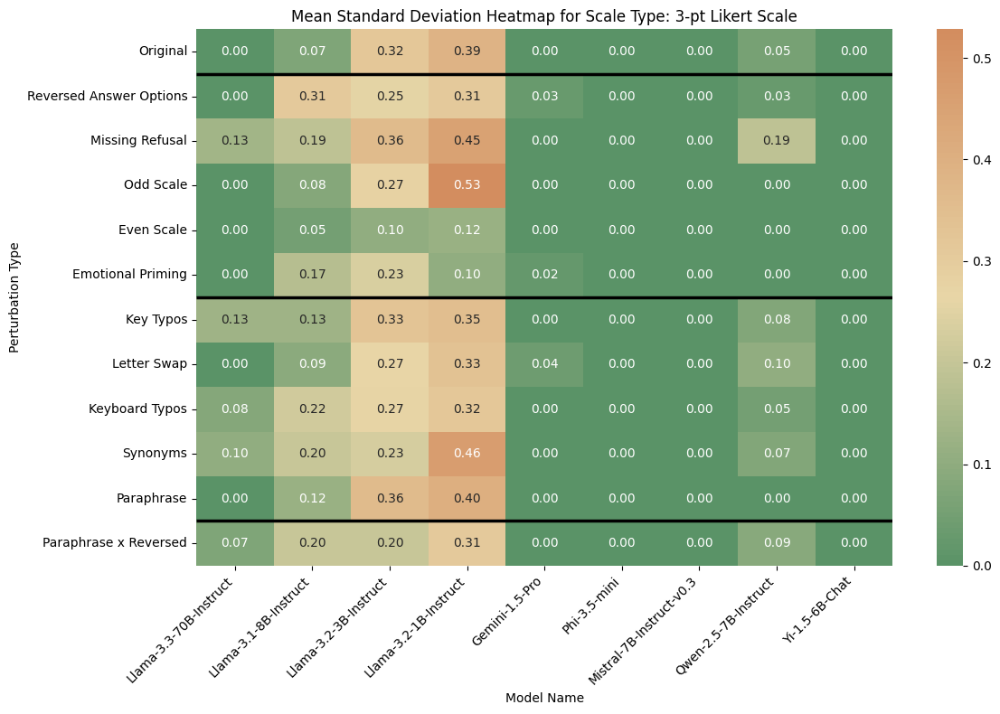

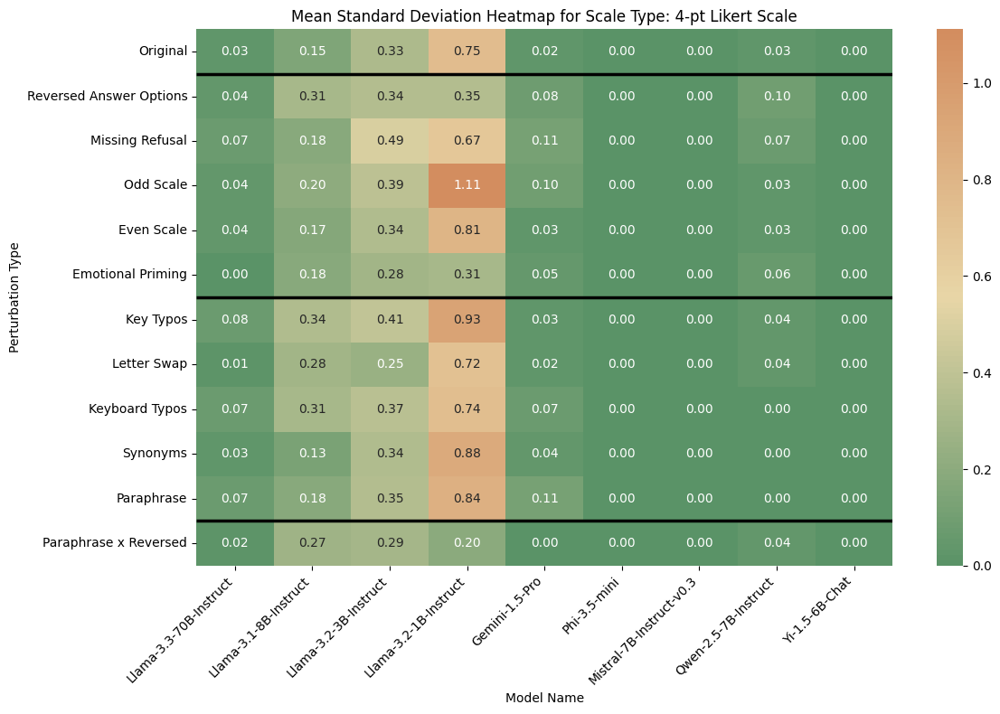

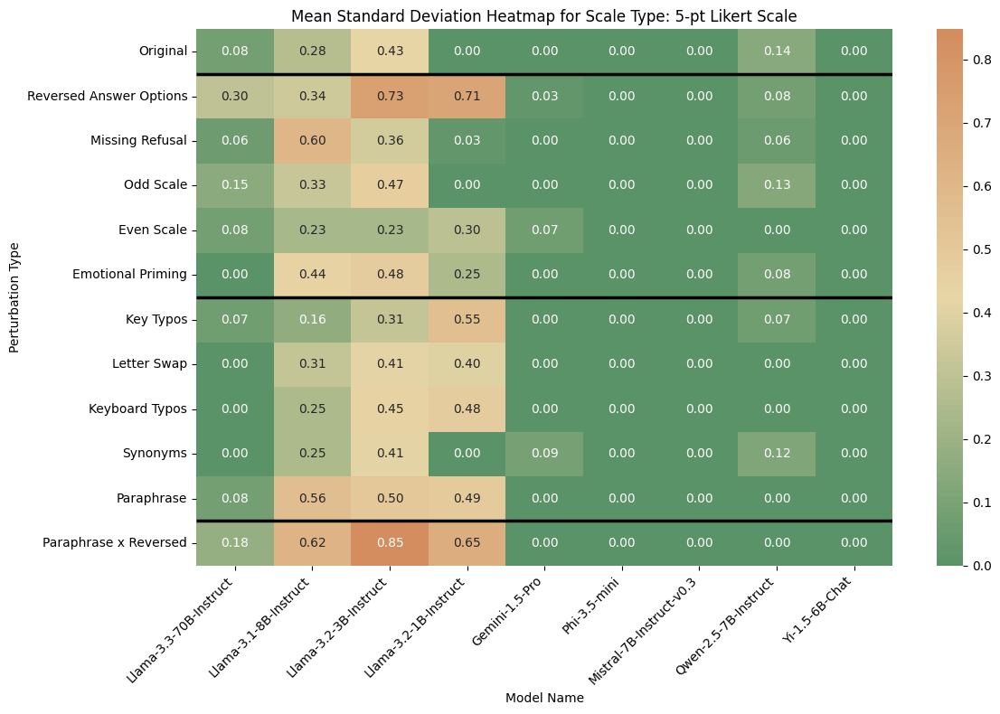

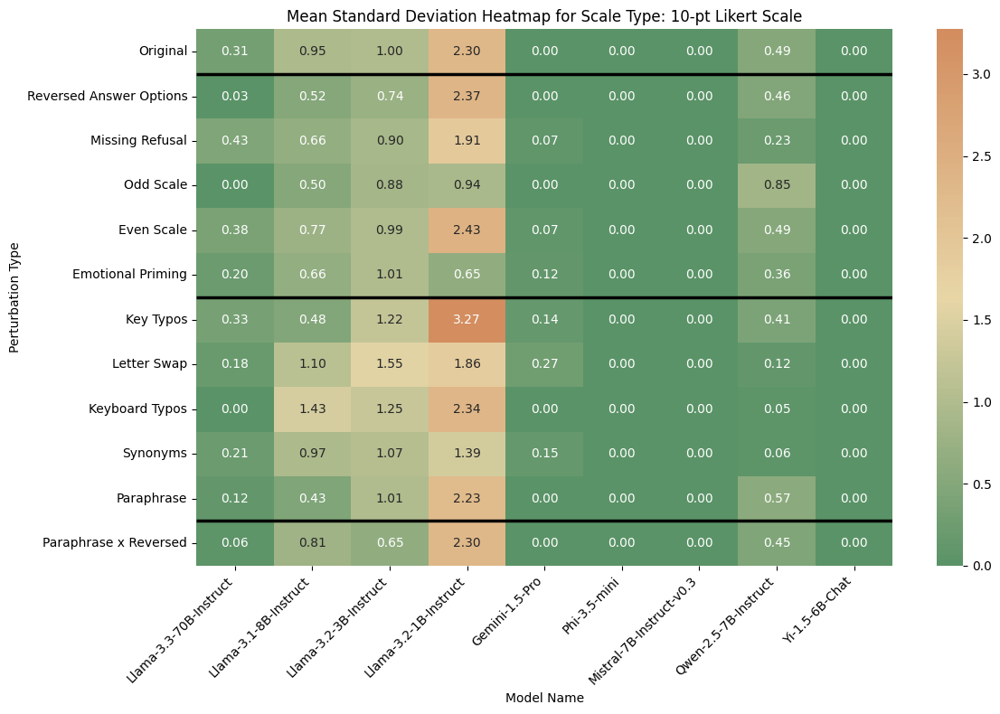

In [139]:
# Filter the dataframe
df = final_interviews_categorized[(final_interviews_categorized["extracted_response"] != -1.0) &
                                  (final_interviews_categorized["extracted_response"] != "-1.0") &
                                  (final_interviews_categorized["extracted_response"] != "nan")].copy()

# Define the desired order for the 'type' column
desired_order = [
    "Original",
    "Reversed Answer Options",
    "Missing Refusal",
    "Odd Scale",
    "Even Scale",
    "Emotional Priming",
    "Key Typos",
    "Letter Swap",
    "Keyboard Typos",
    "Synonyms",
    "Paraphrase",
    "Paraphrase x Reversed"
]

# Ensure `extracted_response` is numeric for variance calculation
if not pd.api.types.is_numeric_dtype(df['extracted_response']):
    df.loc[:, 'extracted_response'] = pd.to_numeric(df['extracted_response'], errors='coerce')


# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])

# Replace 'type' values with more readable names
df.loc[:, "type"] = df["type"].replace({
    'list_answer_options': "Original",
    'list_answer_no_refusal': "Missing Refusal",  
    'list_answer_options_reversed': "Reversed Answer Options", 
    'original_emotional_prime': "Emotional Priming",
    'list_answer_middle': "Odd Scale",
    'list_answer_no_middle': "Even Scale",
    'question_typo': "Key Typos",
    'question_letter_swap': "Letter Swap",
    'question_synonym': "Synonyms",
    'question_paraphrased': "Paraphrase",
    'question_keyboardtypo': "Keyboard Typos",
    'interaction_paraphrase_reversed': "Paraphrase x Reversed"
})

# Convert 'type' to a categorical variable with the desired order
df.loc[:, "type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)

# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

# Get unique categories
categories = sorted_scales

# Create a 2x2 plot matrix
#fig, axes = plt.subplots(2, 2, figsize=(20, 16))
#axes = axes.flatten()  # Flatten the 2x2 array to easily iterate over it

# Plot heatmaps for each category
for i, category in enumerate(categories[:4]):
    category_data = df[df['Scale Type'] == category]
    # Calculate the standard deviation per Question ID, then compute the mean across question IDs
    heatmap_data = (
        category_data.groupby(['type', 'model_name', 'Question ID'])['extracted_response']
        .std()  # Variance per question
        .groupby(['type', 'model_name'])  # Group again to calculate mean std dev
        .mean()
        .unstack()  # Reshape for the heatmap
    )

    # Reindex columns to ensure the desired model order
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    heatmap_data = heatmap_data.astype(float).fillna(0)
    colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    plt.figure(figsize=(12, 8))
    # Plot heatmap of mean standard deviations
    ax = sns.heatmap(
        heatmap_data, 
        annot=True, 
        fmt=".2f", 
        #cmap="viridis", 
        cmap = cmap,
        cbar=True, 
        #ax=axes[i]
    )

    # Titles and formatting
    ax.set_ylabel("Perturbation Type")
    ax.set_title(f"Mean Standard Deviation Heatmap for Scale Type: {category}")
    ax.set_ylabel("Perturbation Type")
    ax.set_xlabel("Model Name")
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Adjust layout and save the figure as a PDF
    plt.tight_layout()

    plt.savefig(f"../thesis/figures/heatmap_std_per_question_{category}_matrix.pdf")
    plt.savefig(f"../thesis/figures/heatmap_std_per_question_{category}_matrix.png", transparent = True)
    plt.show()

In [140]:
category_data[(category_data["model_name"] == "Gemini-1.5-Pro") &
              (category_data["type"] == "Emotional Priming") &
              (category_data["Question ID"] == "Q188")
]

,Unnamed: 0.1,Unnamed: 0,round,question_ID,question,answer_options,type,response,model_name,extracted_response,answer_dict,Question ID,Question Description,Category,Scale Type,_merge,Scale Type Middle,Scale with Middle
466,509,509,0,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,3\n,Gemini-1.5-Pro,3.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
1148,1253,1253,1,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
1830,1997,1997,2,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
2512,2741,2741,3,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
3194,3485,3485,4,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
3876,4229,4229,5,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
4558,4973,4973,6,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
5240,5717,5717,7,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
5922,6461,6461,8,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale
6604,7205,7205,9,Q188,Justifiable: Euthanasia Please tell me for eac...,"[1=Never justifiable , 2 , 3 , 4 , 5 , 6 , 7 ,...",Emotional Priming,7\n,Gemini-1.5-Pro,7.0,"{1: 'Never justifiable', 2: None, 3: None, 4: ...",Q188,Justifiable: Euthanasia,Moral and Ethical Justifiability,10-pt Likert Scale,both,10-pt Likert Scale,11-pt Likert Scale


In [141]:
# Ensure full output is displayed
pd.set_option('display.max_rows', None)  # Display all rows
pd.set_option('display.max_columns', None)  # Display all columns
pd.set_option('display.max_colwidth', None)  # Display full width for each column

# Calculate and print the variance per Question ID
variance_output = category_data.groupby(['type', 'model_name', 'Question ID'])['extracted_response'].var()
print(variance_output)

# Optional: Reset display settings afterward if needed
# pd.reset_option('display.max_rows')

#.groupby(['type', 'model_name']).mean().unstack()  # Reshape for the heatmap


type                     model_name                Question ID
Emotional Priming        Gemini-1.5-Pro            Q179                 0.0
                                                   Q180                 0.0
                                                   Q181                 0.0
                                                   Q182                 0.0
                                                   Q188                2.24
                                                   Q195                 0.0
                                                   Q241                 0.0
                                                   Q242                 0.0
                                                   Q243                 0.0
                                                   Q244                 0.0
                                                   Q246                 0.0
                                                   Q248                 0.0
                         

## Entropy Comparison
Better than Variance because we are dealing with categorical variables. Therefore, no mean and variance should be calculated. NaN and -1 options are included and hence mean and variance calculation makes no sense. 

In [142]:
from scipy.stats import entropy
# test entropy calculation
subset = final_interviews_categorized[
                    (final_interviews_categorized["Category"] == "Importance of Life Aspects") &
                    (final_interviews_categorized["model_name"] == "Llama-3.3-70B-Instruct") &
                    (final_interviews_categorized["type"] == "question_synonym")
                ]
entropy(subset["extracted_response"].value_counts())


1.022169375743282

In [143]:

def generate_entropy_heatmap(data, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap of the normalized entropy
    for categorical 'extracted_response' distribution.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = data["Category"].unique()
    perturbations = data["type"].unique()
    desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

    # Loop through each model and type to compute metrics
    for category in categories:
        # Initialize results lists
        results = []
        for model in models:
            for i,perturbation in enumerate(perturbations):    
                subset = final_interviews_categorized[
                    (final_interviews_categorized["Category"] == category) &
                    (final_interviews_categorized["model_name"] == model) &
                    (final_interviews_categorized["type"] == perturbation)
                ]

                # Group the data by model_name and extracted_response to count occurrences
                grouped_data = (
                    subset.groupby(["model_name", "extracted_response"])
                    .size()
                    .reset_index(name="count")
                )
                # Calculate probabilities for each category within each model
                distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()

                # Calculate entropy
                raw_entropy = distribution.groupby(level=0).apply(entropy, nan_policy='propagate').reset_index()
                raw_entropy.columns = ["Model", "Entropy"]
                
                # print(f"Category: {category}, Model: {model}, Perturbation: {perturbation}")
                # print(raw_entropy)
                # print("Entropy:", raw_entropy["Entropy"].values[0])

                # Append results
                results.append({'Model': model, 
                                'Type': perturbation, 
                                'Entropy': raw_entropy["Entropy"].values[0]})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap structure
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='Entropy')
        # Ensure the models appear in the specified order in the x-axis
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
        # Generate annotations manually
        annotations = heatmap_data.copy()
        for row in annotations.index:
            for col in annotations.columns:
                entr = heatmap_data.at[row, col]
                if pd.isna(entr):
                    annotations.at[row, col] = ""
                else:
                    annotations.at[row, col] = f"{entr:.3f}"
        #vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
        # Plot heatmap
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'Entropy'},
            vmin=0,  # Start colors from 0
            #vmax=vmax,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
        )

        # Add horizontal lines for group separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
        plt.title(f'{category}: Entropy', fontsize=14)
        plt.ylabel("Perturbation")
        plt.xlabel("Model")
        plt.xticks(rotation = 45, ha='right')
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/{category[0:10]}_entropy_heatmap.pdf")
        plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.861' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.798' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.643' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

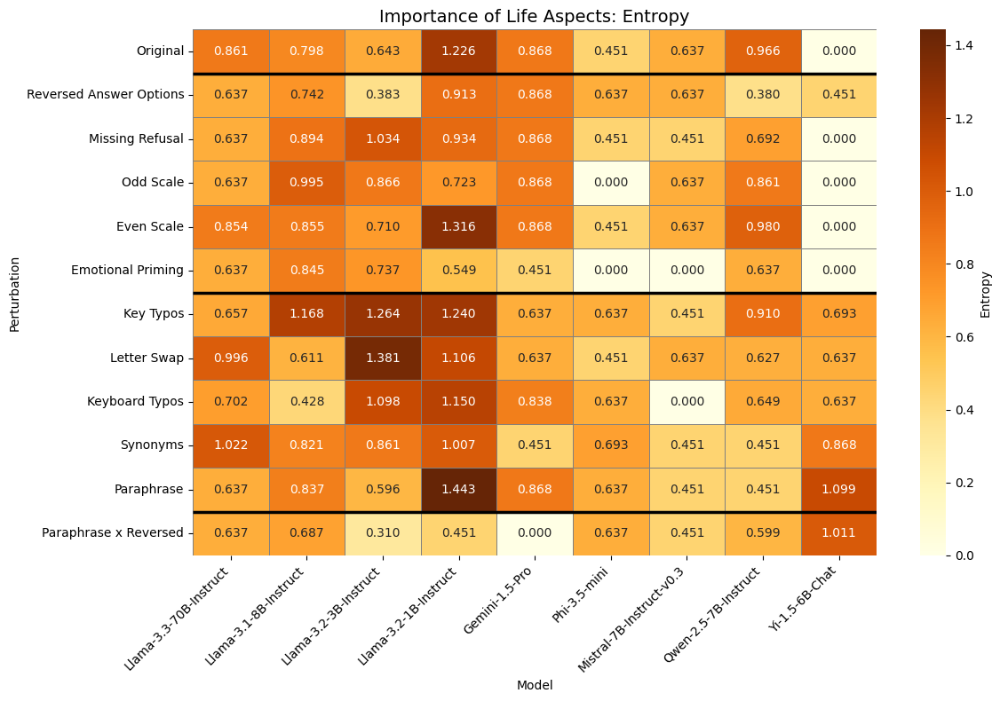

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.945' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.044' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.014' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

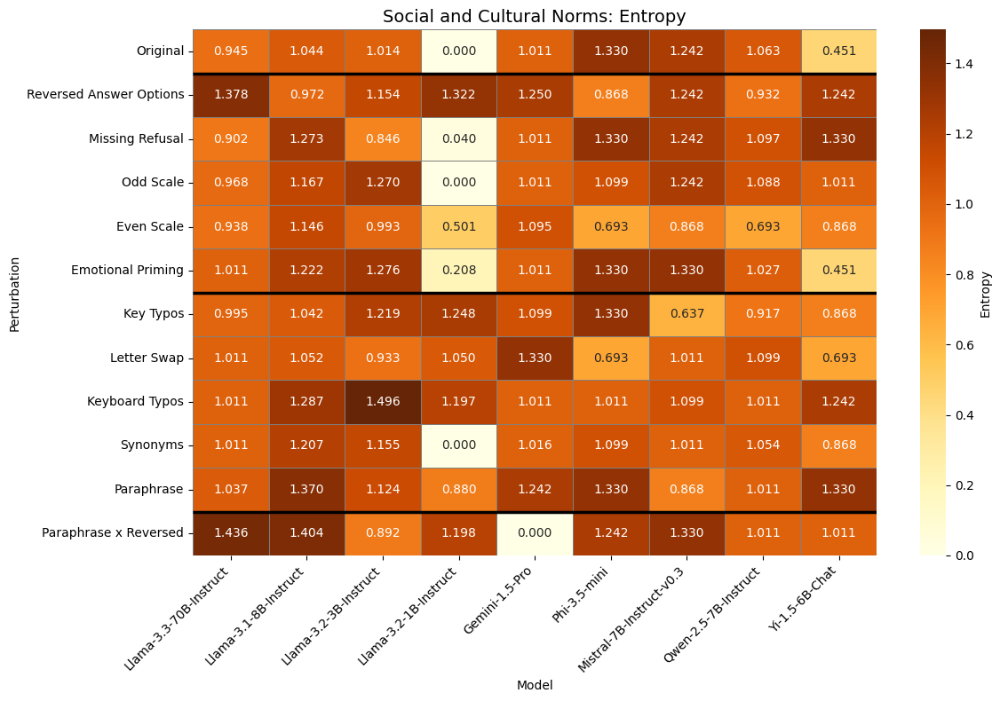

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.451' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.428' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.594' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

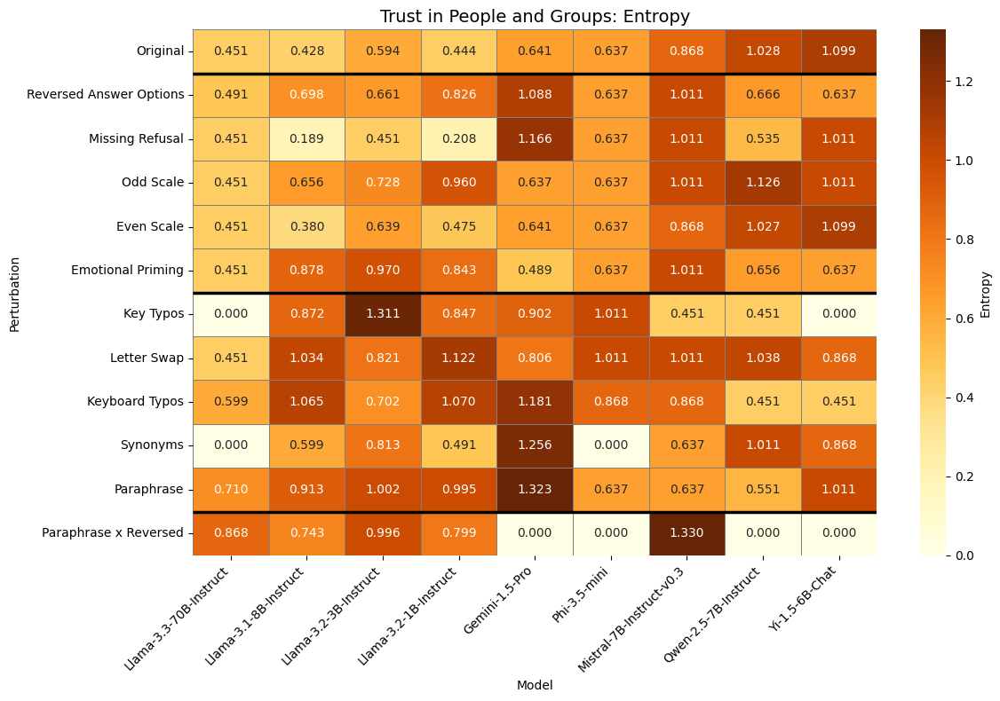

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.410' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.379' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

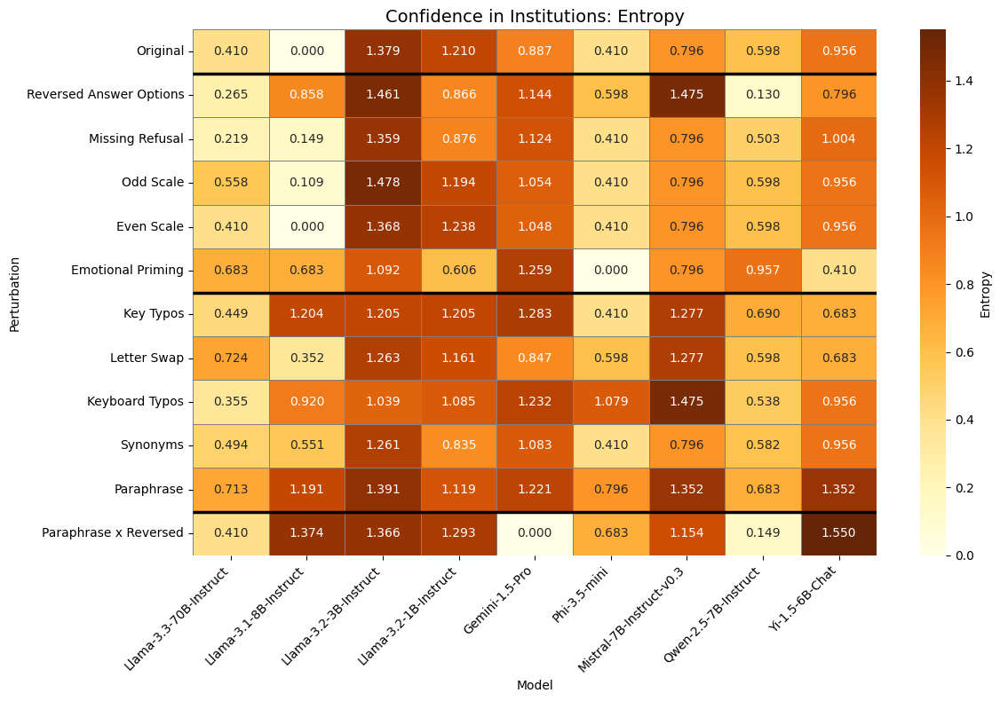

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.624' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.333' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

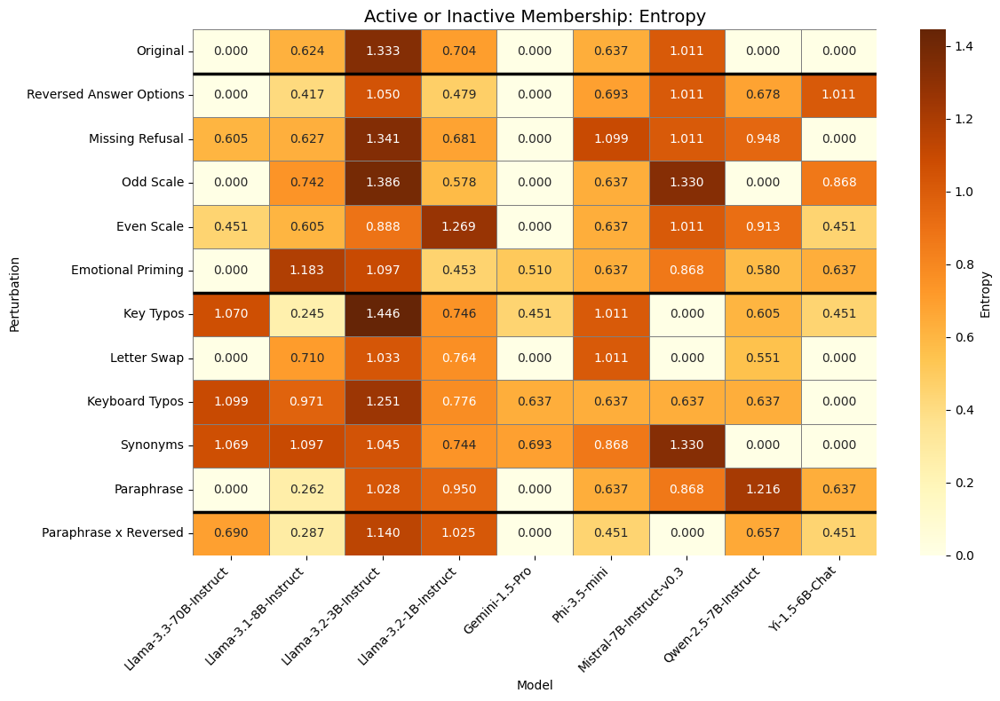

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.637' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.044' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.159' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

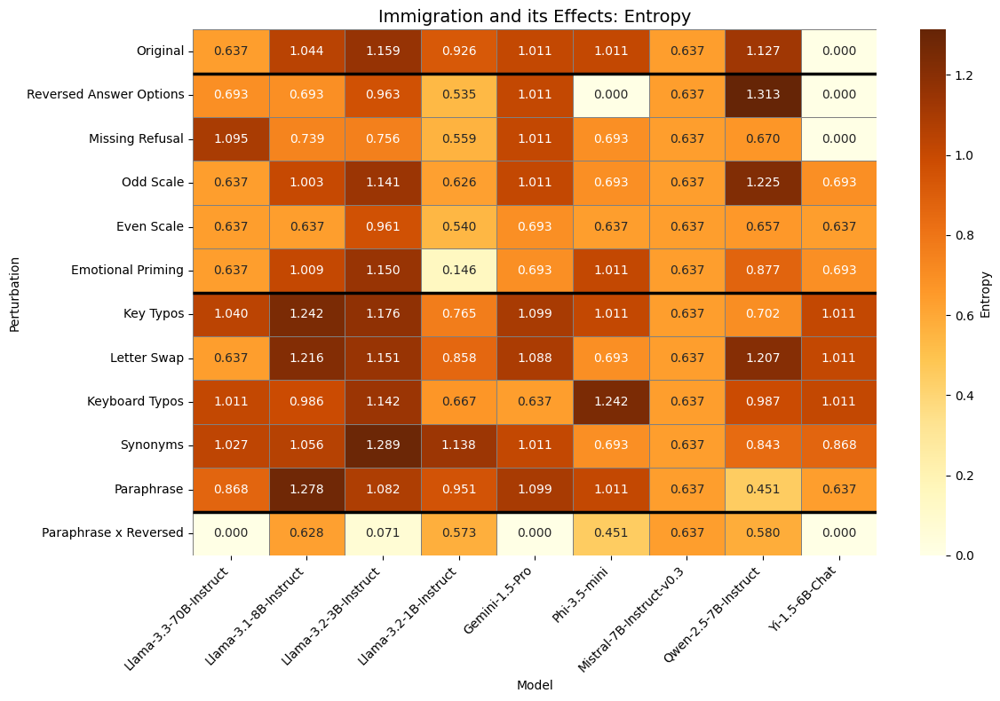

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.431' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.176' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.426' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

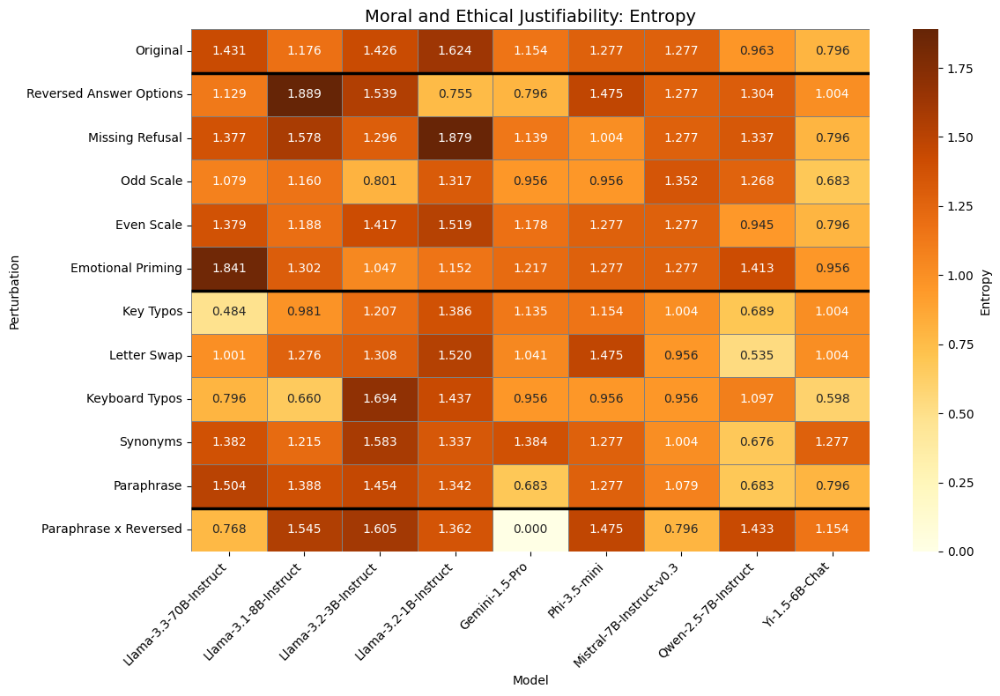

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.653' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

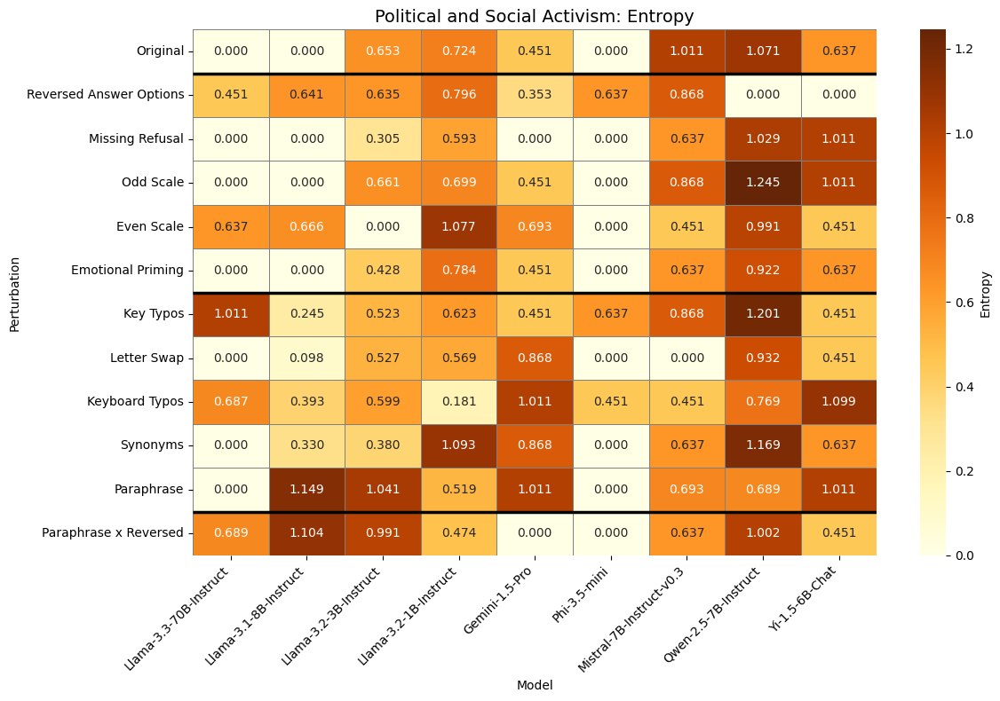

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.692' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.004' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.049' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

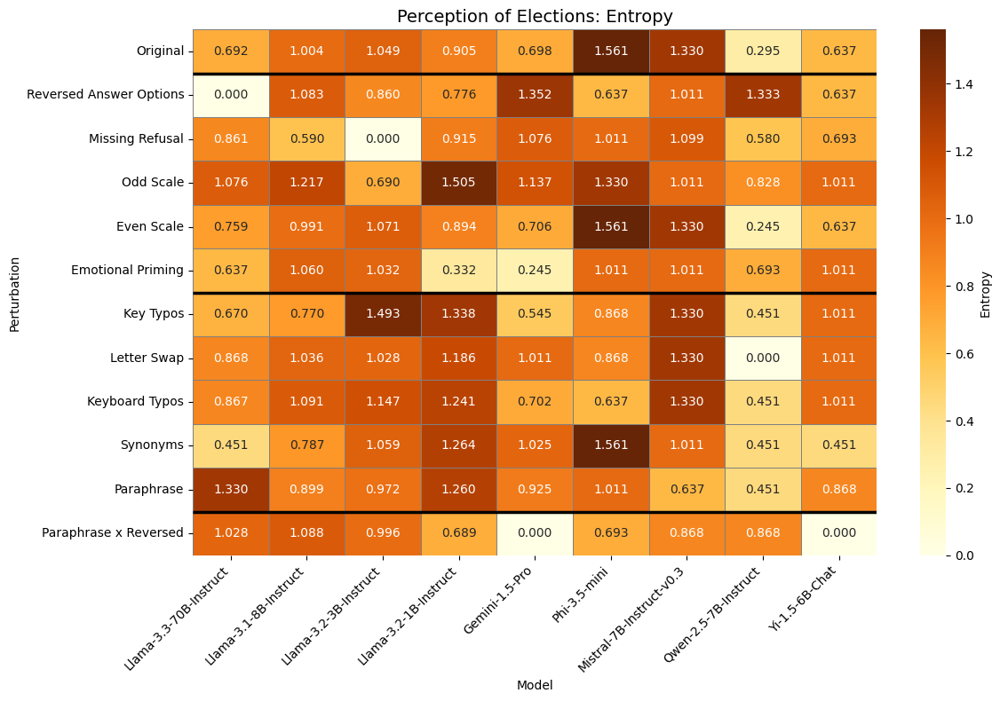

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.330' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.358' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.930' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\1338422202.py:96: FutureWarning:

Setting an item of incompatible

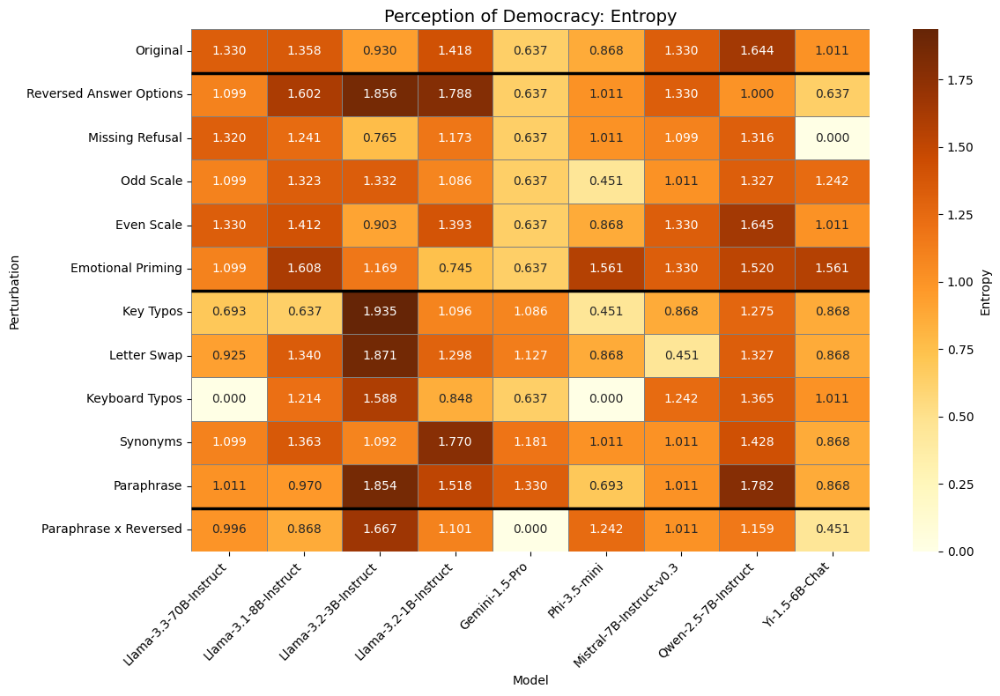

In [144]:
# create an entropy heatmap here to compare model and perturbation
generate_entropy_heatmap(final_interviews_categorized)

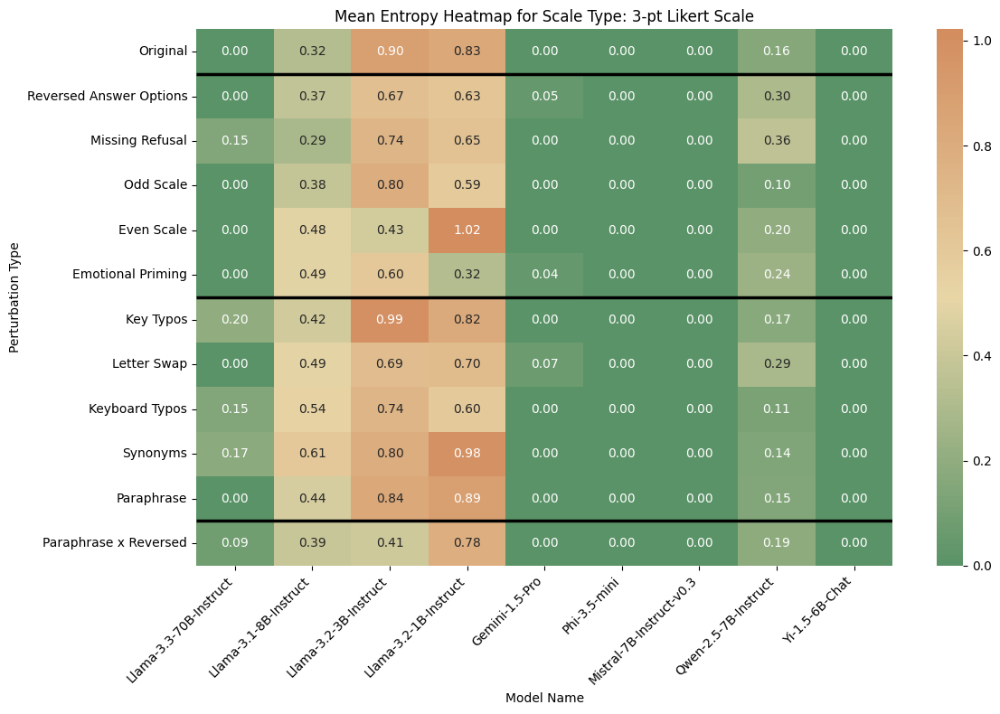

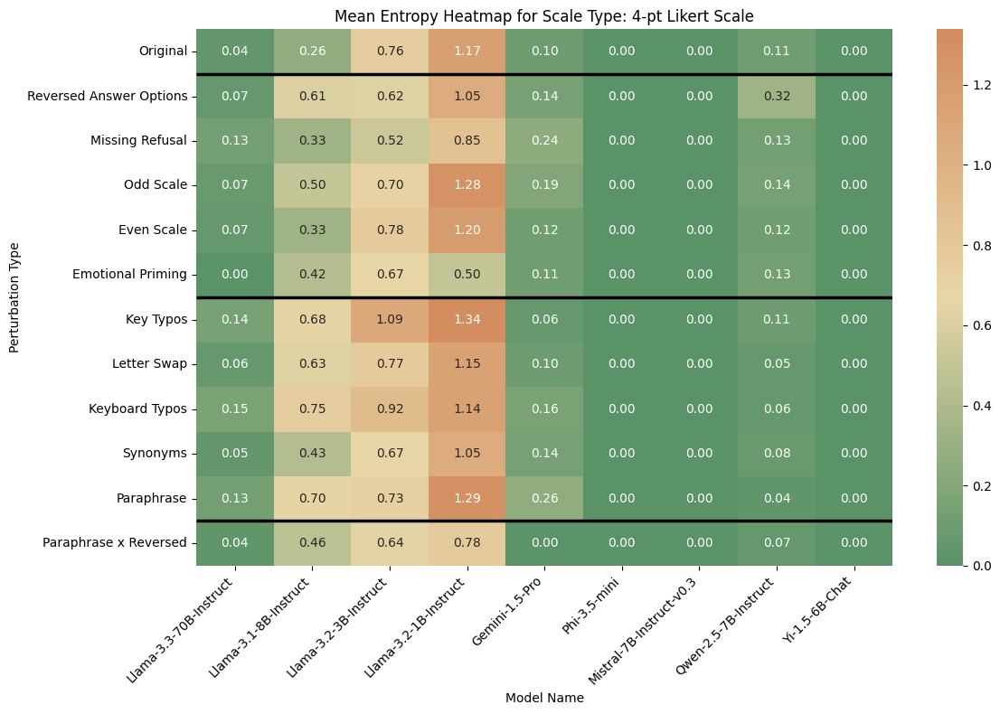

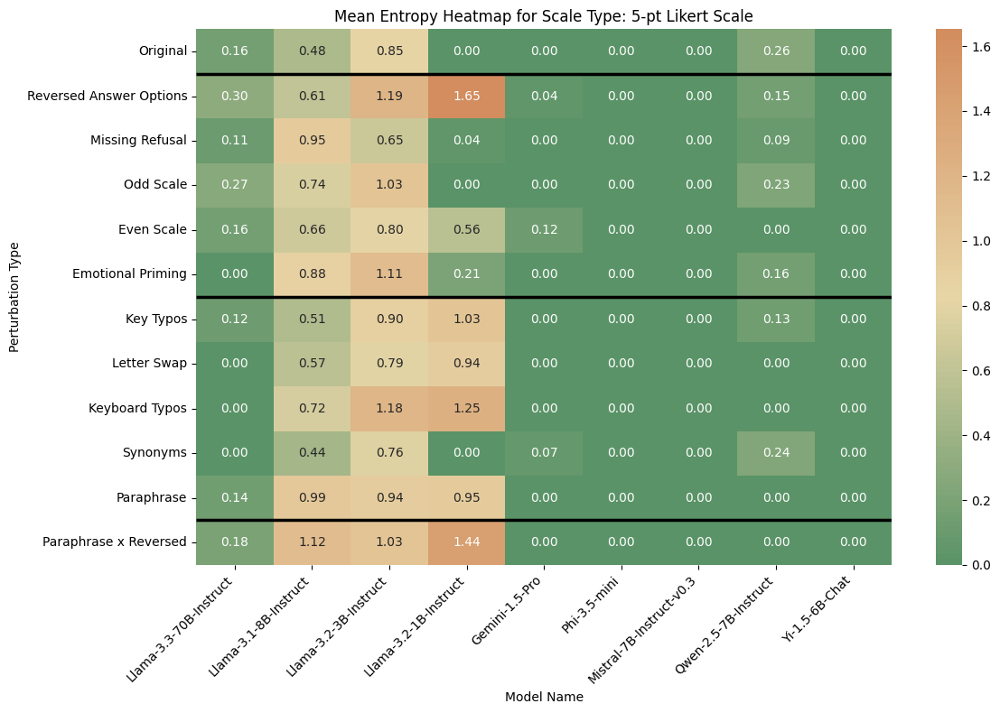

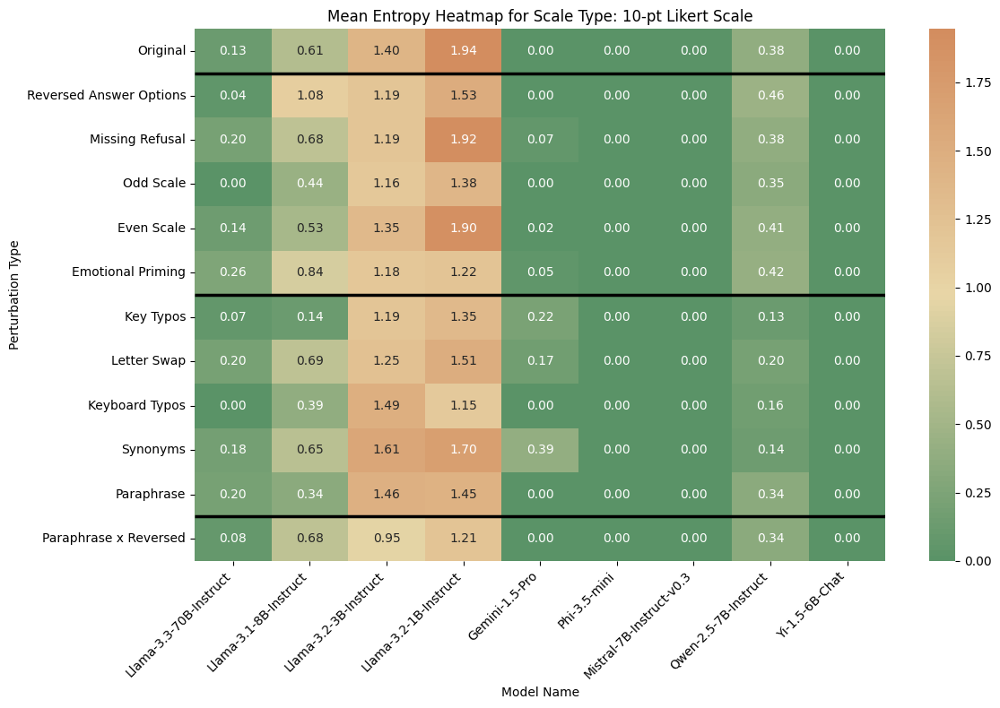

In [145]:
# Filter the dataframe
df = final_interviews_categorized

# Define the desired order for the 'type' column
desired_order = [
    "Original",
    "Reversed Answer Options",
    "Missing Refusal",
    "Odd Scale",
    "Even Scale",
    "Emotional Priming",
    "Key Typos",
    "Letter Swap",
    "Keyboard Typos",
    "Synonyms",
    "Paraphrase",
    "Paraphrase x Reversed"
]


# Drop NaN values in extracted_response (if any)
df = df.dropna(subset=['extracted_response'])

# Replace 'type' values with more readable names
df.loc[:, "type"] = df["type"].replace({
    'list_answer_options': "Original",
    'list_answer_no_refusal': "Missing Refusal",  
    'list_answer_options_reversed': "Reversed Answer Options", 
    'original_emotional_prime': "Emotional Priming",
    'list_answer_middle': "Odd Scale",
    'list_answer_no_middle': "Even Scale",
    'question_typo': "Key Typos",
    'question_letter_swap': "Letter Swap",
    'question_synonym': "Synonyms",
    'question_paraphrased': "Paraphrase",
    'question_keyboardtypo': "Keyboard Typos",
    'interaction_paraphrase_reversed': "Paraphrase x Reversed"
})

# Convert 'type' to a categorical variable with the desired order
df.loc[:, "type"] = pd.Categorical(df["type"], categories=desired_order, ordered=True)

# Group boundaries for horizontal lines (e.g., separate scales from typos)
group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

# Get unique categories
categories = sorted_scales

# Create a 2x2 plot matrix
#fig, axes = plt.subplots(2, 2, figsize=(20, 16))
#axes = axes.flatten()  # Flatten the 2x2 array to easily iterate over it

# Plot heatmaps for each category using entropy instead of variance
for i, category in enumerate(categories[:4]):
    category_data = df[df['Scale Type'] == category]
    
    # Calculate entropy per Question ID, then compute the mean across question IDs
    heatmap_data = (
        category_data.groupby(['type', 'model_name', 'Question ID'])['extracted_response']
        .apply(lambda x: entropy(x.value_counts(normalize=True), base=2))  # Entropy per question
        .groupby(['type', 'model_name'])  # Group again to calculate mean entropy
        .mean()
        .unstack()  # Reshape for the heatmap
    )

    # Reindex columns to ensure the desired model order
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models, index=desired_order)
    heatmap_data = heatmap_data.astype(float).fillna(0)
    colors = [ "#5A9367","#E8D6A7","#D38D5F"]  
    cmap = LinearSegmentedColormap.from_list("custom_cmap", colors, N=100)
    plt.figure(figsize=(12, 8))
    # Plot heatmap of mean entropy values
    ax = sns.heatmap(
        heatmap_data, 
        annot=True, 
        fmt=".2f", 
        #cmap="viridis",  
        cmap = cmap,
        cbar=True, 
        #ax=axes[i]
    )

    # Titles and formatting
    ax.set_title(f"Mean Entropy Heatmap for Scale Type: {category}")
    ax.set_ylabel("Perturbation Type")
    ax.set_xlabel("Model Name")
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)

    # Adjust layout and save the figure as a PDF
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/heatmap_entropy_per_question_{category}_matrix.pdf")
    plt.savefig(f"../thesis/figures/heatmap_entropy_per_question_{category}_matrix.png", transparent = True)
    plt.show()


## Share of Don't know and NaN interviews
This heatmap will display the share of refusal and unsuccessful interviews by model and perturbation. This is necessary to see which models perform best and worst. Also it will shed a light on the perturbations which are difficult for the models to comprehend and process.

In [146]:
def generate_refusal_nan_heatmap(data, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap of the share of null values (unsuccessful interviews) and refusal
    for categorical 'extracted_response' distribution.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    categories = data["Category"].unique()
    perturbations = data["type"].unique()
    desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

    # Loop through each model and type to compute metrics
    for category in categories:
        # Initialize results lists
        results = []
        for model in models:
            for i,perturbation in enumerate(perturbations):    
                subset = final_interviews_categorized[
                    (final_interviews_categorized["Category"] == category) &
                    (final_interviews_categorized["model_name"] == model) &
                    (final_interviews_categorized["type"] == perturbation)
                ]

                # Group the data by model_name and extracted_response to count occurrences
                grouped_data = (
                    subset.groupby(["model_name", "extracted_response"])
                    .size()
                    .reset_index(name="count")
                )
                # Calculate probabilities for each category within each model
                distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
                refusal_nan = distribution[distribution.index.get_level_values('extracted_response').isin(["nan", "-1.0"])].sum()/distribution.sum()
                # print(f"Category: {category}, Model: {model}, Perturbation: {perturbation}")
                # print(raw_entropy)
                # print("Entropy:", raw_entropy["Entropy"].values[0])

                # Append results
                results.append({'Model': model, 
                                'Type': perturbation, 
                                'Refusal - Unsuccessful': refusal_nan})

        # Convert results to DataFrame
        results_df = pd.DataFrame(results)
        results_df["Type"] = results_df["Type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

        results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
        results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

        # Pivot for heatmap structure
        heatmap_data = results_df.pivot(index='Type', columns='Model', values='Refusal - Unsuccessful')
        # Ensure the models appear in the specified order in the x-axis
        heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
        # Generate annotations manually
        annotations = heatmap_data.copy()
        for row in annotations.index:
            for col in annotations.columns:
                refusal = heatmap_data.at[row, col]
                if pd.isna(refusal):
                    annotations.at[row, col] = ""
                else:
                    annotations.at[row, col] = f"{refusal:.3f}"
        #vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
        # Plot heatmap
        plt.figure(figsize=(12, 8))
        ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'Share of Refusal + Unsuccessful'},
            vmin=0,  # Start colors from 0
            vmax=1,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
        )

        # Add horizontal lines for group separation
        for boundary in group_boundaries:
            ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
        plt.title(f'{category}: Share of Refusal & Unsuccessful Interviews', fontsize=14)
        plt.ylabel("Perturbation")
        plt.xlabel("Model")
        plt.xticks(rotation = 45, ha='right')
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/{category[0:20]}_refusalNaN_heatmap.pdf")
        plt.savefig(f"../thesis/figures/{category[0:20]}_refusalNaN_heatmap.png", transparent = True)
        plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

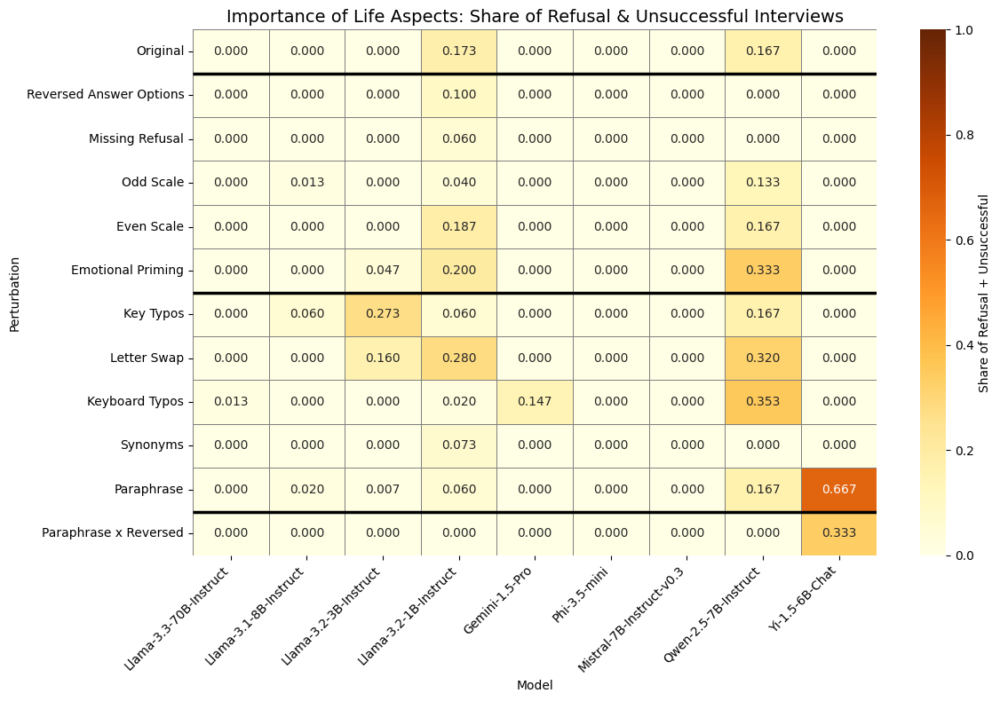

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

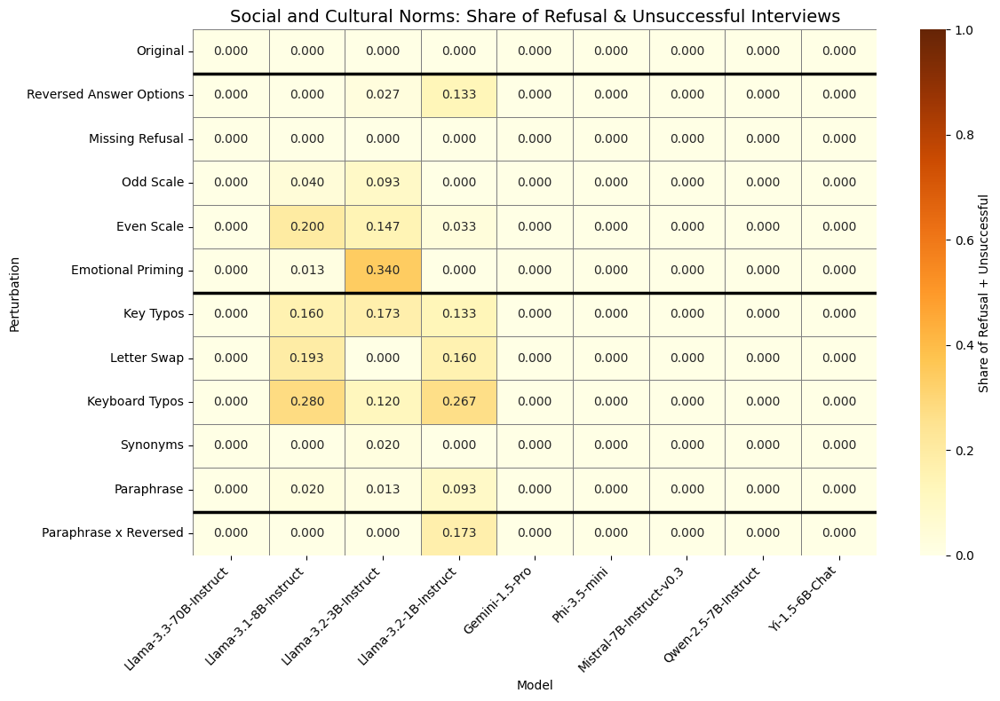

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.153' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.800' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

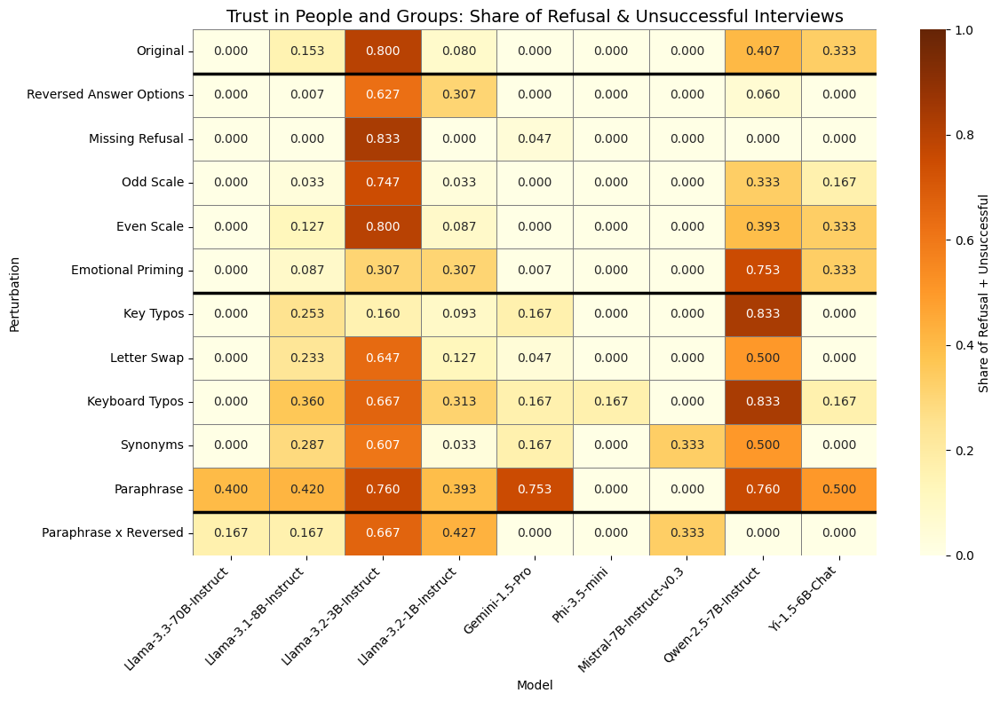

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.246' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

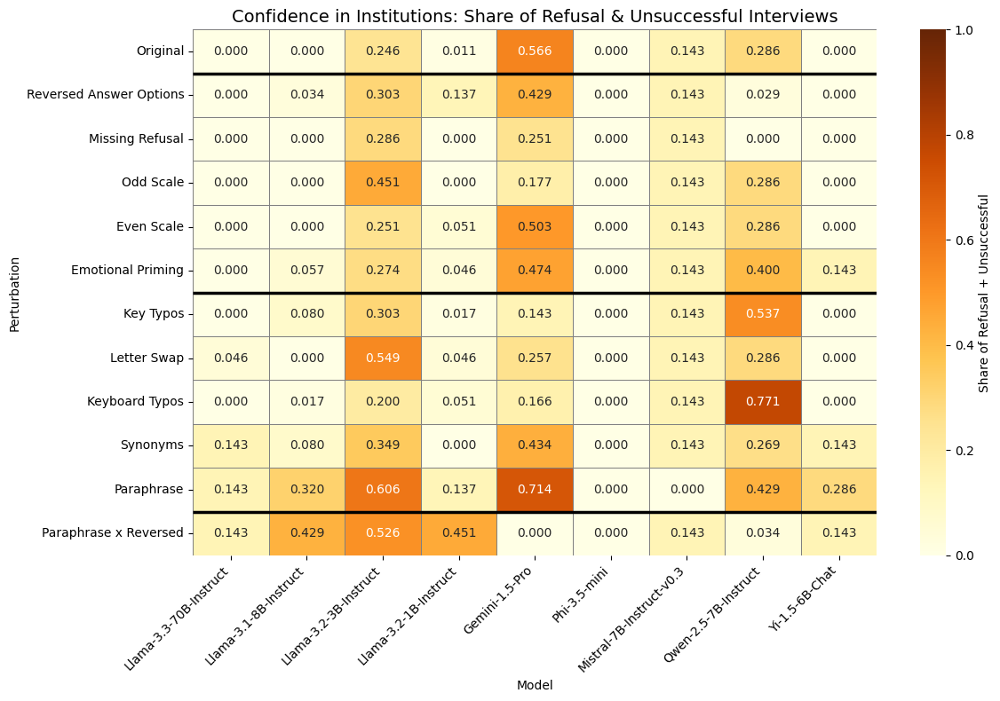

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.087' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.387' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

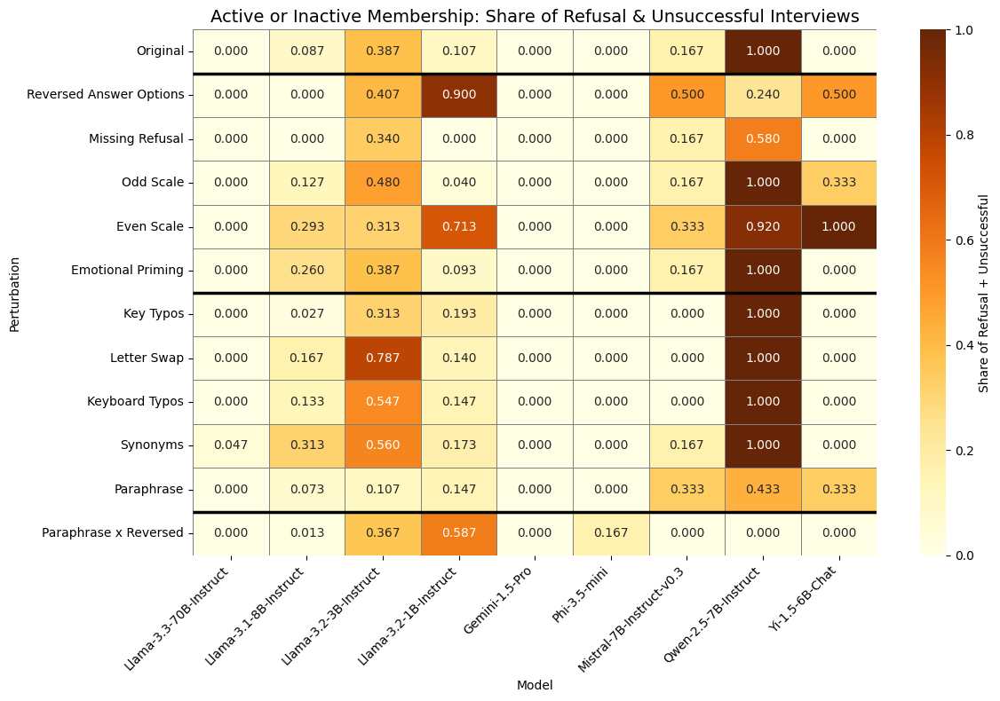

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.147' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.067' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

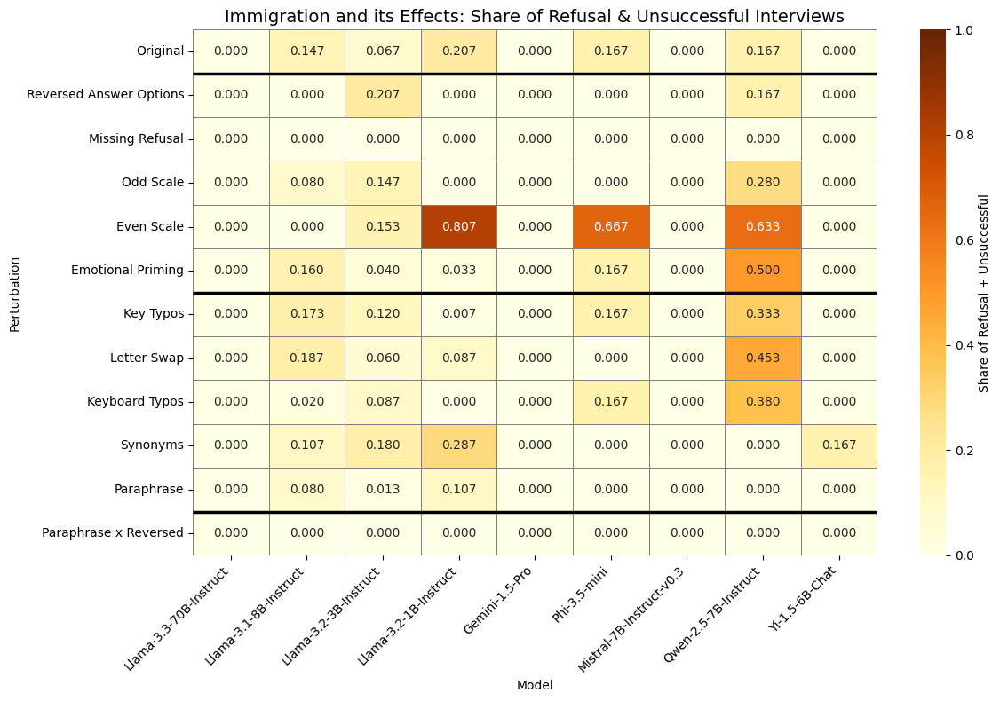

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.617' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.097' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

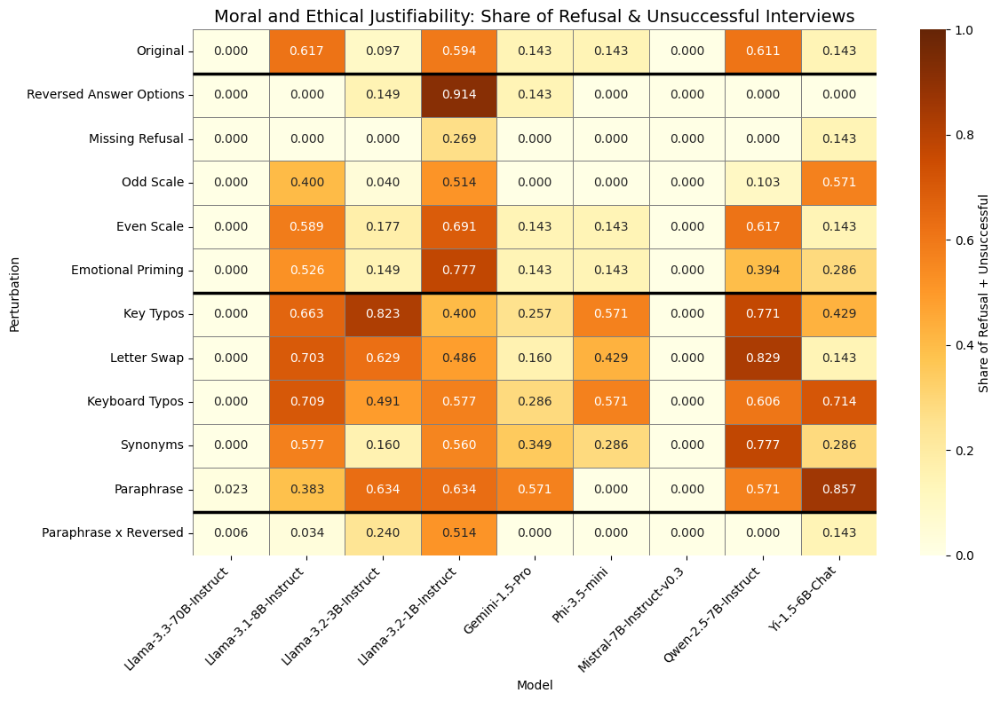

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.360' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

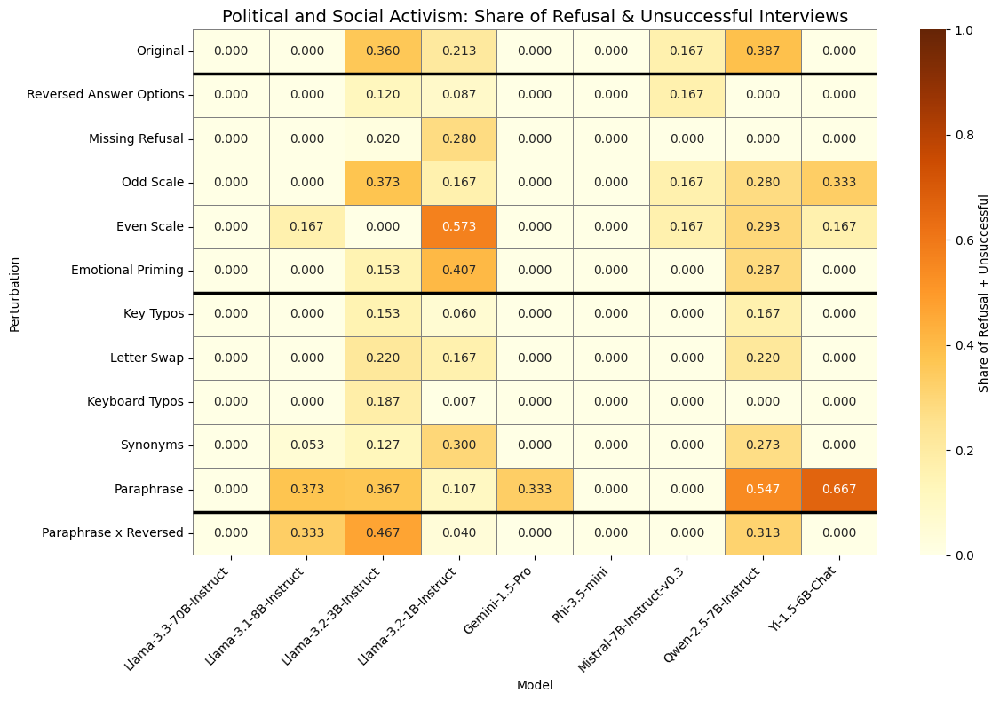

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.507' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.387' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

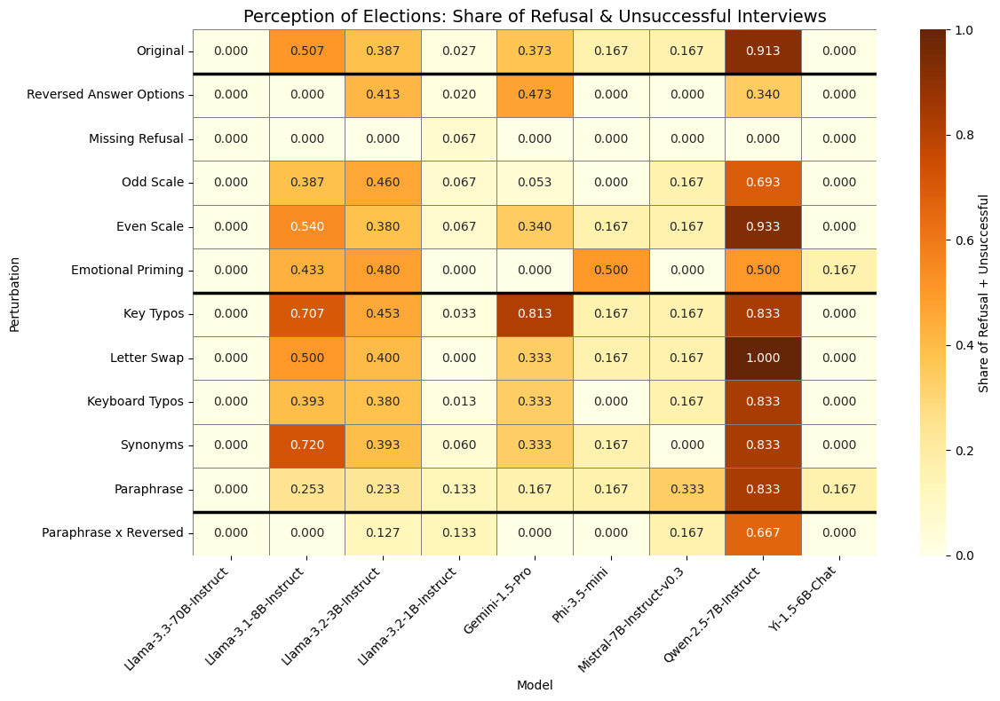

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.333' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\349940491.py:92: FutureWarning:

Setting an item of incompatible dty

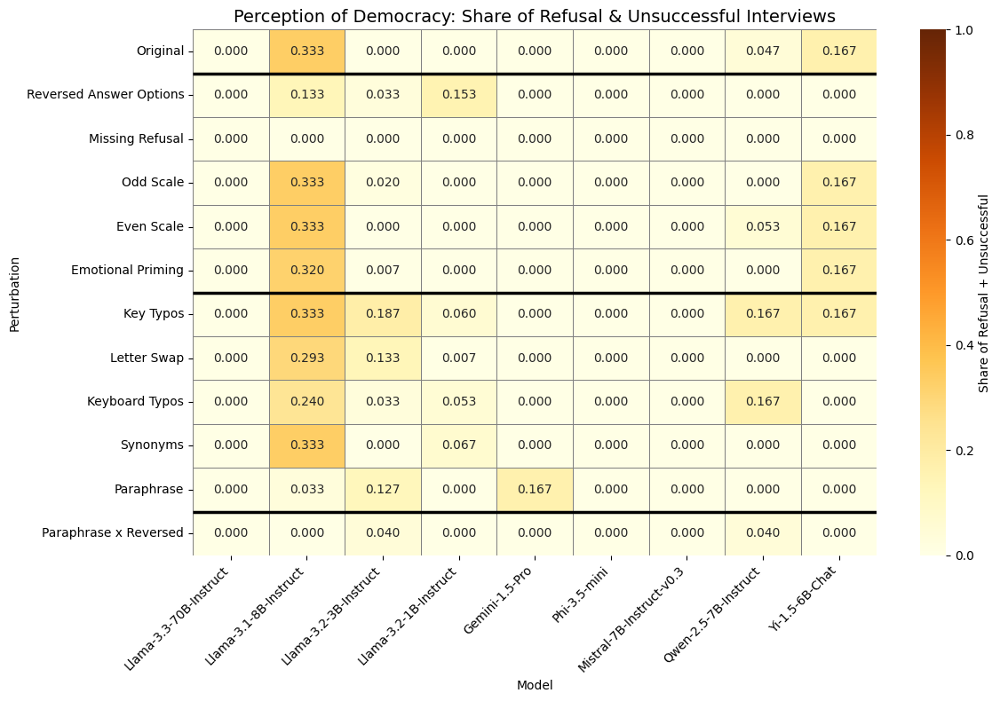

In [147]:
generate_refusal_nan_heatmap(final_interviews_categorized)


In [148]:
def overall_refusal_nan_heatmap(data, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap of the share of null values (unsuccessful interviews) and refusal
    for 'extracted_response' distribution over all categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    perturbations = data["type"].unique()
    desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

        # Initialize results lists
    results = []
    for model in models:
        for i,perturbation in enumerate(perturbations):    
                subset = final_interviews_categorized[
                    (final_interviews_categorized["model_name"] == model) &
                    (final_interviews_categorized["type"] == perturbation)
                ]

                # Group the data by model_name and extracted_response to count occurrences
                grouped_data = (
                    subset.groupby(["model_name", "extracted_response"])
                    .size()
                    .reset_index(name="count")
                )
                # Calculate probabilities for each category within each model
                distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
                refusal_nan = distribution[distribution.index.get_level_values('extracted_response').isin(["nan", "-1.0"])].sum()/distribution.sum()
                # print(f"Category: {category}, Model: {model}, Perturbation: {perturbation}")
                # print(raw_entropy)
                # print("Entropy:", raw_entropy["Entropy"].values[0])

                # Append results
                results.append({'Model': model, 
                                'Type': perturbation, 
                                'Refusal - Unsuccessful': refusal_nan})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap structure
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='Refusal - Unsuccessful')
    # Ensure the models appear in the specified order in the x-axis
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
    # Generate annotations manually
    annotations = heatmap_data.copy()
    for row in annotations.index:
        for col in annotations.columns:
            refusal = heatmap_data.at[row, col]
            if pd.isna(refusal):
                annotations.at[row, col] = ""
            else:
                annotations.at[row, col] = f"{refusal:.3f}"
    #vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
    # Plot heatmap
    plt.figure(figsize=(12, 8))
    ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'Share of Refusal + Unsuccessful'},
            vmin=0,  # Start colors from 0
            vmax=0.5,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
    )

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
    plt.title(f'Overall Share of Refusal & Unsuccessful Interviews', fontsize=14)
    plt.ylabel("Perturbation")
    plt.xlabel("Model")
    plt.xticks(rotation = 45, ha='right')
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/overall_refusalNaN_heatmap.pdf")
    plt.savefig(f"../thesis/figures/overall_refusalNaN_heatmap.png", transparent = True)
    plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\404167915.py:88: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\404167915.py:88: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.188' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\404167915.py:88: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.232' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\404167915.py:88: FutureWarning:

Setting an item of incompatible dty

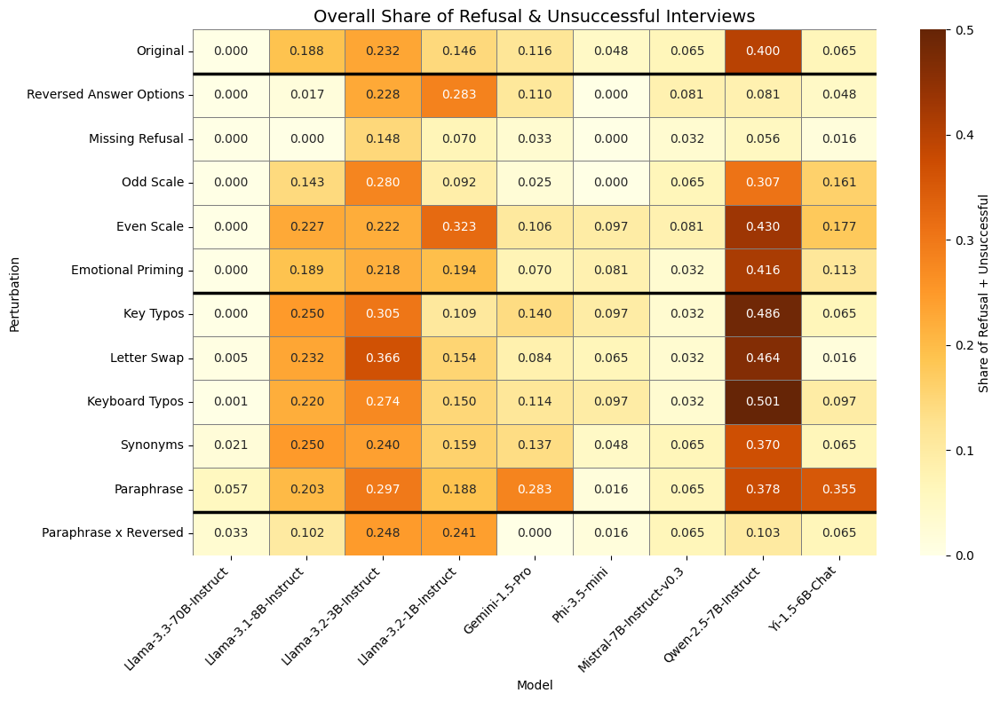

In [149]:
overall_refusal_nan_heatmap(final_interviews_categorized)

Inspect Refusal Category separately!

In [150]:
def overall_refusal_heatmap(data, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap of the share of refusal
    for 'extracted_response' distribution over all categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    perturbations = data["type"].unique()
    desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

        # Initialize results lists
    results = []
    for model in models:
        for i,perturbation in enumerate(perturbations):    
                subset = final_interviews_categorized[
                    (final_interviews_categorized["model_name"] == model) &
                    (final_interviews_categorized["type"] == perturbation)
                ]

                # Group the data by model_name and extracted_response to count occurrences
                grouped_data = (
                    subset.groupby(["model_name", "extracted_response"])
                    .size()
                    .reset_index(name="count")
                )
                # Calculate probabilities for each category within each model
                distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
                refusal = distribution[distribution.index.get_level_values('extracted_response').isin(["-1.0"])].sum()/distribution.sum()
                # Append results
                results.append({'Model': model, 
                                'Type': perturbation, 
                                'Refusal': refusal})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap structure
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='Refusal')
    # Ensure the models appear in the specified order in the x-axis
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
    # Generate annotations manually
    annotations = heatmap_data.copy()
    for row in annotations.index:
        for col in annotations.columns:
            refusal = heatmap_data.at[row, col]
            if pd.isna(refusal):
                annotations.at[row, col] = ""
            else:
                annotations.at[row, col] = f"{refusal:.3f}"
    #vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
    # Plot heatmap
    plt.figure(figsize=(12, 8))
    ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'Share of Refusal Interviews'},
            vmin=0,  # Start colors from 0
            vmax=0.5,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
    )

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
    plt.title(f'Overall Share of Refusal Interviews', fontsize=14)
    plt.ylabel("Perturbation")
    plt.xlabel("Model")
    plt.xticks(rotation = 45, ha='right')
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/overall_refusal_heatmap.pdf")
    plt.savefig(f"../thesis/figures/overall_refusal_heatmap.png", transparent = True)
    plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3751040469.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3751040469.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.188' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3751040469.py:84: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.063' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3751040469.py:84: FutureWarning:

Setting an item of incompatible

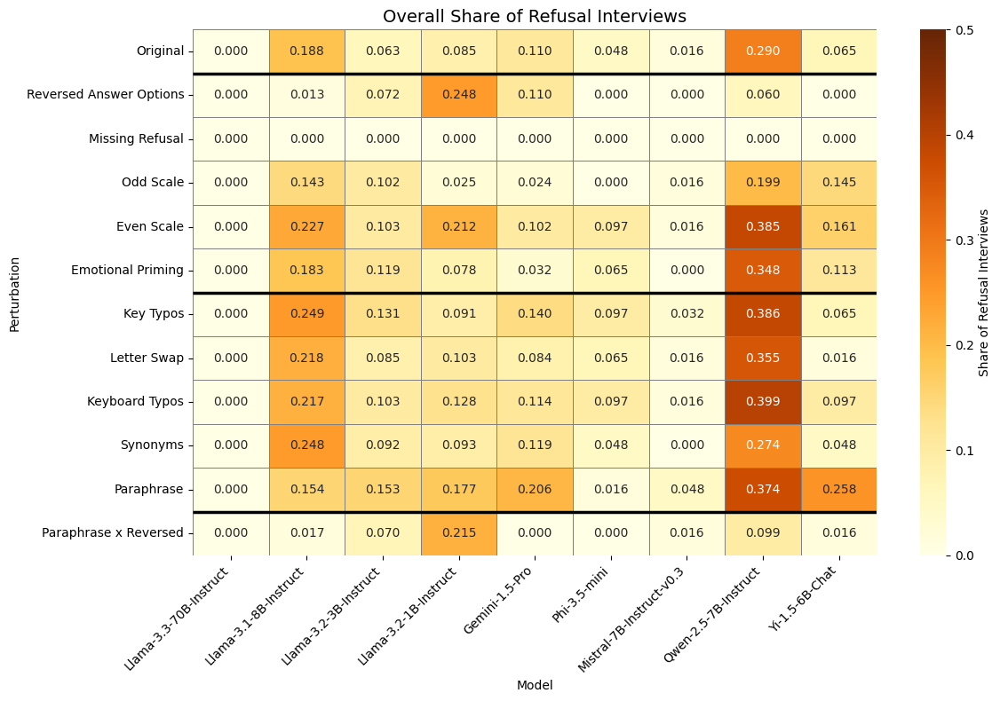

In [151]:
overall_refusal_heatmap(final_interviews_categorized)

Now I inspect only the unsuccessful interviews!

In [152]:
def overall_nan_heatmap(data, column_model='model_name', column_type='type', 
                            column_response='extracted_response'):
    """
    Generates a heatmap of the share of null values (unsuccessful interviews)
    for 'extracted_response' distribution over all categories.
    """

    # Get unique model names and perturbation types
    models = all_sorted_models
    perturbations = data["type"].unique()
    desired_order = [
                "Original",
                "Reversed Answer Options",
                "Missing Refusal",
                "Odd Scale",
                "Even Scale",
                "Emotional Priming",
                "Key Typos",
                "Letter Swap",
                "Keyboard Typos",
                "Synonyms",
                "Paraphrase",
                "Paraphrase x Reversed"
            ]
    # Group boundaries for horizontal lines (e.g., separate scales from typos)
    group_boundaries = [1, 6, 11]  # After "Original", "Letter Swap", and "Paraphrase"

        # Initialize results lists
    results = []
    for model in models:
        for i,perturbation in enumerate(perturbations):    
                subset = final_interviews_categorized[
                    (final_interviews_categorized["model_name"] == model) &
                    (final_interviews_categorized["type"] == perturbation)
                ]

                # Group the data by model_name and extracted_response to count occurrences
                grouped_data = (
                    subset.groupby(["model_name", "extracted_response"])
                    .size()
                    .reset_index(name="count")
                )
                # Calculate probabilities for each category within each model
                distribution = grouped_data.groupby(["model_name", "extracted_response"])["count"].sum()
                unsuccessful = distribution[distribution.index.get_level_values('extracted_response').isin(["nan"])].sum()/distribution.sum()
                
                # Append results
                results.append({'Model': model, 
                                'Type': perturbation, 
                                'Unsuccessful': unsuccessful})

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    results_df["Type"] = results_df["Type"].replace(
            {'list_answer_options': "Original",
            'list_answer_no_refusal': "Missing Refusal",  
            'list_answer_options_reversed': "Reversed Answer Options", 
            'original_emotional_prime': "Emotional Priming",
            'list_answer_middle': "Odd Scale",
            'list_answer_no_middle': "Even Scale",
            'question_typo': "Key Typos",
            'question_letter_swap': "Letter Swap",
            'question_synonym': "Synonyms",
            'question_paraphrased': "Paraphrase",
            'question_keyboardtypo': "Keyboard Typos",
            'interaction_paraphrase_reversed': "Paraphrase x Reversed"}
            )

    results_df["Type"] = pd.Categorical(results_df["Type"], categories=desired_order, ordered=True)
        # Sort "Model" column
    results_df["Model"] = pd.Categorical(results_df["Model"], categories=all_sorted_models, ordered=True)

    # Pivot for heatmap structure
    heatmap_data = results_df.pivot(index='Type', columns='Model', values='Unsuccessful')
    # Ensure the models appear in the specified order in the x-axis
    heatmap_data = heatmap_data.reindex(columns=all_sorted_models)
    # Generate annotations manually
    annotations = heatmap_data.copy()
    for row in annotations.index:
        for col in annotations.columns:
            nan = heatmap_data.at[row, col]
            if pd.isna(nan):
                annotations.at[row, col] = ""
            else:
                annotations.at[row, col] = f"{nan:.3f}"
    #vmax = np.nanmax(heatmap_data.values)/ np.nanmean(heatmap_data.values) # divide by mean to avoid that just outliers are colored dark
    # Plot heatmap
    plt.figure(figsize=(12, 8))
    ax = sns.heatmap(
            heatmap_data,
            annot=annotations,  # Use the manually created annotations
            fmt="", 
            cmap=sns.color_palette("YlOrBr", as_cmap=True),  # Use red color palette
            cbar_kws={'label': 'Share of Unsuccessful Interviews'},
            vmin=0,  # Start colors from 0
            vmax=0.5,
            linewidths=0.5,  # Add slight cell separation
            linecolor='gray'
    )

    # Add horizontal lines for group separation
    for boundary in group_boundaries:
        ax.hlines(boundary, *ax.get_xlim(), colors='black', linewidth=2.5)
        
        # Add titles and labels
    plt.title(f'Overall Share of Unsuccessful Interviews', fontsize=14)
    plt.ylabel("Perturbation")
    plt.xlabel("Model")
    plt.xticks(rotation = 45, ha='right')
    plt.tight_layout()
    plt.savefig(f"../thesis/figures/overall_nan_heatmap.pdf")
    plt.savefig(f"../thesis/figures/overall_nan_heatmap.png", transparent = True)
    plt.show()

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3409072209.py:85: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3409072209.py:85: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.000' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3409072209.py:85: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.170' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\3409072209.py:85: FutureWarning:

Setting an item of incompatible

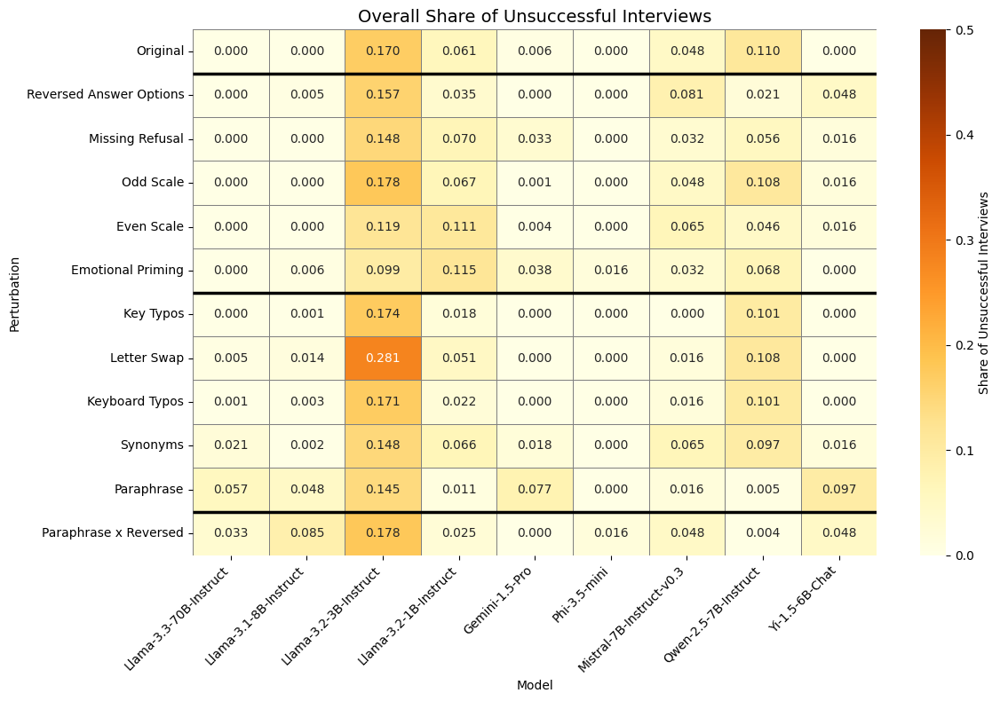

In [153]:
overall_nan_heatmap(final_interviews_categorized)

## Distribution Comparison by Model 

In [154]:
# Boxplots, Violin, and Jitter plots for each Model and Category combination
for category in categories:
    category_data = df[df['Category'] == category]
    models = category_data['model_name'].unique()

    for model in models:
        model_data = category_data[category_data['model_name'] == model]
        plt.figure(figsize=(12, 6))

        # Get all possible y-axis ticks from the category
        y_ticks = sorted(category_data['extracted_response'].unique())

        sns.violinplot(x='type', y='extracted_response', data=model_data, inner=None, color="lightblue")
        sns.boxplot(x='type', y='extracted_response', data=model_data, width=0.2, showcaps=True, boxprops={'facecolor': 'none', 'edgecolor': 'black'},
                    whiskerprops={'color': 'black'}, medianprops={'color': 'red'})
        sns.stripplot(x='type', y='extracted_response', data=model_data, color="black", size=3, jitter=0.1)  # Vertical and horizontal jitter

        plt.title(f"Responses for Model: {model} in Category: {category}")
        plt.xlabel("Perturbation Type")
        plt.ylabel("Extracted Response")
        plt.yticks(ticks=y_ticks, labels=[int(tick) for tick in y_ticks])  # Ensure integer y-ticks
        plt.xticks(rotation=45)  # Rotate x-axis ticks
        plt.tight_layout()
        plt.savefig(f"../thesis/figures/box_violin_jitter_{category}_{model}.pdf")
        plt.show()

## Ordinal Logistic Regression

Prediction the Likelihood of each Response Level

In [155]:
# define combinations because list_answer_middle type mus be compared to list_answer_no_middle
combinations = pd.DataFrame({
        
        "baseline": ['list_answer_options', 'list_answer_middle', 
        'list_answer_options', 'list_answer_options', 'list_answer_options',
        'list_answer_options','list_answer_options','list_answer_options',
        'list_answer_options','list_answer_options','list_answer_options'],
        
        "alternative": [
        'list_answer_no_refusal', 'list_answer_no_middle',
        'list_answer_options_reversed',
        'original_personality_prime', 'original_emotional_prime',
        'question_typo', 'question_letter_swap', 'question_synonym',
        'question_paraphrased', 'question_keyboardtypo',
        'interaction_paraphrase_reversed']
        })
models = final_interviews_categorized["model_name"].unique()

In [163]:
from stargazer.stargazer import Stargazer
import statsmodels.api as sm
from statsmodels.miscmodels.ordinal_model import OrderedModel

perturbation_effect = []

for model in final_interviews_categorized["model_name"].unique():
    for i,k in enumerate(combinations["baseline"]):
        # define scenario of two types which should be checked
        alternative = combinations.loc[i, "alternative"]
        scenario = [k, alternative]
        print(scenario)
        # create subset of scenario and model
        df = final_interviews_categorized[
            (final_interviews_categorized["type"].isin(scenario)) &
            (final_interviews_categorized["model_name"] == model)]

        # convert responses and types to correct categories for ordinal logistic regression
        df["extracted_response"] = pd.to_numeric(df["extracted_response"] , errors='coerce').astype(float)
        # Add a note about the reference category
        
        # Define categories in a specific order
        # Convert 'type' to categorical with explicit order
        df['type'] = pd.Categorical(df['type'], categories=scenario, ordered=True)
        # Encode as integer codes
        df[f'{alternative}'] = df['type'].cat.codes 
        
        # remove all nan for calculation
        df = df[(df["extracted_response"].notnull())]

        # Fit an ordinal logistic regression model
        ordered_model = OrderedModel(df['extracted_response'], df[[f'{alternative}']], distr='logit')
        result = ordered_model.fit(method='lbfgs')

        # Summary of the model
        # print(f"""Ordered Logistic Regression for {model} and baseline distribution {k} and 
        #     alternative distribution {scenario[1]}\n""", result.summary())
        
        coef = result.params[f'{alternative}']
        p_value = result.pvalues[f'{alternative}']
        perturbation_effect.append([model,alternative,coef,p_value])
        
        stargazer = Stargazer([result])
        with open(f'../thesis/tables/ordered_regression/ordered_reg_{model}_{scenario[1]}.tex', 'w') as f:
            f.write(stargazer.render_latex())
        
        # Predict probabilities
        #predicted_probs = result.predict()
        #print(predicted_probs)

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']
['list_answer_options', 'original_emotional_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_no_refusal']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_middle', 'list_answer_no_middle']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'list_answer_options_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_personality_prime']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'original_emotional_prime']
['list_answer_options', 'question_typo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_letter_swap']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_synonym']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_paraphrased']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'question_keyboardtypo']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

['list_answer_options', 'interaction_paraphrase_reversed']


C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_25068\499229941.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

In [164]:
from tabulate import tabulate
# Convert to DataFrame
df = pd.DataFrame(perturbation_effect, columns=['Model', 'Type', 'Coefficient', 'P-Value'])

# Pivot to create a cross-table
# Combine Coefficient and P-Value into one formatted string
df['Formatted'] = df.apply(lambda x: f"{x['Coefficient']:.3f} (p={x['P-Value']:.3f})", axis=1)

# Create the pivot table
pivot_table = df.pivot(index='Type', columns='Model', values='Formatted')

# Display as a formatted table
print(tabulate(pivot_table, headers='keys', tablefmt='pretty', showindex=True))


+---------------------------------+------------------+-----------------------+-----------------------+-----------------------+------------------------+--------------------------+------------------+----------------------+------------------+
|              Type               |  Gemini-1.5-Pro  | Llama-3.1-8B-Instruct | Llama-3.2-1B-Instruct | Llama-3.2-3B-Instruct | Llama-3.3-70B-Instruct | Mistral-7B-Instruct-v0.3 |   Phi-3.5-mini   | Qwen-2.5-7B-Instruct |  Yi-1.5-6B-Chat  |
+---------------------------------+------------------+-----------------------+-----------------------+-----------------------+------------------------+--------------------------+------------------+----------------------+------------------+
| interaction_paraphrase_reversed | -1.056 (p=0.000) |    0.192 (p=0.004)    |   -0.433 (p=0.000)    |    0.008 (p=0.908)    |    -0.094 (p=0.154)    |     -0.174 (p=0.009)     | 0.071 (p=0.274)  |   0.599 (p=0.000)    | -0.286 (p=0.000) |
|      list_answer_no_middle      | -0.7

In [165]:
# Convert to LaTeX-like Stargazer output using a custom string approach
rows = []
for idx, row in pivot_table.iterrows():
    formatted_row = f"{idx} & " + " & ".join(row.fillna("").values) + " \\\\"
    rows.append(formatted_row)

# Prepare Stargazer-like LaTeX table
stargazer_table = "\\begin{tabular}{l" + "c" * len(pivot_table.columns) + "}\n"
stargazer_table += " & " + " & ".join(pivot_table.columns) + " \\\\\n"
stargazer_table += "\\hline\n"
stargazer_table += "\n".join(rows)
stargazer_table += "\n\\end{tabular}"

# Display or save to a file
print(stargazer_table)

# # Optionally, save to a .tex file
# with open("stargazer_table.tex", "w") as file:
#     file.write(stargazer_table)

\begin{tabular}{lccccccccc}
 & Gemini-1.5-Pro & Llama-3.1-8B-Instruct & Llama-3.2-1B-Instruct & Llama-3.2-3B-Instruct & Llama-3.3-70B-Instruct & Mistral-7B-Instruct-v0.3 & Phi-3.5-mini & Qwen-2.5-7B-Instruct & Yi-1.5-6B-Chat \\
\hline
interaction_paraphrase_reversed & -1.056 (p=0.000) & 0.192 (p=0.004) & -0.433 (p=0.000) & 0.008 (p=0.908) & -0.094 (p=0.154) & -0.174 (p=0.009) & 0.071 (p=0.274) & 0.599 (p=0.000) & -0.286 (p=0.000) \\
list_answer_no_middle & -0.794 (p=0.000) & -0.549 (p=0.000) & -0.479 (p=0.000) & -0.314 (p=0.000) & -0.358 (p=0.000) & -0.547 (p=0.000) & -0.769 (p=0.000) & -0.896 (p=0.000) & -0.171 (p=0.008) \\
list_answer_no_refusal & 0.495 (p=0.000) & 0.694 (p=0.000) & 0.296 (p=0.000) & 0.305 (p=0.000) & 0.261 (p=0.000) & 0.065 (p=0.327) & -0.027 (p=0.683) & 1.329 (p=0.000) & -0.288 (p=0.000) \\
list_answer_options_reversed & -0.051 (p=0.422) & 0.373 (p=0.000) & -0.432 (p=0.000) & -0.097 (p=0.163) & -0.245 (p=0.000) & 0.254 (p=0.000) & -0.225 (p=0.001) & 0.684 (p=0.000)

# OLD CODE
This part contains the old code and results from the midterm presentation.

## Primacy Effect

In [ ]:
# Define Subset 
category_filter = "Importance of Life Aspects"
alt_distribution = "list_answer_options_reversed"

subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]


all_possible_responses = subset[(subset["type"] == "list_answer_options")]["extracted_response"].unique()

# define llama dataframe
llama_answer_options_data = subset[(subset["type"] == "list_answer_options") &
                                (subset["model_name"].isin(llama_models))]
llama_answer_options_reversed_data = subset[(subset["type"] == alt_distribution) &
                                            (subset["model_name"].isin(llama_models))]

# define other model dataframe
other_answer_options_data = subset[(subset["type"] == "list_answer_options") &
                                (subset["model_name"].isin(other_models))]
other_answer_options_reversed_data = subset[(subset["type"] == alt_distribution) &
                                (subset["model_name"].isin(other_models))]

#### Distribution Comparison

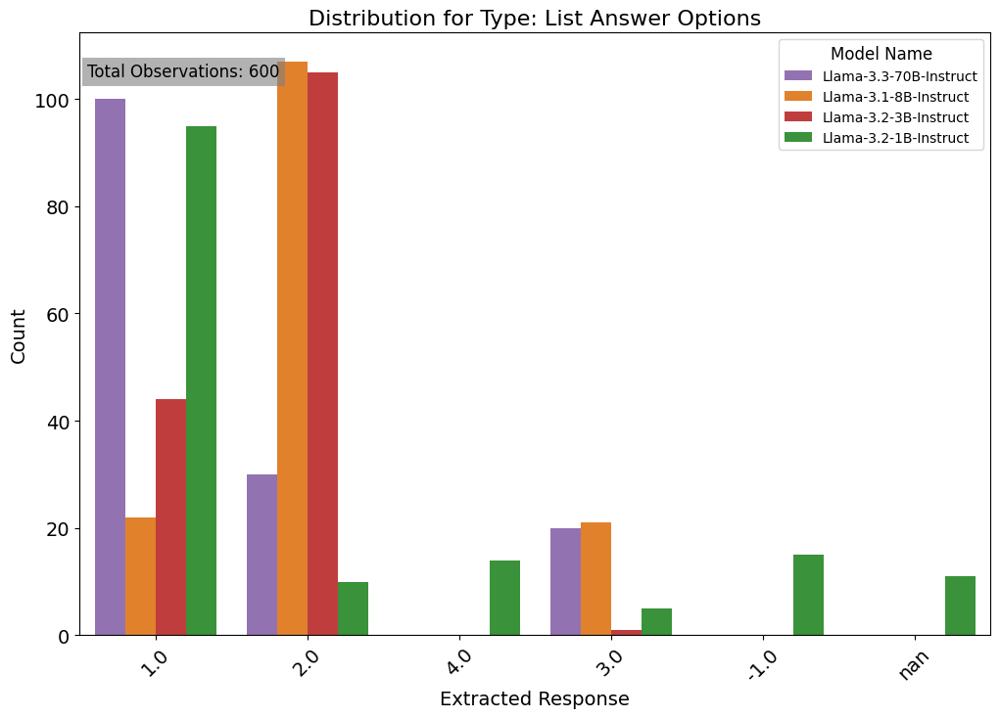

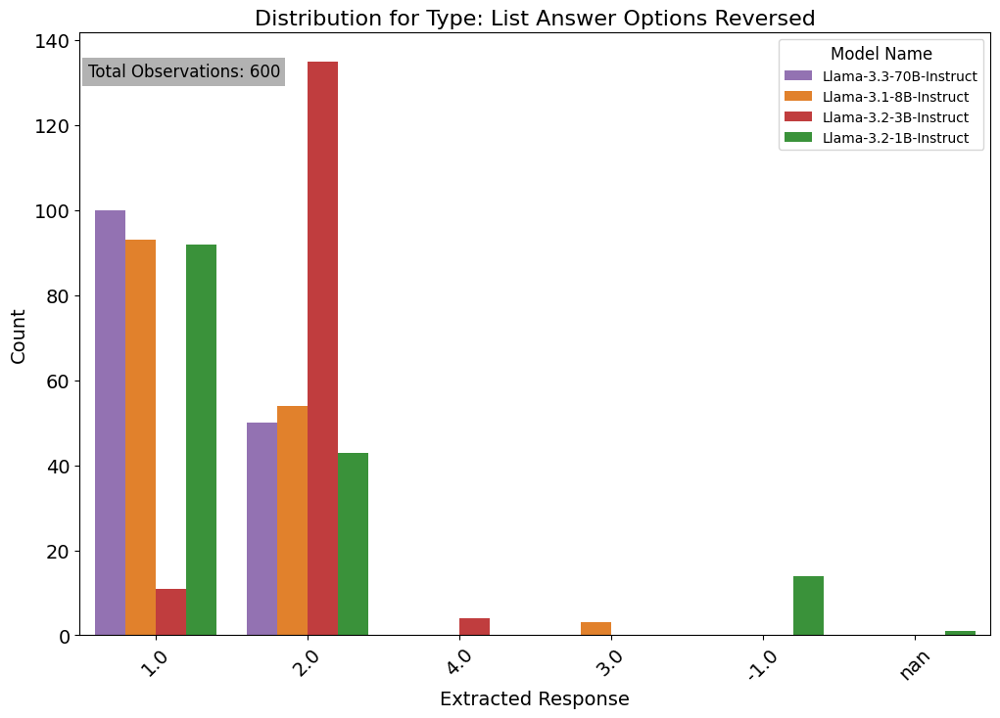

In [ ]:
# get variable names as strings
def varName(p):
    for k, v in globals().items():
        if id(p) == id(v):
            return k

# Function to create a barplot with total observations
def create_barplot(data, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data["model_name"].unique())
    if varName(data).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    # Group by model_name and extracted_response
    grouped_data = (
        data.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    response_order = [resp for resp in all_possible_responses if resp not in ["-1.0", "nan"]] + ["-1.0", "nan"]
    # Reindex to include all possible responses
    grouped_data = (
        grouped_data.set_index(["model_name", "extracted_response"])
        .reindex(
            pd.MultiIndex.from_product(
                [grouped_data["model_name"].unique(), response_order],
                names=["model_name", "extracted_response"]
            ),
            fill_value=0
        )
        .reset_index()
    )
    
    # Calculate total observations
    total_observations = len(data)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data,
        x="extracted_response",
        y="count",
        hue="model_name",
        hue_order=hue_order,  # Ensure consistent order
        palette=color_mapping   # Apply shared colors
    )
    
    # Add the total observations as an annotation
    plt.text(
        x=0.22,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,  # Use axes-relative positioning
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),  
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()
    
    
# Plot for list_answer_options
create_barplot(
    llama_answer_options_data,
    plot_title="Distribution for Type: List Answer Options",
    file_name="../midterm/figures/llama_answer_options_distribution.png"
)

# Plot for list_answer_options_reversed
create_barplot(
    llama_answer_options_reversed_data,
    plot_title="Distribution for Type: List Answer Options Reversed",
    file_name="../midterm/figures/llama_answer_options_reversed_distribution.png"
)

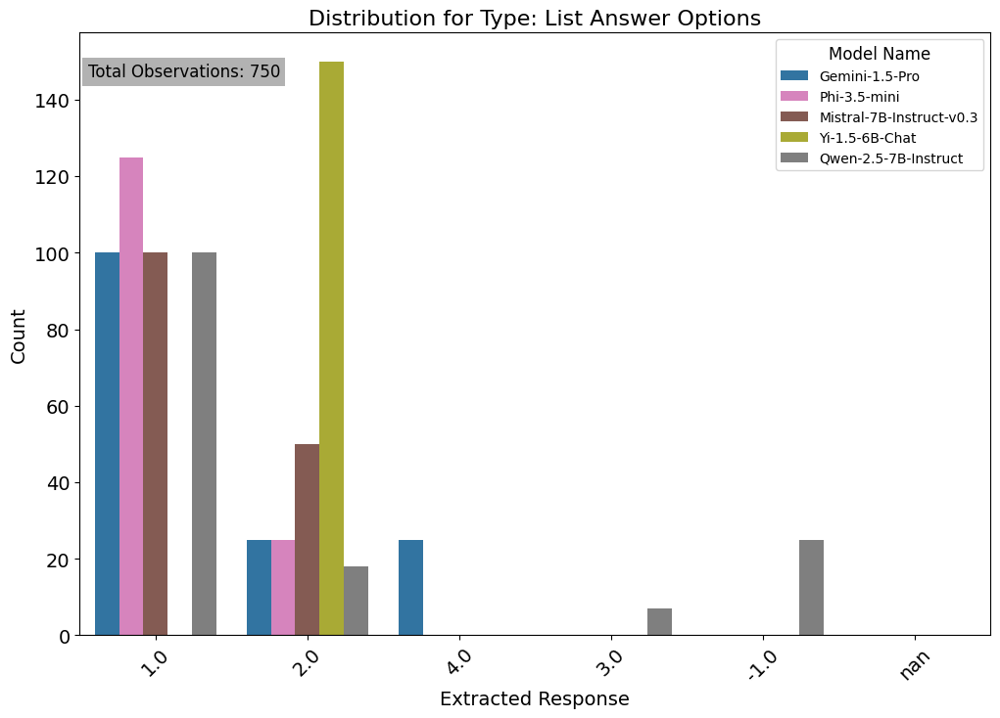

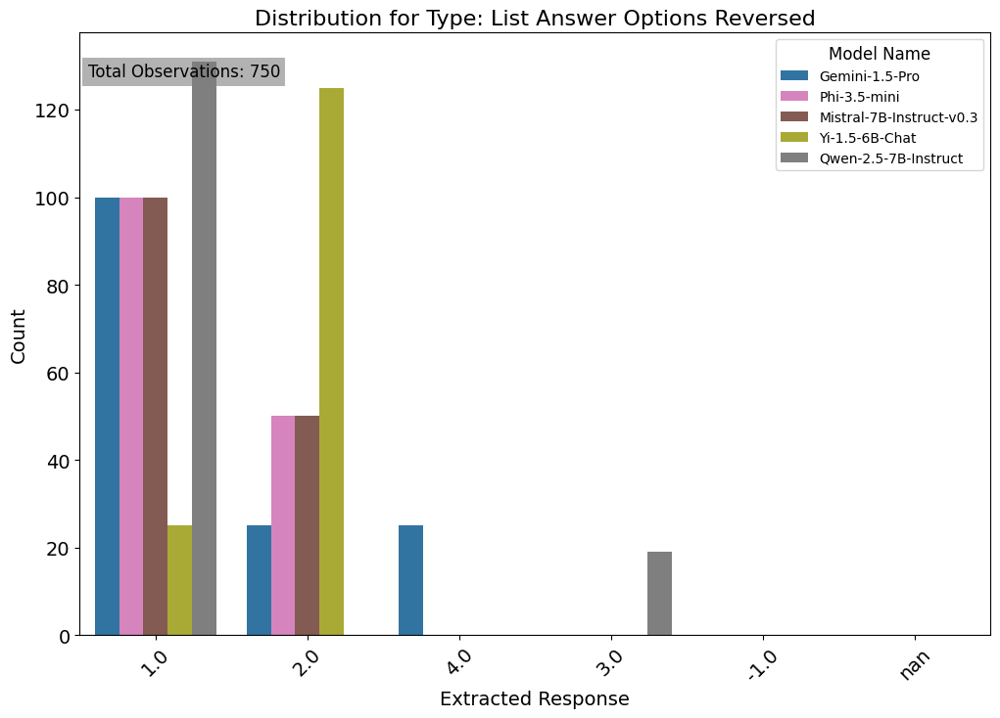

In [ ]:
# Plot for list_answer_options
create_barplot(
    other_answer_options_data,
    plot_title="Distribution for Type: List Answer Options",
    file_name="../midterm/figures/other_answer_options_distribution.png"
)

# Plot for list_answer_options_reversed
create_barplot(
    other_answer_options_reversed_data,
    plot_title="Distribution for Type: List Answer Options Reversed",
    file_name="../midterm/figures/other_answer_options_reversed_distribution.png"
)

#### Difference Plot
Try visualization with a difference plot

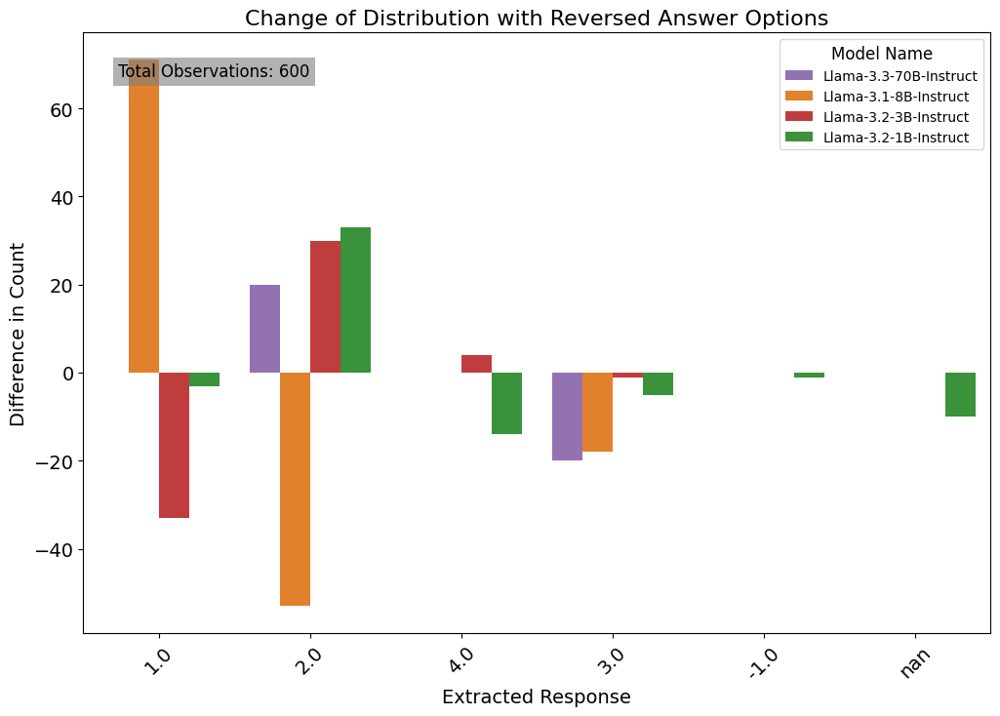

In [ ]:
# Function to create a barplot with total observations
def create_diffplot(data1, data2, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data1["model_name"].unique())
    if varName(data1).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    
    # Group by model_name and extracted_response
    grouped_data1 = (
        data1.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    grouped_data2 = (
        data2.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # change response order to have -1 and nan in the back
    response_order = [resp for resp in all_possible_responses if resp not in ["-1.0", "nan"]] + ["-1.0", "nan"]
    
    # Reindex to include all models/responses in the current dataset
    all_models_responses = pd.MultiIndex.from_product(
        [models_present, response_order],
        names=["model_name", "extracted_response"]
    )
    
    grouped_data1 = (
        grouped_data1.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    grouped_data2 = (
        grouped_data2.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    
    # Calculate the difference between datasets
    grouped_data1["diff_answer"] = grouped_data1["count"] - grouped_data2["count"]
    
    # Calculate total observations
    total_observations = len(data1)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data1,
        x="extracted_response",
        y="diff_answer",
        hue="model_name",
        hue_order=hue_order,  # Only display models present
        palette=color_mapping   # Apply colors for present models only
    )
    
    # Add total observations as an annotation
    plt.text(
        x=0.25,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Difference in Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()

# Plot for list_answer_options
create_diffplot(
    llama_answer_options_reversed_data,
    llama_answer_options_data, 
    plot_title="Change of Distribution with Reversed Answer Options",
    file_name="../midterm/figures/llama_diff_distribution_importance.png"
)


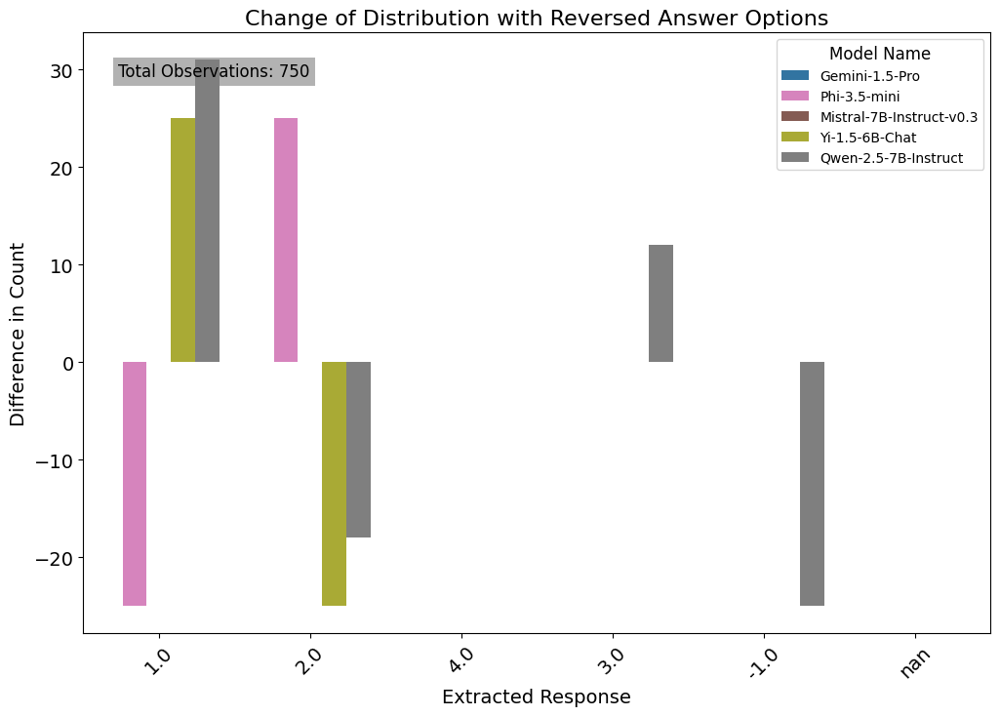

In [ ]:
    
# Plot for list_answer_options
create_diffplot(
    other_answer_options_reversed_data,
    other_answer_options_data, 
    plot_title="Change of Distribution with Reversed Answer Options",
    file_name="../midterm/figures/other_diff_distribution_importance.png"
)

# # Plot for list_answer_options_reversed
# create_barplot(
#     list_answer_options_reversed_data,
#     plot_title="Distribution for Type: List Answer Options Reversed",
#     file_name="../midterm/figures/llama_answer_options_reversed_distribution.png"
# )

#### Kullback-Leibler Divergence

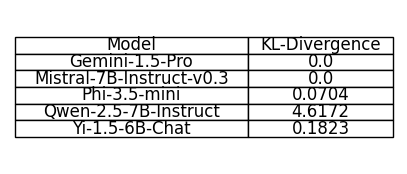

In [ ]:
# Function to calculate KL divergence between two distributions with smoothing
def calculate_kl_divergence(P, Q, epsilon=1e-6): # the epsilon is introduced to avoid infinite values in the log term
    P = np.array(P) + epsilon
    Q = np.array(Q) + epsilon
    P /= P.sum()  # Ensure normalized probabilities
    Q /= Q.sum()  # Ensure normalized probabilities
    return np.sum(P * np.log(P / Q))

# Prepare data
models = sorted(other_answer_options_data["model_name"].unique())  # Get unique models

kl_divergences = []  # Empty list for storing results

for model in models:
    # Filter for the current model
    P_data = other_answer_options_data[other_answer_options_data["model_name"] == model]
    Q_data = other_answer_options_reversed_data[other_answer_options_reversed_data["model_name"] == model]
    
    # Get the distributions
    P_distribution = (
        P_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
    )
    Q_distribution = (
        Q_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
    )
    
    # Compute KL divergence
    kl_divergence = calculate_kl_divergence(P_distribution, Q_distribution)
    
    # Store result
    kl_divergences.append({"Model": model, "KL-Divergence": round(kl_divergence,4)})

# Convert results to a DataFrame for better presentation
kl_results = pd.DataFrame(kl_divergences)

# Create the figure and axis
fig, ax = plt.subplots(figsize=(5, 2))  # Adjust the size as needed
ax.axis('tight')  # Removes axis
ax.axis('off')

# Add table
table = ax.table(cellText=kl_results.values, colLabels=kl_results.columns, loc='center', cellLoc='center')

# Customize table
table.auto_set_font_size(False)
table.set_fontsize(12)
table.auto_set_column_width(col=list(range(len(kl_results.columns))))  # Adjust column width automatically

# Save to PNG
plt.savefig("../midterm/figures/other_importance_h1_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

In [ ]:
# over all models: no separation into llama and other models
category_filter = "Importance of Life Aspects"
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]

# Separate data for each type
list_answer_options_data = subset[subset["type"] == "list_answer_options"]
list_answer_options_reversed_data = subset[subset["type"] == "list_answer_options_reversed"]

def kl_chi_table(original, perturbation, category):
    
    category_filter = category
    
    subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
    ]

    # Separate data for each type
    list_answer_options_data = subset[subset["type"] == original]
    list_answer_options_reversed_data = subset[subset["type"] == perturbation]
    models = all_sorted_models  # Get unique models
    kl_divergences = []  # Empty list for storing results

    for model in models:
        # Filter for the current model
        P_data = list_answer_options_data[list_answer_options_data["model_name"] == model]
        Q_data = list_answer_options_reversed_data[list_answer_options_reversed_data["model_name"] == model]
        
        # Get the distributions
        P_distribution = (
            P_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
        )
        Q_distribution = (
            Q_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
        )
        
        # Compute KL divergence
        kl_divergence = calculate_kl_divergence(P_distribution, Q_distribution)
        
        # Store result
        kl_divergences.append({"Model": model, "KL-Divergence": round(kl_divergence,4)})

    # Convert results to a DataFrame for better presentation
    kl_results = pd.DataFrame(kl_divergences)

    chi2_results = []

    for model in models:
        # Filter data for the specific model
        P_data = list_answer_options_data[list_answer_options_data["model_name"] == model]
        Q_data = list_answer_options_reversed_data[list_answer_options_reversed_data["model_name"] == model]
        
        # Extract the response counts
        P_counts = P_data["extracted_response"].value_counts()
        Q_counts = Q_data["extracted_response"].value_counts()
        
        # Align indices and fill missing values with zeros
        aligned = pd.DataFrame({"P_counts": P_counts, "Q_counts": Q_counts}).fillna(0)
        
        # Create a contingency table
        contingency_table = aligned.to_numpy()
        
        # Perform Chi-squared test
        chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table.T)
        
        # Store the result
        chi2_results.append({
            "Model": model,
            "Chi-Square Statistic": round(chi2_stat,4),
            "p-value": round(p_value,4),
            #"degrees_of_freedom": dof
        })

    # Convert results to a DataFrame for better presentation
    chi2_results_df = pd.DataFrame(chi2_results)


    importance_statistics = kl_results.merge(chi2_results_df, on="Model")

    # Create the figure and axis
    fig, ax = plt.subplots(figsize=(5, 2))  # Adjust the size as needed
    ax.axis('tight')  # Removes axis
    ax.axis('off')

    # Add table
    table = ax.table(cellText=importance_statistics.values, 
                    colLabels=importance_statistics.columns, loc='center', cellLoc='center')

    # Customize table
    table.auto_set_font_size(False)
    table.set_fontsize(12)
    table.auto_set_column_width(col=list(range(len(importance_statistics.columns))))  # Adjust column width automatically

    plt.show()
    return importance_statistics

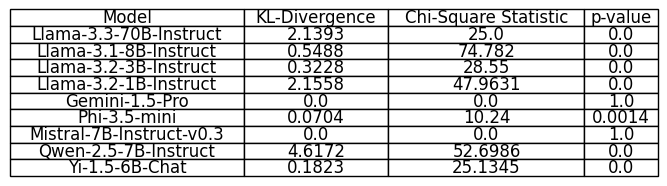

,Model,KL-Divergence,Chi-Square Statistic,p-value
0,Llama-3.3-70B-Instruct,2.1393,25.0000,0.0000
1,Llama-3.1-8B-Instruct,0.5488,74.7820,0.0000
2,Llama-3.2-3B-Instruct,0.3228,28.5500,0.0000
3,Llama-3.2-1B-Instruct,2.1558,47.9631,0.0000
4,Gemini-1.5-Pro,0.0000,0.0000,1.0000
5,Phi-3.5-mini,0.0704,10.2400,0.0014
6,Mistral-7B-Instruct-v0.3,0.0000,0.0000,1.0000
7,Qwen-2.5-7B-Instruct,4.6172,52.6986,0.0000
8,Yi-1.5-6B-Chat,0.1823,25.1345,0.0000


In [ ]:
kl_chi_table("list_answer_options", "list_answer_options_reversed", "Importance of Life Aspects")

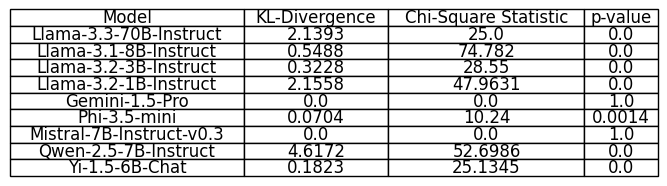

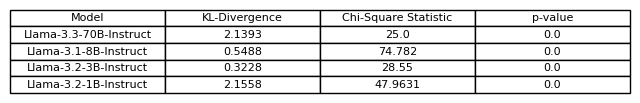

In [ ]:
# Save to llama table
importance_statistics = kl_chi_table("list_answer_options", "list_answer_options_reversed", "Importance of Life Aspects")
subset_table = importance_statistics[importance_statistics["Model"].isin(llama_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8,1))  
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/llama_importance_h1_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

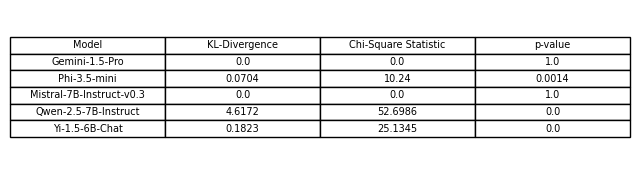

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(other_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 2))  # Increase width (e.g., 10)
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/other_importance_h1_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()


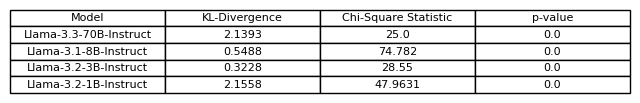

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(llama_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8,1))  
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/llama_importance_h1_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

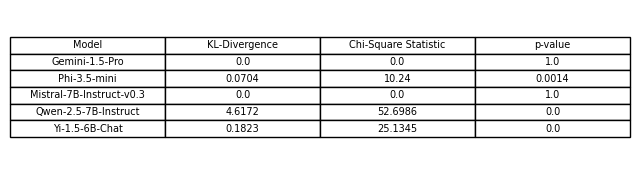

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(other_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 2))  # Increase width (e.g., 10)
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/other_importance_h1_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()


In [ ]:
# visualize in a nicer table
from scipy.stats import chi2_contingency
# Initialize a list to store Chi-squared test results
chi2_results = []

models = sorted(subset["model_name"].unique())  # Get unique models

for model in models:
    # Filter data for the specific model
    P_data = list_answer_options_data[list_answer_options_data["model_name"] == model]
    Q_data = list_answer_options_reversed_data[list_answer_options_reversed_data["model_name"] == model]
    
    # Extract the response counts
    P_counts = P_data["extracted_response"].value_counts()
    Q_counts = Q_data["extracted_response"].value_counts()
    
    # Align indices and fill missing values with zeros
    aligned = pd.DataFrame({"P_counts": P_counts, "Q_counts": Q_counts}).fillna(0)
    
    # Create a contingency table
    contingency_table = aligned.to_numpy()
    
    # Perform Chi-squared test
    chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table.T)
    
    # Store the result
    chi2_results.append({
        "Model": model,
        "Chi-Square Statistic": round(chi2_stat,4),
        "p-value": round(p_value,4),
        #"degrees_of_freedom": dof
    })

# Convert results to a DataFrame for better presentation
chi2_results_df = pd.DataFrame(chi2_results)


fig = go.Figure(data=[go.Table(
    header=dict(values=list(chi2_results_df.columns),
                fill_color='paleturquoise',
                align='center'),
    cells=dict(values=[chi2_results_df[col] for col in chi2_results_df.columns],
               fill_color='lavender',
               align='center'))
])

# Display the table
fig.show()


## Opinion Floating

In [ ]:
# Define subset
category_filter = "Importance of Life Aspects"
alt_distribution = "list_answer_no_refusal"
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]


# define llama dataframe
llama_answer_options_data = subset[(subset["type"] == "list_answer_options") &
                                (subset["model_name"].isin(llama_models))]
llama_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                            (subset["model_name"].isin(llama_models))]

all_possible_responses = subset[(subset["type"] == "list_answer_options")]["extracted_response"].unique()
 
# define other model dataframe
other_answer_options_data = subset[(subset["type"] == "list_answer_options") &
                                (subset["model_name"].isin(other_models))]
other_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                (subset["model_name"].isin(other_models))]

#### Distribution Comparison

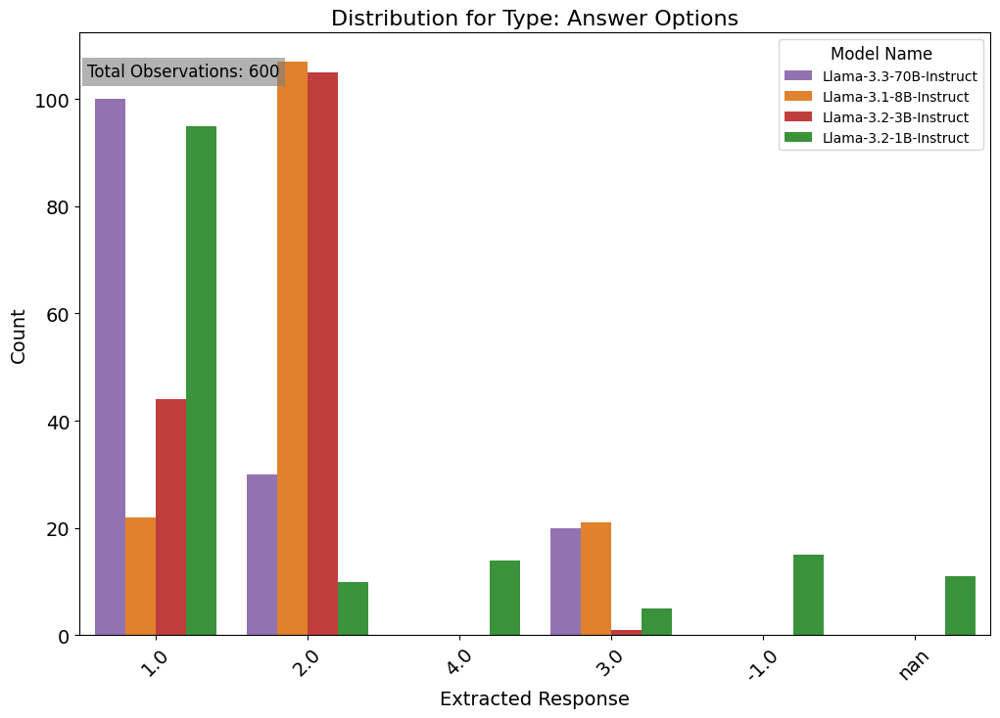

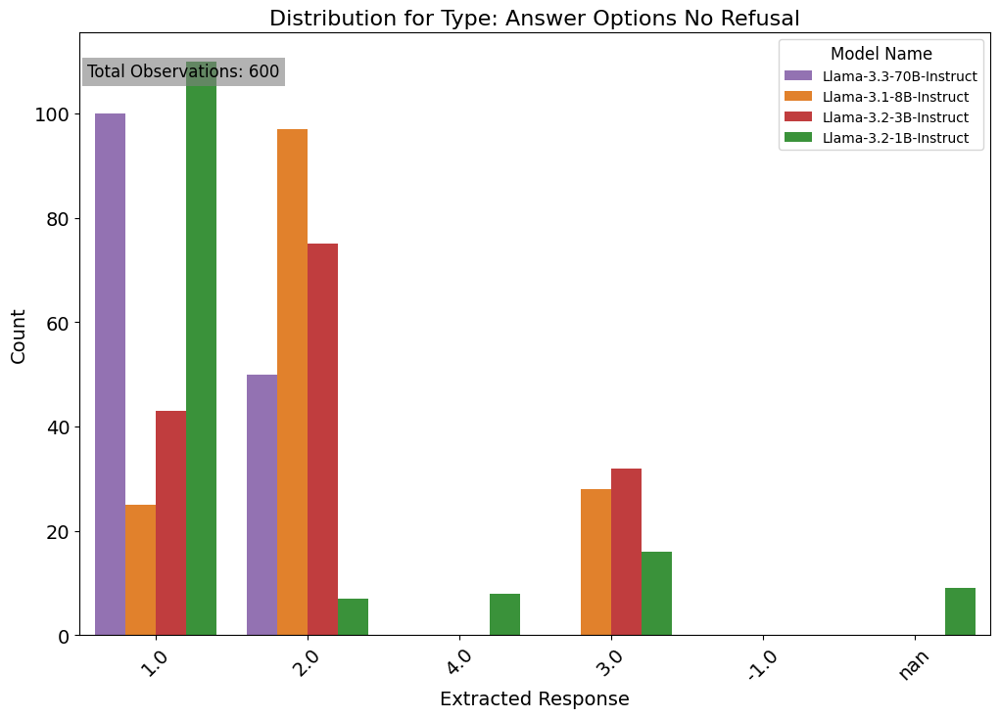

In [ ]:
# Plot for list_answer_options
create_barplot(
    llama_answer_options_data,
    plot_title="Distribution for Type: Answer Options",
    file_name="../midterm/figures/llama_answer_options_distribution.png"
)

# Plot for list_answer_options_reversed
create_barplot(
    llama_answer_options_alt_data,
    plot_title="Distribution for Type: Answer Options No Refusal",
    file_name="../midterm/figures/llama_answer_options_no_refusal_distribution.png"
)

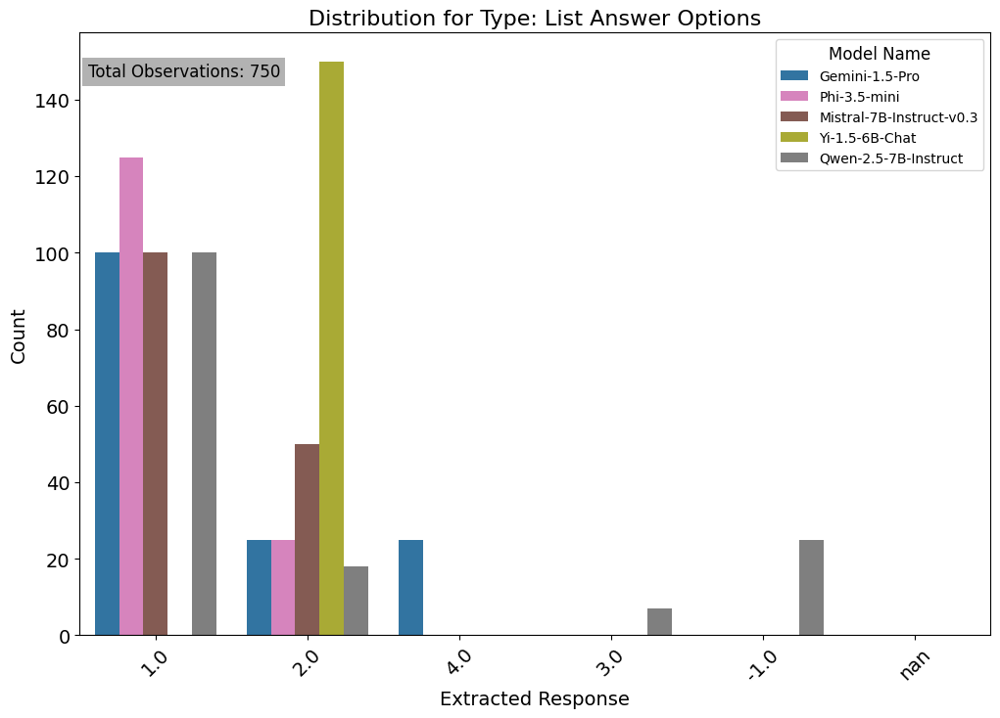

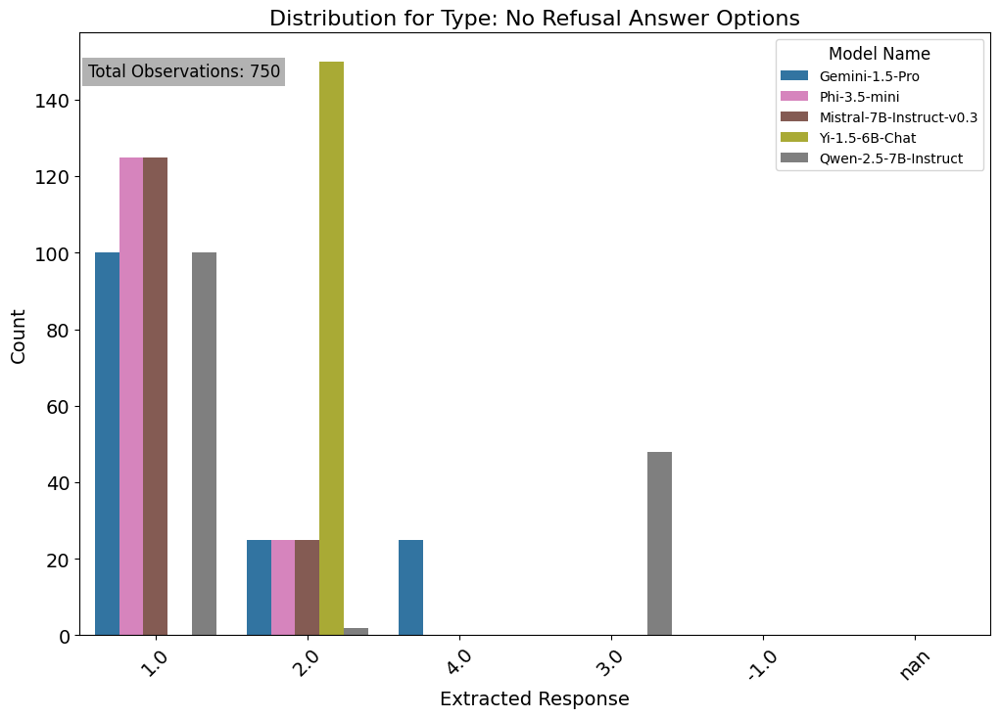

In [ ]:
# Plot for list_answer_options
create_barplot(
    other_answer_options_data,
    plot_title="Distribution for Type: List Answer Options",
    file_name="../midterm/figures/other_answer_options_distribution.png"
)

# Plot for list_answer_options_reversed
create_barplot(
    other_answer_options_alt_data,
    plot_title="Distribution for Type: No Refusal Answer Options",
    file_name="../midterm/figures/other_answer_options_no_refusal_distribution.png"
)

#### Difference Plot
Try visualization with a difference plot

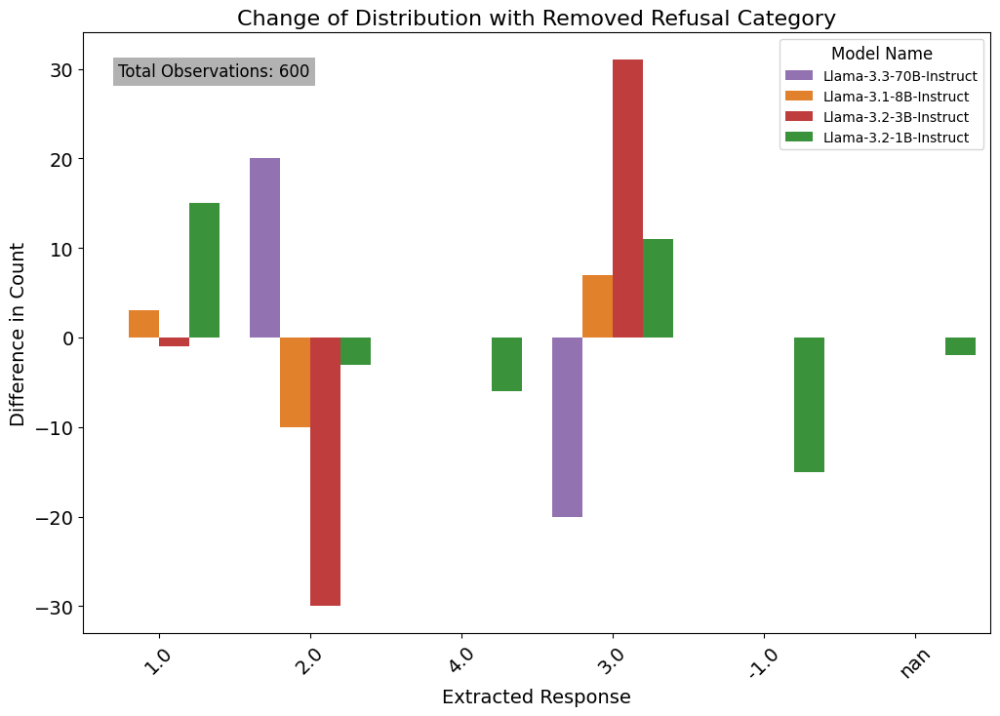

In [ ]:
# Plot for list_answer_options
create_diffplot(
    llama_answer_options_alt_data,
    llama_answer_options_data, 
    plot_title="Change of Distribution with Removed Refusal Category",
    file_name="../midterm/figures/llama_diff_distribution_no_refusal.png"
)

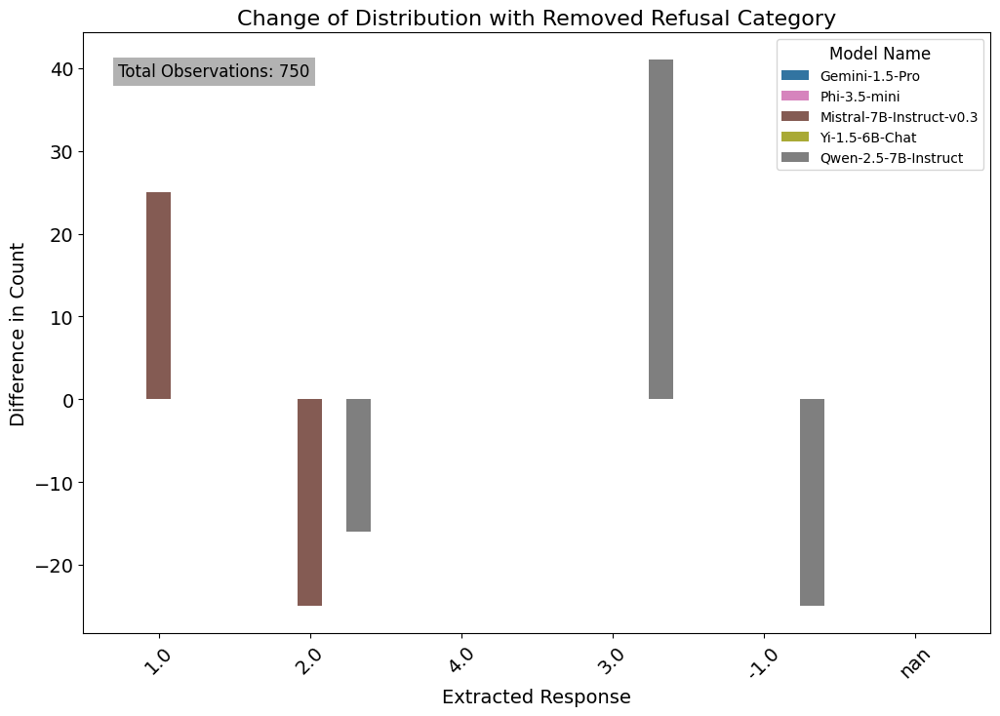

In [ ]:
# Plot for list_answer_options
create_diffplot(
    other_answer_options_alt_data,
    other_answer_options_data, 
    plot_title="Change of Distribution with Removed Refusal Category",
    file_name="../midterm/figures/other_diff_distribution_no_refusal.png"
)

#### Kullback-Leibler Divergence

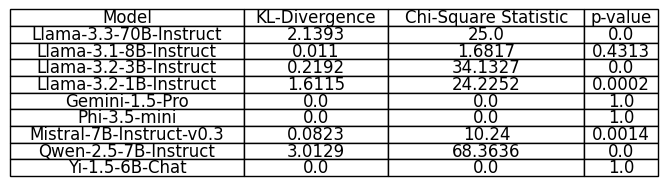

In [ ]:
# create subset to be run on all models
category_filter = "Importance of Life Aspects"
alt_distribution = "list_answer_no_refusal"
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]

all_possible_responses = subset["extracted_response"].unique() 

# Separate data for each type
list_answer_options_data = subset[subset["type"] == "list_answer_options"]
list_answer_options_alt_data = subset[subset["type"] == alt_distribution]

# Prepare data
models = all_sorted_models

kl_divergences = []  # Empty list for storing results

for model in models:
    # Filter for the current model
    P_data = list_answer_options_data[list_answer_options_data["model_name"] == model]
    Q_data = list_answer_options_alt_data[list_answer_options_alt_data["model_name"] == model]
    
    # Get the distributions
    P_distribution = (
        P_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
    )
    Q_distribution = (
        Q_data.groupby("extracted_response").size().reindex(subset["extracted_response"].unique(), fill_value=0)
    )
    
    # Compute KL divergence
    kl_divergence = calculate_kl_divergence(P_distribution, Q_distribution)
    
    # Store result
    kl_divergences.append({"Model": model, "KL-Divergence": round(kl_divergence,4)})

# Convert results to a DataFrame for better presentation
kl_results = pd.DataFrame(kl_divergences)

# Filter for the specific category
category_filter = "Importance of Life Aspects"
subset = final_interviews_categorized[
    final_interviews_categorized["Category"] == category_filter
]

chi2_results = []

models = all_sorted_models

for model in models:
    # Filter data for the specific model
    P_data = list_answer_options_data[list_answer_options_data["model_name"] == model]
    Q_data = list_answer_options_alt_data[list_answer_options_alt_data["model_name"] == model]
    
    # Extract the response counts
    P_counts = P_data["extracted_response"].value_counts()
    Q_counts = Q_data["extracted_response"].value_counts()
    
    # Align indices and fill missing values with zeros
    aligned = pd.DataFrame({"P_counts": P_counts, "Q_counts": Q_counts}).fillna(0)
    
    # Create a contingency table
    contingency_table = aligned.to_numpy()
    
    # Perform Chi-squared test
    chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table.T)
    
    # Store the result
    chi2_results.append({
        "Model": model,
        "Chi-Square Statistic": round(chi2_stat,4),
        "p-value": round(p_value,4),
        #"degrees_of_freedom": dof
    })

# Convert results to a DataFrame for better presentation
chi2_results_df = pd.DataFrame(chi2_results)


importance_statistics = kl_results.merge(chi2_results_df, on="Model")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(5, 2))  # Adjust the size as needed
ax.axis('tight')  # Removes axis
ax.axis('off')

# Add table
table = ax.table(cellText=importance_statistics.values, colLabels=importance_statistics.columns, loc='center', cellLoc='center')

# Customize table
table.auto_set_font_size(False)
table.set_fontsize(12)
table.auto_set_column_width(col=list(range(len(importance_statistics.columns))))  # Adjust column width automatically


plt.show()

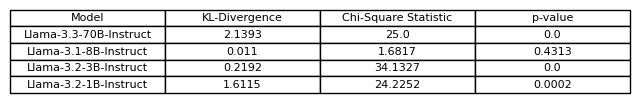

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(llama_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8,1))  
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/llama_importance_h2_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

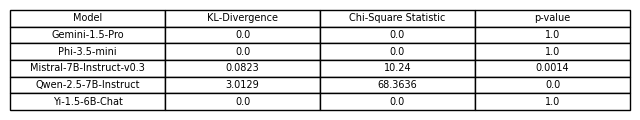

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(other_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 1))  # Increase width (e.g., 10)
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/other_importance_h2_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()


## Central Tendency

In [ ]:
# look for category which has the highest rate of refusals
highest_refusal = final_interviews_categorized.groupby("Category")["extracted_response"].value_counts()
counts_of_minus_one = highest_refusal.loc[:, "-1.0"]
ranked_groups = counts_of_minus_one.sort_values(ascending=False)
print("The most Refusals we find in these three categories:\n",list(ranked_groups.index[0:3]))

The most Refusals we find in these three categories:
 ['Moral and Ethical Justifiability', 'Perception of Elections', 'Trust in People and Groups']


In [ ]:
# Define subset
category_filter = "Moral and Ethical Justifiability"
null_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]

all_possible_responses = subset["extracted_response"].unique() 

# define llama dataframe
llama_answer_options_data = subset[(subset["type"] == null_distribution) &
                                (subset["model_name"].isin(llama_models))]
llama_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                            (subset["model_name"].isin(llama_models))]

# define other model dataframe
other_answer_options_data = subset[(subset["type"] == null_distribution) &
                                (subset["model_name"].isin(other_models))]
other_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                (subset["model_name"].isin(other_models))]

NameError: name 'llama_models' is not defined

#### Distribution Comparison

In [ ]:
# first define barplot for 10-scales with correct ordering
def create_10pt_barplot(data, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data["model_name"].unique())
    if varName(data).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Define the full list of possible responses
    full_response_order = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, -1.0, float('nan')]
    response_order_str = [str(x) if not pd.isna(x) else "nan" for x in full_response_order]  # Convert to strings
    
    # Ensure extracted_response is a string and map missing values to "nan"
    data["extracted_response"] = data["extracted_response"].fillna("nan").astype(str)
    
    # Determine present responses and preserve the order
    present_responses = sorted(data["extracted_response"].unique(), key=lambda x: response_order_str.index(x))
    
    # Group by model_name and extracted_response
    grouped_data = (
        data.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # Ensure that all possible responses are included, even those with no counts
    all_possible_responses = response_order_str
    
    # Reindex to include all possible responses (with count = 0 where missing)
    grouped_data = (
        grouped_data.set_index(["model_name", "extracted_response"])
        .reindex(
            pd.MultiIndex.from_product(
                [grouped_data["model_name"].unique(), all_possible_responses],
                names=["model_name", "extracted_response"]
            ),
            fill_value=0
        )
        .reset_index()
    )
    
    # Convert extracted_response to categorical for plotting
    grouped_data["extracted_response"] = pd.Categorical(
        grouped_data["extracted_response"],
        categories=all_possible_responses,
        ordered=True
    )
    
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    
    # Calculate total observations
    total_observations = len(data)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data,
        x="extracted_response",
        y="count",
        hue="model_name",
        hue_order=hue_order,  # Ensure consistent order
        palette=color_mapping   # Apply shared colors
    )
    
    # Add the total observations as an annotation
    plt.text(
        x=0.22,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,  # Use axes-relative positioning
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),  
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()

In [ ]:
def create_10pt_diffplot(data1, data2, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data1["model_name"].unique())
    if varName(data1).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    
    # Define the full list of possible responses (same as before)
    full_response_order = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, -1.0, float('nan')]
    response_order_str = [str(x) if not pd.isna(x) else "nan" for x in full_response_order]  # Convert to strings
    
    # Ensure extracted_response is a string and map missing values to "nan"
    data1["extracted_response"] = data1["extracted_response"].fillna("nan").astype(str)
    data2["extracted_response"] = data2["extracted_response"].fillna("nan").astype(str)
    
    # Group by model_name and extracted_response for both datasets
    grouped_data1 = (
        data1.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    grouped_data2 = (
        data2.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # Reindex to include all possible responses in both datasets
    all_possible_responses = response_order_str
    
    # Create a MultiIndex that includes all models and all responses
    all_models_responses = pd.MultiIndex.from_product(
        [models_present, all_possible_responses],
        names=["model_name", "extracted_response"]
    )
    
    # Reindex both datasets to ensure all response categories are included
    grouped_data1 = (
        grouped_data1.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    grouped_data2 = (
        grouped_data2.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    
    # Calculate the difference between datasets
    grouped_data1["diff_answer"] = grouped_data1["count"] - grouped_data2["count"]
    
    # Convert extracted_response to categorical for plotting to maintain the order
    grouped_data1["extracted_response"] = pd.Categorical(
        grouped_data1["extracted_response"],
        categories=all_possible_responses,
        ordered=True
    )
    
    # Calculate total observations from the first dataset
    total_observations = len(data1)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data1,
        x="extracted_response",
        y="diff_answer",
        hue="model_name",
        hue_order=hue_order,  # Only display models present
        palette=color_mapping   # Apply colors for present models only
    )
    
    # Add total observations as an annotation
    plt.text(
        x=0.25,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Difference in Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()


C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3800057224.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



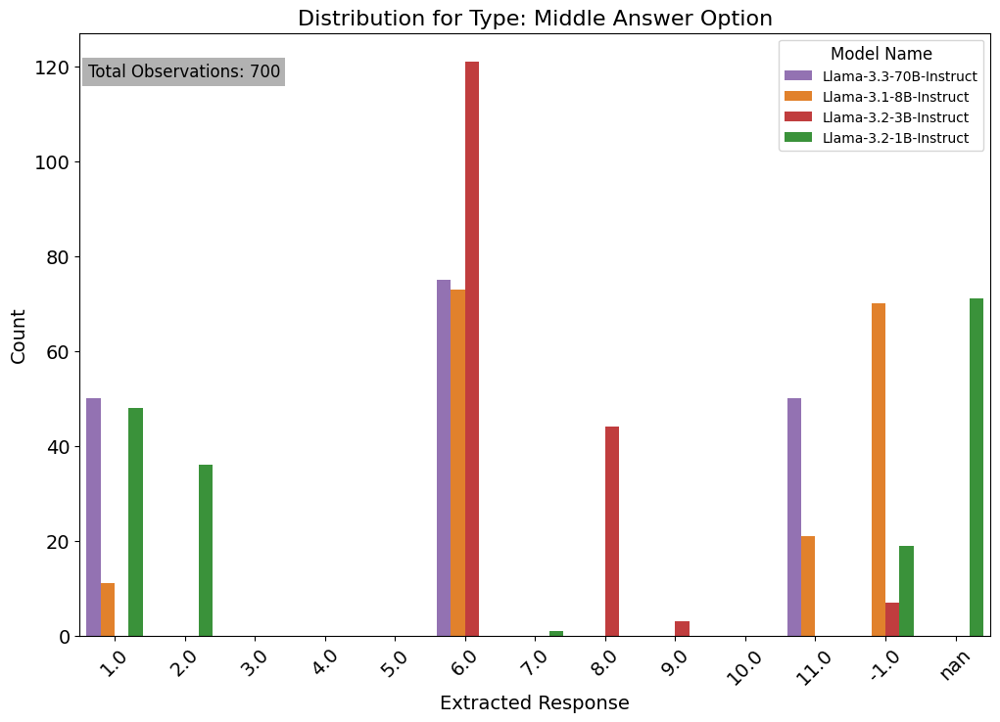

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3800057224.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



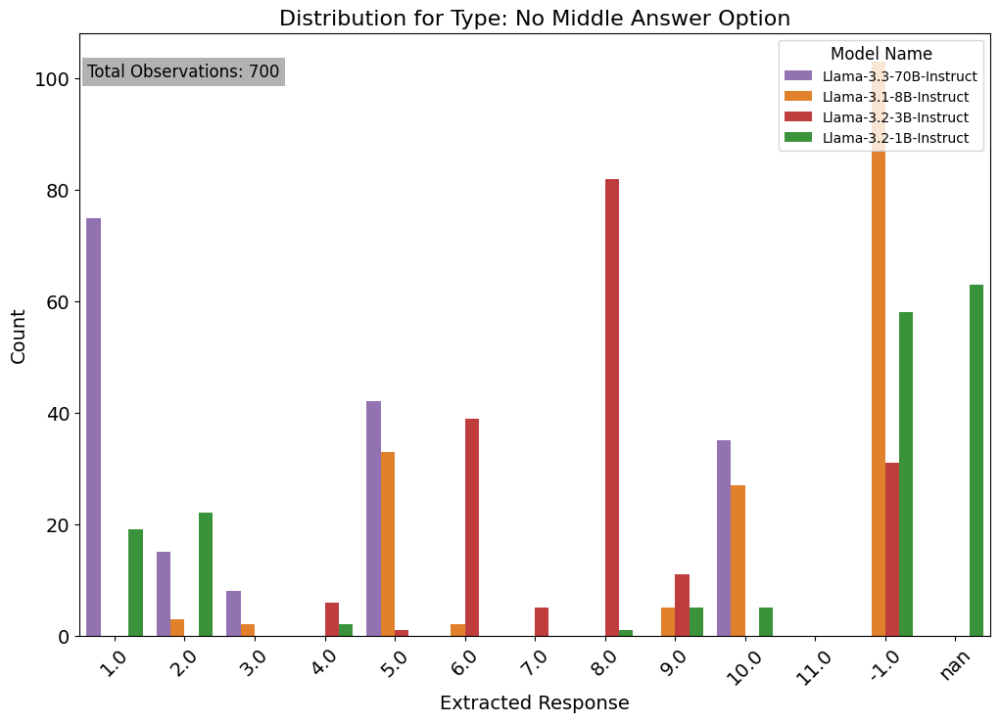

In [ ]:
# Plot for list_answer_options
create_10pt_barplot(
    llama_answer_options_data,
    plot_title="Distribution for Type: Middle Answer Option",
    file_name="../midterm/figures/llama_h3_middle_distribution.png"
)

# Plot for list_answer_options_reversed
create_10pt_barplot(
    llama_answer_options_alt_data,
    plot_title="Distribution for Type: No Middle Answer Option",
    file_name="../midterm/figures/llama_h3_no_middle_distribution.png"
)

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3800057224.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



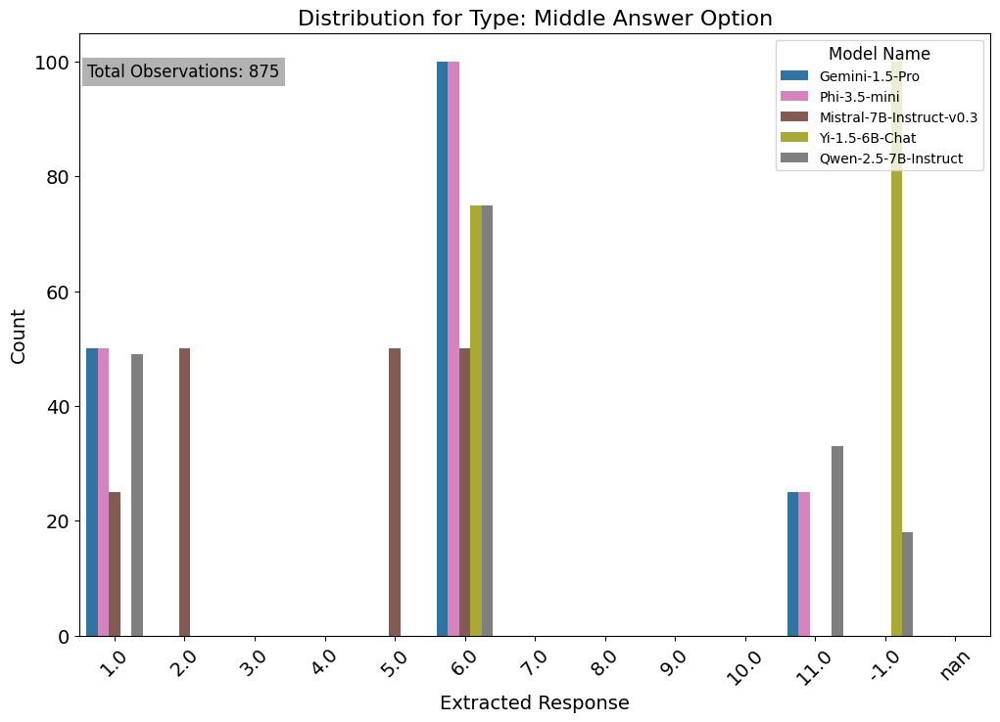

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3800057224.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



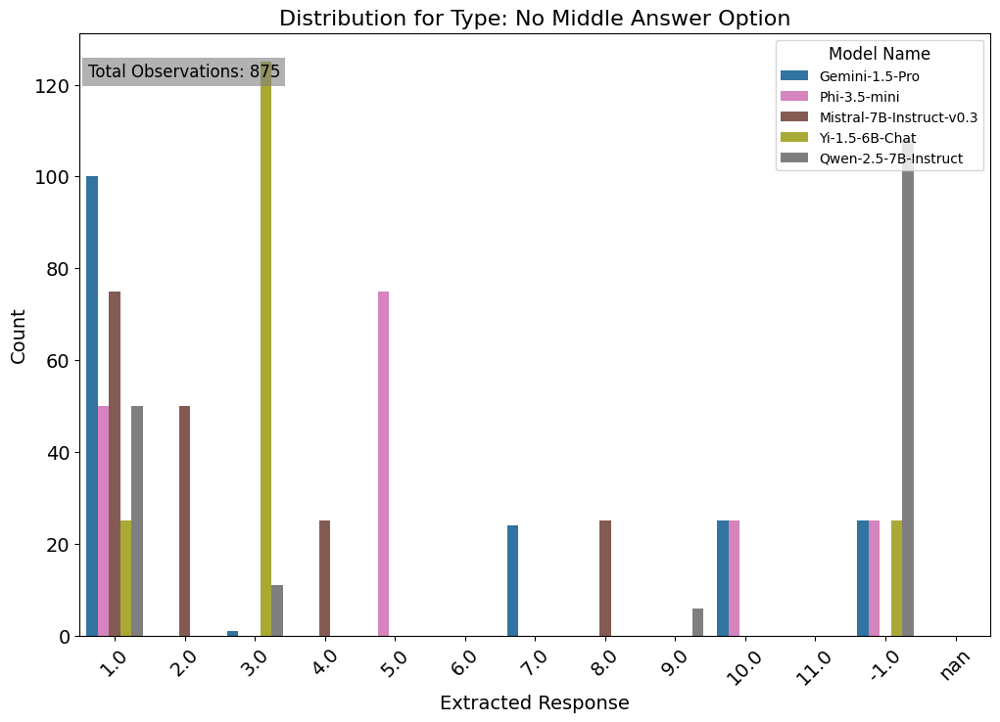

In [ ]:
# Plot for list_answer_options
create_10pt_barplot(
    other_answer_options_data,
    plot_title="Distribution for Type: Middle Answer Option",
    file_name="../midterm/figures/other_h3_middle_distribution.png"
)

# Plot for list_answer_options_reversed
create_10pt_barplot(
    other_answer_options_alt_data,
    plot_title="Distribution for Type: No Middle Answer Option",
    file_name="../midterm/figures/other_3_no_middle_distribution.png"
)

#### Difference Plot

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\4101161132.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\4101161132.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



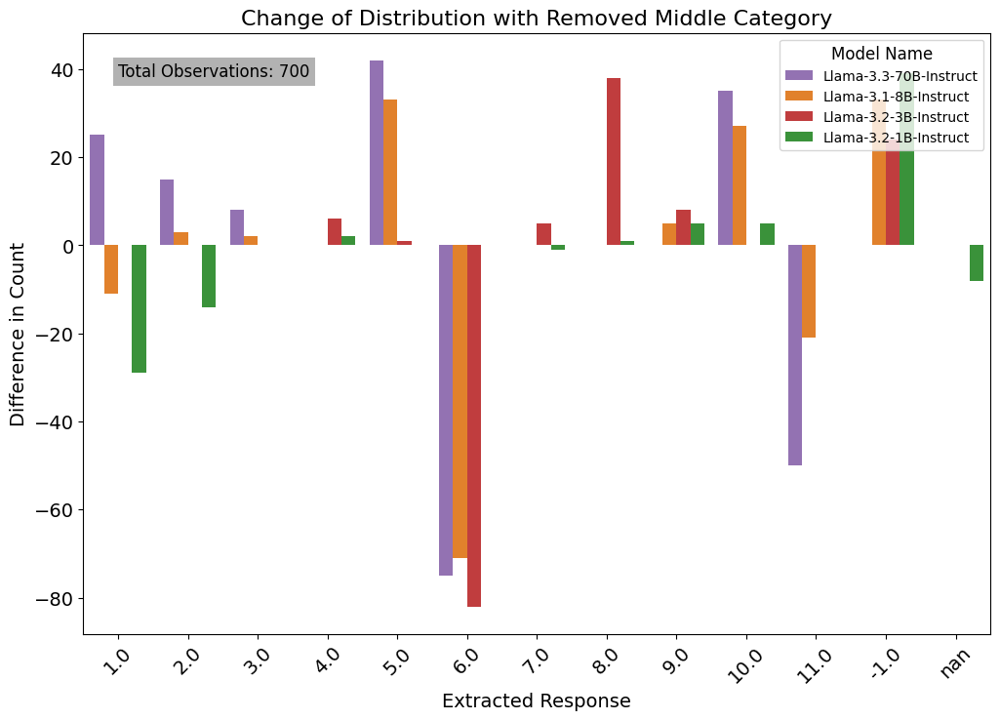

In [ ]:
# Plot for list_answer_options
create_10pt_diffplot(
    llama_answer_options_alt_data,
    llama_answer_options_data, 
    plot_title="Change of Distribution with Removed Middle Category",
    file_name="../midterm/figures/llama_diff_h3_no_middle.png"
)

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\4101161132.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\4101161132.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



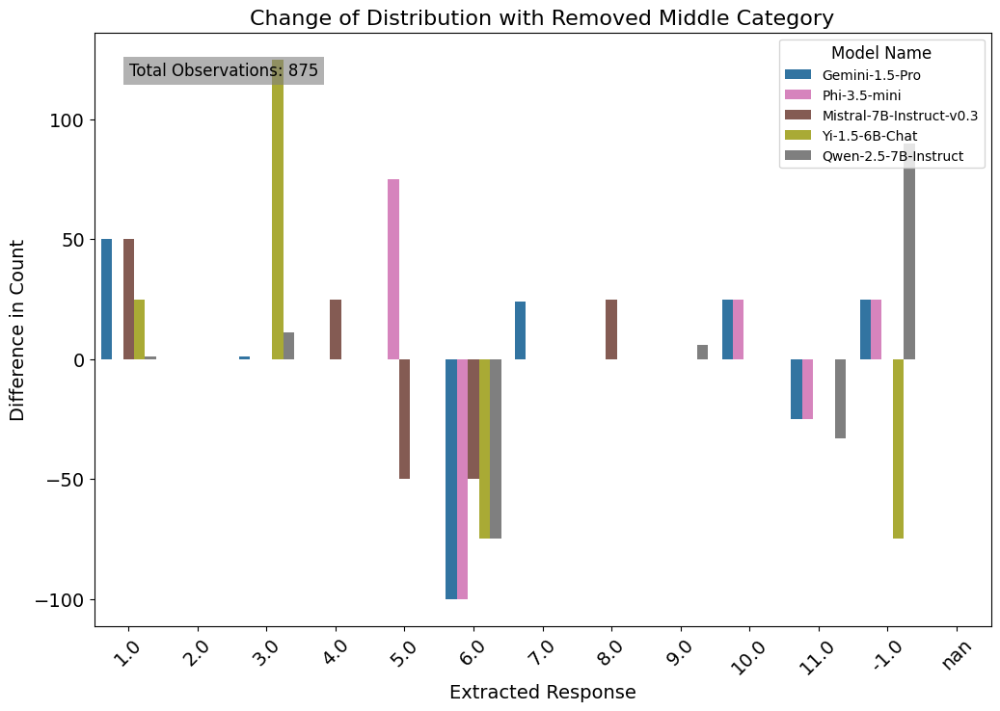

In [ ]:
# Plot for list_answer_options
create_10pt_diffplot(
    other_answer_options_alt_data,
    other_answer_options_data, 
    plot_title="Change of Distribution with Removed Middle Category",
    file_name="../midterm/figures/other_diff_h3_no_middle.png"
)

#### Kullback-Leibler Divergence

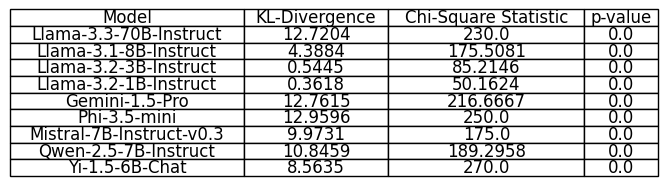

In [ ]:
category_filter = "Moral and Ethical Justifiability"
null_distribution = "list_answer_middle"
alt_distribution = "list_answer_no_middle"
importance_statistics = kl_chi_table(null_distribution, alt_distribution , category_filter)

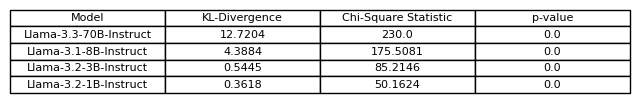

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(llama_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8,1))  
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/llama_moral_h3_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

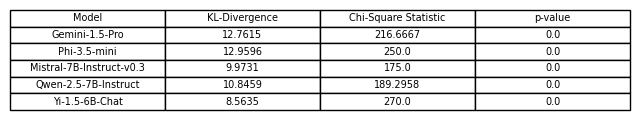

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(other_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 1))  # Increase width (e.g., 10)
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/other_moral_h3_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()


## Priming

In [ ]:
# Define subset
category_filter = "Moral and Ethical Justifiability"
null_distribution = "list_answer_options"
alt_distribution = "original_emotional_prime"
subset = final_interviews_categorized[
    (final_interviews_categorized["Category"] == category_filter)
]

all_possible_responses = subset["extracted_response"].unique() 

# define llama dataframe
llama_answer_options_data = subset[(subset["type"] == null_distribution) &
                                (subset["model_name"].isin(llama_models))]
llama_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                            (subset["model_name"].isin(llama_models))]

# define other model dataframe
other_answer_options_data = subset[(subset["type"] == null_distribution) &
                                (subset["model_name"].isin(other_models))]
other_answer_options_alt_data = subset[(subset["type"] == alt_distribution) &
                                (subset["model_name"].isin(other_models))]

In [ ]:
# first define barplot for 10-scales with correct ordering
def create_10pt_barplot(data, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data["model_name"].unique())
    if varName(data).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Define the full list of possible responses
    full_response_order = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, -1.0, float('nan')]
    response_order_str = [str(x) if not pd.isna(x) else "nan" for x in full_response_order]  # Convert to strings
    
    # Ensure extracted_response is a string and map missing values to "nan"
    data["extracted_response"] = data["extracted_response"].fillna("nan").astype(str)
    
    # Determine present responses and preserve the order
    present_responses = sorted(data["extracted_response"].unique(), key=lambda x: response_order_str.index(x))
    
    # Group by model_name and extracted_response
    grouped_data = (
        data.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # Ensure that all possible responses are included, even those with no counts
    all_possible_responses = response_order_str
    
    # Reindex to include all possible responses (with count = 0 where missing)
    grouped_data = (
        grouped_data.set_index(["model_name", "extracted_response"])
        .reindex(
            pd.MultiIndex.from_product(
                [grouped_data["model_name"].unique(), all_possible_responses],
                names=["model_name", "extracted_response"]
            ),
            fill_value=0
        )
        .reset_index()
    )
    
    # Convert extracted_response to categorical for plotting
    grouped_data["extracted_response"] = pd.Categorical(
        grouped_data["extracted_response"],
        categories=all_possible_responses,
        ordered=True
    )
    
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    
    # Calculate total observations
    total_observations = len(data)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data,
        x="extracted_response",
        y="count",
        hue="model_name",
        hue_order=hue_order,  # Ensure consistent order
        palette=color_mapping   # Apply shared colors
    )
    
    # Add the total observations as an annotation
    plt.text(
        x=0.22,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,  # Use axes-relative positioning
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),  
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()

In [ ]:
def create_10pt_diffplot(data1, data2, plot_title, file_name):
    # Identify models present in the current dataset
    models_present = sorted(data1["model_name"].unique())
    if varName(data1).startswith("llama"):
        hue_order = llama_models
    else: 
        hue_order = other_models
    # Extract colors only for models in the current data
    color_mapping = {model: global_color_mapping[model] for model in models_present}
    
    # Define the full list of possible responses (same as before)
    full_response_order = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, -1.0, float('nan')]
    response_order_str = [str(x) if not pd.isna(x) else "nan" for x in full_response_order]  # Convert to strings
    
    # Ensure extracted_response is a string and map missing values to "nan"
    data1["extracted_response"] = data1["extracted_response"].fillna("nan").astype(str)
    data2["extracted_response"] = data2["extracted_response"].fillna("nan").astype(str)
    
    # Group by model_name and extracted_response for both datasets
    grouped_data1 = (
        data1.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    grouped_data2 = (
        data2.groupby(["model_name", "extracted_response"])
        .size()
        .reset_index(name="count")
    )
    
    # Reindex to include all possible responses in both datasets
    all_possible_responses = response_order_str
    
    # Create a MultiIndex that includes all models and all responses
    all_models_responses = pd.MultiIndex.from_product(
        [models_present, all_possible_responses],
        names=["model_name", "extracted_response"]
    )
    
    # Reindex both datasets to ensure all response categories are included
    grouped_data1 = (
        grouped_data1.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    grouped_data2 = (
        grouped_data2.set_index(["model_name", "extracted_response"])
        .reindex(all_models_responses, fill_value=0)
        .reset_index()
    )
    
    # Calculate the difference between datasets
    grouped_data1["diff_answer"] = grouped_data1["count"] - grouped_data2["count"]
    
    # Convert extracted_response to categorical for plotting to maintain the order
    grouped_data1["extracted_response"] = pd.Categorical(
        grouped_data1["extracted_response"],
        categories=all_possible_responses,
        ordered=True
    )
    
    # Calculate total observations from the first dataset
    total_observations = len(data1)
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.barplot(
        data=grouped_data1,
        x="extracted_response",
        y="diff_answer",
        hue="model_name",
        hue_order=hue_order,  # Only display models present
        palette=color_mapping   # Apply colors for present models only
    )
    
    # Add total observations as an annotation
    plt.text(
        x=0.25,  
        y=0.95,  
        s=f"Total Observations: {total_observations}",
        ha="right",
        va="top",
        transform=plt.gca().transAxes,
        fontsize=12,
        color="black",
        bbox=dict(facecolor="grey", alpha=0.6, edgecolor="none"),
    )
    
    # Customize the plot
    plt.title(plot_title, fontsize=16)
    plt.xlabel("Extracted Response", fontsize=14)
    plt.ylabel("Difference in Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=14)
    plt.yticks(fontsize=14)
    plt.legend(title="Model Name", fontsize=10, title_fontsize=12, loc="upper right")
    
    # Save and show the plot
    plt.savefig(file_name, bbox_inches="tight", dpi=300, transparent=True)
    plt.show()


#### Distribution Comparison

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\1851686430.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



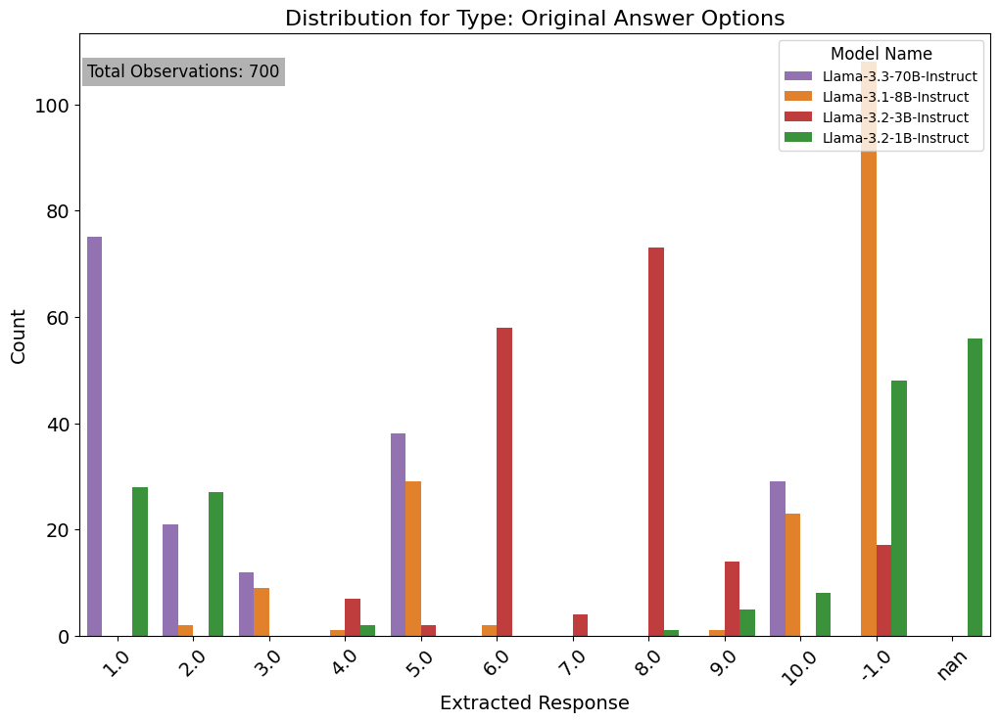

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\1851686430.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



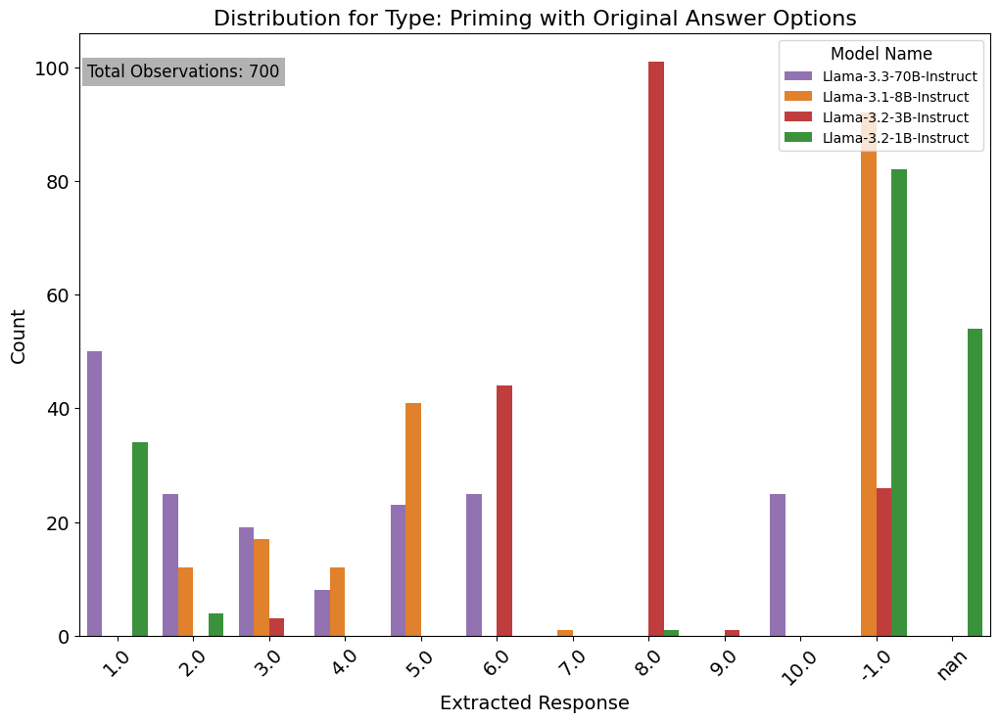

In [ ]:
# Plot for list_answer_options
create_10pt_barplot(
    llama_answer_options_data,
    plot_title="Distribution for Type: Original Answer Options",
    file_name="../midterm/figures/llama_h4_orig_distribution.png"
)

# Plot for list_answer_options_reversed
create_10pt_barplot(
    llama_answer_options_alt_data,
    plot_title="Distribution for Type: Priming with Original Answer Options",
    file_name="../midterm/figures/llama_h4_priming_distribution.png"
)

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\1851686430.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



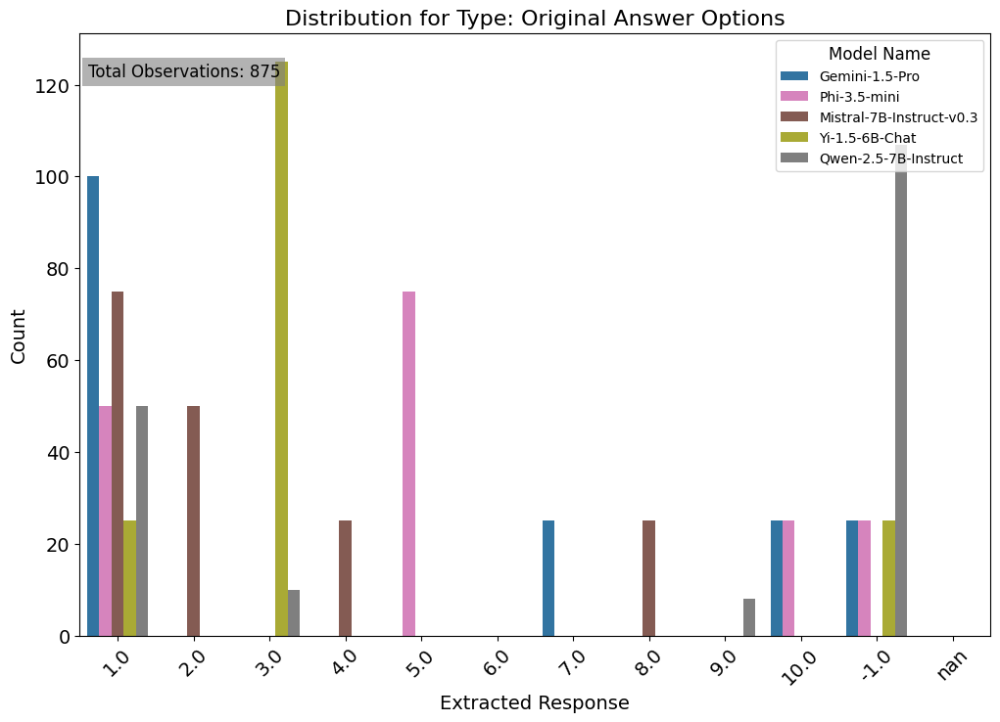

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\1851686430.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



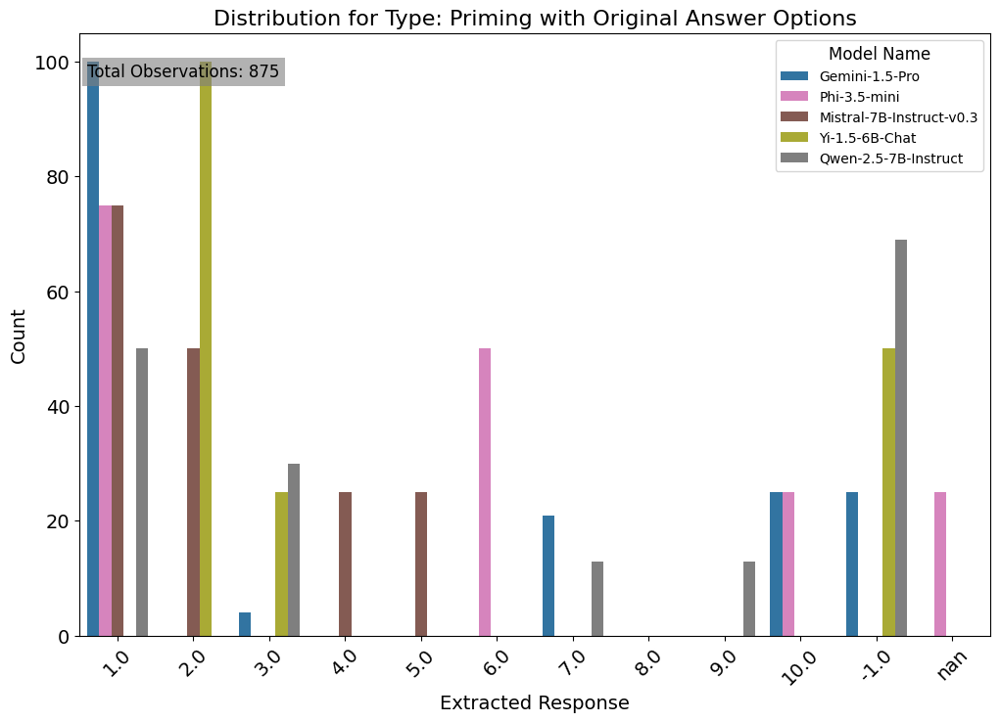

In [ ]:
# Plot for list_answer_options
create_10pt_barplot(
    other_answer_options_data,
    plot_title="Distribution for Type: Original Answer Options",
    file_name="../midterm/figures/other_h4_orig_distribution.png"
)

# Plot for list_answer_options_reversed
create_10pt_barplot(
    other_answer_options_alt_data,
    plot_title="Distribution for Type: Priming with Original Answer Options",
    file_name="../midterm/figures/other_h4_priming_distribution.png"
)

#### Difference Plot

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3465599453.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3465599453.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



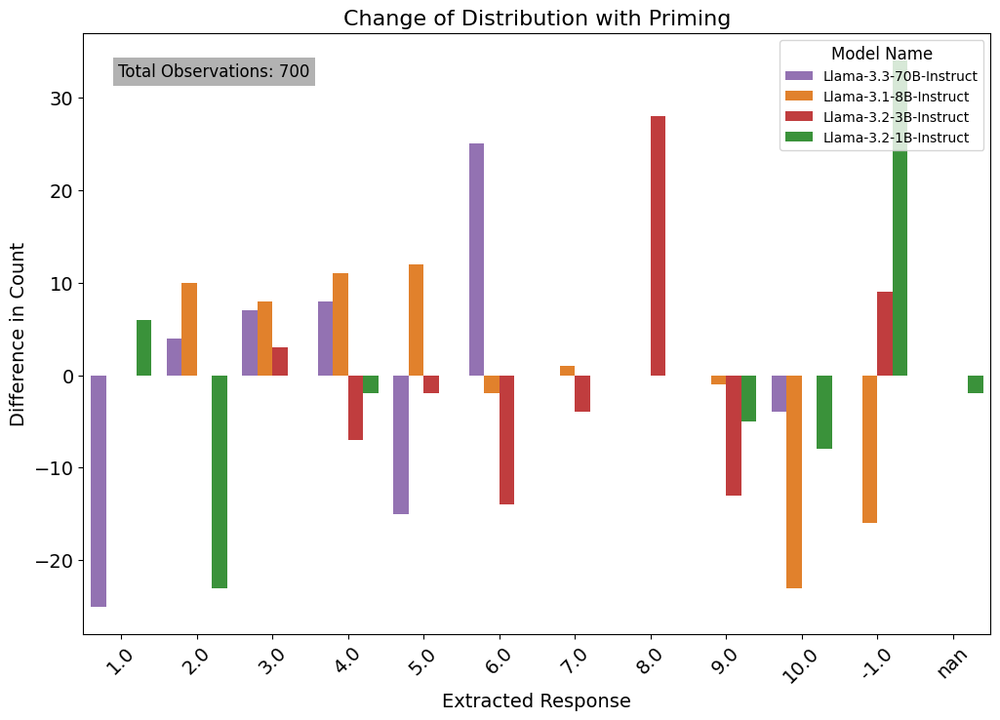

In [ ]:
# Plot for list_answer_options
create_10pt_diffplot(
        llama_answer_options_alt_data,
    llama_answer_options_data, 
    plot_title="Change of Distribution with Priming",
    file_name="../midterm/figures/llama_diff_h4_priming.png"
)

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3465599453.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ruppr\AppData\Local\Temp\ipykernel_17736\3465599453.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



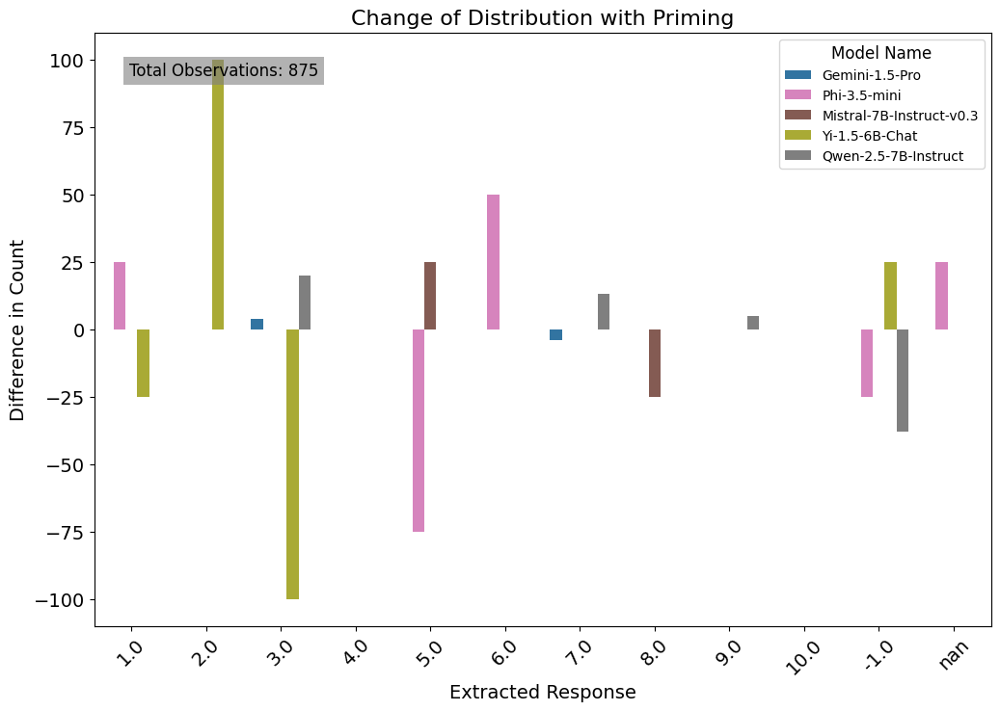

In [ ]:
# Plot for list_answer_options
create_10pt_diffplot(
    other_answer_options_alt_data,
    other_answer_options_data, 
    plot_title="Change of Distribution with Priming",
    file_name="../midterm/figures/other_diff_h4_priming.png"
)

#### Kullback-Leibler Divergence

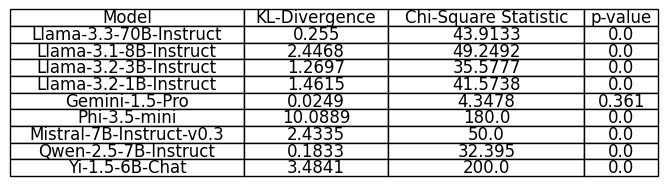

In [ ]:
category_filter = "Moral and Ethical Justifiability"
null_distribution = "list_answer_options"
alt_distribution = "original_emotional_prime"
importance_statistics = kl_chi_table(null_distribution, alt_distribution , category_filter)

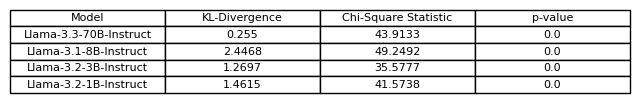

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(llama_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8,1))  
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/llama_moral_h4_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()

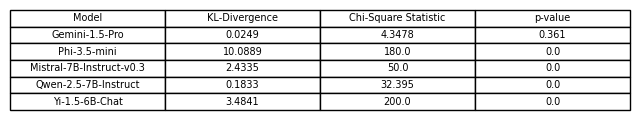

In [ ]:
# Save to llama table
subset_table = importance_statistics[importance_statistics["Model"].isin(other_models)]

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 1))  # Increase width (e.g., 10)
ax.axis("tight")
ax.axis("off")

# Create the table
table = ax.table(cellText=subset_table.values, colLabels=subset_table.columns, loc="center", cellLoc="center")

plt.savefig("../midterm/figures/other_moral_h4_kl_div.png", bbox_inches="tight", dpi=300, transparent = True)
plt.show()
